# import Library 

In [1]:
import os
import numpy as np
import pandas as pd
from scipy.optimize import curve_fit, differential_evolution
from scipy.special import erf
import matplotlib.pyplot as plt
import glob
import re
from scipy.stats import linregress

# Defined functions

In [2]:
# UF euqation with 5 terms 
def func(q, a, b, rss, d, e, f, rs, g, h, z):
    term1 = a / (q**b) * np.exp(-q**2 * rss**2 / 3)
    term2 = d * np.exp(-rss**2 * q**2 / 3)
    term3 = e * (((erf(q * rss / (6**0.5)))**3 / q)**f) * np.exp((-rs**2 * q**2) / 3)
    term4 = g * np.exp(-rs**2 * q**2 / 3)
    term5 = z * (((erf(q * rs / (6**0.5)))**3 / q)**h)
    return term1 + term2 + term3 + term4 + term5
# cost function used to evaluate wellness of fitting from differential evolution
def cost_function(params, q_values, r_values):
    fit = func(q_values, *params)
    return np.sum((r_values - fit)**2 / fit)
#T
def plot_individual_terms(q, params, color, initial_guess=None, focus_low_q=False):
    """
    Plot each term of the function separately from fitting results.
    
    required param [q]:  x axis values represents inverse of wave vector
    required praram [params]: A list of parameters obtained from fitting results
    required pramm [color]: The color of each term from func() or func_1()
    optional param [initial_guess]: The initial guess for the curve fitting, when 
                                    users entered initial_guess and focus_low_q is True,
                                    the last 4 parameters from initial_guess will be hold at constant
    optional param [focus_low_q]: If True, ignoring how much the high q components influenced. 
                                  Only term 1,2,and 3 from func_1() will be used for fitting and plotting.
                                  If False, all 5 terms from func() will be used for fitting and plotting. 
    
    """
    # Check the number of parameters and adapt accordingly
    if focus_low_q and len(params) == 6:
        if initial_guess is not None:
            # Use the fixed parameters for rs, g, h, z when focus_low_q is True
            a, b, rss, d, e, f = params
            rs, g, h, z = initial_guess[-4:]
        else: 
            a, b, rss, d, e, f = params
            rs, g, h, z = [0,0,0,0]
    elif not focus_low_q or len(params) == 10:
        # Unpack all parameters normally
        a, b, rss, d, e, f, rs, g, h, z = params
    else:
        raise ValueError("Unexpected number of parameters")

    q = np.logspace(np.log10(0.0007), np.log10(0.04), 500)

    # Calculate each term separately
    term1 = a / (q**b) * np.exp(-q**2 * rss**2 / 3)
    term2 = d * np.exp(-rss**2 * q**2 / 3)
    term3 = e * (((erf(q * rss / (6**0.5)))**3 / q)**f) * np.exp((-rs**2 * q**2) / 3)
    term4 = g * np.exp(-rs**2 * q**2 / 3)
    term5 = z * (((erf(q * rs / (6**0.5)))**3 / q)**h)

    #plt.figure(figsize=(10, 8))
    # Plot each term
    plt.loglog(q, term1, label="Term 1", color='red', linestyle='--')
    plt.loglog(q, term2, label="Term 2", color='blue', linestyle='-.')
    plt.loglog(q, term3, label="Term 3", color='green', linestyle=':')
    plt.loglog(q, term4, label="Term 4", color='yellow', linestyle='-')
    plt.loglog(q, term5, label="Term 5", color='black', linestyle='dashdot')
    plt.ylim(top=1000, bottom=0.01)
    # plt.legend()
    plt.xlabel("$q (\mathrm{A}^{-1})$", fontsize=24)
    plt.ylabel("Intensity", fontsize=24)
    plt.show()

    terms = [term1, term2, term3, term4, term5]

    # Combine the terms and q values into a single list
    terms_internal_q = [(q, term) for term in terms]

    return terms_internal_q
plt.rcParams["font.family"] = "Times New Roman"
terms_per_sample = {}    

def fit_curve(sample_name, q_col, r_col, color, initial_guess=None, focus_low_q=False):
    """
    Fit the curve for the given sample using differential_evolution multiple times, 
    choose the best fit based on chi-square, plot it, and extract parameters 2 and 3 along with their errors.

    :param sample_name: The name of the sample
    :param q_col: The column containing the q values
    :param r_col: The column containing the r values
    :param color: The color for the plot
    :param initial_guess: The initial guess for the curve fitting
    :param focus_low_q: if True, only first 3 low q fitting equations will be used for fitting

    
    """
    def plot_fit(q_values, params):
        if focus_low_q:
            if initial_guess is not None:
        # Ensure only the first six parameters are used
                adjustable_params = params[:6]
                fitted_r_values = func_fixed(q_values, *adjustable_params)
            else:
                fitted_r_values = func_1(q_values, *params)
        else:
            fitted_r_values = func(q_values, *params)
        return fitted_r_values
    
    #q_values = data[q_col].values[1:-20] #remove low q data points if needed// q_values = data[q_col].values[np.r_[0, 2:len(data[q_col])]] skip the 2nd index 
    q_values = data[q_col].values[np.r_[1:len(data[q_col])-20]]
    q_values = np.flip(q_values)
   
    q_values = q_values.astype(float) #make sure it is reading data not names (if names gonna fail)

    #r_values = data[r_col].values[1:-20]
    r_values = data[r_col].values[np.r_[1:len(data[r_col])-20]]
    
    r_values = np.flip(r_values)
    
    best_params = None
    best_covariance = None
    best_chi_square = float('inf')
    
    parameters = {
        
        'parameters': []
    }
    if focus_low_q:
        
        # Fitting with func_fixed
        if initial_guess is not None:
            # Fixed parameters
            fixed_params = initial_guess[-4:]
            def func_fixed(q, a, b, rss, d, e, f):
                rs, g, h, z = fixed_params
                return func(q, a, b, rss, d, e, f, rs, g, h, z)
        
            # Adjusted bounds for fitting   
            bounds_lower = lower_bounds[:-4]
            bounds_upper = upper_bounds[:-4]
            bounds = (bounds_lower, bounds_upper)
            
            initial_guess_adjusted = initial_guess[:-4]
            params, covariance = curve_fit(func_fixed, q_values, r_values, p0=initial_guess_adjusted, bounds=bounds, maxfev=10000)
            fitted_values = func_fixed(q_values, *params)
            chi_square = np.sum(((r_values - fitted_values) ** 2) / fitted_values)
            print(f"\nChi-square (focus_low_q=True, initial_guess=True): {chi_square}")
        # ... previous parts of your code ...
    
        else:
            # Define the reduced model function
            def func_1(q, C, Dm, Rss, D, E, F):
                term1 = C * np.exp((-Rss**2 * q**2) / 3) * q**(-Dm)
                term2 = D * np.exp(-Rss**2 * q**2 / 3)
                term3 = E * (((erf(q * Rss / (6**0.5)))**3 / q)**F)
                return term1 + term2 + term3
        
            # Define the cost function for the reduced model
            def cost_function1(params, q_values, r_values):
                fit = func_1(q_values, *params)
                return np.sum((r_values - fit)**2 / fit)
        
            # Define bounds for the reduced model
            bounds_lower = lower_bounds[:-4]
            bounds_upper = upper_bounds[:-4]
            bounds = (bounds_lower, bounds_upper)  # Define bounds as a tuple
        
            # Optimize the reduced model using differential evolution
            best_chi_square = float('inf')
            best_params = None
            for _ in range(5):  # Adjust the number of iterations as needed
                result = differential_evolution(cost_function1, args=(q_values, r_values), bounds = list(zip(bounds_lower, bounds_upper)), maxiter=1000, polish=False, disp=False)
                temp_params = result.x
                temp_fitted_values = func_1(q_values, *temp_params)
                temp_chi_square = np.sum(((r_values - temp_fitted_values) ** 2) / temp_fitted_values)
                if temp_chi_square < best_chi_square:
                    best_chi_square = temp_chi_square
                    best_params = temp_params
        
            # Use curve_fit with the best initial guess obtained from differential_evolution
            params, covariance = curve_fit(func_1, q_values, r_values, p0=best_params, bounds=bounds, maxfev=10000)
            fitted_values = func_1(q_values, *params)
            chi_square = np.sum(((r_values - fitted_values) ** 2) / fitted_values)
            print(f"\nChi-square (focus_low_q=True, initial_guess=False): {chi_square}")




    else:
        # Normal fitting process with func
        if initial_guess is not None:
            params, covariance = curve_fit(func, q_values, r_values, p0=initial_guess, bounds=(lower_bounds, upper_bounds), maxfev=10000)
            fitted_values = func(q_values, *params)
            chi_square = np.sum(((r_values[:] - fitted_values[:]) ** 2) / fitted_values[:])
            
            # Use the first six parameters from the fit as the initial guess for func_1
            initial_guess_func_1 = params[:6]
           
            # Fixed last four parameters
            fixed_params = params[-4:]
            
            # Adjusted bounds for fitting   
            bounds_lower = lower_bounds[:-4]
            bounds_upper = upper_bounds[:-4]
            bounds = (bounds_lower, bounds_upper)
            
            # Define the reduced model function with the fixed parameters
            def func_1_fixed(q, a, b, rss, d, e, f):
                rs, g, h, z = fixed_params
                return func(q, a, b, rss, d, e, f, rs, g, h, z)
    
            # Fit with func_1 using the new initial guess
            params, covariance = curve_fit(func_1_fixed, q_values, r_values, p0=initial_guess_func_1, bounds=bounds, maxfev=10000)
            fitted_values = func_1_fixed(q_values, *params)
            chi_square = np.sum(((r_values[:] - fitted_values[:]) ** 2) / fitted_values[:])
            print(f"\n Chi-square (func_1 with fixed params): {chi_square}")
    
            # Combine the parameters from func_1 fitting with the fixed parameters
            params = list(params) + list(fixed_params)
           
            if np.isclose(params[1], initial_guess[1]) and np.isclose(params[2], initial_guess[2])and np.isclose(params[3], initial_guess[3])and np.isclose(params[4], initial_guess[4]):
                        print(f"\n Fitting failed for sample {sample_name}!!! \n Returned to initial guess values")
                        # Optionally, you can handle this case further, e.g., by logging it or trying a different approach
                    
                        
             
        else:
            # If no initial guess is provided, use differential evolution to find the best initial guess
            for _ in range(5):
                result = differential_evolution(cost_function, args=(q_values, r_values),
                                                bounds=list(zip(lower_bounds, upper_bounds)),
                                                maxiter=1000, polish=False, disp=False)
                fitted_values = func(q_values, *result.x)
                chi_square = np.sum(((r_values[:] - fitted_values[:]) ** 2) / fitted_values[:])
                if chi_square < best_chi_square:
                    best_chi_square = chi_square
                    best_params = result.x
            params, covariance = curve_fit(func, q_values, r_values, 
                                           p0=best_params,
                                           bounds=(lower_bounds, upper_bounds)
                                           , maxfev=10000)
            print(f"Best chi square: {best_chi_square}")
    # Format each parameter individually and append to the list along with other data
    for i, param in enumerate(params):
        formatted_param = f'{param:.4e}'  # format each parameter
        param_data = f"Sample: {sample_name} - Parameter {i+1}: {formatted_param}"
        print(param_data)  # print the data
        parameters['parameters'].append( formatted_param)



    
    # Extracting parameters 2 and 3 along with their errors
    param_2, param_3 = params[1], params[2]
    error_2, error_3 = np.sqrt(np.diag(covariance))[1], np.sqrt(np.diag(covariance))[2]
    print(f"\nDm: {param_2:.4f} ± {error_2:.4f}")
    print(f"Rss: {param_3:.4f} ± {error_3:.4f}\n")
    params_df.loc[sample_name] = [sample_name, param_2, error_2, param_3, error_3]
    
    
    plt.figure(figsize=(10, 8))
    fitted_r_values = plot_fit(q_values, params)
    plt.loglog(q_values, r_values, 'o', color=color)
    plt.loglog(q_values, fitted_r_values, '-', label=f'{sample_name}', linewidth=4)
        
    # Adjusting the plot
    plt.xlabel("$q (\mathrm{A}^{-1})$", fontsize=24,)  # Use math mode for label
    plt.ylabel("Intensity", fontsize=24)
   
    plt.grid(True, which="both", ls="--")
    plt.legend(fontsize=12)
    plt.tick_params(axis='both', which='major', labelsize=20)

    # plt.tight_layout()
    # Get the parent directory of your current directory
    parent_dir = os.path.dirname(input_file_name)

  

    # Save the figure as a PNG with the name of the current directory in the parent directory
    # plt.savefig(os.path.join(parent_dir+'/L3029A 10% 2nd/', f"{sample_name}.png"))
    # plt.show()
    
    if focus_low_q:
    # When focus_low_q is True, pass only 6 parameters along with the fixed ones
        terms_internal_q = plot_individual_terms(q_values, params[:6], color, initial_guess, focus_low_q)
    else:
        # When focus_low_q is False, pass all parameters
        terms_internal_q = plot_individual_terms(q_values, params, color, initial_guess, focus_low_q)
    terms_per_sample[sample_name] = terms_internal_q

    return parameters

def remove_outliers_and_refit(parameter_name, std_dev_threshold):
    # Select the data and standard deviation based on parameter name
    if parameter_name == 'Parameter_2':
        data = sorted_data['Parameter_2']
        error = sorted_data['Error_2']  # Assuming an Error_2 column exists
        slope, intercept = slope_2, intercept_2
        yaxis_name = r'$D_{m}$'
        color = 'red'
    elif parameter_name == 'Parameter_3':
        data = sorted_data['Parameter_3']
        error = sorted_data['Error_3']  # Assuming an Error_3 column exists
        slope, intercept = slope_3, intercept_3
        yaxis_name = r'$R_{ss}$'
        color = 'blue'
    else:
        raise ValueError("Invalid parameter name")

    # Remove outliers beyond the specified standard deviation threshold
   
    residuals = data - (slope * sorted_data['Echo'] + intercept)
    std_dev = np.std(residuals)  
    inlier_mask = np.abs(residuals) <= std_dev_threshold * std_dev
    filtered_data = sorted_data[inlier_mask]
    filtered_error = error[inlier_mask]
    # Perform linear regression on the filtered data
    slope, intercept, _, _, _ = linregress(filtered_data['Echo'], 
                                           filtered_data[parameter_name])
    line = slope * filtered_data['Echo'] + intercept

    # Plotting the results
   # Initialize the figure and axis
    fig, ax1 = plt.subplots(figsize=(10, 8))

    # Section 1: Filtered Data with New Fitting
# Plotting error bars for the filtered data
    ax1.errorbar(filtered_data['Echo'], filtered_data[parameter_name], yerr=filtered_error, fmt='o', color=color, label=f'within {std_dev_threshold} std Data')
    # print(len(filtered_data['Echo']))

    # Plotting the line of best fit
    ax1.plot(filtered_data['Echo'], line, color=color, label=f'{slope:.2e}x + {intercept:.2f}')

    # Setting titles and labels
    ax1.set_title(sample_name + ': ' + data1['Direction'][0], fontsize=18)
    ax1.set_ylabel(yaxis_name, fontsize=30)

# Adding legend and grid
    ax1.legend(loc='upper right', fontsize=20)
    ax1.grid(True)

    # Setting y-axis limits based on parameter name
    if parameter_name == 'Parameter_2':
        ax1.set_ylim(1, 5)
    elif parameter_name == 'Parameter_3':
            ax1.set_ylim(200, 400)

# Load data

In [3]:
path = "C:/Users/range/OneDrive/Desktop/Research/Rubber reiforcement/NOV 2023/L3029D 10%/Relax/"
file_name = "L3029D_10%_Relax_echo_45_params_errors.csv"
input_file_name = path + file_name
data = pd.read_csv(input_file_name, delimiter=",")
params_df = pd.DataFrame(columns=['Sample', 'Parameter_2', 'Error_2', 'Parameter_3', 'Error_3'])
# Extracting sample names and plotting them
samples = [col.split("'q_")[1].split("'")[0] for col in data.columns if "q_" in col][:] #get individual data by using [:]
# samples =   samples[3:4] +samoples[6:7]

colors = plt.cm.jet(np.linspace(0, 1, len(samples)))  # Set up a colormap



 

# Define bounds and start fitting!


 Chi-square (func_1 with fixed params): 3.120288958413661
Sample: L3029D_10%_Relax_echo#0_45_10 - Parameter 1: 4.0432e-06
Sample: L3029D_10%_Relax_echo#0_45_10 - Parameter 2: 2.4791e+00
Sample: L3029D_10%_Relax_echo#0_45_10 - Parameter 3: 2.9573e+02
Sample: L3029D_10%_Relax_echo#0_45_10 - Parameter 4: 1.8413e+01
Sample: L3029D_10%_Relax_echo#0_45_10 - Parameter 5: 4.6460e-02
Sample: L3029D_10%_Relax_echo#0_45_10 - Parameter 6: 8.3101e-01
Sample: L3029D_10%_Relax_echo#0_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#0_45_10 - Parameter 8: 6.0355e-03
Sample: L3029D_10%_Relax_echo#0_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#0_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4791 ± 0.0690
Rss: 295.7323 ± 14.4192



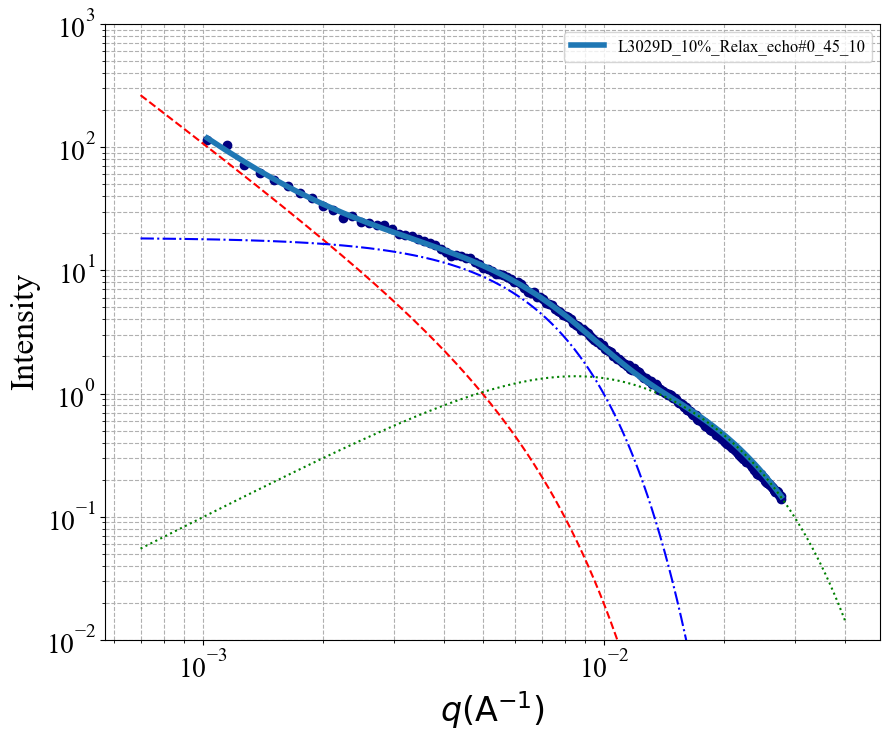


 Chi-square (func_1 with fixed params): 2.768195087922493
Sample: L3029D_10%_Relax_echo#1_45_10 - Parameter 1: 1.0040e-05
Sample: L3029D_10%_Relax_echo#1_45_10 - Parameter 2: 2.3428e+00
Sample: L3029D_10%_Relax_echo#1_45_10 - Parameter 3: 2.9024e+02
Sample: L3029D_10%_Relax_echo#1_45_10 - Parameter 4: 1.7416e+01
Sample: L3029D_10%_Relax_echo#1_45_10 - Parameter 5: 5.2542e-02
Sample: L3029D_10%_Relax_echo#1_45_10 - Parameter 6: 7.9877e-01
Sample: L3029D_10%_Relax_echo#1_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#1_45_10 - Parameter 8: 1.3190e-02
Sample: L3029D_10%_Relax_echo#1_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#1_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3428 ± 0.0652
Rss: 290.2399 ± 14.4844



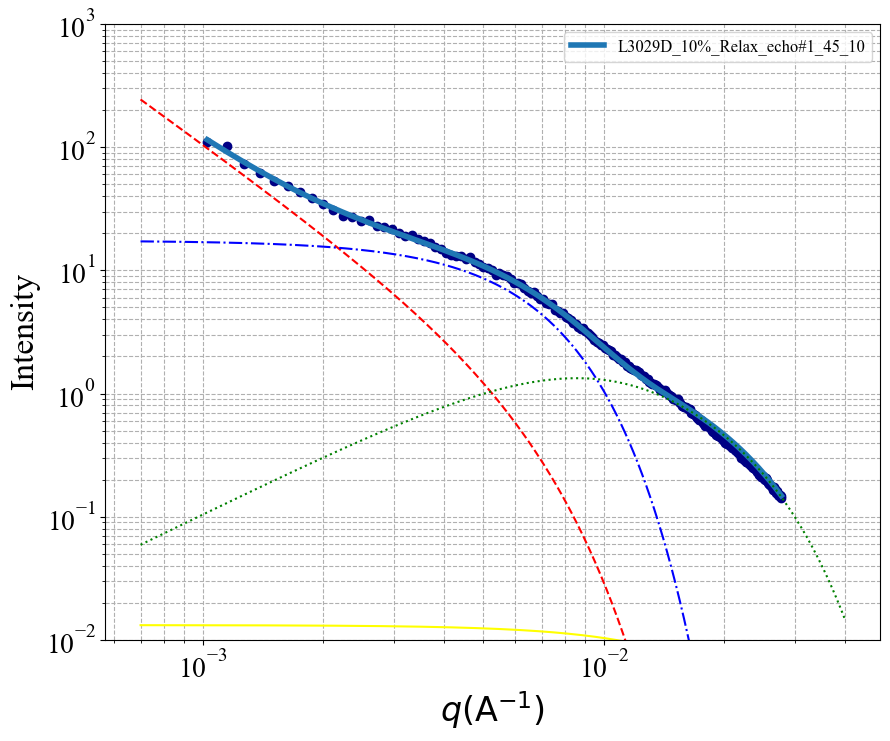


 Chi-square (func_1 with fixed params): 2.743017322106227
Sample: L3029D_10%_Relax_echo#2_45_10 - Parameter 1: 1.7337e-05
Sample: L3029D_10%_Relax_echo#2_45_10 - Parameter 2: 2.2629e+00
Sample: L3029D_10%_Relax_echo#2_45_10 - Parameter 3: 2.8435e+02
Sample: L3029D_10%_Relax_echo#2_45_10 - Parameter 4: 1.6522e+01
Sample: L3029D_10%_Relax_echo#2_45_10 - Parameter 5: 7.3948e-02
Sample: L3029D_10%_Relax_echo#2_45_10 - Parameter 6: 7.1159e-01
Sample: L3029D_10%_Relax_echo#2_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#2_45_10 - Parameter 8: 1.8749e-02
Sample: L3029D_10%_Relax_echo#2_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#2_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2629 ± 0.0631
Rss: 284.3467 ± 15.1952



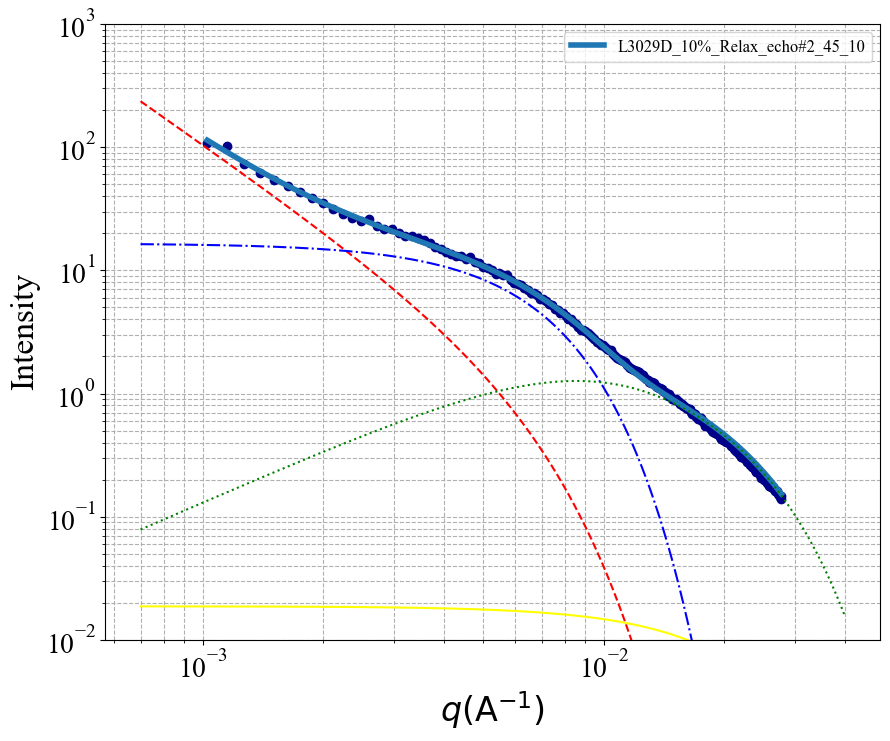


 Chi-square (func_1 with fixed params): 2.7523648767966034
Sample: L3029D_10%_Relax_echo#3_45_10 - Parameter 1: 1.8696e-05
Sample: L3029D_10%_Relax_echo#3_45_10 - Parameter 2: 2.2502e+00
Sample: L3029D_10%_Relax_echo#3_45_10 - Parameter 3: 2.8824e+02
Sample: L3029D_10%_Relax_echo#3_45_10 - Parameter 4: 1.6843e+01
Sample: L3029D_10%_Relax_echo#3_45_10 - Parameter 5: 5.0283e-02
Sample: L3029D_10%_Relax_echo#3_45_10 - Parameter 6: 8.0995e-01
Sample: L3029D_10%_Relax_echo#3_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#3_45_10 - Parameter 8: 4.0114e-03
Sample: L3029D_10%_Relax_echo#3_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#3_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2502 ± 0.0666
Rss: 288.2355 ± 15.3823



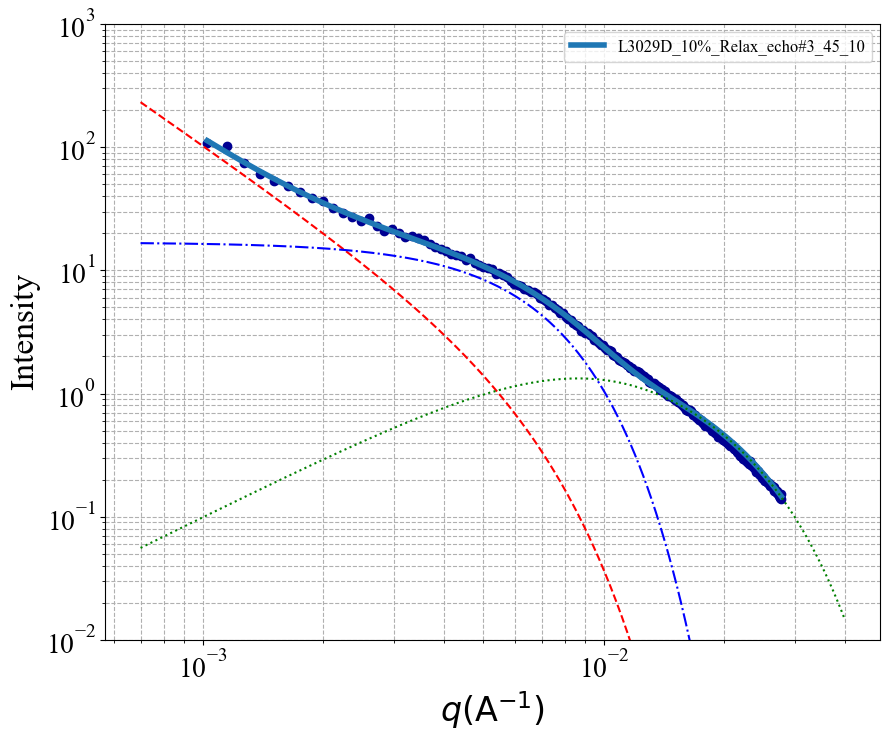


 Chi-square (func_1 with fixed params): 2.857093605592782
Sample: L3029D_10%_Relax_echo#4_45_10 - Parameter 1: 1.9823e-05
Sample: L3029D_10%_Relax_echo#4_45_10 - Parameter 2: 2.2406e+00
Sample: L3029D_10%_Relax_echo#4_45_10 - Parameter 3: 2.9029e+02
Sample: L3029D_10%_Relax_echo#4_45_10 - Parameter 4: 1.7052e+01
Sample: L3029D_10%_Relax_echo#4_45_10 - Parameter 5: 3.6599e-02
Sample: L3029D_10%_Relax_echo#4_45_10 - Parameter 6: 8.8588e-01
Sample: L3029D_10%_Relax_echo#4_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#4_45_10 - Parameter 8: 2.2333e-02
Sample: L3029D_10%_Relax_echo#4_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#4_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2406 ± 0.0706
Rss: 290.2893 ± 15.9098



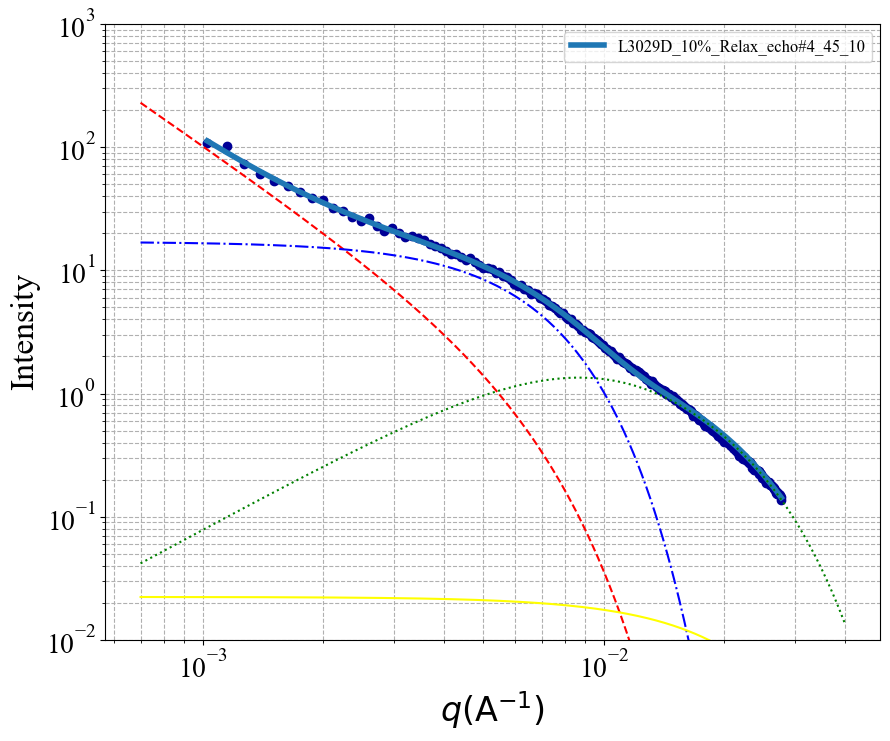


 Chi-square (func_1 with fixed params): 3.1398723109134083
Sample: L3029D_10%_Relax_echo#5_45_10 - Parameter 1: 1.8856e-05
Sample: L3029D_10%_Relax_echo#5_45_10 - Parameter 2: 2.2473e+00
Sample: L3029D_10%_Relax_echo#5_45_10 - Parameter 3: 2.9208e+02
Sample: L3029D_10%_Relax_echo#5_45_10 - Parameter 4: 1.7274e+01
Sample: L3029D_10%_Relax_echo#5_45_10 - Parameter 5: 3.7157e-02
Sample: L3029D_10%_Relax_echo#5_45_10 - Parameter 6: 8.8698e-01
Sample: L3029D_10%_Relax_echo#5_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#5_45_10 - Parameter 8: 2.5678e-04
Sample: L3029D_10%_Relax_echo#5_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#5_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2473 ± 0.0738
Rss: 292.0806 ± 16.4657



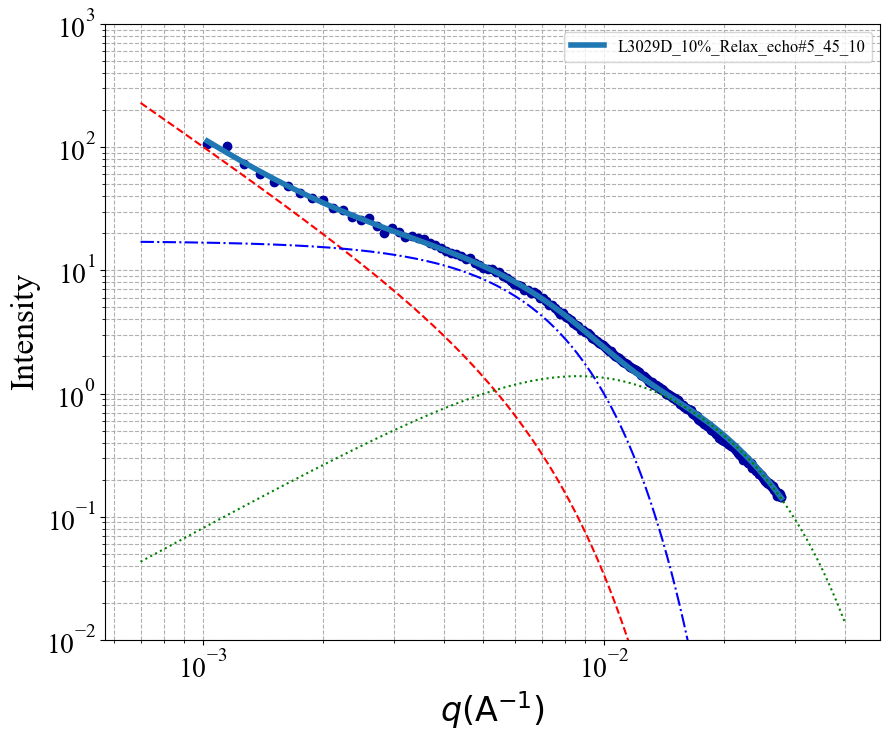


 Chi-square (func_1 with fixed params): 4.363688563711059
Sample: L3029D_10%_Relax_echo#6_45_10 - Parameter 1: 2.6683e-05
Sample: L3029D_10%_Relax_echo#6_45_10 - Parameter 2: 2.1927e+00
Sample: L3029D_10%_Relax_echo#6_45_10 - Parameter 3: 2.7902e+02
Sample: L3029D_10%_Relax_echo#6_45_10 - Parameter 4: 1.5914e+01
Sample: L3029D_10%_Relax_echo#6_45_10 - Parameter 5: 2.7965e-03
Sample: L3029D_10%_Relax_echo#6_45_10 - Parameter 6: 1.3635e+00
Sample: L3029D_10%_Relax_echo#6_45_10 - Parameter 7: 7.9041e+01
Sample: L3029D_10%_Relax_echo#6_45_10 - Parameter 8: 4.9835e-01
Sample: L3029D_10%_Relax_echo#6_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#6_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1927 ± 0.0705
Rss: 279.0228 ± 13.9751



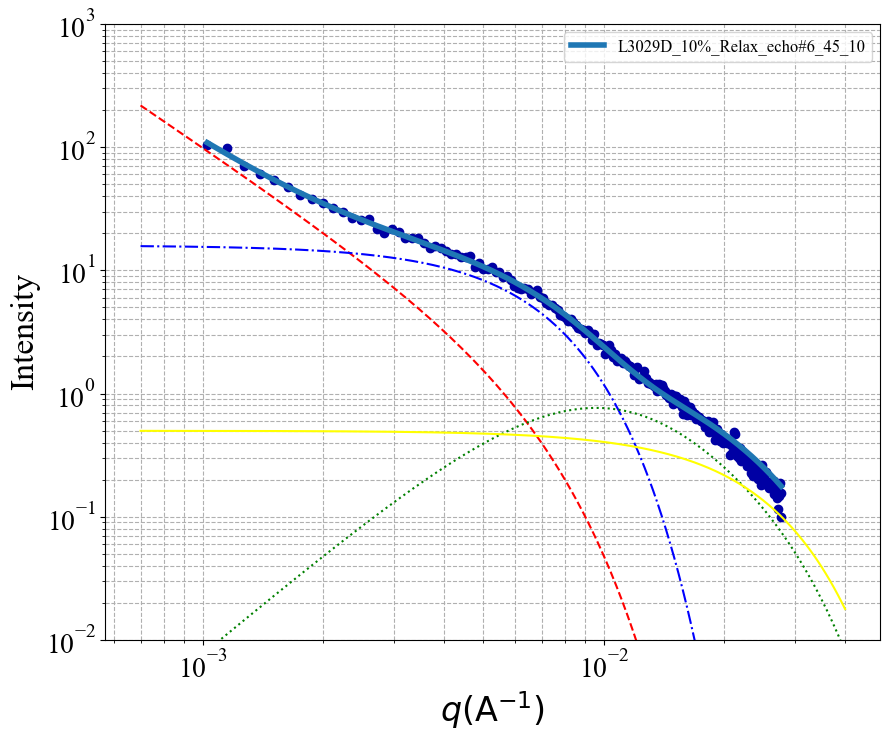


 Chi-square (func_1 with fixed params): 4.3755484832624765
Sample: L3029D_10%_Relax_echo#7_45_10 - Parameter 1: 3.4754e-05
Sample: L3029D_10%_Relax_echo#7_45_10 - Parameter 2: 2.1559e+00
Sample: L3029D_10%_Relax_echo#7_45_10 - Parameter 3: 2.8389e+02
Sample: L3029D_10%_Relax_echo#7_45_10 - Parameter 4: 1.5861e+01
Sample: L3029D_10%_Relax_echo#7_45_10 - Parameter 5: 6.6575e-02
Sample: L3029D_10%_Relax_echo#7_45_10 - Parameter 6: 7.3903e-01
Sample: L3029D_10%_Relax_echo#7_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#7_45_10 - Parameter 8: 3.2251e-03
Sample: L3029D_10%_Relax_echo#7_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#7_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1559 ± 0.0736
Rss: 283.8852 ± 18.1528



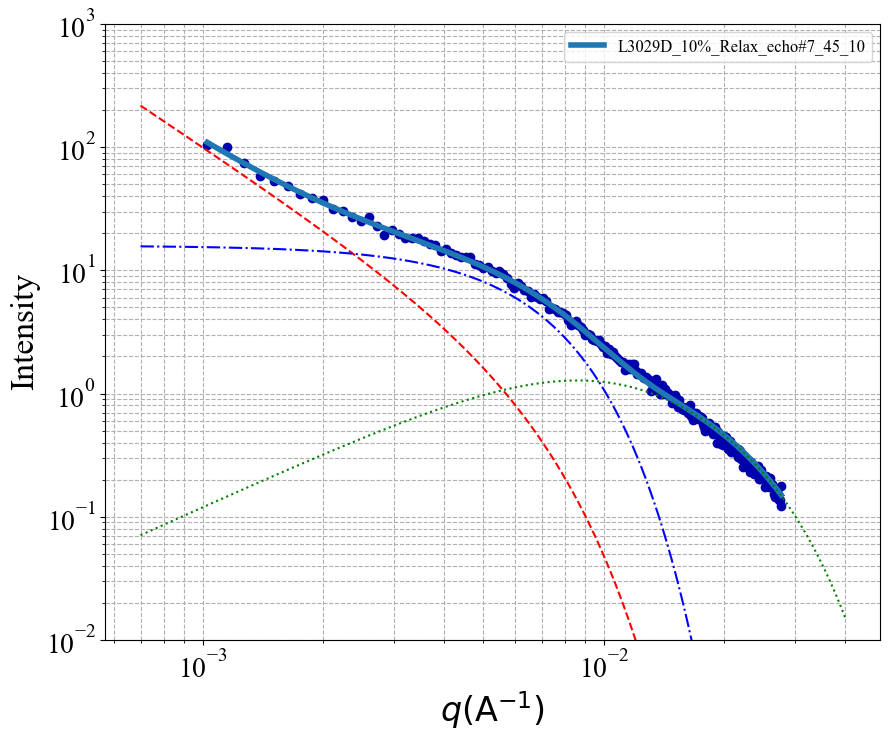


 Chi-square (func_1 with fixed params): 4.691475688012075
Sample: L3029D_10%_Relax_echo#8_45_10 - Parameter 1: 5.8393e-05
Sample: L3029D_10%_Relax_echo#8_45_10 - Parameter 2: 2.0828e+00
Sample: L3029D_10%_Relax_echo#8_45_10 - Parameter 3: 2.6982e+02
Sample: L3029D_10%_Relax_echo#8_45_10 - Parameter 4: 1.4106e+01
Sample: L3029D_10%_Relax_echo#8_45_10 - Parameter 5: 1.2789e-01
Sample: L3029D_10%_Relax_echo#8_45_10 - Parameter 6: 5.6185e-01
Sample: L3029D_10%_Relax_echo#8_45_10 - Parameter 7: 8.4999e+01
Sample: L3029D_10%_Relax_echo#8_45_10 - Parameter 8: 4.6641e-02
Sample: L3029D_10%_Relax_echo#8_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#8_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0828 ± 0.0698
Rss: 269.8220 ± 20.9812



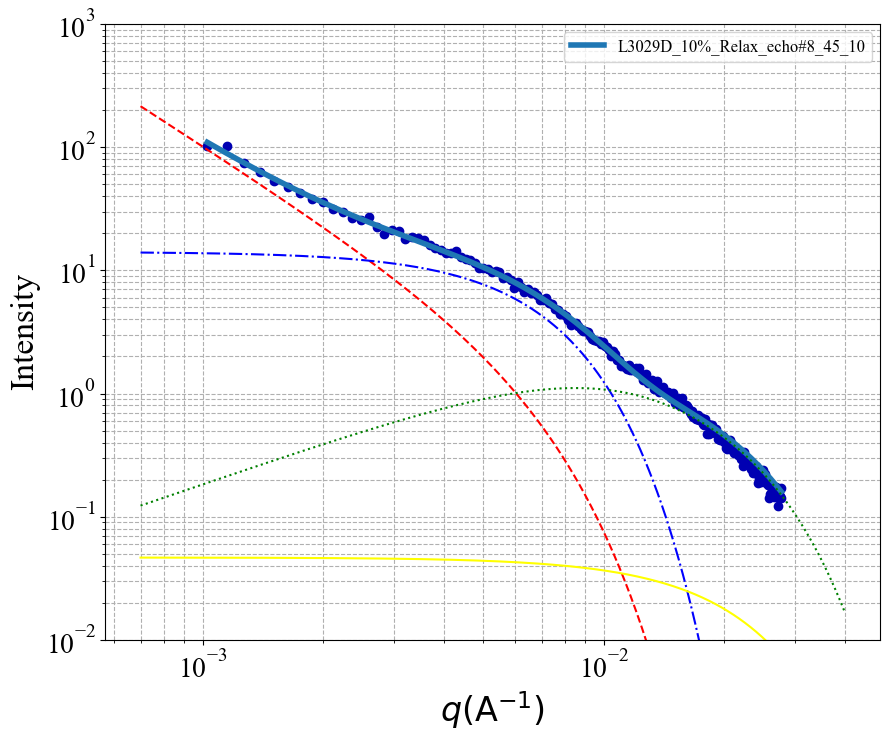


 Chi-square (func_1 with fixed params): 4.00853857819159
Sample: L3029D_10%_Relax_echo#9_45_10 - Parameter 1: 3.7966e-05
Sample: L3029D_10%_Relax_echo#9_45_10 - Parameter 2: 2.1420e+00
Sample: L3029D_10%_Relax_echo#9_45_10 - Parameter 3: 2.9421e+02
Sample: L3029D_10%_Relax_echo#9_45_10 - Parameter 4: 1.6856e+01
Sample: L3029D_10%_Relax_echo#9_45_10 - Parameter 5: 2.0882e-02
Sample: L3029D_10%_Relax_echo#9_45_10 - Parameter 6: 1.0226e+00
Sample: L3029D_10%_Relax_echo#9_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#9_45_10 - Parameter 8: 1.5329e-02
Sample: L3029D_10%_Relax_echo#9_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#9_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1420 ± 0.0774
Rss: 294.2132 ± 17.7764



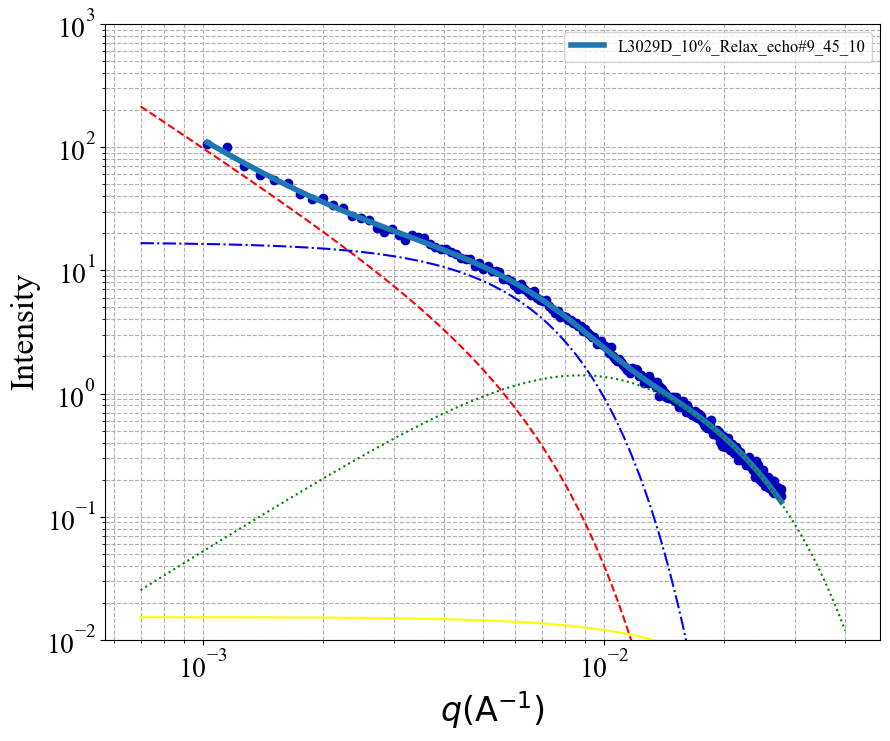


 Chi-square (func_1 with fixed params): 5.95590618657521
Sample: L3029D_10%_Relax_echo#10_45_10 - Parameter 1: 9.5341e-05
Sample: L3029D_10%_Relax_echo#10_45_10 - Parameter 2: 2.0059e+00
Sample: L3029D_10%_Relax_echo#10_45_10 - Parameter 3: 2.6877e+02
Sample: L3029D_10%_Relax_echo#10_45_10 - Parameter 4: 1.3744e+01
Sample: L3029D_10%_Relax_echo#10_45_10 - Parameter 5: 1.0219e-01
Sample: L3029D_10%_Relax_echo#10_45_10 - Parameter 6: 6.2259e-01
Sample: L3029D_10%_Relax_echo#10_45_10 - Parameter 7: 8.3573e+01
Sample: L3029D_10%_Relax_echo#10_45_10 - Parameter 8: 4.3930e-03
Sample: L3029D_10%_Relax_echo#10_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#10_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0059 ± 0.0848
Rss: 268.7719 ± 24.4873



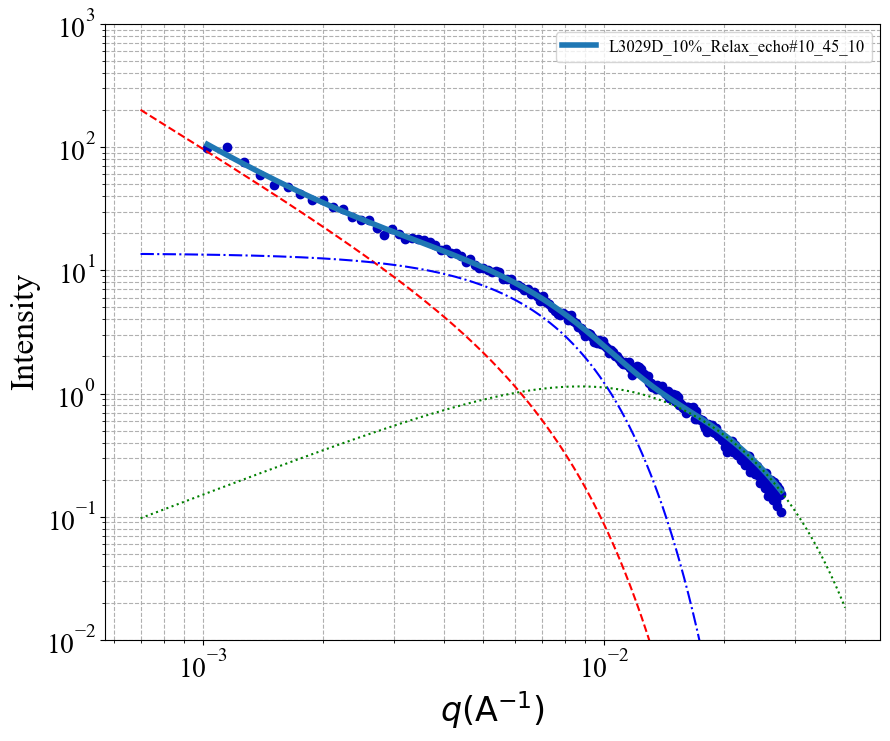


 Chi-square (func_1 with fixed params): 4.660034606863331
Sample: L3029D_10%_Relax_echo#11_45_10 - Parameter 1: 3.3940e-05
Sample: L3029D_10%_Relax_echo#11_45_10 - Parameter 2: 2.1589e+00
Sample: L3029D_10%_Relax_echo#11_45_10 - Parameter 3: 2.8645e+02
Sample: L3029D_10%_Relax_echo#11_45_10 - Parameter 4: 1.6270e+01
Sample: L3029D_10%_Relax_echo#11_45_10 - Parameter 5: 5.5525e-02
Sample: L3029D_10%_Relax_echo#11_45_10 - Parameter 6: 7.8537e-01
Sample: L3029D_10%_Relax_echo#11_45_10 - Parameter 7: 8.4999e+01
Sample: L3029D_10%_Relax_echo#11_45_10 - Parameter 8: 3.4799e-03
Sample: L3029D_10%_Relax_echo#11_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#11_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1589 ± 0.0845
Rss: 286.4544 ± 20.1226



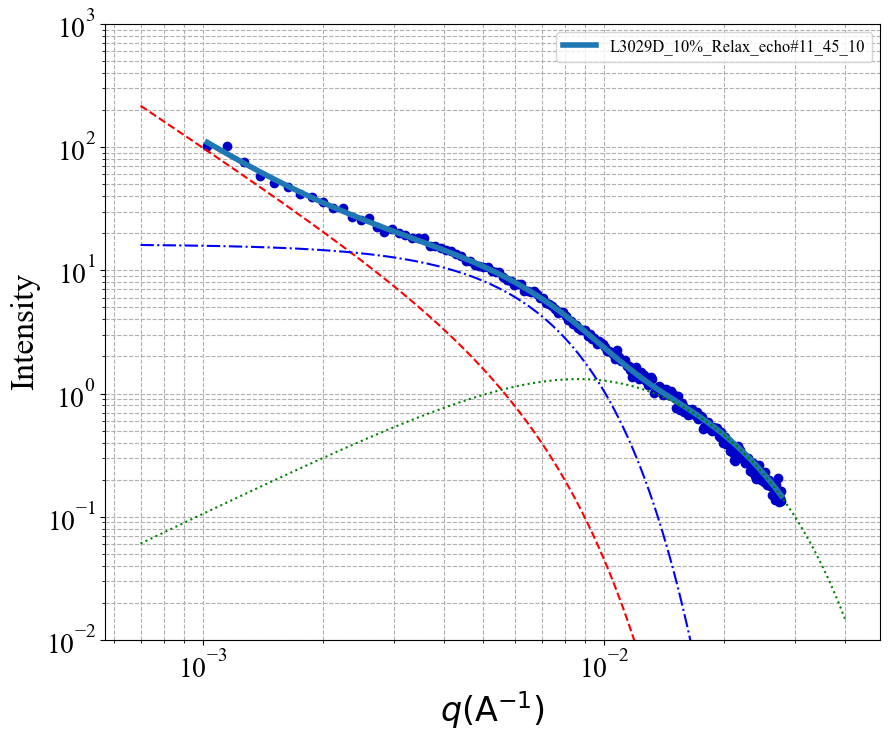


 Chi-square (func_1 with fixed params): 2.768300759505251
Sample: L3029D_10%_Relax_echo#12_45_10 - Parameter 1: 2.3068e-05
Sample: L3029D_10%_Relax_echo#12_45_10 - Parameter 2: 2.2177e+00
Sample: L3029D_10%_Relax_echo#12_45_10 - Parameter 3: 2.8980e+02
Sample: L3029D_10%_Relax_echo#12_45_10 - Parameter 4: 1.7010e+01
Sample: L3029D_10%_Relax_echo#12_45_10 - Parameter 5: 4.1363e-02
Sample: L3029D_10%_Relax_echo#12_45_10 - Parameter 6: 8.6009e-01
Sample: L3029D_10%_Relax_echo#12_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#12_45_10 - Parameter 8: 2.0643e-04
Sample: L3029D_10%_Relax_echo#12_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#12_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2177 ± 0.0661
Rss: 289.8047 ± 14.9970



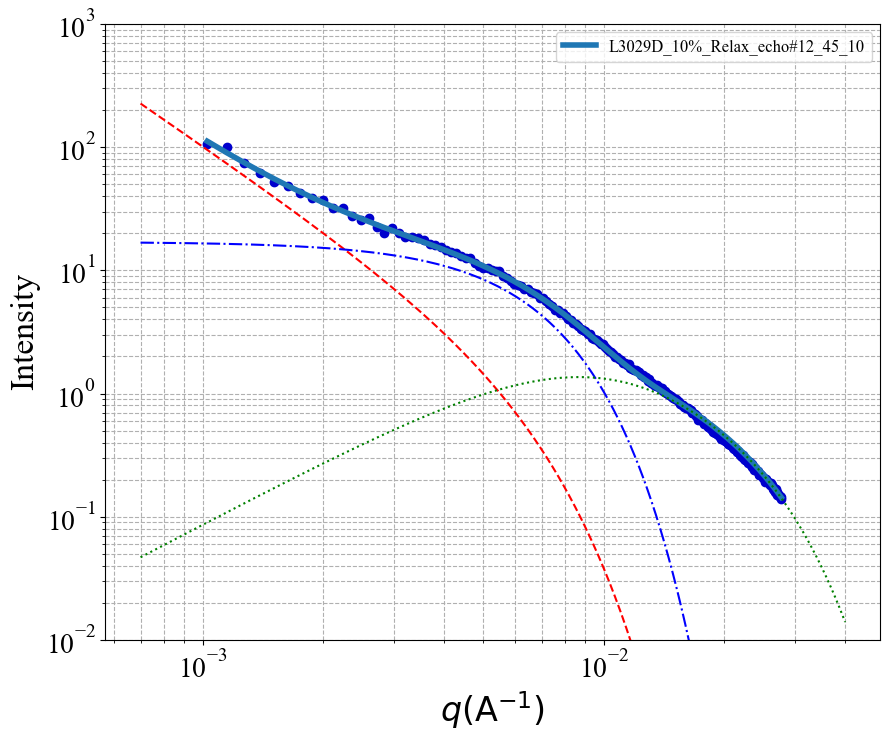


 Chi-square (func_1 with fixed params): 3.3528228673532197
Sample: L3029D_10%_Relax_echo#13_45_10 - Parameter 1: 2.9805e-05
Sample: L3029D_10%_Relax_echo#13_45_10 - Parameter 2: 2.1791e+00
Sample: L3029D_10%_Relax_echo#13_45_10 - Parameter 3: 2.8809e+02
Sample: L3029D_10%_Relax_echo#13_45_10 - Parameter 4: 1.6676e+01
Sample: L3029D_10%_Relax_echo#13_45_10 - Parameter 5: 4.2246e-02
Sample: L3029D_10%_Relax_echo#13_45_10 - Parameter 6: 8.5374e-01
Sample: L3029D_10%_Relax_echo#13_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#13_45_10 - Parameter 8: 4.2581e-03
Sample: L3029D_10%_Relax_echo#13_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#13_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1791 ± 0.0732
Rss: 288.0877 ± 16.9132



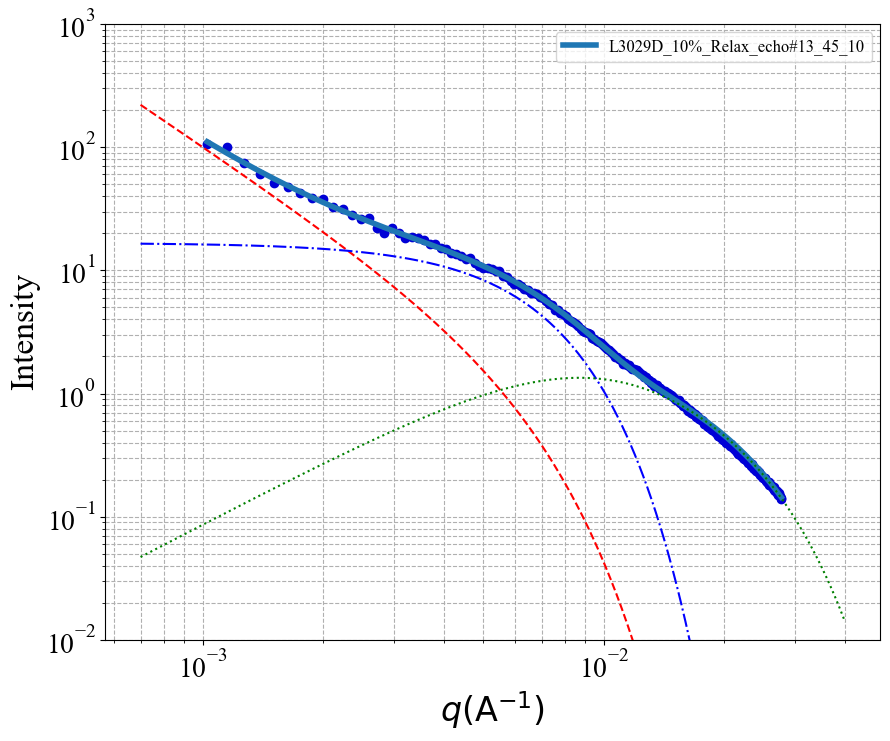


 Chi-square (func_1 with fixed params): 3.098544112979033
Sample: L3029D_10%_Relax_echo#14_45_10 - Parameter 1: 2.7775e-05
Sample: L3029D_10%_Relax_echo#14_45_10 - Parameter 2: 2.1893e+00
Sample: L3029D_10%_Relax_echo#14_45_10 - Parameter 3: 2.9080e+02
Sample: L3029D_10%_Relax_echo#14_45_10 - Parameter 4: 1.7085e+01
Sample: L3029D_10%_Relax_echo#14_45_10 - Parameter 5: 3.3041e-02
Sample: L3029D_10%_Relax_echo#14_45_10 - Parameter 6: 9.1380e-01
Sample: L3029D_10%_Relax_echo#14_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#14_45_10 - Parameter 8: 1.1393e-02
Sample: L3029D_10%_Relax_echo#14_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#14_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1893 ± 0.0706
Rss: 290.8024 ± 15.8584



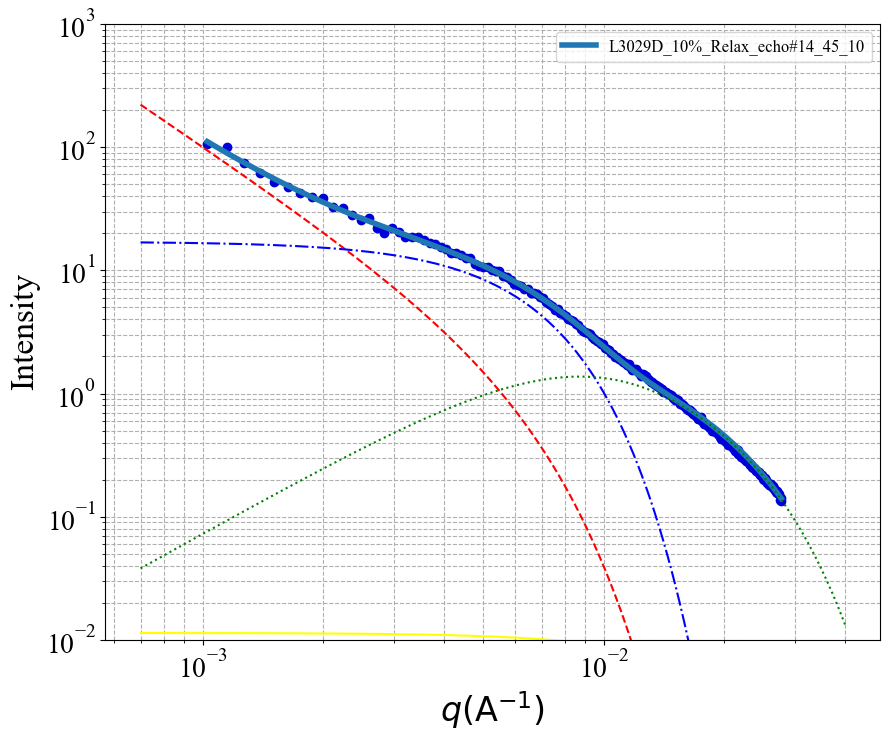


 Chi-square (func_1 with fixed params): 2.964406200172333
Sample: L3029D_10%_Relax_echo#15_45_10 - Parameter 1: 2.6234e-05
Sample: L3029D_10%_Relax_echo#15_45_10 - Parameter 2: 2.1969e+00
Sample: L3029D_10%_Relax_echo#15_45_10 - Parameter 3: 2.9262e+02
Sample: L3029D_10%_Relax_echo#15_45_10 - Parameter 4: 1.7294e+01
Sample: L3029D_10%_Relax_echo#15_45_10 - Parameter 5: 2.7654e-02
Sample: L3029D_10%_Relax_echo#15_45_10 - Parameter 6: 9.5922e-01
Sample: L3029D_10%_Relax_echo#15_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#15_45_10 - Parameter 8: 3.5133e-03
Sample: L3029D_10%_Relax_echo#15_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#15_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1969 ± 0.0697
Rss: 292.6159 ± 15.4135



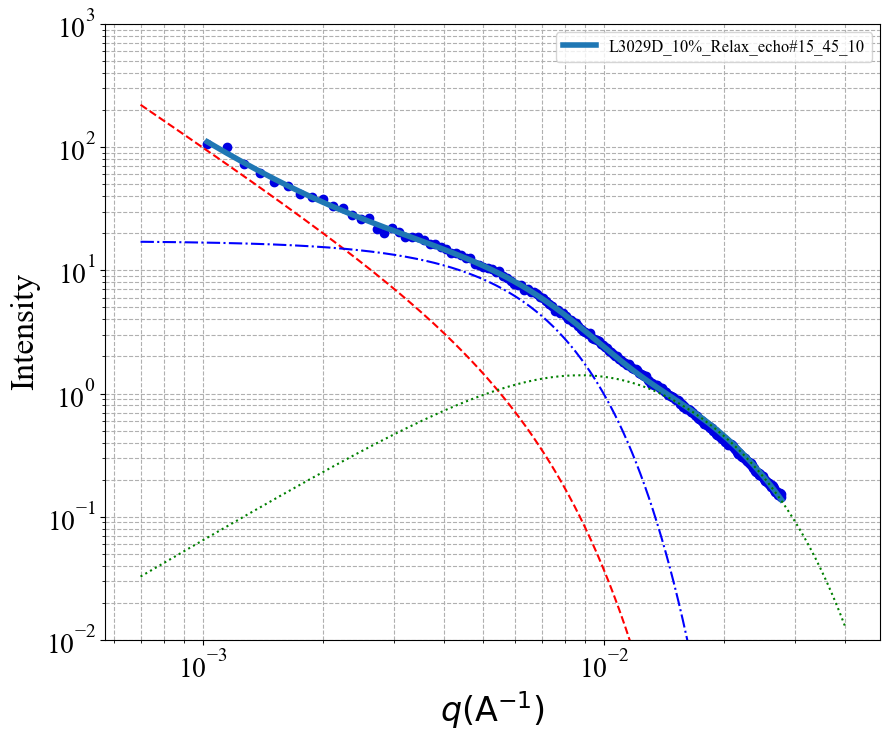


 Chi-square (func_1 with fixed params): 3.3988169203673717
Sample: L3029D_10%_Relax_echo#16_45_10 - Parameter 1: 2.5067e-05
Sample: L3029D_10%_Relax_echo#16_45_10 - Parameter 2: 2.2045e+00
Sample: L3029D_10%_Relax_echo#16_45_10 - Parameter 3: 2.9081e+02
Sample: L3029D_10%_Relax_echo#16_45_10 - Parameter 4: 1.7205e+01
Sample: L3029D_10%_Relax_echo#16_45_10 - Parameter 5: 3.2241e-02
Sample: L3029D_10%_Relax_echo#16_45_10 - Parameter 6: 9.1613e-01
Sample: L3029D_10%_Relax_echo#16_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#16_45_10 - Parameter 8: 2.8636e-02
Sample: L3029D_10%_Relax_echo#16_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#16_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2045 ± 0.0741
Rss: 290.8122 ± 16.3985



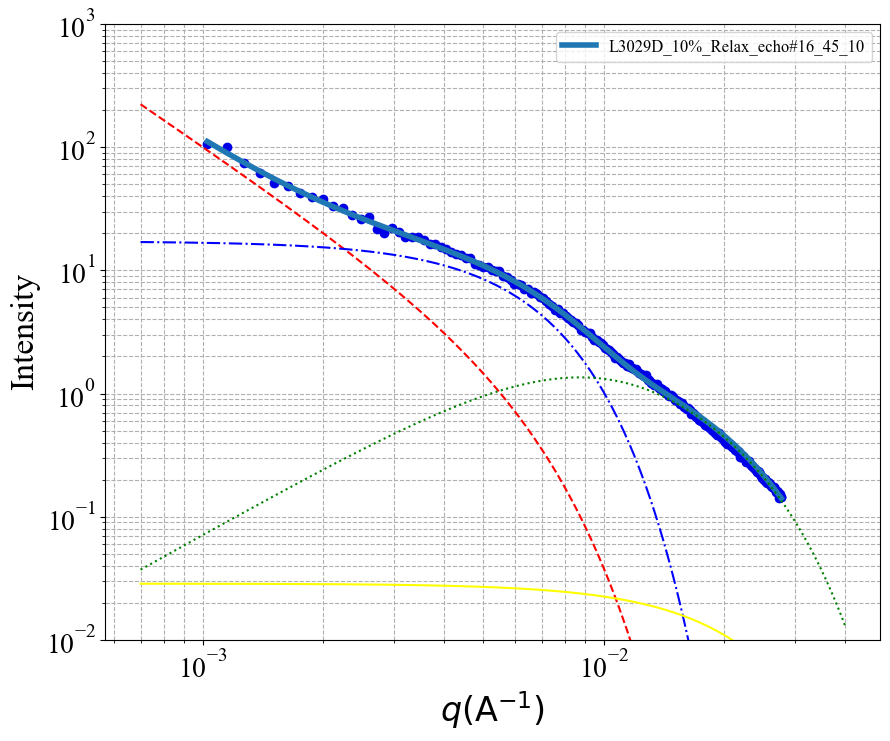


 Chi-square (func_1 with fixed params): 5.798332772426386
Sample: L3029D_10%_Relax_echo#17_45_10 - Parameter 1: 8.8988e-05
Sample: L3029D_10%_Relax_echo#17_45_10 - Parameter 2: 2.0165e+00
Sample: L3029D_10%_Relax_echo#17_45_10 - Parameter 3: 2.7534e+02
Sample: L3029D_10%_Relax_echo#17_45_10 - Parameter 4: 1.4543e+01
Sample: L3029D_10%_Relax_echo#17_45_10 - Parameter 5: 9.1079e-02
Sample: L3029D_10%_Relax_echo#17_45_10 - Parameter 6: 6.5315e-01
Sample: L3029D_10%_Relax_echo#17_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#17_45_10 - Parameter 8: 2.7824e-02
Sample: L3029D_10%_Relax_echo#17_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#17_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0165 ± 0.0853
Rss: 275.3373 ± 23.4060



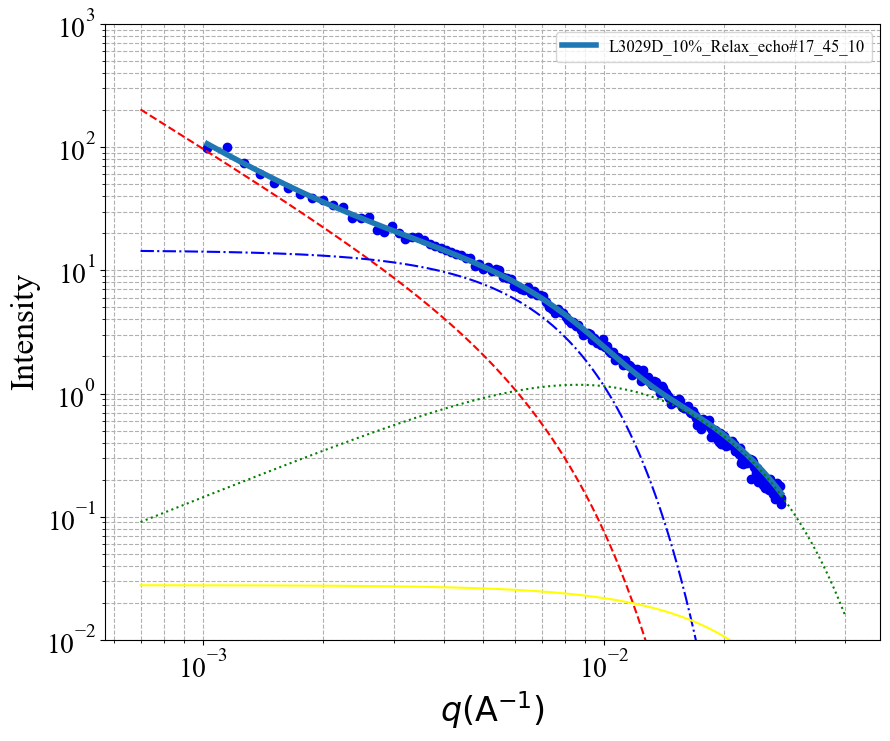


 Chi-square (func_1 with fixed params): 4.766162983148102
Sample: L3029D_10%_Relax_echo#18_45_10 - Parameter 1: 1.6320e-05
Sample: L3029D_10%_Relax_echo#18_45_10 - Parameter 2: 2.2630e+00
Sample: L3029D_10%_Relax_echo#18_45_10 - Parameter 3: 3.0104e+02
Sample: L3029D_10%_Relax_echo#18_45_10 - Parameter 4: 1.8401e+01
Sample: L3029D_10%_Relax_echo#18_45_10 - Parameter 5: 1.3665e-02
Sample: L3029D_10%_Relax_echo#18_45_10 - Parameter 6: 1.1268e+00
Sample: L3029D_10%_Relax_echo#18_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#18_45_10 - Parameter 8: 1.9077e-02
Sample: L3029D_10%_Relax_echo#18_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#18_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2630 ± 0.0849
Rss: 301.0378 ± 17.3890



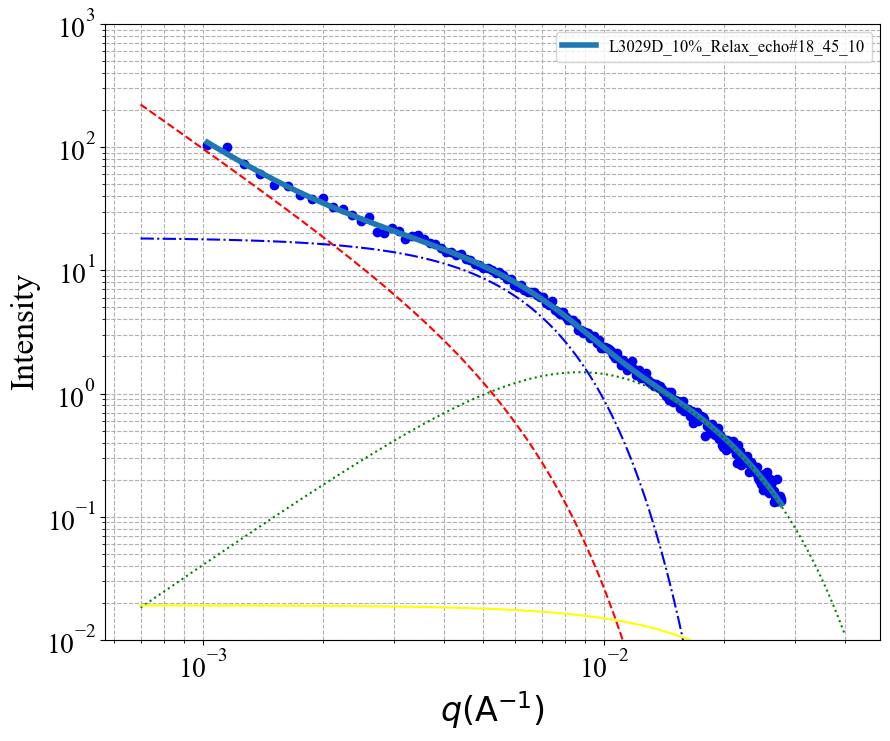


 Chi-square (func_1 with fixed params): 4.516146521644792
Sample: L3029D_10%_Relax_echo#19_45_10 - Parameter 1: 2.4987e-05
Sample: L3029D_10%_Relax_echo#19_45_10 - Parameter 2: 2.2018e+00
Sample: L3029D_10%_Relax_echo#19_45_10 - Parameter 3: 2.9574e+02
Sample: L3029D_10%_Relax_echo#19_45_10 - Parameter 4: 1.7516e+01
Sample: L3029D_10%_Relax_echo#19_45_10 - Parameter 5: 1.6852e-02
Sample: L3029D_10%_Relax_echo#19_45_10 - Parameter 6: 1.0802e+00
Sample: L3029D_10%_Relax_echo#19_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#19_45_10 - Parameter 8: 5.5124e-03
Sample: L3029D_10%_Relax_echo#19_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#19_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2018 ± 0.0841
Rss: 295.7413 ± 18.2602



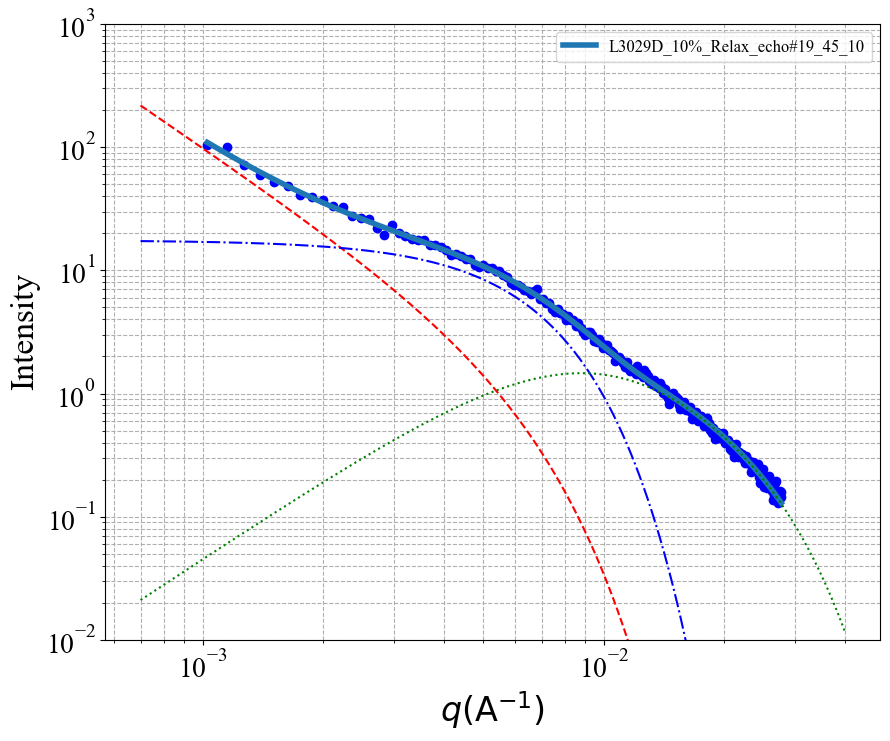


 Chi-square (func_1 with fixed params): 4.227781822128089
Sample: L3029D_10%_Relax_echo#20_45_10 - Parameter 1: 6.5839e-06
Sample: L3029D_10%_Relax_echo#20_45_10 - Parameter 2: 2.3967e+00
Sample: L3029D_10%_Relax_echo#20_45_10 - Parameter 3: 3.1958e+02
Sample: L3029D_10%_Relax_echo#20_45_10 - Parameter 4: 2.0707e+01
Sample: L3029D_10%_Relax_echo#20_45_10 - Parameter 5: 3.9587e-03
Sample: L3029D_10%_Relax_echo#20_45_10 - Parameter 6: 1.4311e+00
Sample: L3029D_10%_Relax_echo#20_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#20_45_10 - Parameter 8: 2.8296e-03
Sample: L3029D_10%_Relax_echo#20_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#20_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3967 ± 0.0731
Rss: 319.5847 ± 14.5574



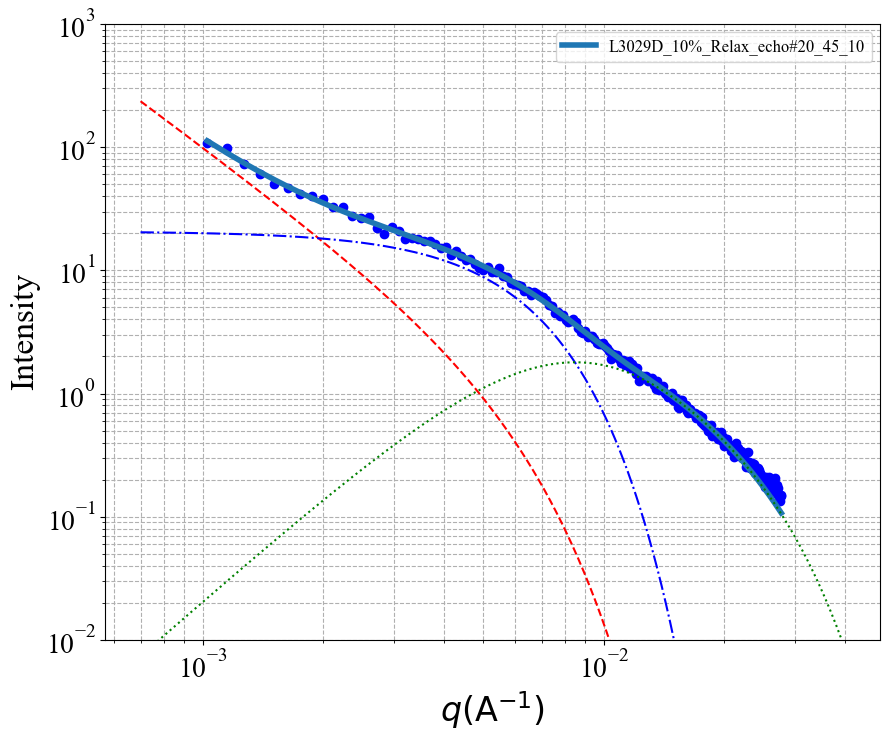


 Chi-square (func_1 with fixed params): 4.340428775353356
Sample: L3029D_10%_Relax_echo#21_45_10 - Parameter 1: 1.2124e-05
Sample: L3029D_10%_Relax_echo#21_45_10 - Parameter 2: 2.3071e+00
Sample: L3029D_10%_Relax_echo#21_45_10 - Parameter 3: 3.0289e+02
Sample: L3029D_10%_Relax_echo#21_45_10 - Parameter 4: 1.8990e+01
Sample: L3029D_10%_Relax_echo#21_45_10 - Parameter 5: 1.3219e-02
Sample: L3029D_10%_Relax_echo#21_45_10 - Parameter 6: 1.1404e+00
Sample: L3029D_10%_Relax_echo#21_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#21_45_10 - Parameter 8: 2.5113e-03
Sample: L3029D_10%_Relax_echo#21_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#21_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3071 ± 0.0783
Rss: 302.8898 ± 15.5628



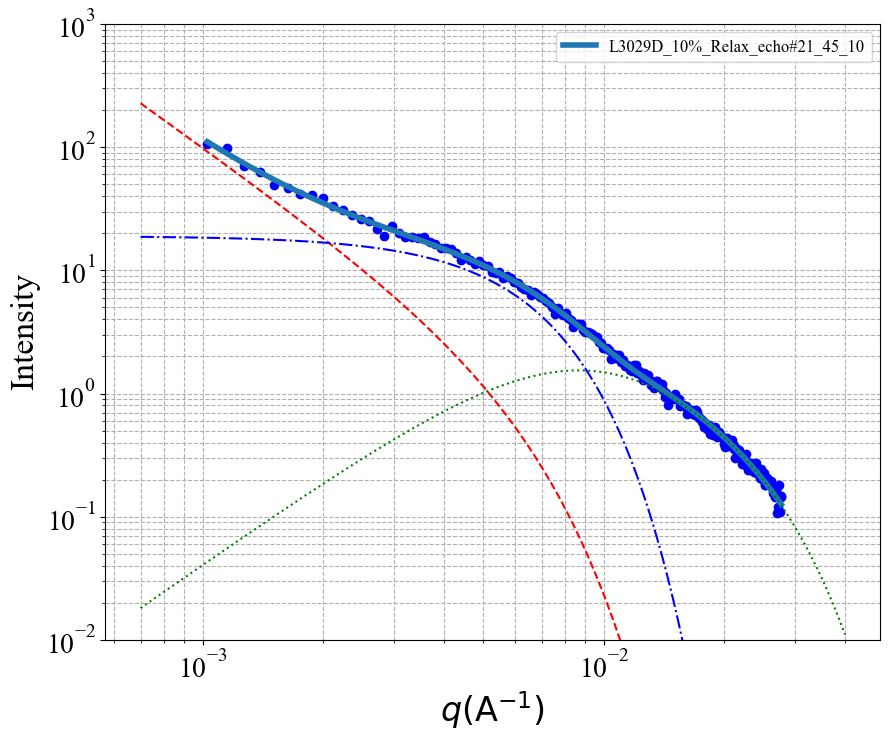


 Chi-square (func_1 with fixed params): 4.405258449107724
Sample: L3029D_10%_Relax_echo#22_45_10 - Parameter 1: 3.8902e-05
Sample: L3029D_10%_Relax_echo#22_45_10 - Parameter 2: 2.1368e+00
Sample: L3029D_10%_Relax_echo#22_45_10 - Parameter 3: 2.8652e+02
Sample: L3029D_10%_Relax_echo#22_45_10 - Parameter 4: 1.6479e+01
Sample: L3029D_10%_Relax_echo#22_45_10 - Parameter 5: 5.7115e-02
Sample: L3029D_10%_Relax_echo#22_45_10 - Parameter 6: 7.7630e-01
Sample: L3029D_10%_Relax_echo#22_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#22_45_10 - Parameter 8: 5.4286e-03
Sample: L3029D_10%_Relax_echo#22_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#22_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1368 ± 0.0691
Rss: 286.5209 ± 16.0652



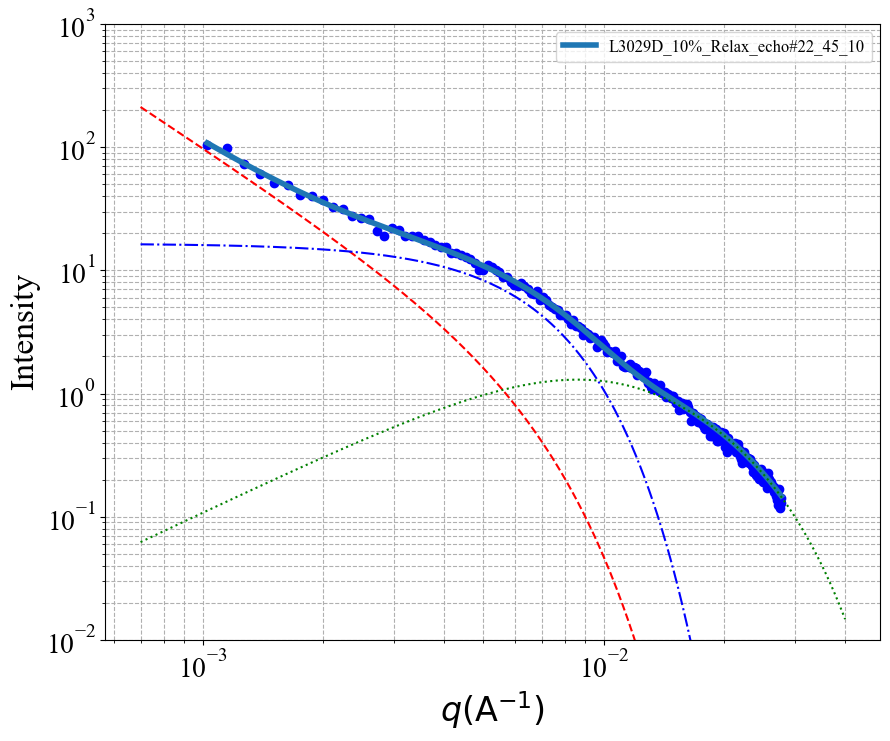


 Chi-square (func_1 with fixed params): 5.260933863994995
Sample: L3029D_10%_Relax_echo#23_45_10 - Parameter 1: 3.5032e-05
Sample: L3029D_10%_Relax_echo#23_45_10 - Parameter 2: 2.1572e+00
Sample: L3029D_10%_Relax_echo#23_45_10 - Parameter 3: 2.8589e+02
Sample: L3029D_10%_Relax_echo#23_45_10 - Parameter 4: 1.6224e+01
Sample: L3029D_10%_Relax_echo#23_45_10 - Parameter 5: 4.9365e-02
Sample: L3029D_10%_Relax_echo#23_45_10 - Parameter 6: 8.1088e-01
Sample: L3029D_10%_Relax_echo#23_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#23_45_10 - Parameter 8: 6.2571e-03
Sample: L3029D_10%_Relax_echo#23_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#23_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1572 ± 0.0814
Rss: 285.8931 ± 19.6425



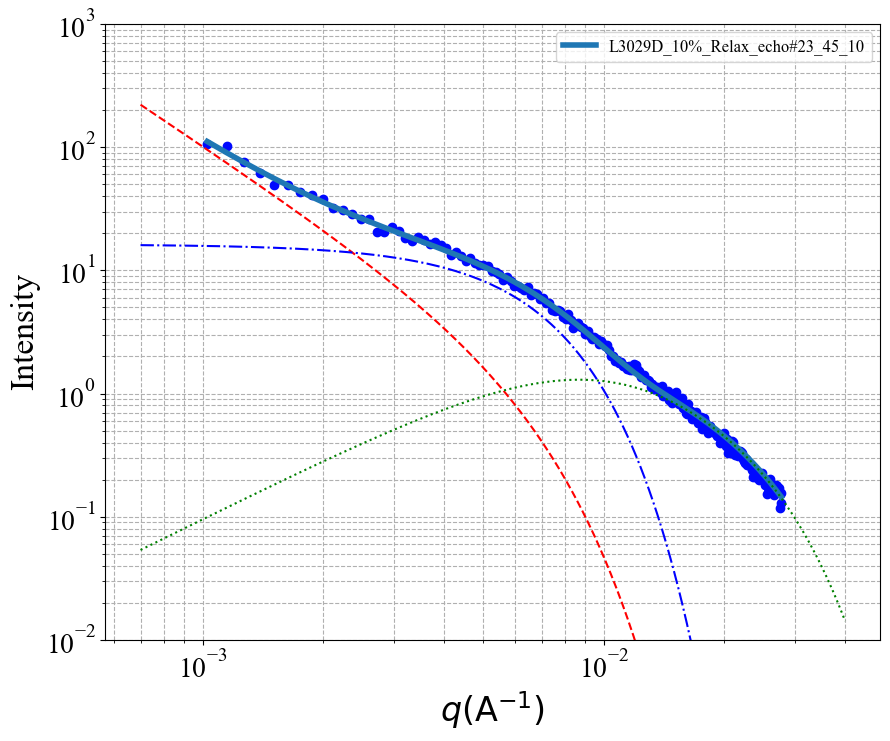


 Chi-square (func_1 with fixed params): 6.863312597294303
Sample: L3029D_10%_Relax_echo#24_45_10 - Parameter 1: 4.2417e-05
Sample: L3029D_10%_Relax_echo#24_45_10 - Parameter 2: 2.1262e+00
Sample: L3029D_10%_Relax_echo#24_45_10 - Parameter 3: 2.8524e+02
Sample: L3029D_10%_Relax_echo#24_45_10 - Parameter 4: 1.5905e+01
Sample: L3029D_10%_Relax_echo#24_45_10 - Parameter 5: 5.7937e-02
Sample: L3029D_10%_Relax_echo#24_45_10 - Parameter 6: 7.7867e-01
Sample: L3029D_10%_Relax_echo#24_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#24_45_10 - Parameter 8: 7.4605e-03
Sample: L3029D_10%_Relax_echo#24_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#24_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1262 ± 0.1021
Rss: 285.2411 ± 25.0872



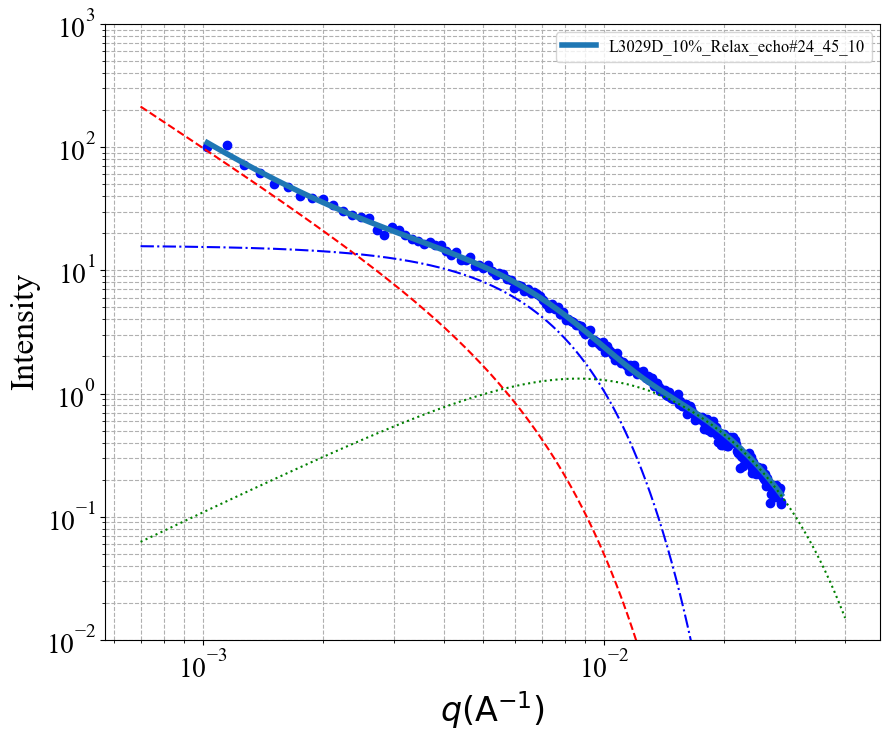


 Chi-square (func_1 with fixed params): 5.3482179357184485
Sample: L3029D_10%_Relax_echo#25_45_10 - Parameter 1: 1.1739e-05
Sample: L3029D_10%_Relax_echo#25_45_10 - Parameter 2: 2.3096e+00
Sample: L3029D_10%_Relax_echo#25_45_10 - Parameter 3: 3.0098e+02
Sample: L3029D_10%_Relax_echo#25_45_10 - Parameter 4: 1.8748e+01
Sample: L3029D_10%_Relax_echo#25_45_10 - Parameter 5: 6.2902e-05
Sample: L3029D_10%_Relax_echo#25_45_10 - Parameter 6: 2.2835e+00
Sample: L3029D_10%_Relax_echo#25_45_10 - Parameter 7: 7.9789e+01
Sample: L3029D_10%_Relax_echo#25_45_10 - Parameter 8: 5.3350e-01
Sample: L3029D_10%_Relax_echo#25_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#25_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3096 ± 0.0921
Rss: 300.9827 ± 18.0031



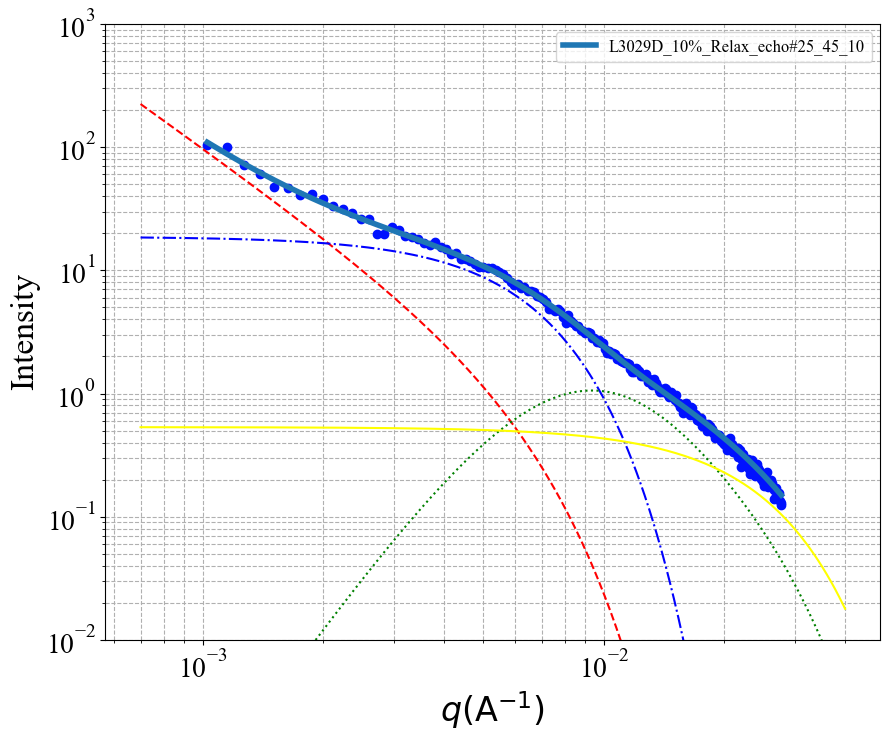


 Chi-square (func_1 with fixed params): 5.249774783750172
Sample: L3029D_10%_Relax_echo#26_45_10 - Parameter 1: 2.0195e-05
Sample: L3029D_10%_Relax_echo#26_45_10 - Parameter 2: 2.2324e+00
Sample: L3029D_10%_Relax_echo#26_45_10 - Parameter 3: 3.0270e+02
Sample: L3029D_10%_Relax_echo#26_45_10 - Parameter 4: 1.8651e+01
Sample: L3029D_10%_Relax_echo#26_45_10 - Parameter 5: 6.7770e-03
Sample: L3029D_10%_Relax_echo#26_45_10 - Parameter 6: 1.2964e+00
Sample: L3029D_10%_Relax_echo#26_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#26_45_10 - Parameter 8: 6.5329e-03
Sample: L3029D_10%_Relax_echo#26_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#26_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2324 ± 0.0858
Rss: 302.7000 ± 17.9334



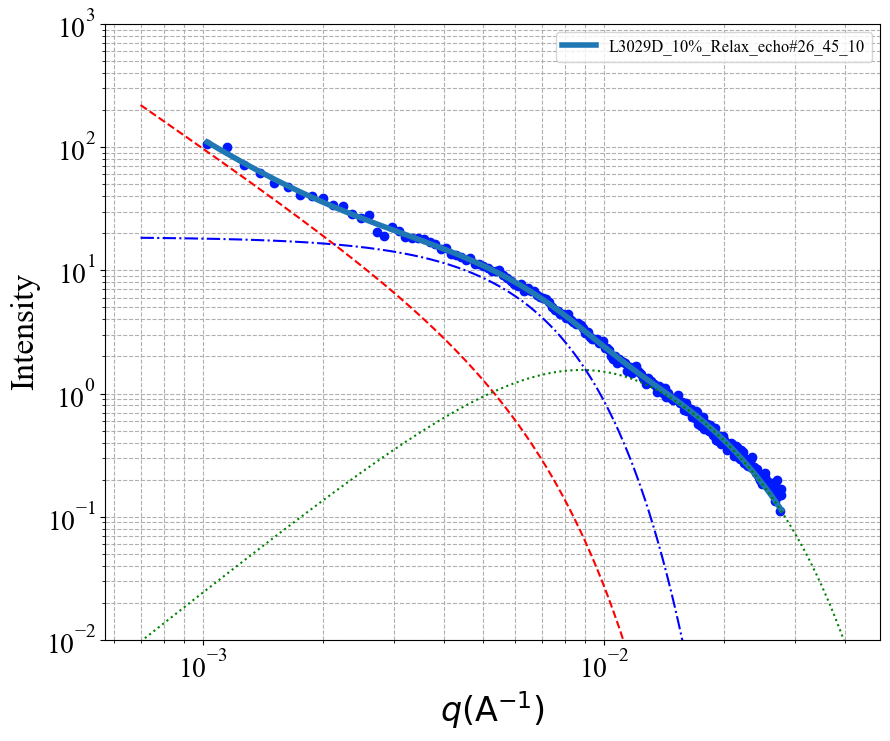


 Chi-square (func_1 with fixed params): 4.713081437549648
Sample: L3029D_10%_Relax_echo#27_45_10 - Parameter 1: 1.5803e-05
Sample: L3029D_10%_Relax_echo#27_45_10 - Parameter 2: 2.2703e+00
Sample: L3029D_10%_Relax_echo#27_45_10 - Parameter 3: 3.0364e+02
Sample: L3029D_10%_Relax_echo#27_45_10 - Parameter 4: 1.8701e+01
Sample: L3029D_10%_Relax_echo#27_45_10 - Parameter 5: 9.9876e-03
Sample: L3029D_10%_Relax_echo#27_45_10 - Parameter 6: 1.2074e+00
Sample: L3029D_10%_Relax_echo#27_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#27_45_10 - Parameter 8: 1.3758e-04
Sample: L3029D_10%_Relax_echo#27_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#27_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2703 ± 0.0873
Rss: 303.6435 ± 18.2975



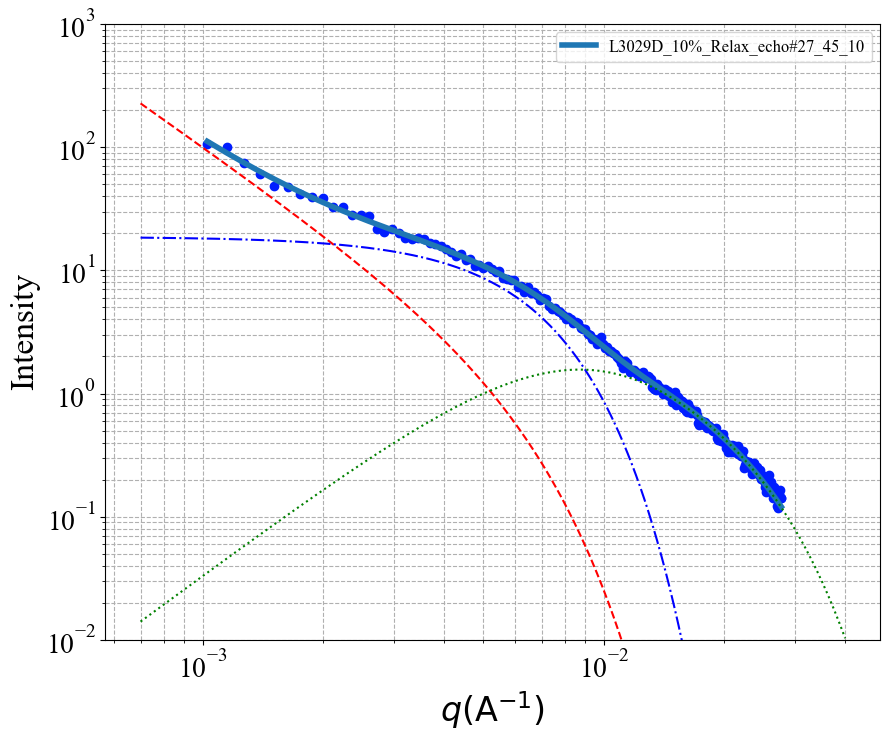


 Chi-square (func_1 with fixed params): 4.8220628786334
Sample: L3029D_10%_Relax_echo#28_45_10 - Parameter 1: 3.7050e-05
Sample: L3029D_10%_Relax_echo#28_45_10 - Parameter 2: 2.1440e+00
Sample: L3029D_10%_Relax_echo#28_45_10 - Parameter 3: 2.9023e+02
Sample: L3029D_10%_Relax_echo#28_45_10 - Parameter 4: 1.6659e+01
Sample: L3029D_10%_Relax_echo#28_45_10 - Parameter 5: 3.9195e-02
Sample: L3029D_10%_Relax_echo#28_45_10 - Parameter 6: 8.7030e-01
Sample: L3029D_10%_Relax_echo#28_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#28_45_10 - Parameter 8: 1.5096e-02
Sample: L3029D_10%_Relax_echo#28_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#28_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1440 ± 0.0789
Rss: 290.2285 ± 18.0528



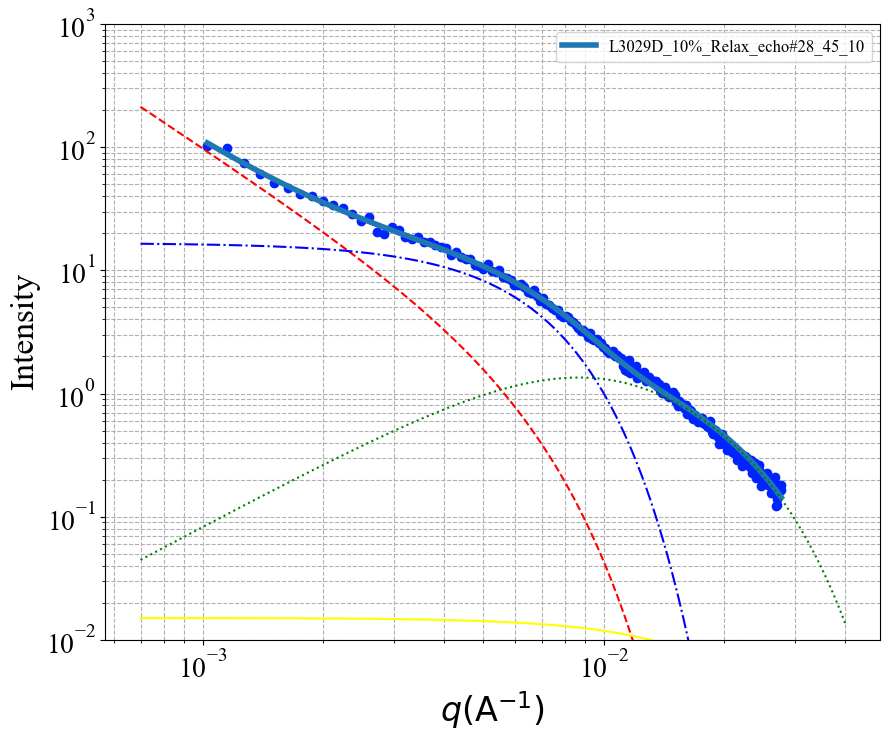


 Chi-square (func_1 with fixed params): 4.675524836253774
Sample: L3029D_10%_Relax_echo#29_45_10 - Parameter 1: 7.7227e-06
Sample: L3029D_10%_Relax_echo#29_45_10 - Parameter 2: 2.3746e+00
Sample: L3029D_10%_Relax_echo#29_45_10 - Parameter 3: 3.0913e+02
Sample: L3029D_10%_Relax_echo#29_45_10 - Parameter 4: 1.9761e+01
Sample: L3029D_10%_Relax_echo#29_45_10 - Parameter 5: 8.4091e-03
Sample: L3029D_10%_Relax_echo#29_45_10 - Parameter 6: 1.2503e+00
Sample: L3029D_10%_Relax_echo#29_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#29_45_10 - Parameter 8: 3.5391e-03
Sample: L3029D_10%_Relax_echo#29_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#29_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3746 ± 0.0902
Rss: 309.1314 ± 17.7201



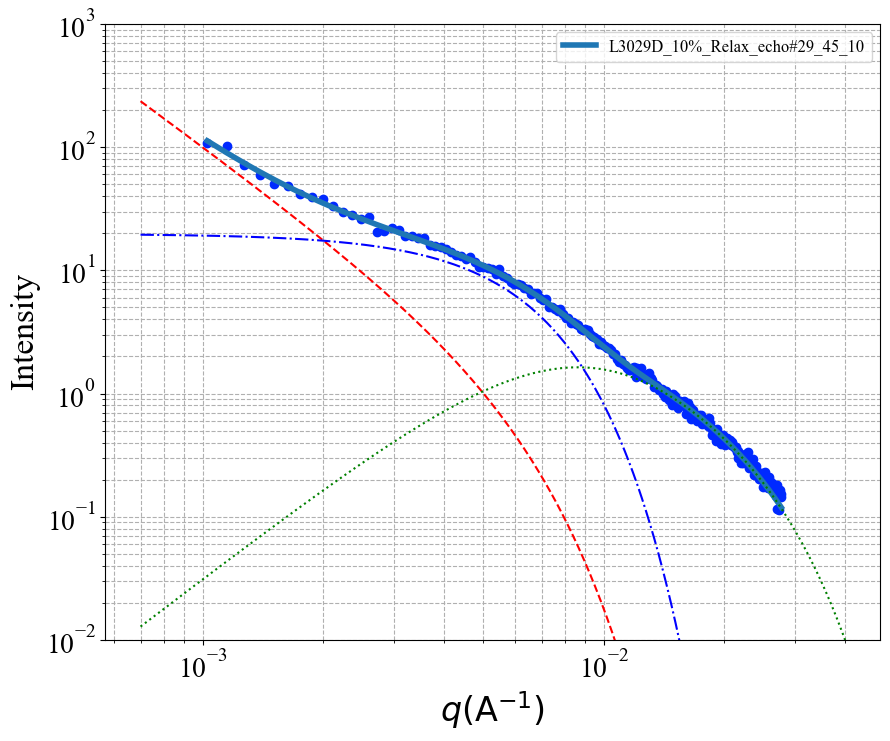


 Chi-square (func_1 with fixed params): 4.102605711668835
Sample: L3029D_10%_Relax_echo#30_45_10 - Parameter 1: 2.9100e-05
Sample: L3029D_10%_Relax_echo#30_45_10 - Parameter 2: 2.1745e+00
Sample: L3029D_10%_Relax_echo#30_45_10 - Parameter 3: 3.0184e+02
Sample: L3029D_10%_Relax_echo#30_45_10 - Parameter 4: 1.8110e+01
Sample: L3029D_10%_Relax_echo#30_45_10 - Parameter 5: 1.1986e-02
Sample: L3029D_10%_Relax_echo#30_45_10 - Parameter 6: 1.1622e+00
Sample: L3029D_10%_Relax_echo#30_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#30_45_10 - Parameter 8: 5.2839e-03
Sample: L3029D_10%_Relax_echo#30_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#30_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1745 ± 0.0782
Rss: 301.8393 ± 16.3833



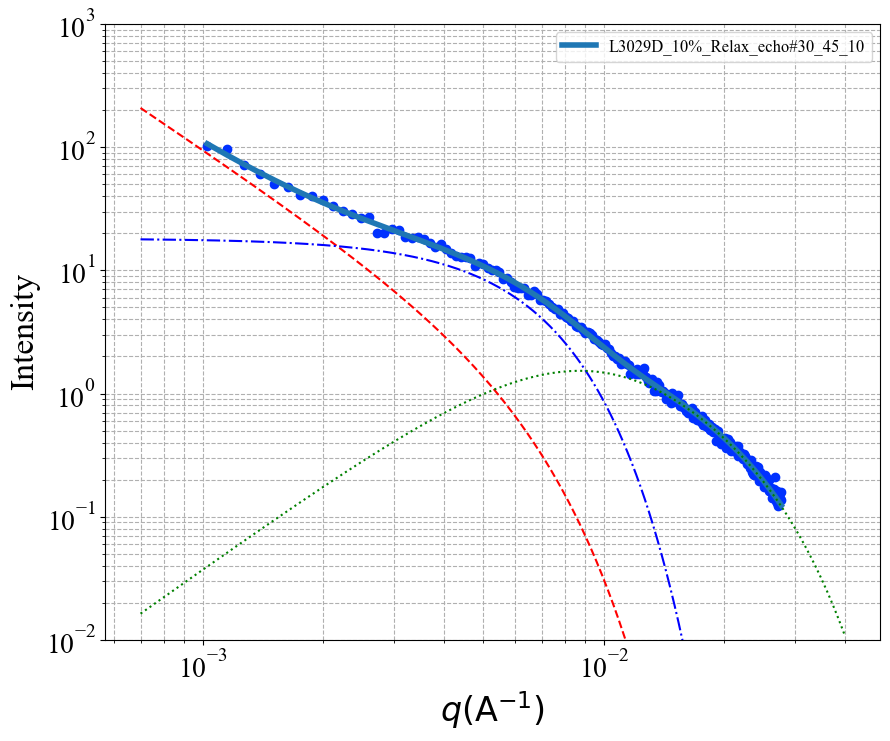


 Chi-square (func_1 with fixed params): 7.124890523917262
Sample: L3029D_10%_Relax_echo#31_45_10 - Parameter 1: 3.7192e-05
Sample: L3029D_10%_Relax_echo#31_45_10 - Parameter 2: 2.1483e+00
Sample: L3029D_10%_Relax_echo#31_45_10 - Parameter 3: 2.8478e+02
Sample: L3029D_10%_Relax_echo#31_45_10 - Parameter 4: 1.6064e+01
Sample: L3029D_10%_Relax_echo#31_45_10 - Parameter 5: 6.8234e-02
Sample: L3029D_10%_Relax_echo#31_45_10 - Parameter 6: 7.3538e-01
Sample: L3029D_10%_Relax_echo#31_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#31_45_10 - Parameter 8: 8.7331e-03
Sample: L3029D_10%_Relax_echo#31_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#31_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1483 ± 0.0963
Rss: 284.7809 ± 23.9487



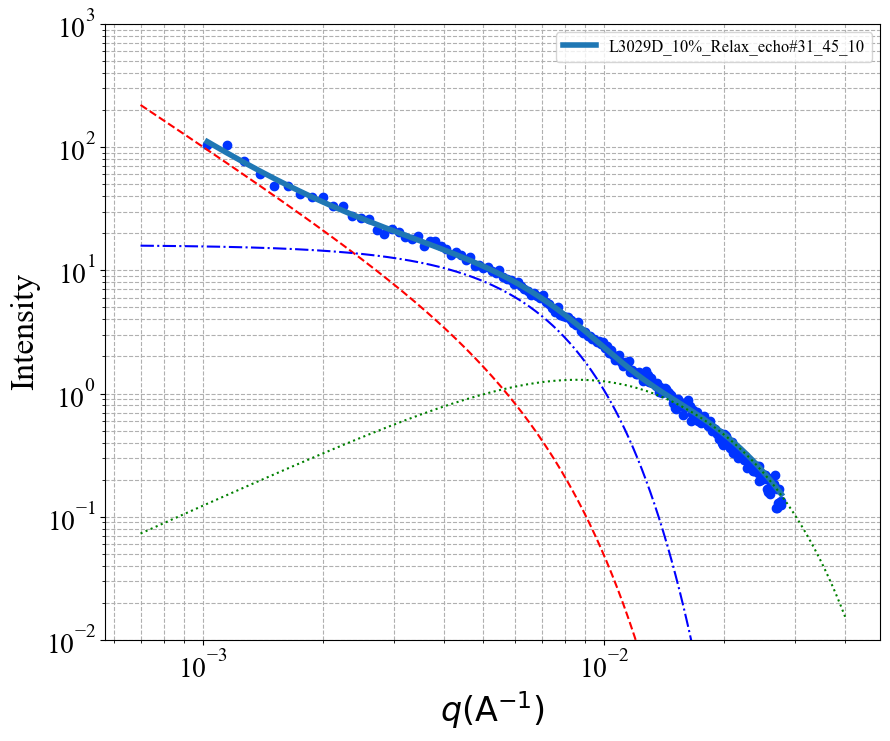


 Chi-square (func_1 with fixed params): 4.718617634554664
Sample: L3029D_10%_Relax_echo#32_45_10 - Parameter 1: 1.4904e-05
Sample: L3029D_10%_Relax_echo#32_45_10 - Parameter 2: 2.2730e+00
Sample: L3029D_10%_Relax_echo#32_45_10 - Parameter 3: 3.0084e+02
Sample: L3029D_10%_Relax_echo#32_45_10 - Parameter 4: 1.8750e+01
Sample: L3029D_10%_Relax_echo#32_45_10 - Parameter 5: 4.8726e-05
Sample: L3029D_10%_Relax_echo#32_45_10 - Parameter 6: 2.3444e+00
Sample: L3029D_10%_Relax_echo#32_45_10 - Parameter 7: 8.0541e+01
Sample: L3029D_10%_Relax_echo#32_45_10 - Parameter 8: 5.4268e-01
Sample: L3029D_10%_Relax_echo#32_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#32_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2730 ± 0.0865
Rss: 300.8435 ± 16.9961



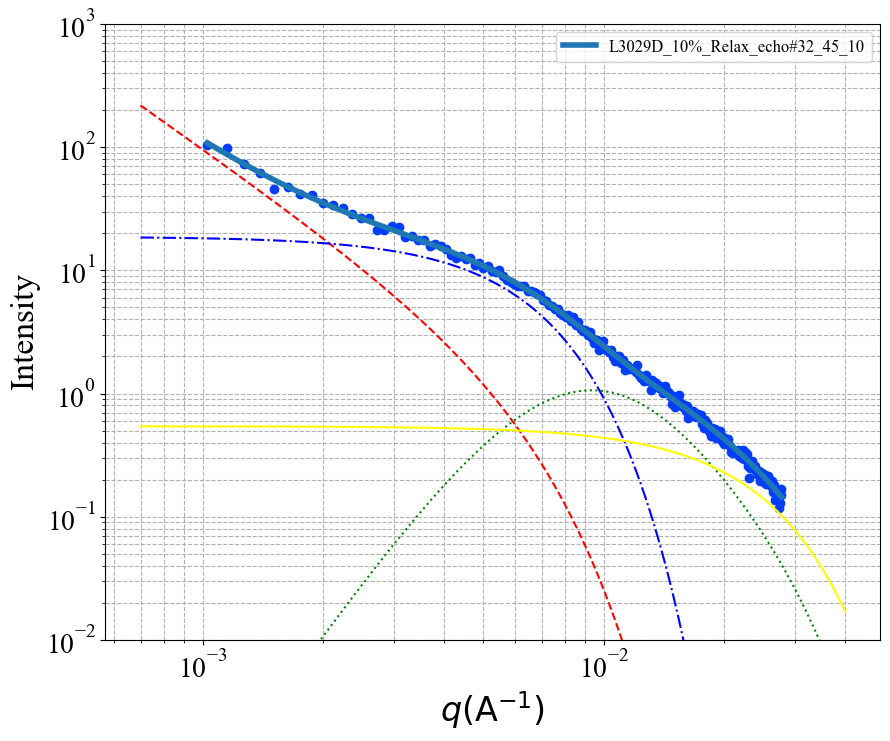


 Chi-square (func_1 with fixed params): 5.060248017300358
Sample: L3029D_10%_Relax_echo#33_45_10 - Parameter 1: 2.3175e-05
Sample: L3029D_10%_Relax_echo#33_45_10 - Parameter 2: 2.2150e+00
Sample: L3029D_10%_Relax_echo#33_45_10 - Parameter 3: 2.9115e+02
Sample: L3029D_10%_Relax_echo#33_45_10 - Parameter 4: 1.7168e+01
Sample: L3029D_10%_Relax_echo#33_45_10 - Parameter 5: 5.1378e-02
Sample: L3029D_10%_Relax_echo#33_45_10 - Parameter 6: 8.0610e-01
Sample: L3029D_10%_Relax_echo#33_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#33_45_10 - Parameter 8: 8.6543e-03
Sample: L3029D_10%_Relax_echo#33_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#33_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2150 ± 0.0834
Rss: 291.1513 ± 18.7544



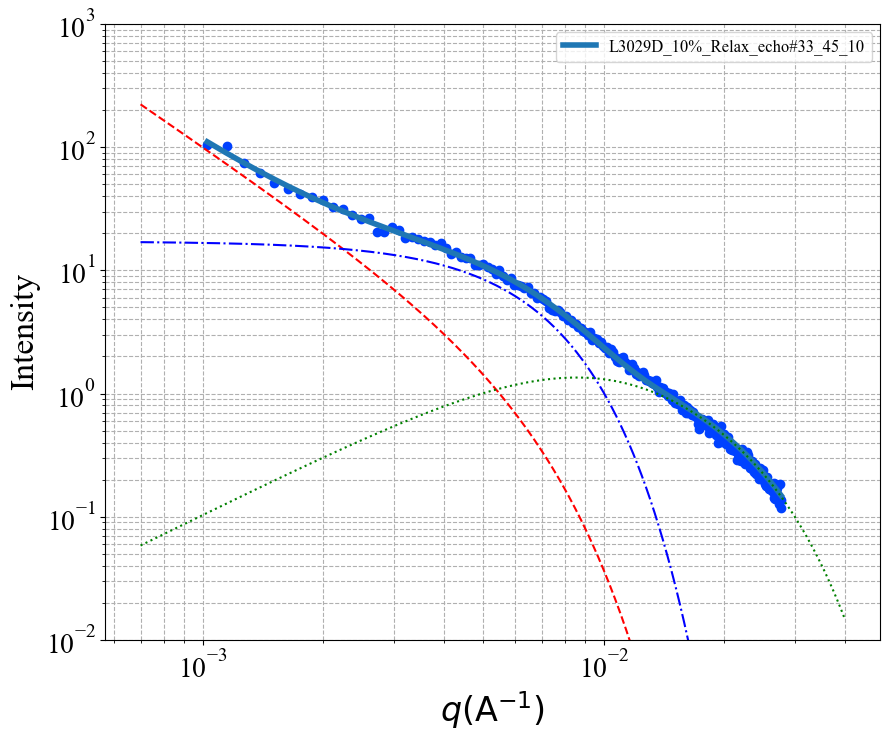


 Chi-square (func_1 with fixed params): 3.802827500868586
Sample: L3029D_10%_Relax_echo#34_45_10 - Parameter 1: 2.8229e-05
Sample: L3029D_10%_Relax_echo#34_45_10 - Parameter 2: 2.1845e+00
Sample: L3029D_10%_Relax_echo#34_45_10 - Parameter 3: 2.9718e+02
Sample: L3029D_10%_Relax_echo#34_45_10 - Parameter 4: 1.7832e+01
Sample: L3029D_10%_Relax_echo#34_45_10 - Parameter 5: 1.9800e-02
Sample: L3029D_10%_Relax_echo#34_45_10 - Parameter 6: 1.0349e+00
Sample: L3029D_10%_Relax_echo#34_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#34_45_10 - Parameter 8: 1.6141e-02
Sample: L3029D_10%_Relax_echo#34_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#34_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1845 ± 0.0725
Rss: 297.1829 ± 15.5331



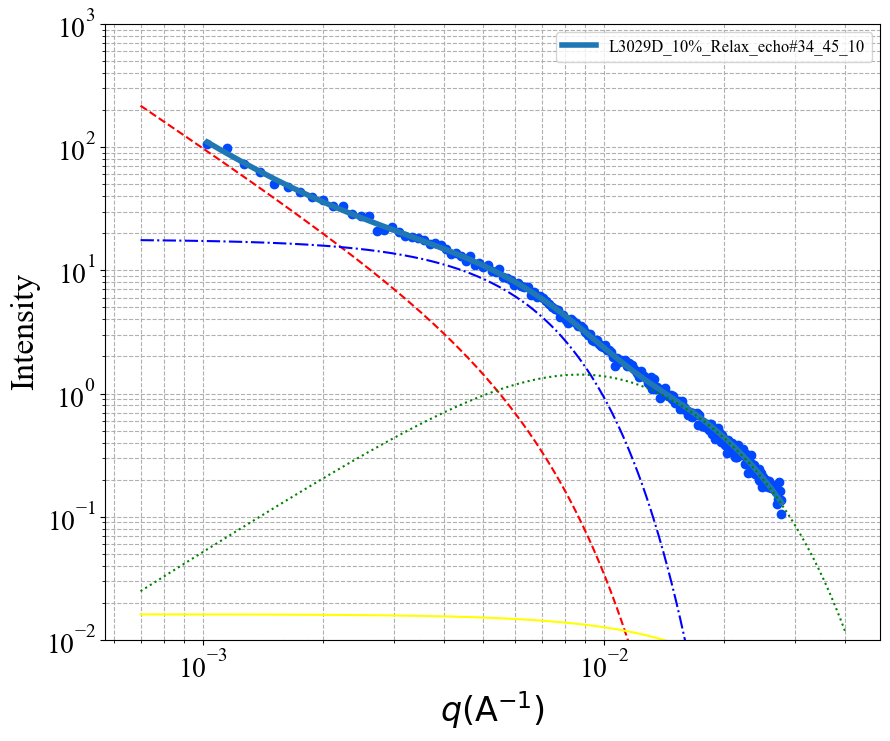


 Chi-square (func_1 with fixed params): 4.420759445926636
Sample: L3029D_10%_Relax_echo#35_45_10 - Parameter 1: 1.6362e-05
Sample: L3029D_10%_Relax_echo#35_45_10 - Parameter 2: 2.2605e+00
Sample: L3029D_10%_Relax_echo#35_45_10 - Parameter 3: 3.0497e+02
Sample: L3029D_10%_Relax_echo#35_45_10 - Parameter 4: 1.8794e+01
Sample: L3029D_10%_Relax_echo#35_45_10 - Parameter 5: 7.1803e-03
Sample: L3029D_10%_Relax_echo#35_45_10 - Parameter 6: 1.2821e+00
Sample: L3029D_10%_Relax_echo#35_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#35_45_10 - Parameter 8: 7.5597e-03
Sample: L3029D_10%_Relax_echo#35_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#35_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2605 ± 0.0840
Rss: 304.9716 ± 17.1190



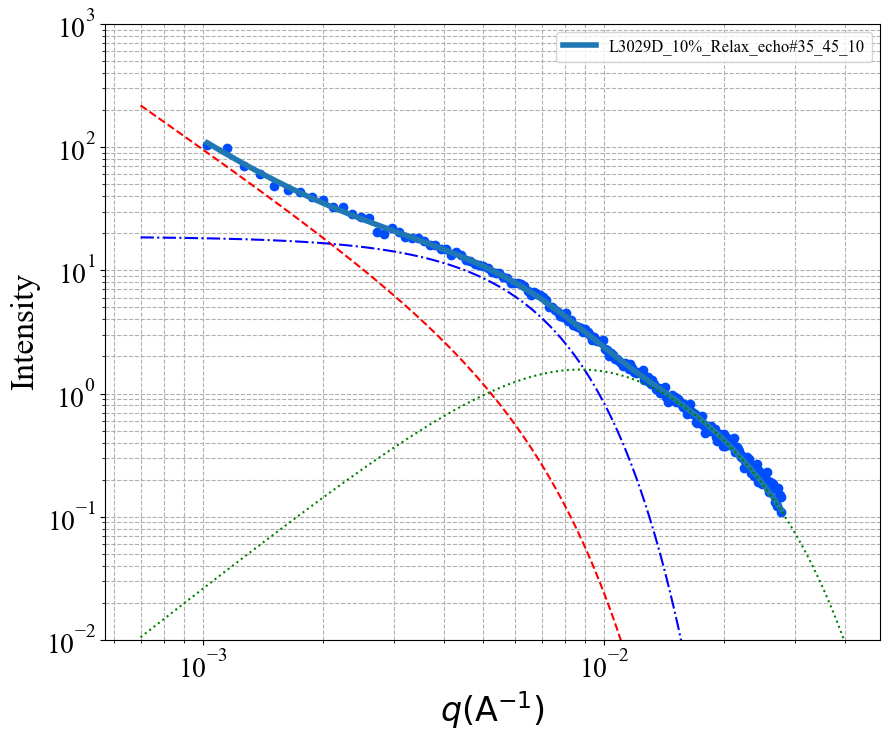


 Chi-square (func_1 with fixed params): 5.584947771515534
Sample: L3029D_10%_Relax_echo#36_45_10 - Parameter 1: 7.4784e-06
Sample: L3029D_10%_Relax_echo#36_45_10 - Parameter 2: 2.3806e+00
Sample: L3029D_10%_Relax_echo#36_45_10 - Parameter 3: 3.1437e+02
Sample: L3029D_10%_Relax_echo#36_45_10 - Parameter 4: 2.0227e+01
Sample: L3029D_10%_Relax_echo#36_45_10 - Parameter 5: 4.2688e-03
Sample: L3029D_10%_Relax_echo#36_45_10 - Parameter 6: 1.4081e+00
Sample: L3029D_10%_Relax_echo#36_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#36_45_10 - Parameter 8: 6.0130e-03
Sample: L3029D_10%_Relax_echo#36_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#36_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3806 ± 0.0919
Rss: 314.3688 ± 18.5156



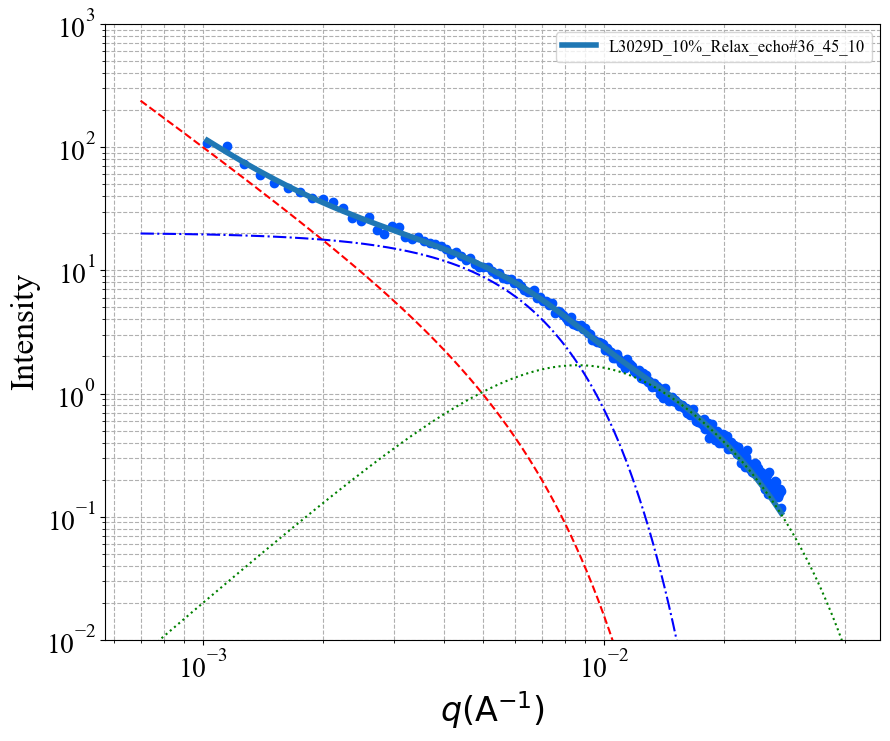


 Chi-square (func_1 with fixed params): 5.26932305969428
Sample: L3029D_10%_Relax_echo#37_45_10 - Parameter 1: 1.7487e-05
Sample: L3029D_10%_Relax_echo#37_45_10 - Parameter 2: 2.2572e+00
Sample: L3029D_10%_Relax_echo#37_45_10 - Parameter 3: 2.9611e+02
Sample: L3029D_10%_Relax_echo#37_45_10 - Parameter 4: 1.7811e+01
Sample: L3029D_10%_Relax_echo#37_45_10 - Parameter 5: 3.8150e-02
Sample: L3029D_10%_Relax_echo#37_45_10 - Parameter 6: 8.8009e-01
Sample: L3029D_10%_Relax_echo#37_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#37_45_10 - Parameter 8: 5.1760e-03
Sample: L3029D_10%_Relax_echo#37_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#37_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2572 ± 0.0881
Rss: 296.1101 ± 19.0924



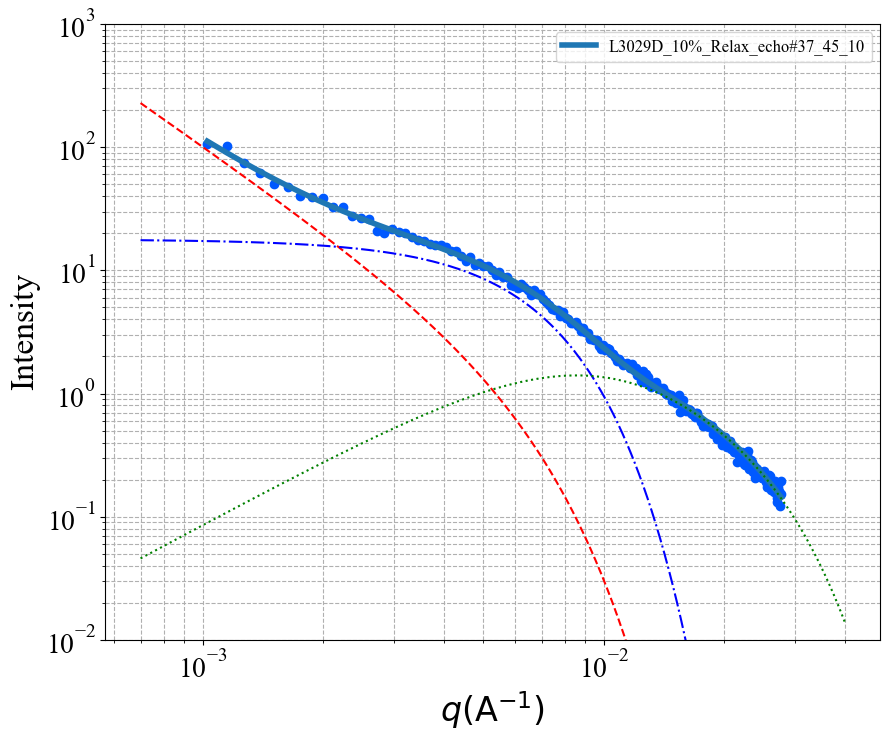


 Chi-square (func_1 with fixed params): 4.682474917690193
Sample: L3029D_10%_Relax_echo#38_45_10 - Parameter 1: 1.6066e-05
Sample: L3029D_10%_Relax_echo#38_45_10 - Parameter 2: 2.2653e+00
Sample: L3029D_10%_Relax_echo#38_45_10 - Parameter 3: 3.0210e+02
Sample: L3029D_10%_Relax_echo#38_45_10 - Parameter 4: 1.8566e+01
Sample: L3029D_10%_Relax_echo#38_45_10 - Parameter 5: 2.3861e-02
Sample: L3029D_10%_Relax_echo#38_45_10 - Parameter 6: 9.9692e-01
Sample: L3029D_10%_Relax_echo#38_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#38_45_10 - Parameter 8: 1.0054e-02
Sample: L3029D_10%_Relax_echo#38_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#38_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2653 ± 0.0845
Rss: 302.0974 ± 17.2356



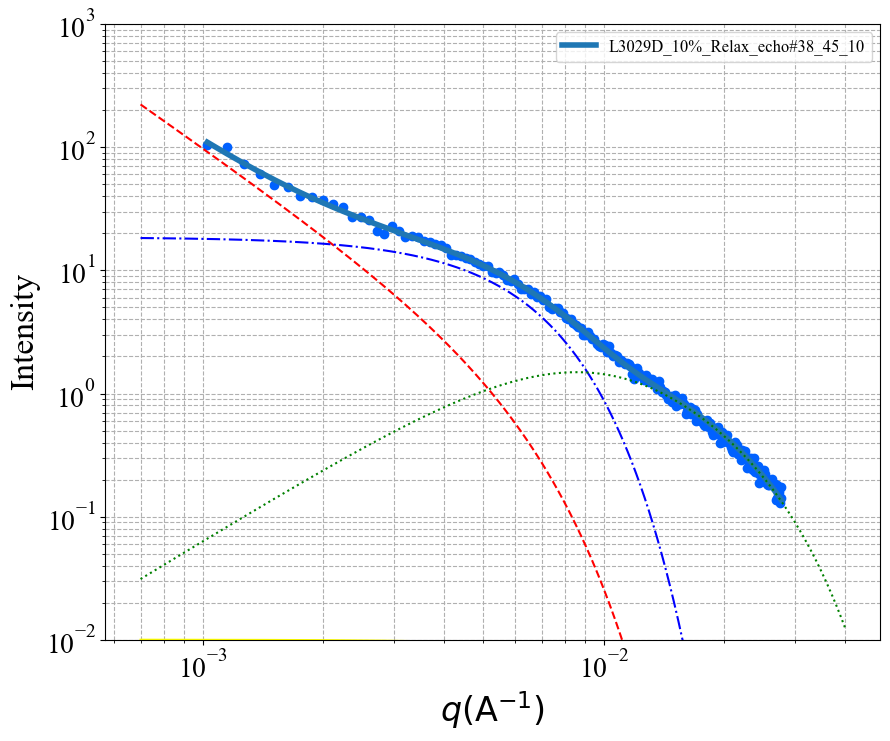


 Chi-square (func_1 with fixed params): 5.926823132924901
Sample: L3029D_10%_Relax_echo#39_45_10 - Parameter 1: 6.5115e-05
Sample: L3029D_10%_Relax_echo#39_45_10 - Parameter 2: 2.0587e+00
Sample: L3029D_10%_Relax_echo#39_45_10 - Parameter 3: 2.7539e+02
Sample: L3029D_10%_Relax_echo#39_45_10 - Parameter 4: 1.5291e+01
Sample: L3029D_10%_Relax_echo#39_45_10 - Parameter 5: 2.1056e-03
Sample: L3029D_10%_Relax_echo#39_45_10 - Parameter 6: 1.4237e+00
Sample: L3029D_10%_Relax_echo#39_45_10 - Parameter 7: 7.9404e+01
Sample: L3029D_10%_Relax_echo#39_45_10 - Parameter 8: 5.2390e-01
Sample: L3029D_10%_Relax_echo#39_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#39_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0587 ± 0.0928
Rss: 275.3907 ± 18.9071



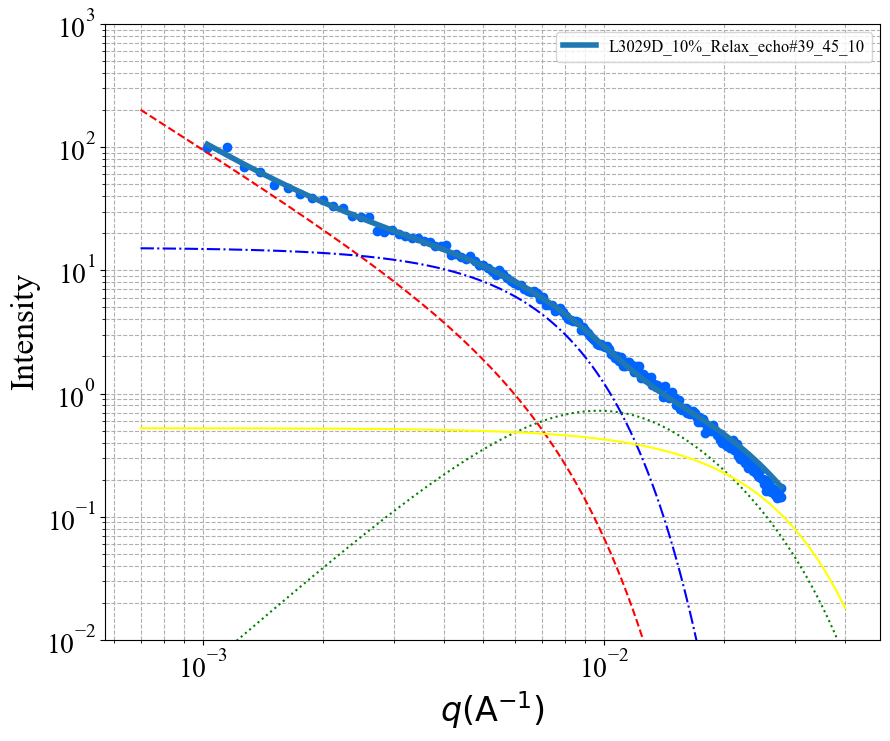


 Chi-square (func_1 with fixed params): 3.8635616769284304
Sample: L3029D_10%_Relax_echo#40_45_10 - Parameter 1: 3.7431e-05
Sample: L3029D_10%_Relax_echo#40_45_10 - Parameter 2: 2.1447e+00
Sample: L3029D_10%_Relax_echo#40_45_10 - Parameter 3: 2.8843e+02
Sample: L3029D_10%_Relax_echo#40_45_10 - Parameter 4: 1.6562e+01
Sample: L3029D_10%_Relax_echo#40_45_10 - Parameter 5: 3.9616e-02
Sample: L3029D_10%_Relax_echo#40_45_10 - Parameter 6: 8.6689e-01
Sample: L3029D_10%_Relax_echo#40_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#40_45_10 - Parameter 8: 1.4404e-04
Sample: L3029D_10%_Relax_echo#40_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#40_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1447 ± 0.0644
Rss: 288.4283 ± 14.9388



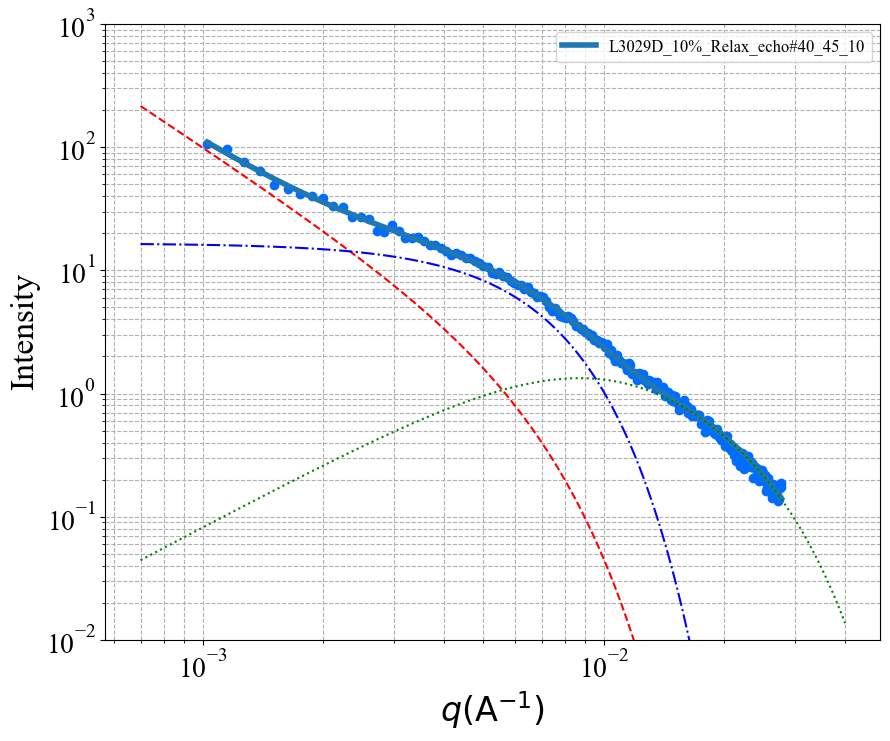


 Chi-square (func_1 with fixed params): 4.9549038884309216
Sample: L3029D_10%_Relax_echo#41_45_10 - Parameter 1: 1.9364e-05
Sample: L3029D_10%_Relax_echo#41_45_10 - Parameter 2: 2.2423e+00
Sample: L3029D_10%_Relax_echo#41_45_10 - Parameter 3: 2.9578e+02
Sample: L3029D_10%_Relax_echo#41_45_10 - Parameter 4: 1.7755e+01
Sample: L3029D_10%_Relax_echo#41_45_10 - Parameter 5: 1.6905e-02
Sample: L3029D_10%_Relax_echo#41_45_10 - Parameter 6: 1.0729e+00
Sample: L3029D_10%_Relax_echo#41_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#41_45_10 - Parameter 8: 3.3793e-02
Sample: L3029D_10%_Relax_echo#41_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#41_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2423 ± 0.0831
Rss: 295.7806 ± 17.8787



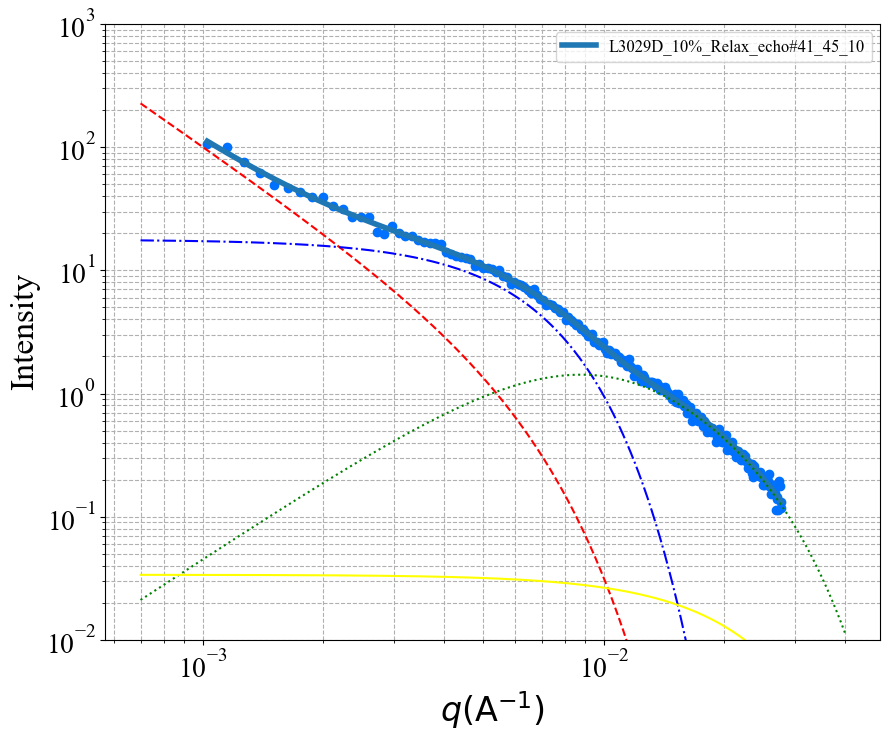


 Chi-square (func_1 with fixed params): 4.5986993755670085
Sample: L3029D_10%_Relax_echo#42_45_10 - Parameter 1: 1.4289e-05
Sample: L3029D_10%_Relax_echo#42_45_10 - Parameter 2: 2.2887e+00
Sample: L3029D_10%_Relax_echo#42_45_10 - Parameter 3: 2.9346e+02
Sample: L3029D_10%_Relax_echo#42_45_10 - Parameter 4: 1.7688e+01
Sample: L3029D_10%_Relax_echo#42_45_10 - Parameter 5: 3.1343e-02
Sample: L3029D_10%_Relax_echo#42_45_10 - Parameter 6: 9.2754e-01
Sample: L3029D_10%_Relax_echo#42_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#42_45_10 - Parameter 8: 2.7714e-03
Sample: L3029D_10%_Relax_echo#42_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#42_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2887 ± 0.0773
Rss: 293.4629 ± 16.7206



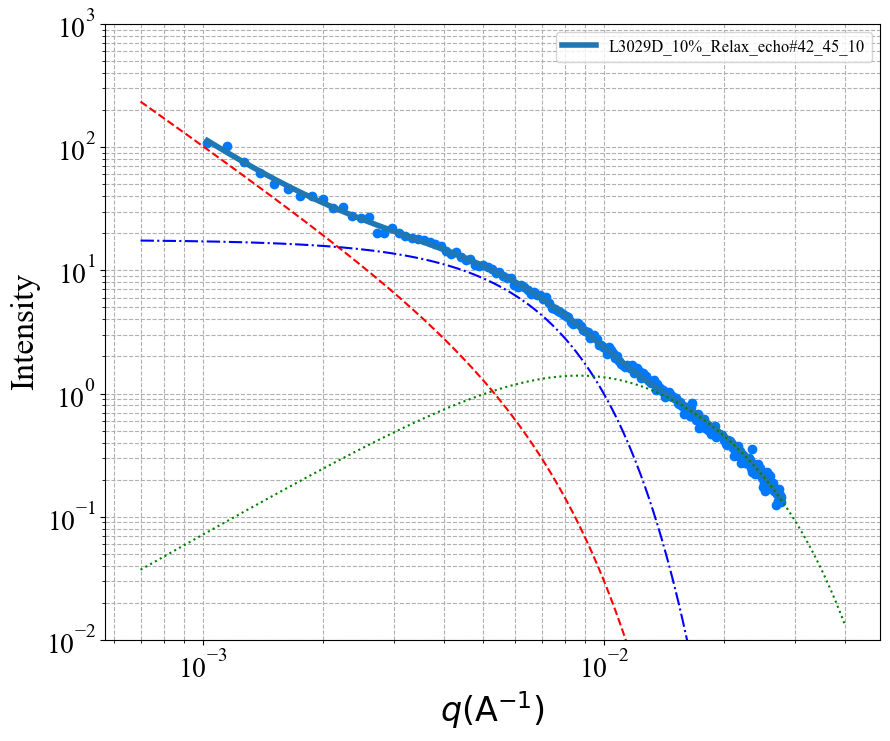


 Chi-square (func_1 with fixed params): 9.158460672181999
Sample: L3029D_10%_Relax_echo#43_45_10 - Parameter 1: 1.2391e-05
Sample: L3029D_10%_Relax_echo#43_45_10 - Parameter 2: 2.2773e+00
Sample: L3029D_10%_Relax_echo#43_45_10 - Parameter 3: 6.0000e+02
Sample: L3029D_10%_Relax_echo#43_45_10 - Parameter 4: 3.9604e+01
Sample: L3029D_10%_Relax_echo#43_45_10 - Parameter 5: 1.2384e-05
Sample: L3029D_10%_Relax_echo#43_45_10 - Parameter 6: 2.6784e+00
Sample: L3029D_10%_Relax_echo#43_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#43_45_10 - Parameter 8: 4.3108e-01
Sample: L3029D_10%_Relax_echo#43_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#43_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2773 ± 0.1623
Rss: 600.0000 ± 51.7187



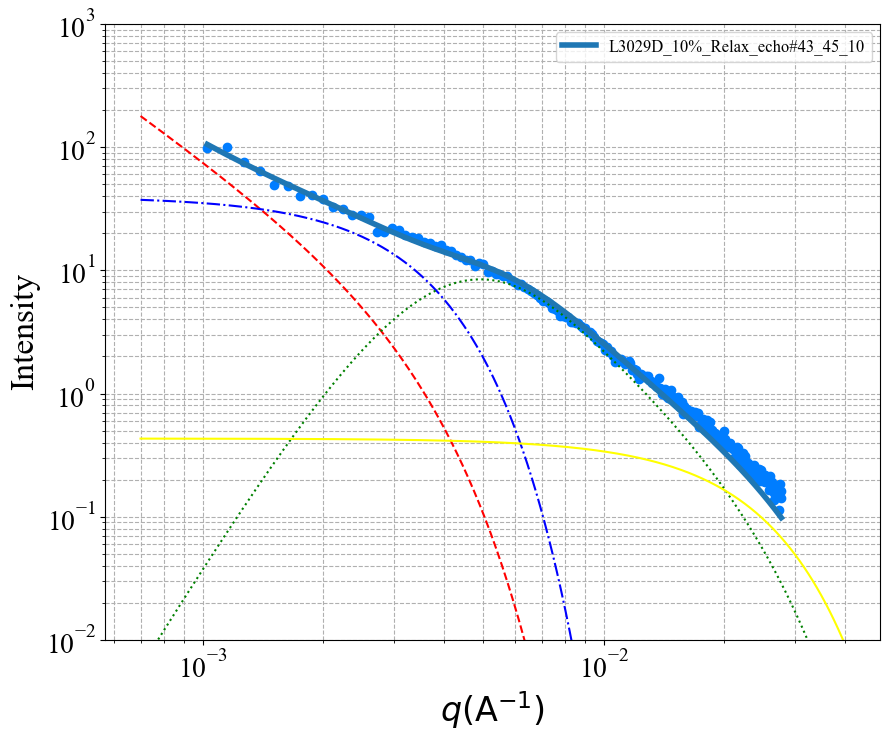


 Chi-square (func_1 with fixed params): 4.665551025334455
Sample: L3029D_10%_Relax_echo#44_45_10 - Parameter 1: 1.6155e-05
Sample: L3029D_10%_Relax_echo#44_45_10 - Parameter 2: 2.2649e+00
Sample: L3029D_10%_Relax_echo#44_45_10 - Parameter 3: 2.9542e+02
Sample: L3029D_10%_Relax_echo#44_45_10 - Parameter 4: 1.8226e+01
Sample: L3029D_10%_Relax_echo#44_45_10 - Parameter 5: 2.4472e-02
Sample: L3029D_10%_Relax_echo#44_45_10 - Parameter 6: 9.8032e-01
Sample: L3029D_10%_Relax_echo#44_45_10 - Parameter 7: 8.1921e+01
Sample: L3029D_10%_Relax_echo#44_45_10 - Parameter 8: 4.5445e-03
Sample: L3029D_10%_Relax_echo#44_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#44_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2649 ± 0.0788
Rss: 295.4214 ± 15.8004



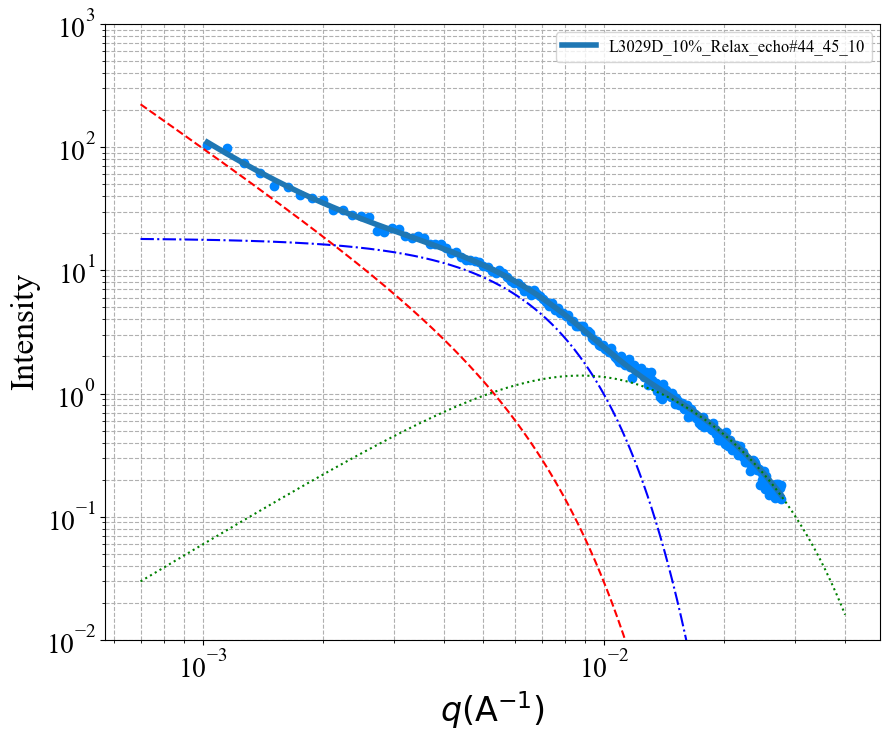


 Chi-square (func_1 with fixed params): 3.5700690107813453
Sample: L3029D_10%_Relax_echo#45_45_10 - Parameter 1: 1.6573e-05
Sample: L3029D_10%_Relax_echo#45_45_10 - Parameter 2: 2.2650e+00
Sample: L3029D_10%_Relax_echo#45_45_10 - Parameter 3: 2.9733e+02
Sample: L3029D_10%_Relax_echo#45_45_10 - Parameter 4: 1.8031e+01
Sample: L3029D_10%_Relax_echo#45_45_10 - Parameter 5: 2.0272e-02
Sample: L3029D_10%_Relax_echo#45_45_10 - Parameter 6: 1.0338e+00
Sample: L3029D_10%_Relax_echo#45_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#45_45_10 - Parameter 8: 1.3251e-04
Sample: L3029D_10%_Relax_echo#45_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#45_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2650 ± 0.0707
Rss: 297.3330 ± 15.0202



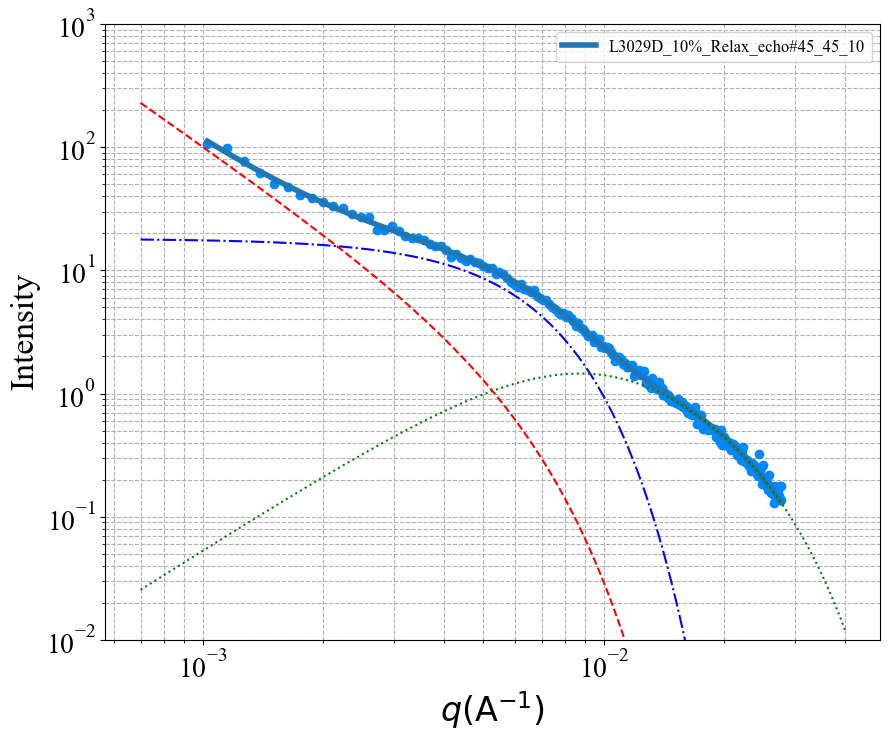


 Chi-square (func_1 with fixed params): 4.902817823386376
Sample: L3029D_10%_Relax_echo#46_45_10 - Parameter 1: 7.5497e-06
Sample: L3029D_10%_Relax_echo#46_45_10 - Parameter 2: 2.3742e+00
Sample: L3029D_10%_Relax_echo#46_45_10 - Parameter 3: 3.1498e+02
Sample: L3029D_10%_Relax_echo#46_45_10 - Parameter 4: 2.0149e+01
Sample: L3029D_10%_Relax_echo#46_45_10 - Parameter 5: 9.0711e-06
Sample: L3029D_10%_Relax_echo#46_45_10 - Parameter 6: 2.7307e+00
Sample: L3029D_10%_Relax_echo#46_45_10 - Parameter 7: 8.4992e+01
Sample: L3029D_10%_Relax_echo#46_45_10 - Parameter 8: 6.9130e-01
Sample: L3029D_10%_Relax_echo#46_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#46_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3742 ± 0.0923
Rss: 314.9806 ± 18.6700



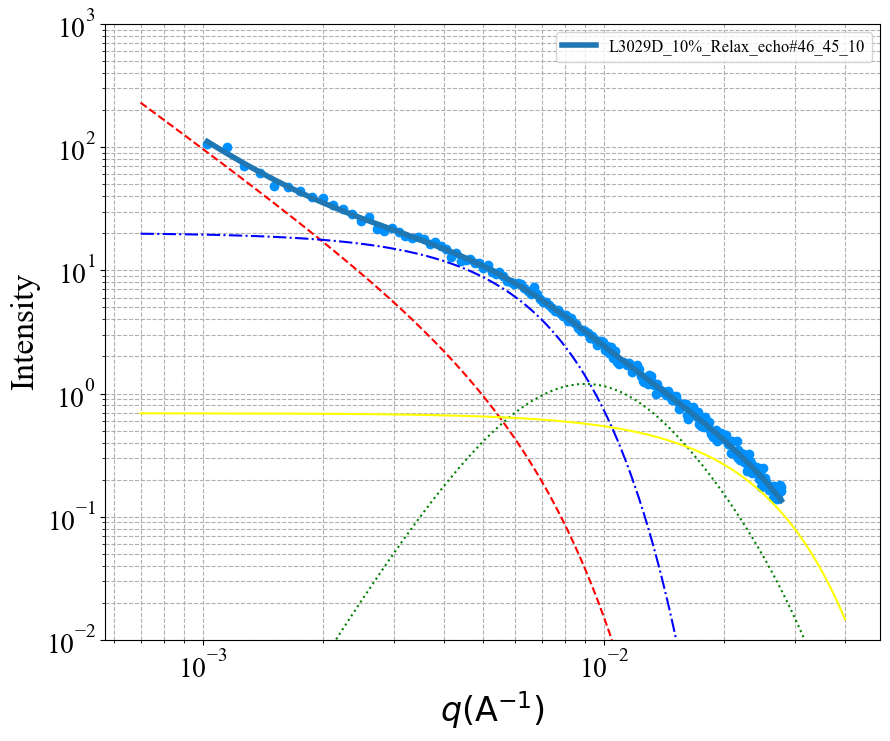


 Chi-square (func_1 with fixed params): 6.581214524189275
Sample: L3029D_10%_Relax_echo#47_45_10 - Parameter 1: 2.2588e-05
Sample: L3029D_10%_Relax_echo#47_45_10 - Parameter 2: 2.2163e+00
Sample: L3029D_10%_Relax_echo#47_45_10 - Parameter 3: 2.9389e+02
Sample: L3029D_10%_Relax_echo#47_45_10 - Parameter 4: 1.7661e+01
Sample: L3029D_10%_Relax_echo#47_45_10 - Parameter 5: 3.8063e-02
Sample: L3029D_10%_Relax_echo#47_45_10 - Parameter 6: 8.8390e-01
Sample: L3029D_10%_Relax_echo#47_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#47_45_10 - Parameter 8: 6.5606e-03
Sample: L3029D_10%_Relax_echo#47_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#47_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2163 ± 0.1028
Rss: 293.8870 ± 21.9969



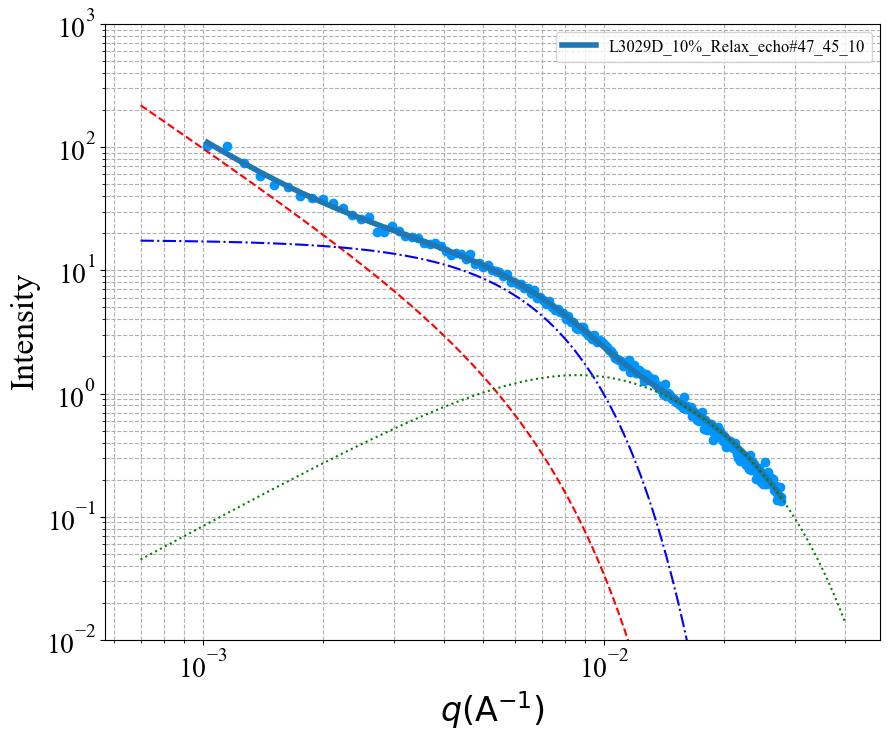


 Chi-square (func_1 with fixed params): 4.463156972181814
Sample: L3029D_10%_Relax_echo#48_45_10 - Parameter 1: 1.6901e-05
Sample: L3029D_10%_Relax_echo#48_45_10 - Parameter 2: 2.2627e+00
Sample: L3029D_10%_Relax_echo#48_45_10 - Parameter 3: 2.9585e+02
Sample: L3029D_10%_Relax_echo#48_45_10 - Parameter 4: 1.8096e+01
Sample: L3029D_10%_Relax_echo#48_45_10 - Parameter 5: 2.6683e-02
Sample: L3029D_10%_Relax_echo#48_45_10 - Parameter 6: 9.6526e-01
Sample: L3029D_10%_Relax_echo#48_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#48_45_10 - Parameter 8: 6.4484e-03
Sample: L3029D_10%_Relax_echo#48_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#48_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2627 ± 0.0802
Rss: 295.8459 ± 16.9097



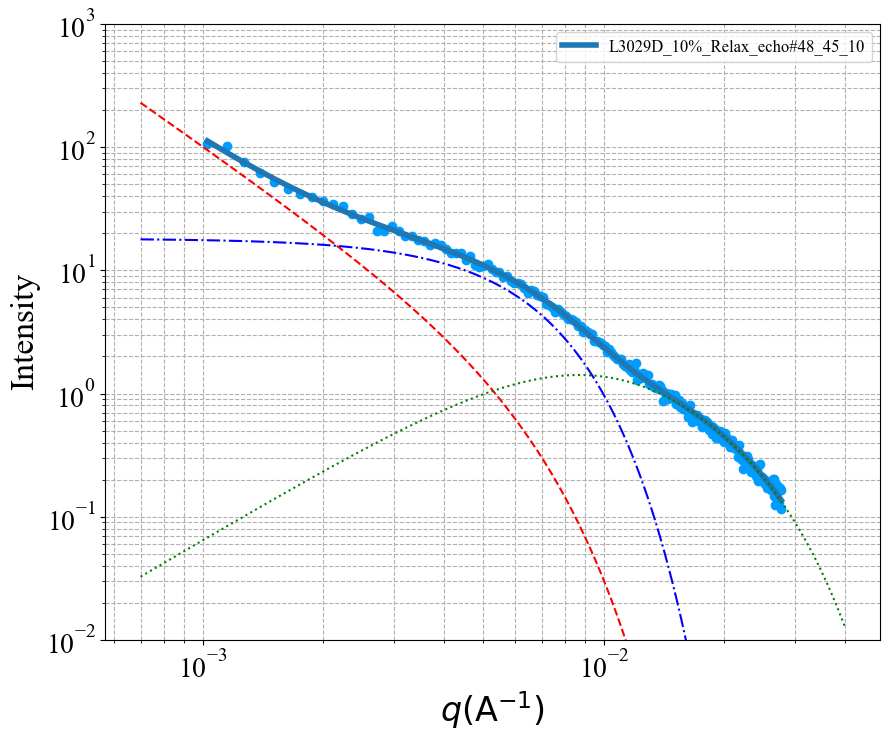


 Chi-square (func_1 with fixed params): 4.182577259288738
Sample: L3029D_10%_Relax_echo#49_45_10 - Parameter 1: 3.8164e-06
Sample: L3029D_10%_Relax_echo#49_45_10 - Parameter 2: 2.4729e+00
Sample: L3029D_10%_Relax_echo#49_45_10 - Parameter 3: 3.2005e+02
Sample: L3029D_10%_Relax_echo#49_45_10 - Parameter 4: 2.1279e+01
Sample: L3029D_10%_Relax_echo#49_45_10 - Parameter 5: 2.1232e-05
Sample: L3029D_10%_Relax_echo#49_45_10 - Parameter 6: 2.5516e+00
Sample: L3029D_10%_Relax_echo#49_45_10 - Parameter 7: 8.4988e+01
Sample: L3029D_10%_Relax_echo#49_45_10 - Parameter 8: 6.1490e-01
Sample: L3029D_10%_Relax_echo#49_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#49_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4729 ± 0.0881
Rss: 320.0476 ± 16.6963



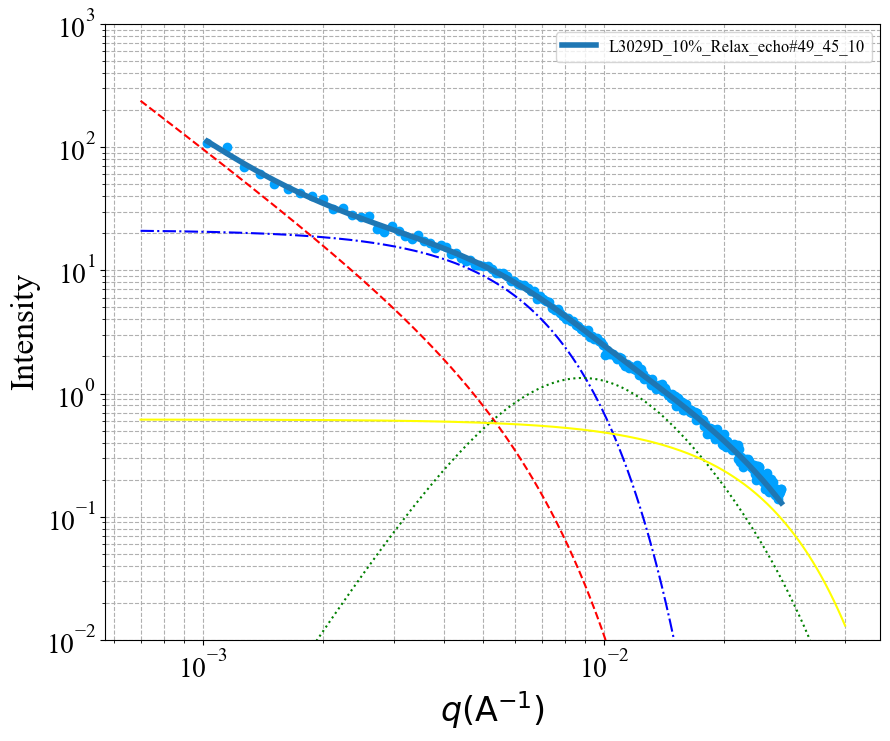


 Chi-square (func_1 with fixed params): 8.20059699131311
Sample: L3029D_10%_Relax_echo#50_45_10 - Parameter 1: 5.5870e-06
Sample: L3029D_10%_Relax_echo#50_45_10 - Parameter 2: 2.3980e+00
Sample: L3029D_10%_Relax_echo#50_45_10 - Parameter 3: 6.0000e+02
Sample: L3029D_10%_Relax_echo#50_45_10 - Parameter 4: 4.0255e+01
Sample: L3029D_10%_Relax_echo#50_45_10 - Parameter 5: 5.0559e-06
Sample: L3029D_10%_Relax_echo#50_45_10 - Parameter 6: 2.8546e+00
Sample: L3029D_10%_Relax_echo#50_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#50_45_10 - Parameter 8: 5.8376e-01
Sample: L3029D_10%_Relax_echo#50_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#50_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3980 ± 0.1626
Rss: 600.0000 ± 47.4049



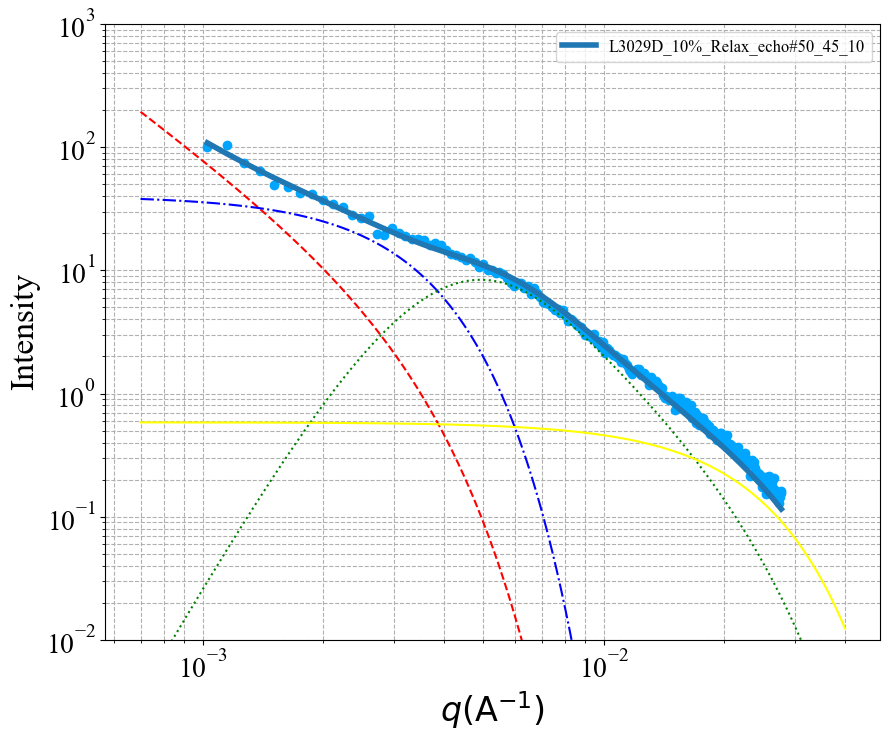


 Chi-square (func_1 with fixed params): 6.530811097575785
Sample: L3029D_10%_Relax_echo#51_45_10 - Parameter 1: 7.6332e-05
Sample: L3029D_10%_Relax_echo#51_45_10 - Parameter 2: 2.0383e+00
Sample: L3029D_10%_Relax_echo#51_45_10 - Parameter 3: 2.7929e+02
Sample: L3029D_10%_Relax_echo#51_45_10 - Parameter 4: 1.5090e+01
Sample: L3029D_10%_Relax_echo#51_45_10 - Parameter 5: 4.6796e-02
Sample: L3029D_10%_Relax_echo#51_45_10 - Parameter 6: 8.2422e-01
Sample: L3029D_10%_Relax_echo#51_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#51_45_10 - Parameter 8: 1.3306e-02
Sample: L3029D_10%_Relax_echo#51_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#51_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0383 ± 0.1014
Rss: 279.2862 ± 25.5302



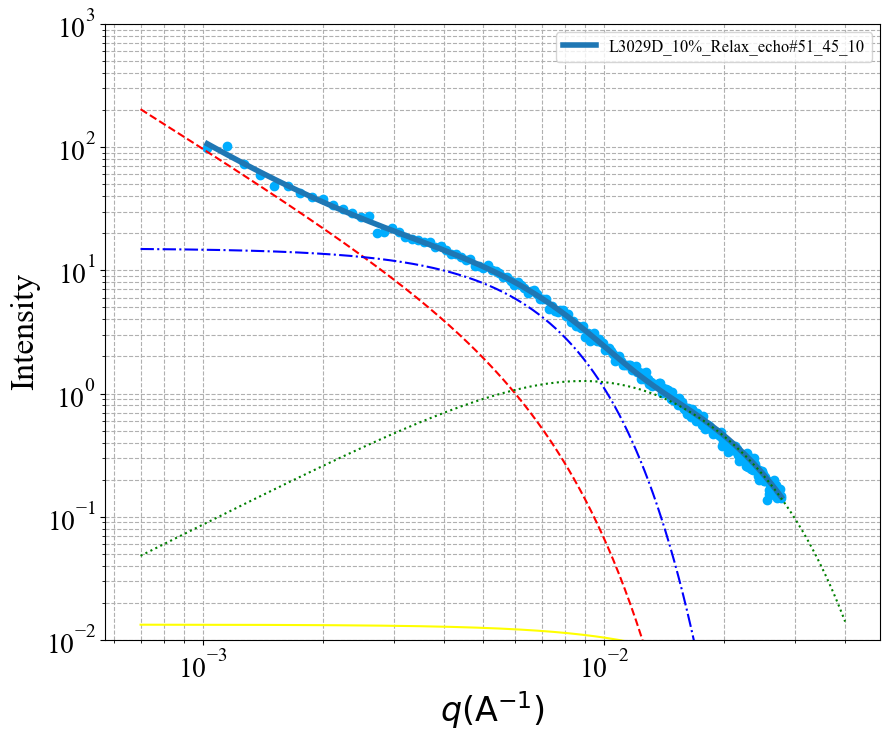


 Chi-square (func_1 with fixed params): 6.062797413434385
Sample: L3029D_10%_Relax_echo#52_45_10 - Parameter 1: 5.2234e-05
Sample: L3029D_10%_Relax_echo#52_45_10 - Parameter 2: 2.0962e+00
Sample: L3029D_10%_Relax_echo#52_45_10 - Parameter 3: 2.8023e+02
Sample: L3029D_10%_Relax_echo#52_45_10 - Parameter 4: 1.5605e+01
Sample: L3029D_10%_Relax_echo#52_45_10 - Parameter 5: 7.4280e-02
Sample: L3029D_10%_Relax_echo#52_45_10 - Parameter 6: 7.1157e-01
Sample: L3029D_10%_Relax_echo#52_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#52_45_10 - Parameter 8: 3.3362e-03
Sample: L3029D_10%_Relax_echo#52_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#52_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0962 ± 0.0903
Rss: 280.2298 ± 22.8248



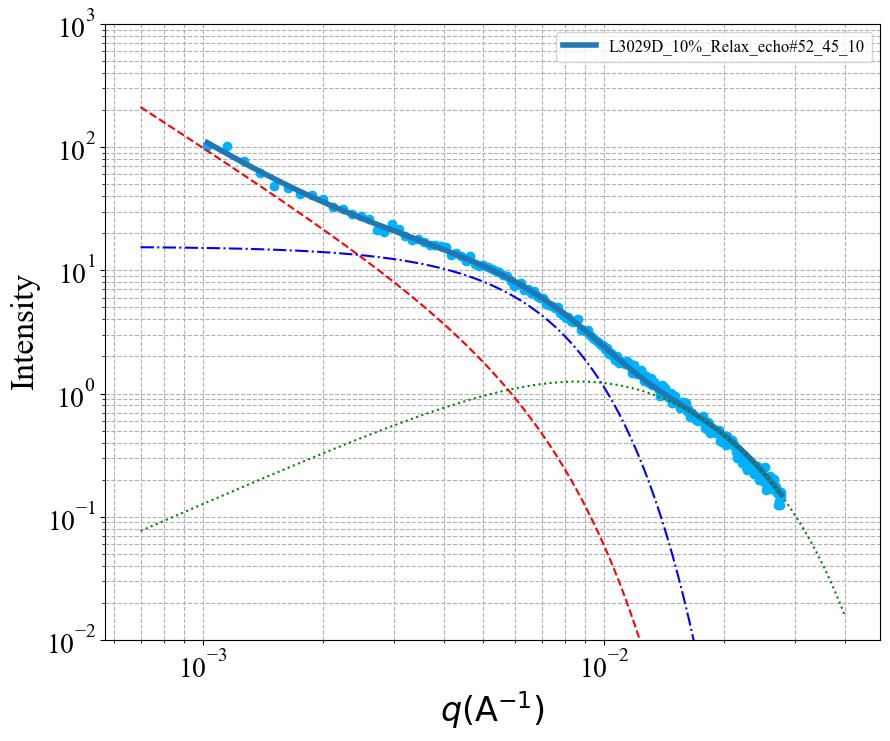


 Chi-square (func_1 with fixed params): 6.551411543144452
Sample: L3029D_10%_Relax_echo#53_45_10 - Parameter 1: 6.8136e-05
Sample: L3029D_10%_Relax_echo#53_45_10 - Parameter 2: 2.0554e+00
Sample: L3029D_10%_Relax_echo#53_45_10 - Parameter 3: 2.7923e+02
Sample: L3029D_10%_Relax_echo#53_45_10 - Parameter 4: 1.5325e+01
Sample: L3029D_10%_Relax_echo#53_45_10 - Parameter 5: 7.1476e-02
Sample: L3029D_10%_Relax_echo#53_45_10 - Parameter 6: 7.2100e-01
Sample: L3029D_10%_Relax_echo#53_45_10 - Parameter 7: 8.4991e+01
Sample: L3029D_10%_Relax_echo#53_45_10 - Parameter 8: 2.8212e-03
Sample: L3029D_10%_Relax_echo#53_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#53_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0554 ± 0.0930
Rss: 279.2317 ± 23.6693



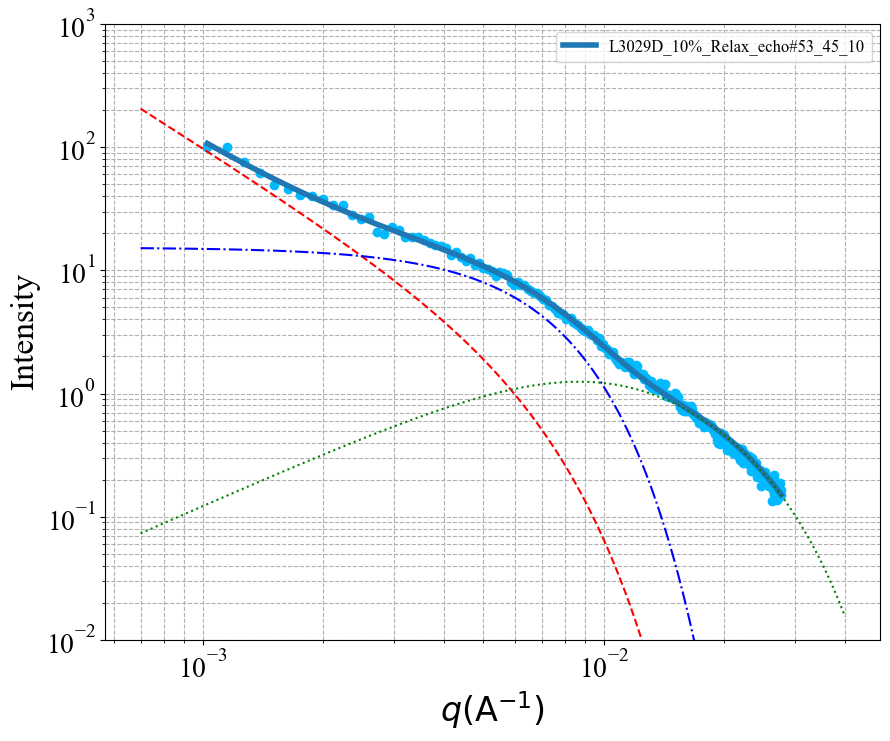


 Chi-square (func_1 with fixed params): 6.186699284416726
Sample: L3029D_10%_Relax_echo#54_45_10 - Parameter 1: 5.6461e-06
Sample: L3029D_10%_Relax_echo#54_45_10 - Parameter 2: 2.4195e+00
Sample: L3029D_10%_Relax_echo#54_45_10 - Parameter 3: 3.1517e+02
Sample: L3029D_10%_Relax_echo#54_45_10 - Parameter 4: 2.0593e+01
Sample: L3029D_10%_Relax_echo#54_45_10 - Parameter 5: 3.2650e-03
Sample: L3029D_10%_Relax_echo#54_45_10 - Parameter 6: 1.4754e+00
Sample: L3029D_10%_Relax_echo#54_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#54_45_10 - Parameter 8: 8.2502e-05
Sample: L3029D_10%_Relax_echo#54_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#54_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4195 ± 0.1017
Rss: 315.1669 ± 19.9543



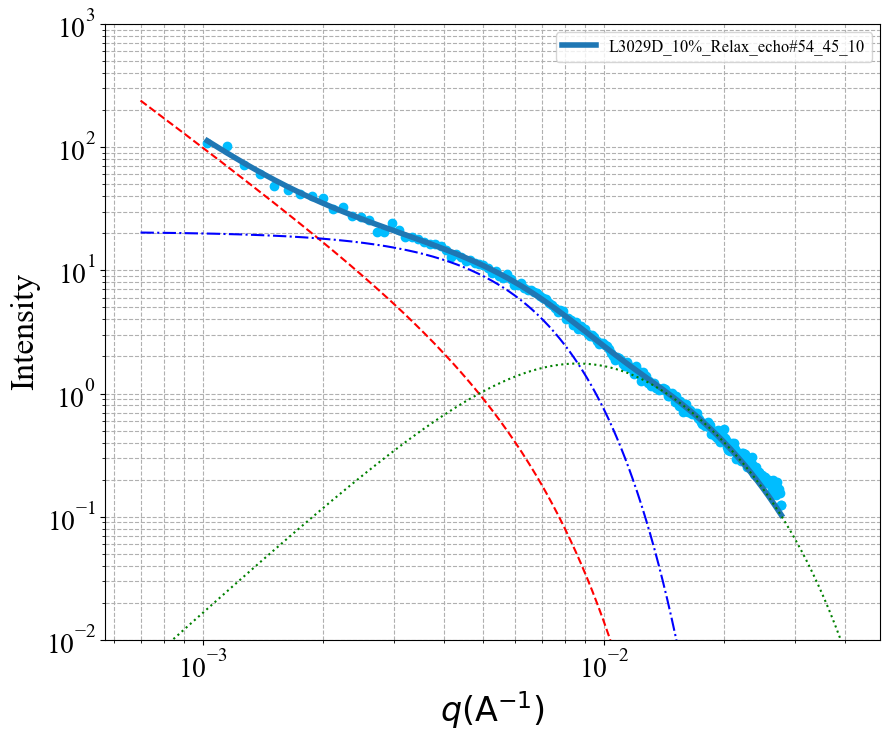


 Chi-square (func_1 with fixed params): 5.2399918931236895
Sample: L3029D_10%_Relax_echo#55_45_10 - Parameter 1: 1.1617e-05
Sample: L3029D_10%_Relax_echo#55_45_10 - Parameter 2: 2.3177e+00
Sample: L3029D_10%_Relax_echo#55_45_10 - Parameter 3: 3.0415e+02
Sample: L3029D_10%_Relax_echo#55_45_10 - Parameter 4: 1.8820e+01
Sample: L3029D_10%_Relax_echo#55_45_10 - Parameter 5: 1.0044e-02
Sample: L3029D_10%_Relax_echo#55_45_10 - Parameter 6: 1.2027e+00
Sample: L3029D_10%_Relax_echo#55_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#55_45_10 - Parameter 8: 5.3826e-03
Sample: L3029D_10%_Relax_echo#55_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#55_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3177 ± 0.0840
Rss: 304.1492 ± 17.5234



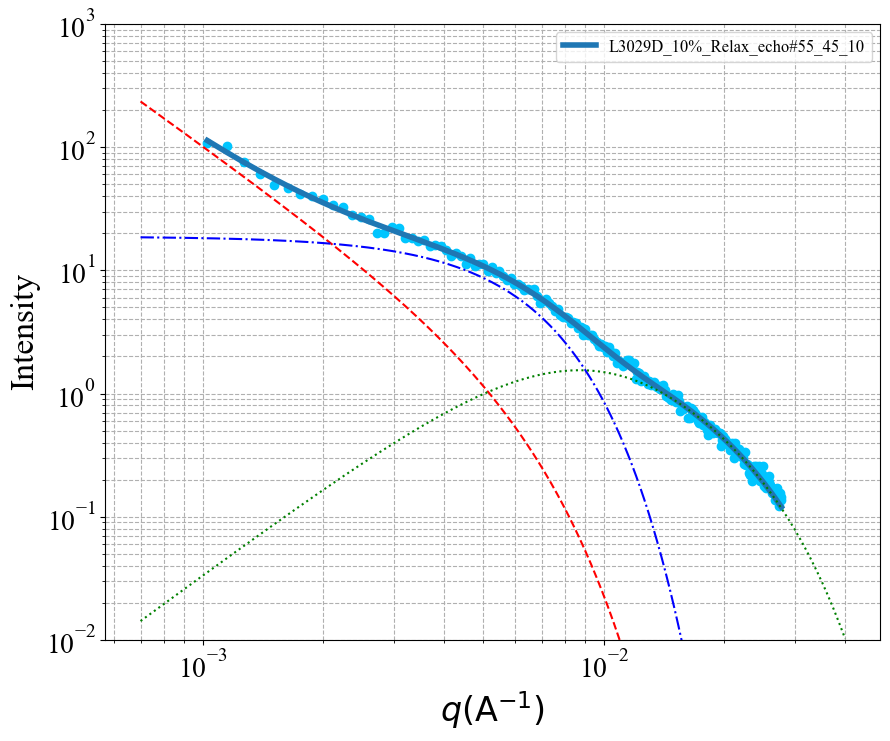


 Chi-square (func_1 with fixed params): 6.262741088418945
Sample: L3029D_10%_Relax_echo#56_45_10 - Parameter 1: 2.5978e-05
Sample: L3029D_10%_Relax_echo#56_45_10 - Parameter 2: 2.1891e+00
Sample: L3029D_10%_Relax_echo#56_45_10 - Parameter 3: 3.0946e+02
Sample: L3029D_10%_Relax_echo#56_45_10 - Parameter 4: 1.9260e+01
Sample: L3029D_10%_Relax_echo#56_45_10 - Parameter 5: 5.9711e-03
Sample: L3029D_10%_Relax_echo#56_45_10 - Parameter 6: 1.3319e+00
Sample: L3029D_10%_Relax_echo#56_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#56_45_10 - Parameter 8: 1.2091e-04
Sample: L3029D_10%_Relax_echo#56_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#56_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1891 ± 0.1080
Rss: 309.4572 ± 21.9199



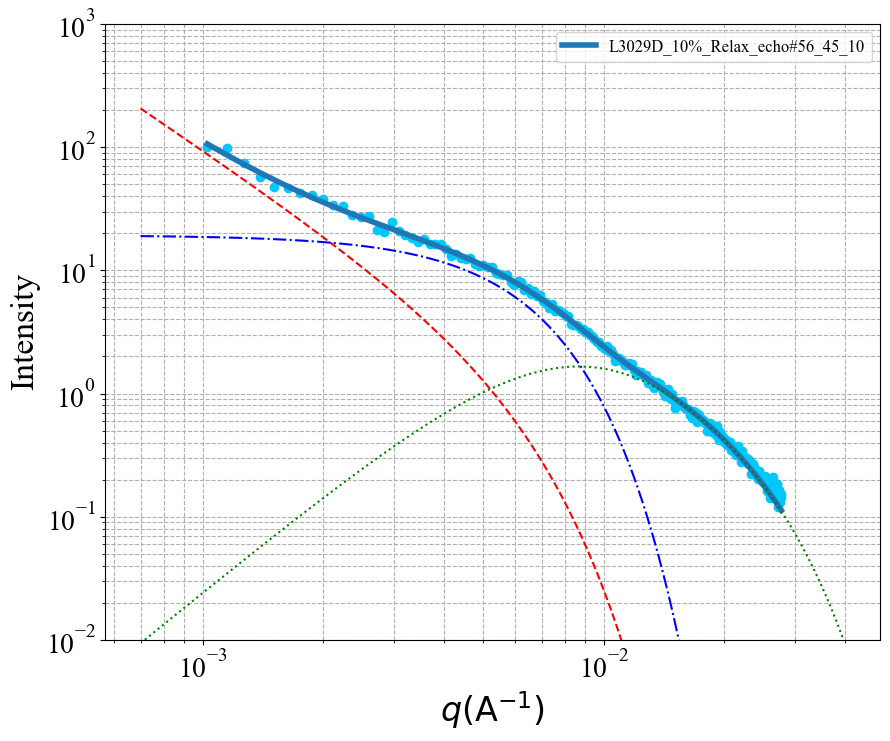


 Chi-square (func_1 with fixed params): 5.627103798671821
Sample: L3029D_10%_Relax_echo#57_45_10 - Parameter 1: 1.7847e-05
Sample: L3029D_10%_Relax_echo#57_45_10 - Parameter 2: 2.2561e+00
Sample: L3029D_10%_Relax_echo#57_45_10 - Parameter 3: 2.8961e+02
Sample: L3029D_10%_Relax_echo#57_45_10 - Parameter 4: 1.6976e+01
Sample: L3029D_10%_Relax_echo#57_45_10 - Parameter 5: 4.5138e-02
Sample: L3029D_10%_Relax_echo#57_45_10 - Parameter 6: 8.3325e-01
Sample: L3029D_10%_Relax_echo#57_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#57_45_10 - Parameter 8: 3.4457e-02
Sample: L3029D_10%_Relax_echo#57_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#57_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2561 ± 0.0863
Rss: 289.6128 ± 19.5960



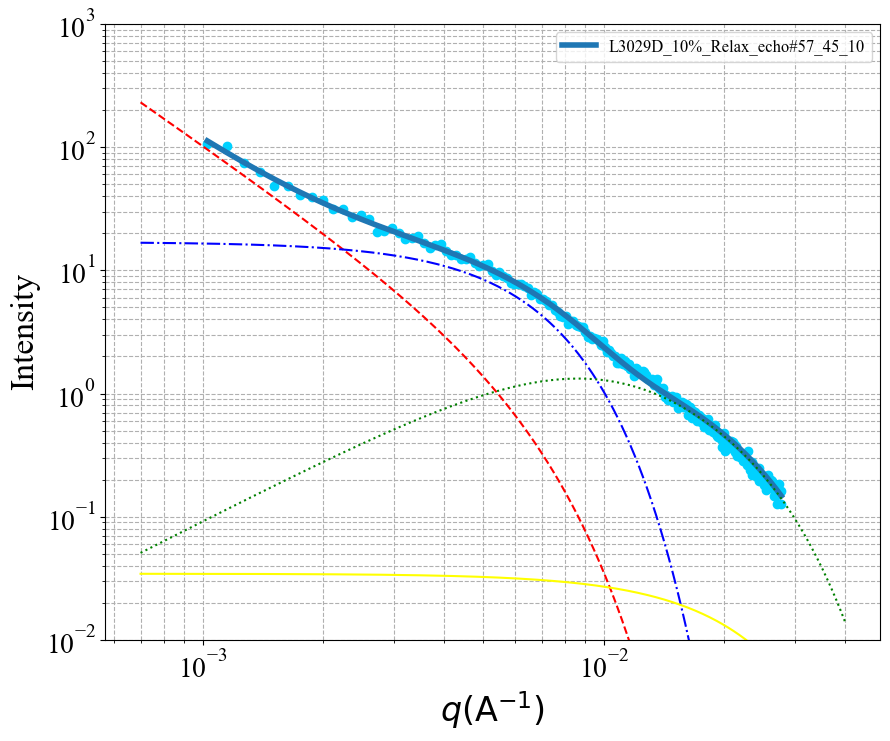


 Chi-square (func_1 with fixed params): 4.049323031174978
Sample: L3029D_10%_Relax_echo#58_45_10 - Parameter 1: 4.8374e-06
Sample: L3029D_10%_Relax_echo#58_45_10 - Parameter 2: 2.4421e+00
Sample: L3029D_10%_Relax_echo#58_45_10 - Parameter 3: 3.0962e+02
Sample: L3029D_10%_Relax_echo#58_45_10 - Parameter 4: 2.0260e+01
Sample: L3029D_10%_Relax_echo#58_45_10 - Parameter 5: 6.9198e-03
Sample: L3029D_10%_Relax_echo#58_45_10 - Parameter 6: 1.2890e+00
Sample: L3029D_10%_Relax_echo#58_45_10 - Parameter 7: 8.3720e+01
Sample: L3029D_10%_Relax_echo#58_45_10 - Parameter 8: 1.0267e-02
Sample: L3029D_10%_Relax_echo#58_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#58_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4421 ± 0.0667
Rss: 309.6226 ± 12.3497



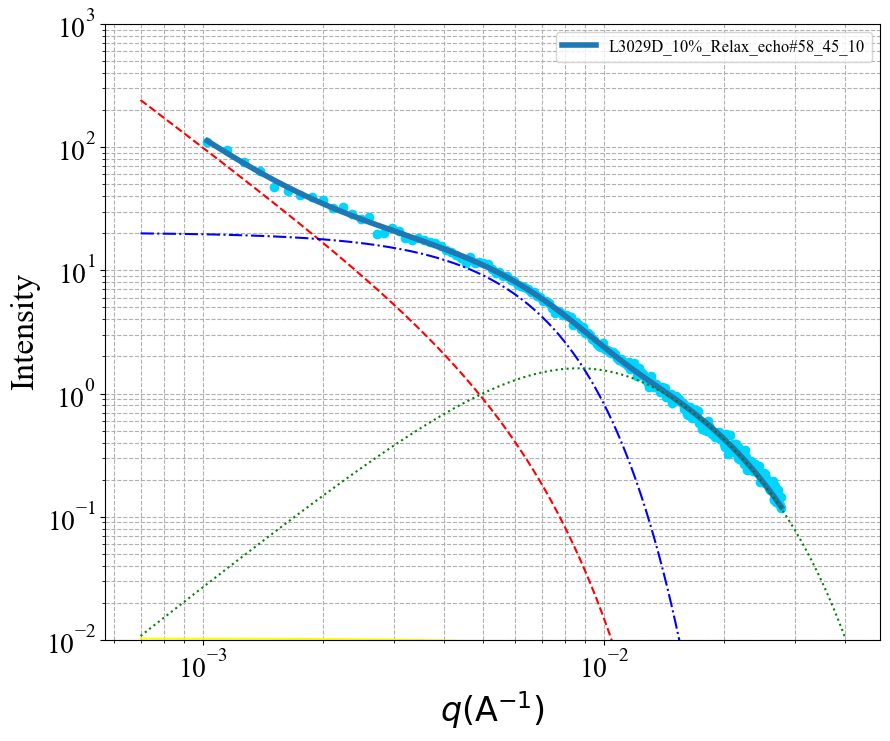


 Chi-square (func_1 with fixed params): 5.555106882230529
Sample: L3029D_10%_Relax_echo#59_45_10 - Parameter 1: 7.5411e-06
Sample: L3029D_10%_Relax_echo#59_45_10 - Parameter 2: 2.3797e+00
Sample: L3029D_10%_Relax_echo#59_45_10 - Parameter 3: 2.9703e+02
Sample: L3029D_10%_Relax_echo#59_45_10 - Parameter 4: 1.8512e+01
Sample: L3029D_10%_Relax_echo#59_45_10 - Parameter 5: 4.1329e-03
Sample: L3029D_10%_Relax_echo#59_45_10 - Parameter 6: 1.3411e+00
Sample: L3029D_10%_Relax_echo#59_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#59_45_10 - Parameter 8: 3.9524e-01
Sample: L3029D_10%_Relax_echo#59_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#59_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3797 ± 0.0879
Rss: 297.0318 ± 16.4266



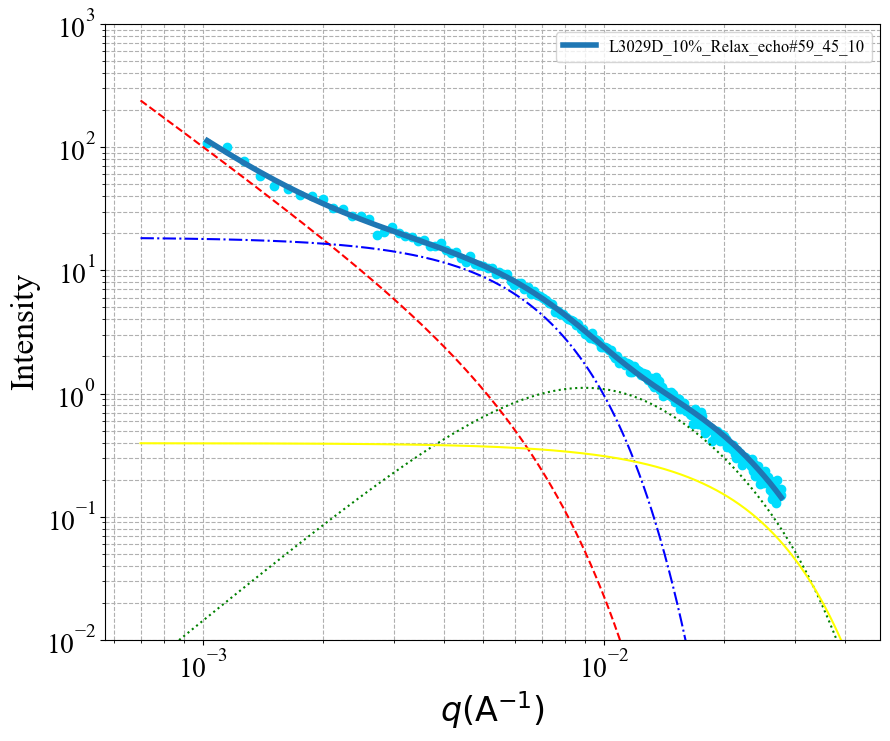


 Chi-square (func_1 with fixed params): 4.139723609471129
Sample: L3029D_10%_Relax_echo#60_45_10 - Parameter 1: 3.5606e-05
Sample: L3029D_10%_Relax_echo#60_45_10 - Parameter 2: 2.1467e+00
Sample: L3029D_10%_Relax_echo#60_45_10 - Parameter 3: 2.9633e+02
Sample: L3029D_10%_Relax_echo#60_45_10 - Parameter 4: 1.7516e+01
Sample: L3029D_10%_Relax_echo#60_45_10 - Parameter 5: 1.3169e-02
Sample: L3029D_10%_Relax_echo#60_45_10 - Parameter 6: 1.1341e+00
Sample: L3029D_10%_Relax_echo#60_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#60_45_10 - Parameter 8: 1.0446e-02
Sample: L3029D_10%_Relax_echo#60_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#60_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1467 ± 0.0747
Rss: 296.3287 ± 16.0310



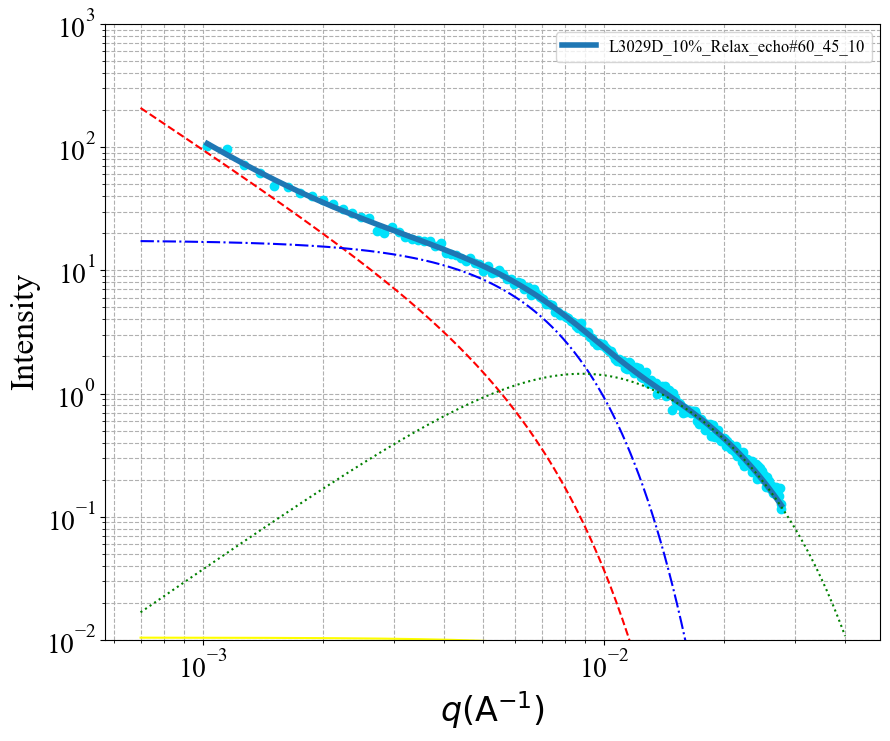


 Chi-square (func_1 with fixed params): 7.550372482644299
Sample: L3029D_10%_Relax_echo#61_45_10 - Parameter 1: 3.0354e-05
Sample: L3029D_10%_Relax_echo#61_45_10 - Parameter 2: 2.1748e+00
Sample: L3029D_10%_Relax_echo#61_45_10 - Parameter 3: 2.8788e+02
Sample: L3029D_10%_Relax_echo#61_45_10 - Parameter 4: 1.6701e+01
Sample: L3029D_10%_Relax_echo#61_45_10 - Parameter 5: 5.6696e-02
Sample: L3029D_10%_Relax_echo#61_45_10 - Parameter 6: 7.8453e-01
Sample: L3029D_10%_Relax_echo#61_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#61_45_10 - Parameter 8: 1.9189e-03
Sample: L3029D_10%_Relax_echo#61_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#61_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1748 ± 0.1066
Rss: 287.8791 ± 24.6647



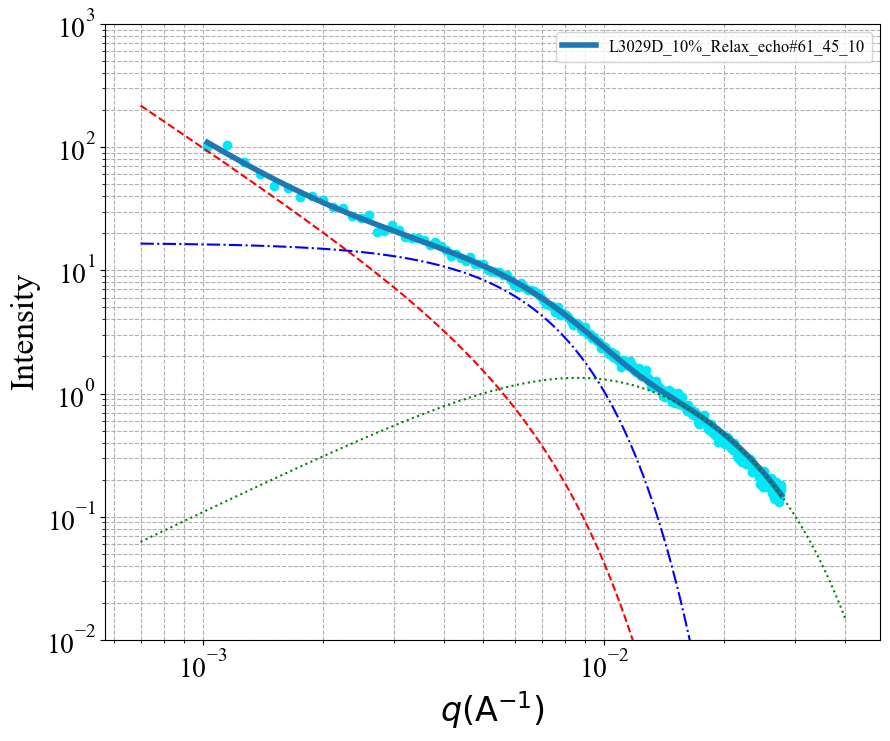


 Chi-square (func_1 with fixed params): 5.58936089900348
Sample: L3029D_10%_Relax_echo#62_45_10 - Parameter 1: 1.5096e-05
Sample: L3029D_10%_Relax_echo#62_45_10 - Parameter 2: 2.2814e+00
Sample: L3029D_10%_Relax_echo#62_45_10 - Parameter 3: 2.9252e+02
Sample: L3029D_10%_Relax_echo#62_45_10 - Parameter 4: 1.7542e+01
Sample: L3029D_10%_Relax_echo#62_45_10 - Parameter 5: 3.2505e-02
Sample: L3029D_10%_Relax_echo#62_45_10 - Parameter 6: 9.1819e-01
Sample: L3029D_10%_Relax_echo#62_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#62_45_10 - Parameter 8: 1.9557e-03
Sample: L3029D_10%_Relax_echo#62_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#62_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2814 ± 0.0896
Rss: 292.5240 ± 19.6246



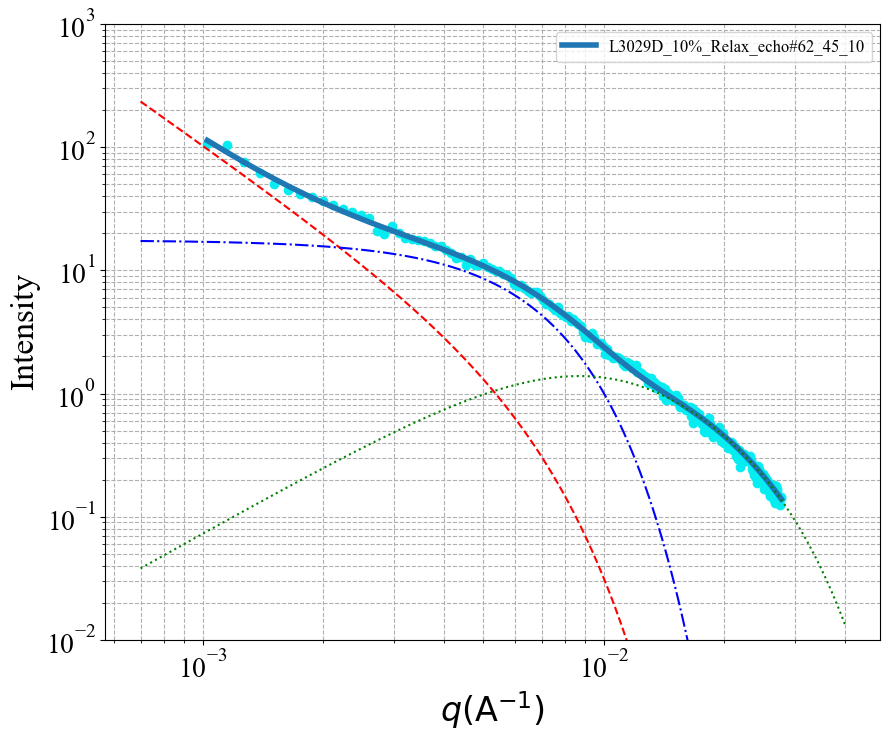


 Chi-square (func_1 with fixed params): 5.786630342751529
Sample: L3029D_10%_Relax_echo#63_45_10 - Parameter 1: 1.2010e-05
Sample: L3029D_10%_Relax_echo#63_45_10 - Parameter 2: 2.3082e+00
Sample: L3029D_10%_Relax_echo#63_45_10 - Parameter 3: 3.0883e+02
Sample: L3029D_10%_Relax_echo#63_45_10 - Parameter 4: 1.9543e+01
Sample: L3029D_10%_Relax_echo#63_45_10 - Parameter 5: 9.1245e-03
Sample: L3029D_10%_Relax_echo#63_45_10 - Parameter 6: 1.2302e+00
Sample: L3029D_10%_Relax_echo#63_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#63_45_10 - Parameter 8: 4.3818e-03
Sample: L3029D_10%_Relax_echo#63_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#63_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3082 ± 0.1010
Rss: 308.8268 ± 20.0947



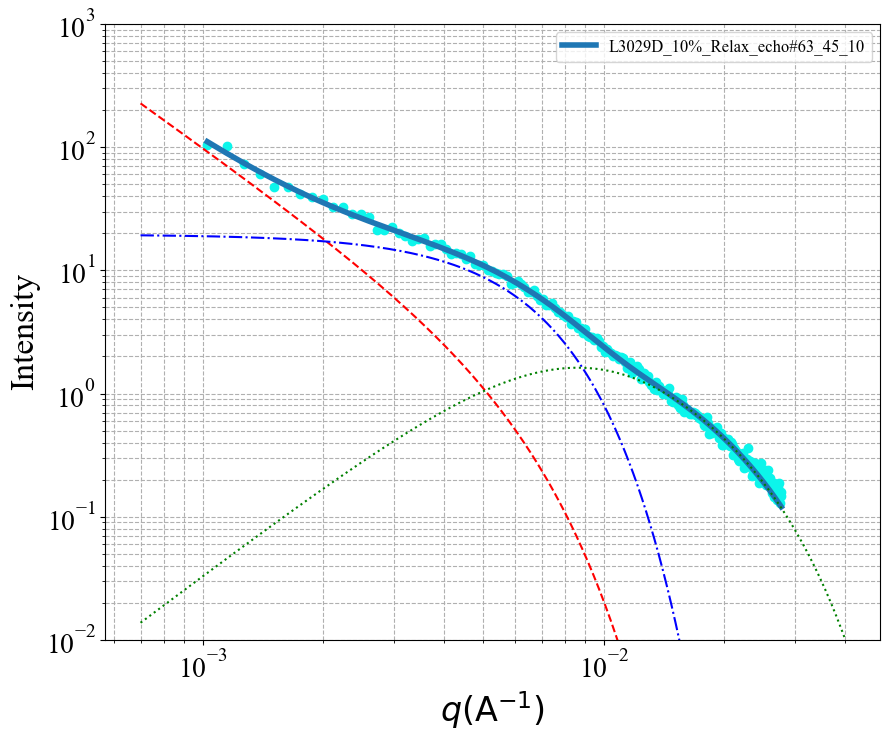


 Chi-square (func_1 with fixed params): 4.142706490057186
Sample: L3029D_10%_Relax_echo#64_45_10 - Parameter 1: 7.6537e-06
Sample: L3029D_10%_Relax_echo#64_45_10 - Parameter 2: 2.3726e+00
Sample: L3029D_10%_Relax_echo#64_45_10 - Parameter 3: 3.1364e+02
Sample: L3029D_10%_Relax_echo#64_45_10 - Parameter 4: 2.0351e+01
Sample: L3029D_10%_Relax_echo#64_45_10 - Parameter 5: 6.0496e-03
Sample: L3029D_10%_Relax_echo#64_45_10 - Parameter 6: 1.3250e+00
Sample: L3029D_10%_Relax_echo#64_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#64_45_10 - Parameter 8: 1.0392e-02
Sample: L3029D_10%_Relax_echo#64_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#64_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3726 ± 0.0760
Rss: 313.6374 ± 14.4690



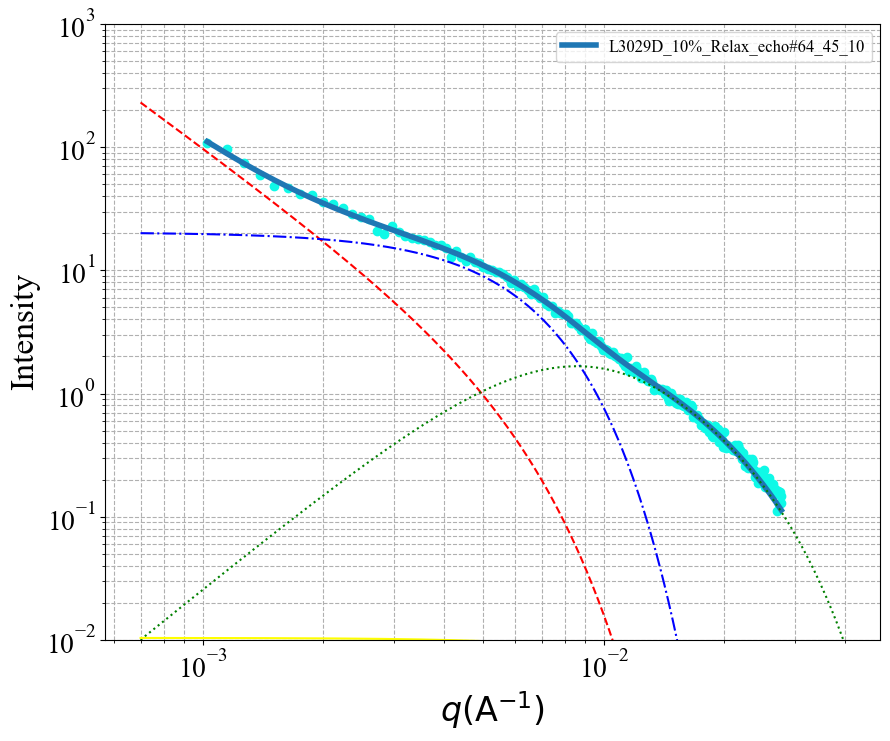


 Chi-square (func_1 with fixed params): 4.883922757509207
Sample: L3029D_10%_Relax_echo#65_45_10 - Parameter 1: 1.7853e-05
Sample: L3029D_10%_Relax_echo#65_45_10 - Parameter 2: 2.2502e+00
Sample: L3029D_10%_Relax_echo#65_45_10 - Parameter 3: 2.9904e+02
Sample: L3029D_10%_Relax_echo#65_45_10 - Parameter 4: 1.8356e+01
Sample: L3029D_10%_Relax_echo#65_45_10 - Parameter 5: 1.5513e-02
Sample: L3029D_10%_Relax_echo#65_45_10 - Parameter 6: 1.0976e+00
Sample: L3029D_10%_Relax_echo#65_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#65_45_10 - Parameter 8: 8.9998e-05
Sample: L3029D_10%_Relax_echo#65_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#65_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2502 ± 0.0869
Rss: 299.0419 ± 17.7617



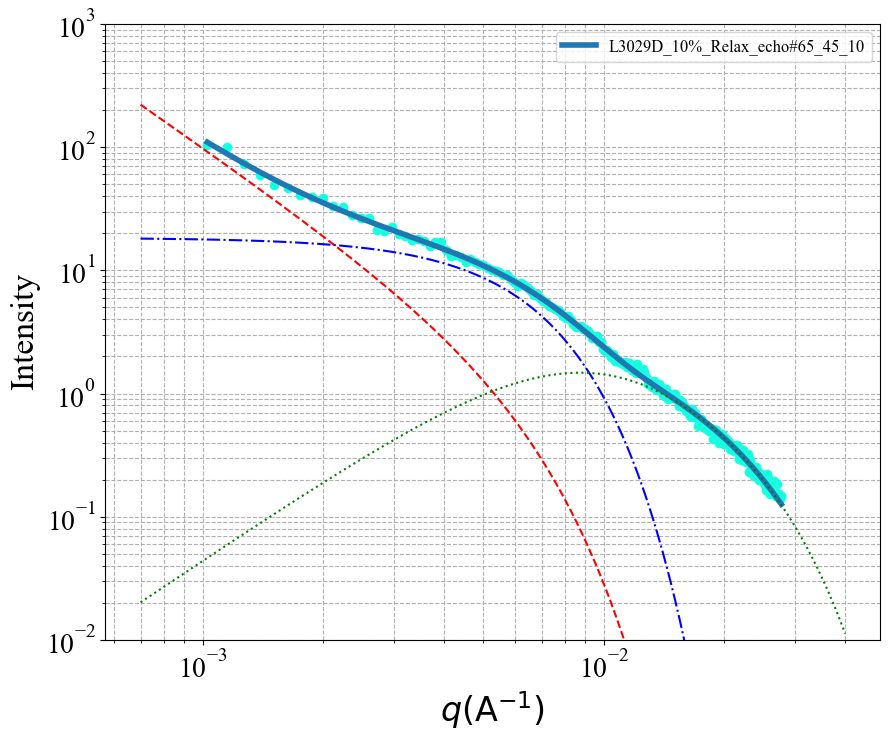


 Chi-square (func_1 with fixed params): 5.459422100689538
Sample: L3029D_10%_Relax_echo#66_45_10 - Parameter 1: 7.2637e-06
Sample: L3029D_10%_Relax_echo#66_45_10 - Parameter 2: 2.3818e+00
Sample: L3029D_10%_Relax_echo#66_45_10 - Parameter 3: 3.0934e+02
Sample: L3029D_10%_Relax_echo#66_45_10 - Parameter 4: 2.0074e+01
Sample: L3029D_10%_Relax_echo#66_45_10 - Parameter 5: 8.0921e-03
Sample: L3029D_10%_Relax_echo#66_45_10 - Parameter 6: 1.2593e+00
Sample: L3029D_10%_Relax_echo#66_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#66_45_10 - Parameter 8: 6.6965e-03
Sample: L3029D_10%_Relax_echo#66_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#66_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3818 ± 0.0928
Rss: 309.3353 ± 17.6203



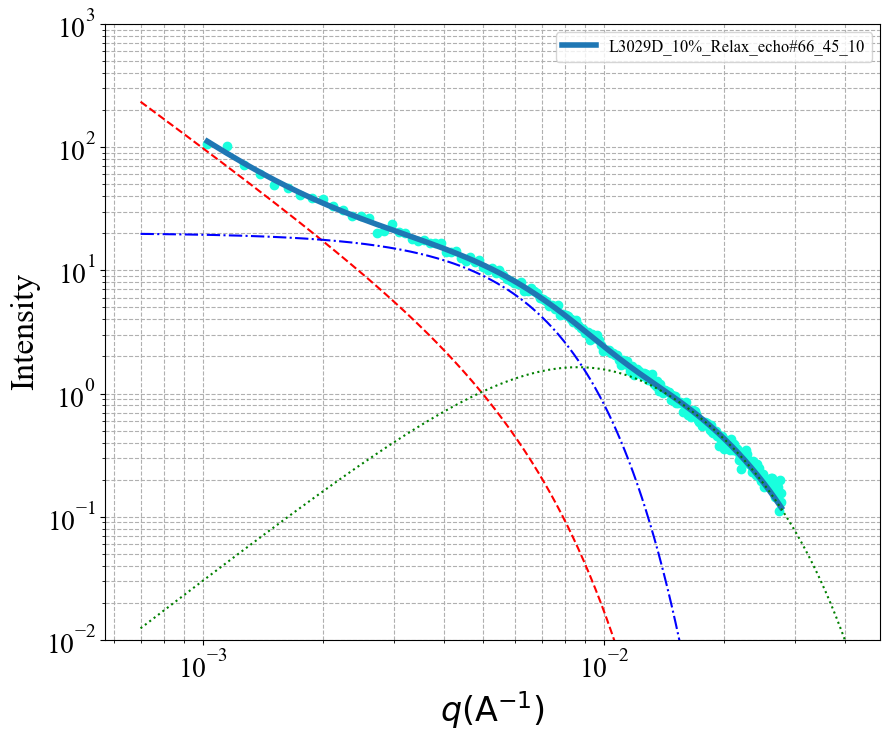


 Chi-square (func_1 with fixed params): 6.488845012324611
Sample: L3029D_10%_Relax_echo#67_45_10 - Parameter 1: 4.0025e-05
Sample: L3029D_10%_Relax_echo#67_45_10 - Parameter 2: 2.1330e+00
Sample: L3029D_10%_Relax_echo#67_45_10 - Parameter 3: 2.8322e+02
Sample: L3029D_10%_Relax_echo#67_45_10 - Parameter 4: 1.6275e+01
Sample: L3029D_10%_Relax_echo#67_45_10 - Parameter 5: 4.2905e-03
Sample: L3029D_10%_Relax_echo#67_45_10 - Parameter 6: 1.2858e+00
Sample: L3029D_10%_Relax_echo#67_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#67_45_10 - Parameter 8: 5.3482e-01
Sample: L3029D_10%_Relax_echo#67_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#67_45_10 - Parameter 10: 9.9000e-09

Dm: 2.1330 ± 0.0993
Rss: 283.2160 ± 20.1373



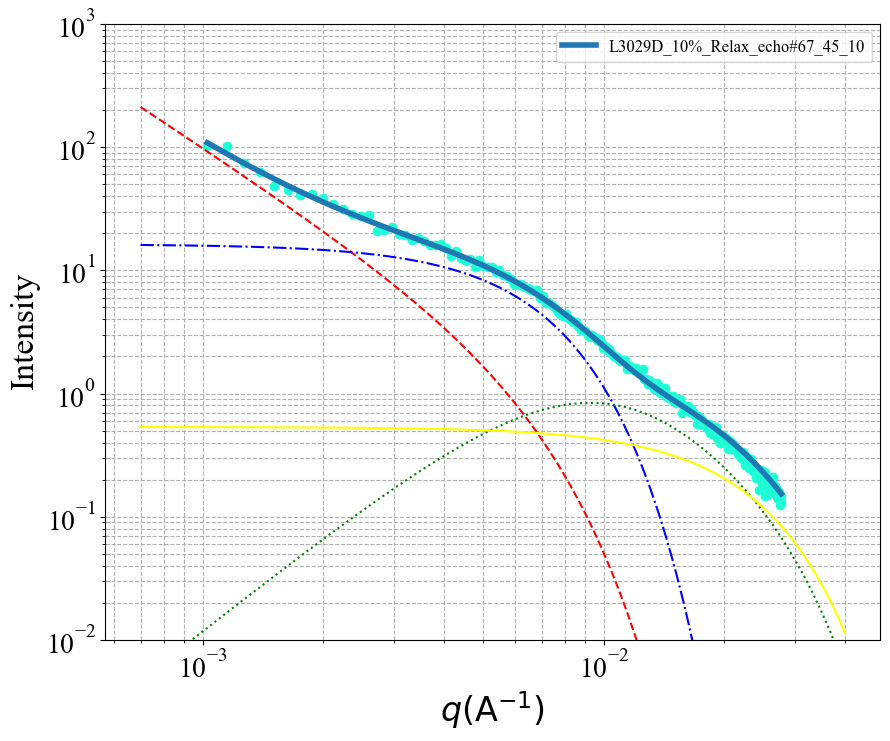


 Chi-square (func_1 with fixed params): 4.748470815196093
Sample: L3029D_10%_Relax_echo#68_45_10 - Parameter 1: 4.0035e-05
Sample: L3029D_10%_Relax_echo#68_45_10 - Parameter 2: 2.1309e+00
Sample: L3029D_10%_Relax_echo#68_45_10 - Parameter 3: 2.9058e+02
Sample: L3029D_10%_Relax_echo#68_45_10 - Parameter 4: 1.6942e+01
Sample: L3029D_10%_Relax_echo#68_45_10 - Parameter 5: 3.0962e-02
Sample: L3029D_10%_Relax_echo#68_45_10 - Parameter 6: 9.2775e-01
Sample: L3029D_10%_Relax_echo#68_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#68_45_10 - Parameter 8: 6.1126e-03
Sample: L3029D_10%_Relax_echo#68_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#68_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1309 ± 0.0834
Rss: 290.5799 ± 18.4255



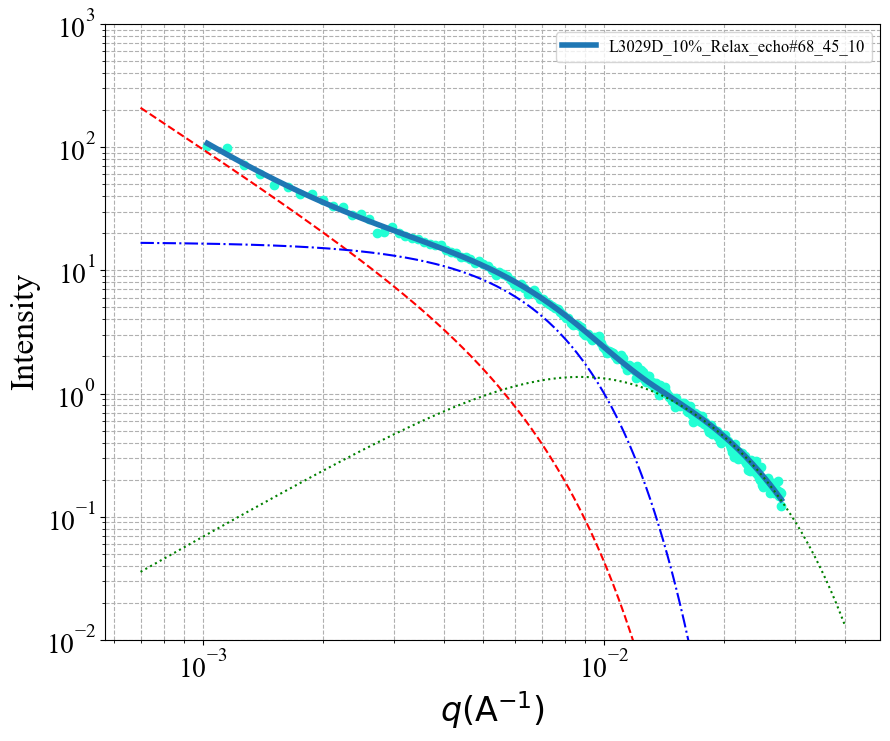


 Chi-square (func_1 with fixed params): 4.985865628823439
Sample: L3029D_10%_Relax_echo#69_45_10 - Parameter 1: 2.8667e-05
Sample: L3029D_10%_Relax_echo#69_45_10 - Parameter 2: 2.1844e+00
Sample: L3029D_10%_Relax_echo#69_45_10 - Parameter 3: 2.8998e+02
Sample: L3029D_10%_Relax_echo#69_45_10 - Parameter 4: 1.6844e+01
Sample: L3029D_10%_Relax_echo#69_45_10 - Parameter 5: 4.0122e-02
Sample: L3029D_10%_Relax_echo#69_45_10 - Parameter 6: 8.6670e-01
Sample: L3029D_10%_Relax_echo#69_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#69_45_10 - Parameter 8: 3.7695e-03
Sample: L3029D_10%_Relax_echo#69_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#69_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1844 ± 0.0830
Rss: 289.9809 ± 18.9797



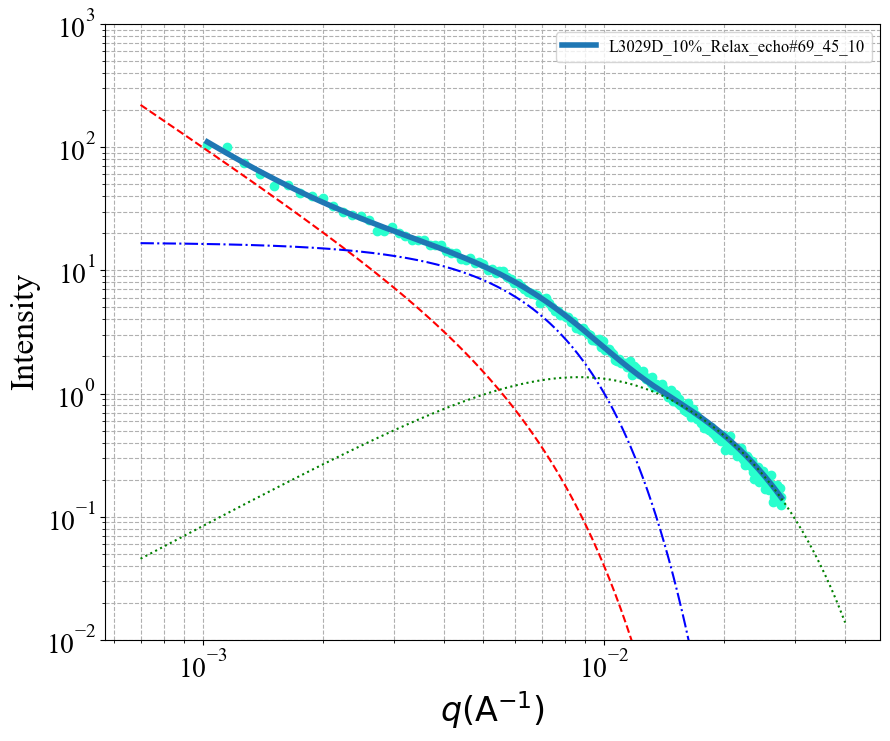


 Chi-square (func_1 with fixed params): 4.72540279704217
Sample: L3029D_10%_Relax_echo#70_45_10 - Parameter 1: 1.3707e-05
Sample: L3029D_10%_Relax_echo#70_45_10 - Parameter 2: 2.2920e+00
Sample: L3029D_10%_Relax_echo#70_45_10 - Parameter 3: 2.9890e+02
Sample: L3029D_10%_Relax_echo#70_45_10 - Parameter 4: 1.8381e+01
Sample: L3029D_10%_Relax_echo#70_45_10 - Parameter 5: 1.3913e-02
Sample: L3029D_10%_Relax_echo#70_45_10 - Parameter 6: 1.1271e+00
Sample: L3029D_10%_Relax_echo#70_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#70_45_10 - Parameter 8: 6.1023e-03
Sample: L3029D_10%_Relax_echo#70_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#70_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2920 ± 0.0856
Rss: 298.8956 ± 17.7526



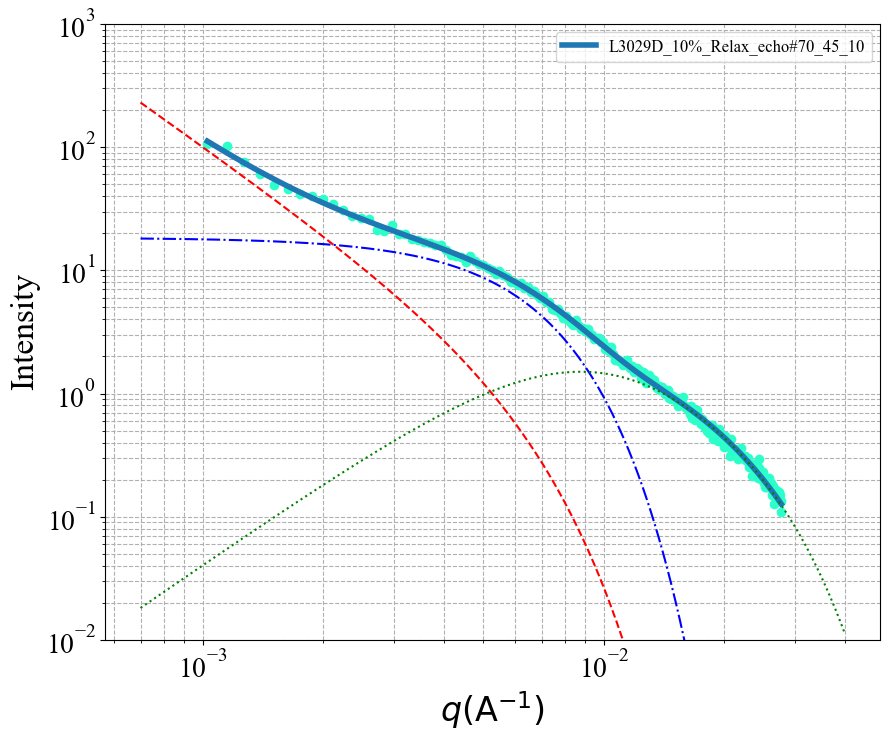


 Chi-square (func_1 with fixed params): 4.636690700823068
Sample: L3029D_10%_Relax_echo#71_45_10 - Parameter 1: 1.1854e-05
Sample: L3029D_10%_Relax_echo#71_45_10 - Parameter 2: 2.3118e+00
Sample: L3029D_10%_Relax_echo#71_45_10 - Parameter 3: 2.9901e+02
Sample: L3029D_10%_Relax_echo#71_45_10 - Parameter 4: 1.8600e+01
Sample: L3029D_10%_Relax_echo#71_45_10 - Parameter 5: 2.0761e-02
Sample: L3029D_10%_Relax_echo#71_45_10 - Parameter 6: 1.0287e+00
Sample: L3029D_10%_Relax_echo#71_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#71_45_10 - Parameter 8: 9.4702e-03
Sample: L3029D_10%_Relax_echo#71_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#71_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3118 ± 0.0814
Rss: 299.0096 ± 16.3289



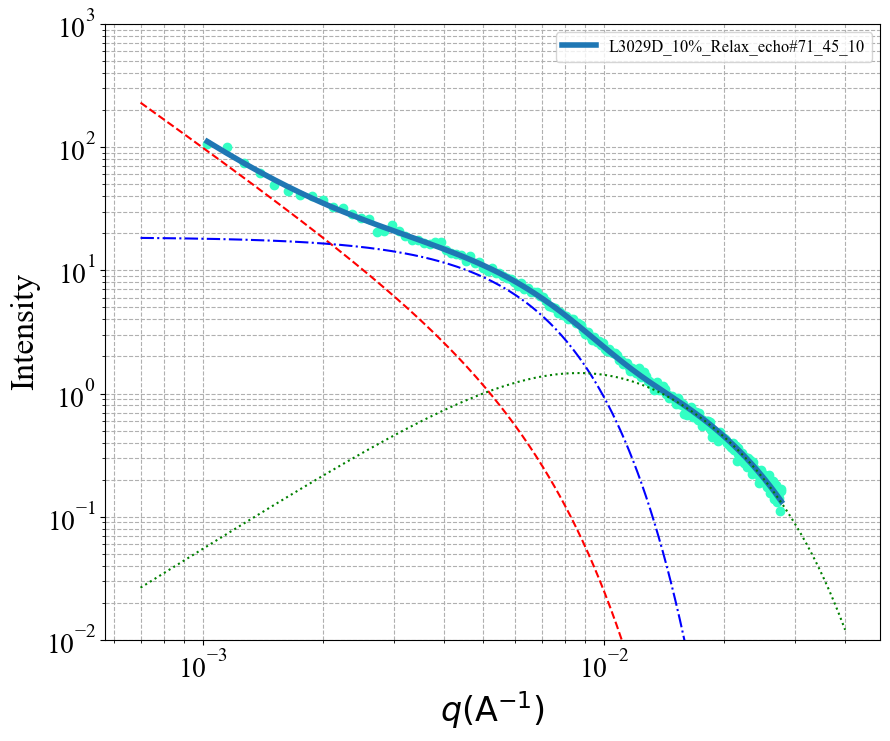


 Chi-square (func_1 with fixed params): 4.732466733631201
Sample: L3029D_10%_Relax_echo#72_45_10 - Parameter 1: 1.5351e-05
Sample: L3029D_10%_Relax_echo#72_45_10 - Parameter 2: 2.2763e+00
Sample: L3029D_10%_Relax_echo#72_45_10 - Parameter 3: 2.9979e+02
Sample: L3029D_10%_Relax_echo#72_45_10 - Parameter 4: 1.8447e+01
Sample: L3029D_10%_Relax_echo#72_45_10 - Parameter 5: 1.4726e-02
Sample: L3029D_10%_Relax_echo#72_45_10 - Parameter 6: 1.1158e+00
Sample: L3029D_10%_Relax_echo#72_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#72_45_10 - Parameter 8: 1.4989e-03
Sample: L3029D_10%_Relax_echo#72_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#72_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2763 ± 0.0769
Rss: 299.7879 ± 16.1490



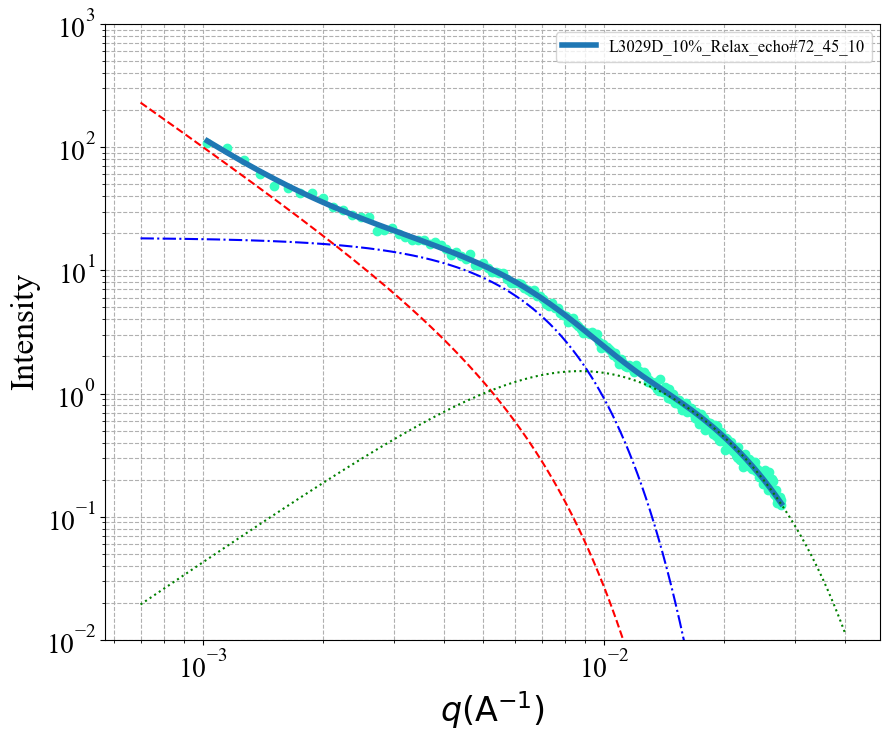


 Chi-square (func_1 with fixed params): 6.98286340458648
Sample: L3029D_10%_Relax_echo#73_45_10 - Parameter 1: 2.0232e-05
Sample: L3029D_10%_Relax_echo#73_45_10 - Parameter 2: 2.2360e+00
Sample: L3029D_10%_Relax_echo#73_45_10 - Parameter 3: 2.8683e+02
Sample: L3029D_10%_Relax_echo#73_45_10 - Parameter 4: 1.6918e+01
Sample: L3029D_10%_Relax_echo#73_45_10 - Parameter 5: 6.0116e-02
Sample: L3029D_10%_Relax_echo#73_45_10 - Parameter 6: 7.6679e-01
Sample: L3029D_10%_Relax_echo#73_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#73_45_10 - Parameter 8: 4.1812e-03
Sample: L3029D_10%_Relax_echo#73_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#73_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2360 ± 0.0984
Rss: 286.8309 ± 22.3893



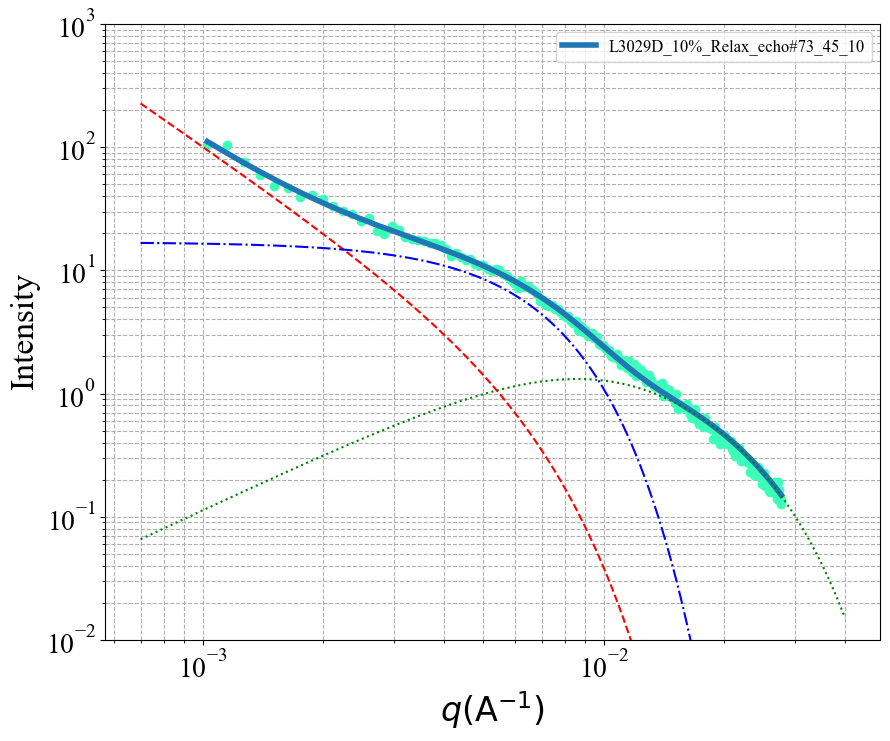


 Chi-square (func_1 with fixed params): 6.439983810044423
Sample: L3029D_10%_Relax_echo#74_45_10 - Parameter 1: 3.2449e-05
Sample: L3029D_10%_Relax_echo#74_45_10 - Parameter 2: 2.1625e+00
Sample: L3029D_10%_Relax_echo#74_45_10 - Parameter 3: 2.8023e+02
Sample: L3029D_10%_Relax_echo#74_45_10 - Parameter 4: 1.6131e+01
Sample: L3029D_10%_Relax_echo#74_45_10 - Parameter 5: 4.5707e-03
Sample: L3029D_10%_Relax_echo#74_45_10 - Parameter 6: 1.2447e+00
Sample: L3029D_10%_Relax_echo#74_45_10 - Parameter 7: 7.9781e+01
Sample: L3029D_10%_Relax_echo#74_45_10 - Parameter 8: 5.0779e-01
Sample: L3029D_10%_Relax_echo#74_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#74_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1625 ± 0.0928
Rss: 280.2291 ± 18.1386



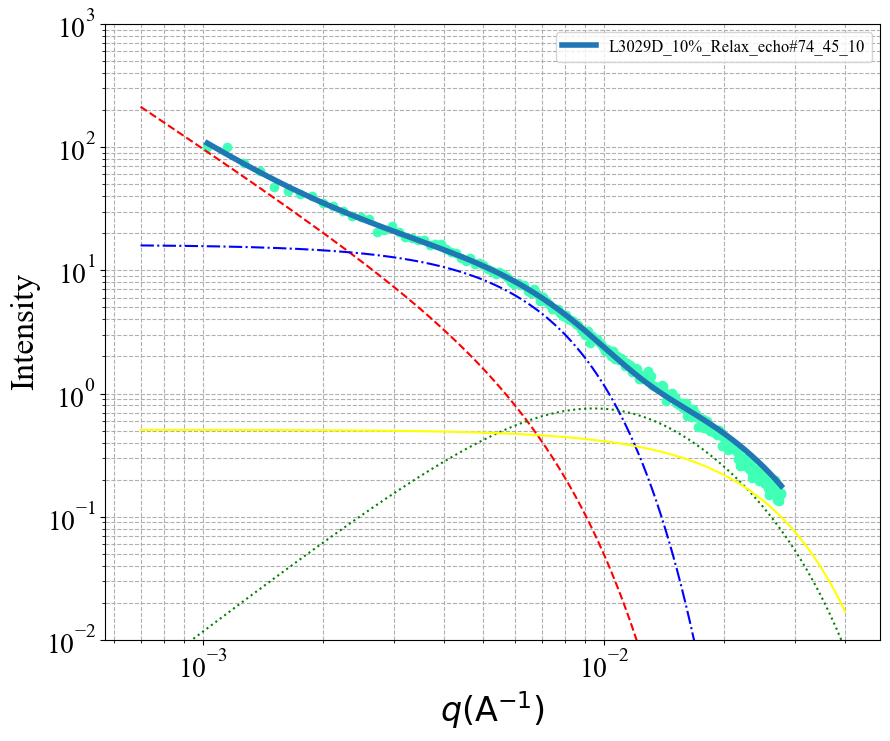


 Chi-square (func_1 with fixed params): 6.3094953201913135
Sample: L3029D_10%_Relax_echo#75_45_10 - Parameter 1: 7.2922e-06
Sample: L3029D_10%_Relax_echo#75_45_10 - Parameter 2: 2.3812e+00
Sample: L3029D_10%_Relax_echo#75_45_10 - Parameter 3: 3.0888e+02
Sample: L3029D_10%_Relax_echo#75_45_10 - Parameter 4: 1.9862e+01
Sample: L3029D_10%_Relax_echo#75_45_10 - Parameter 5: 7.9201e-03
Sample: L3029D_10%_Relax_echo#75_45_10 - Parameter 6: 1.2596e+00
Sample: L3029D_10%_Relax_echo#75_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#75_45_10 - Parameter 8: 5.8995e-03
Sample: L3029D_10%_Relax_echo#75_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#75_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3812 ± 0.1027
Rss: 308.8832 ± 19.6223



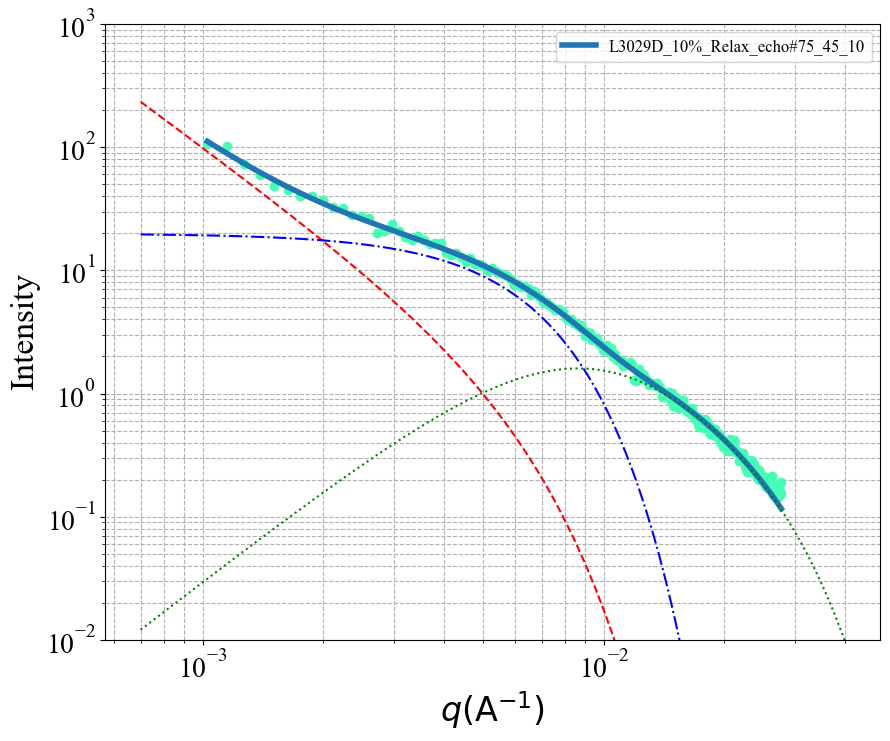


 Chi-square (func_1 with fixed params): 6.099336549611472
Sample: L3029D_10%_Relax_echo#76_45_10 - Parameter 1: 1.3741e-05
Sample: L3029D_10%_Relax_echo#76_45_10 - Parameter 2: 2.2891e+00
Sample: L3029D_10%_Relax_echo#76_45_10 - Parameter 3: 3.0669e+02
Sample: L3029D_10%_Relax_echo#76_45_10 - Parameter 4: 1.9170e+01
Sample: L3029D_10%_Relax_echo#76_45_10 - Parameter 5: 5.7253e-03
Sample: L3029D_10%_Relax_echo#76_45_10 - Parameter 6: 1.3432e+00
Sample: L3029D_10%_Relax_echo#76_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#76_45_10 - Parameter 8: 3.1988e-03
Sample: L3029D_10%_Relax_echo#76_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#76_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2891 ± 0.0958
Rss: 306.6872 ± 19.8578



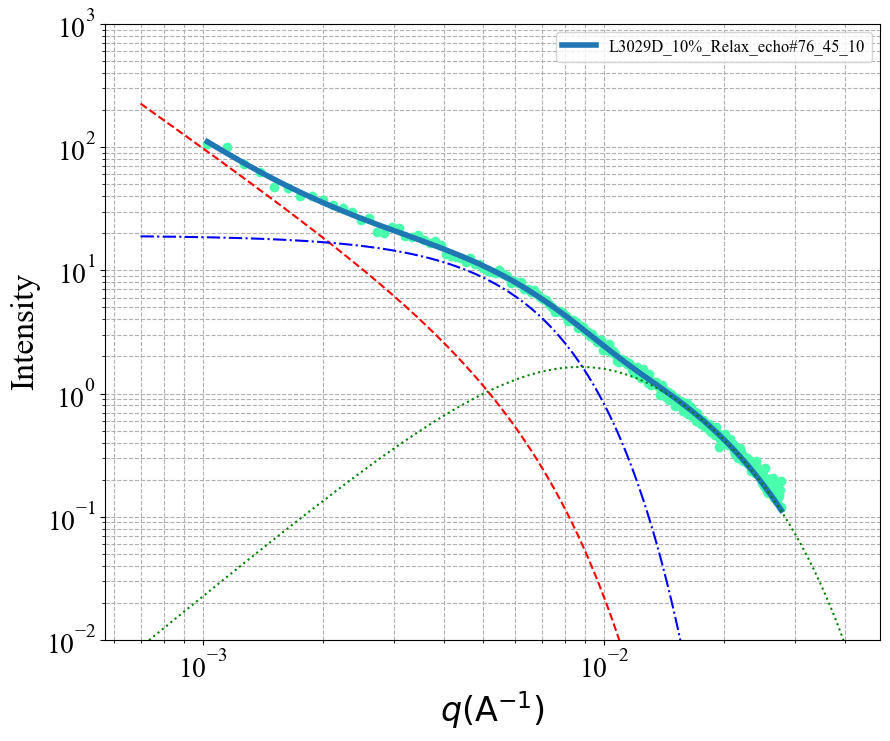


 Chi-square (func_1 with fixed params): 6.810289000651344
Sample: L3029D_10%_Relax_echo#77_45_10 - Parameter 1: 1.8546e-05
Sample: L3029D_10%_Relax_echo#77_45_10 - Parameter 2: 2.2505e+00
Sample: L3029D_10%_Relax_echo#77_45_10 - Parameter 3: 2.8737e+02
Sample: L3029D_10%_Relax_echo#77_45_10 - Parameter 4: 1.7016e+01
Sample: L3029D_10%_Relax_echo#77_45_10 - Parameter 5: 4.3024e-02
Sample: L3029D_10%_Relax_echo#77_45_10 - Parameter 6: 8.4625e-01
Sample: L3029D_10%_Relax_echo#77_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#77_45_10 - Parameter 8: 4.8004e-03
Sample: L3029D_10%_Relax_echo#77_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#77_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2505 ± 0.1034
Rss: 287.3707 ± 23.1692



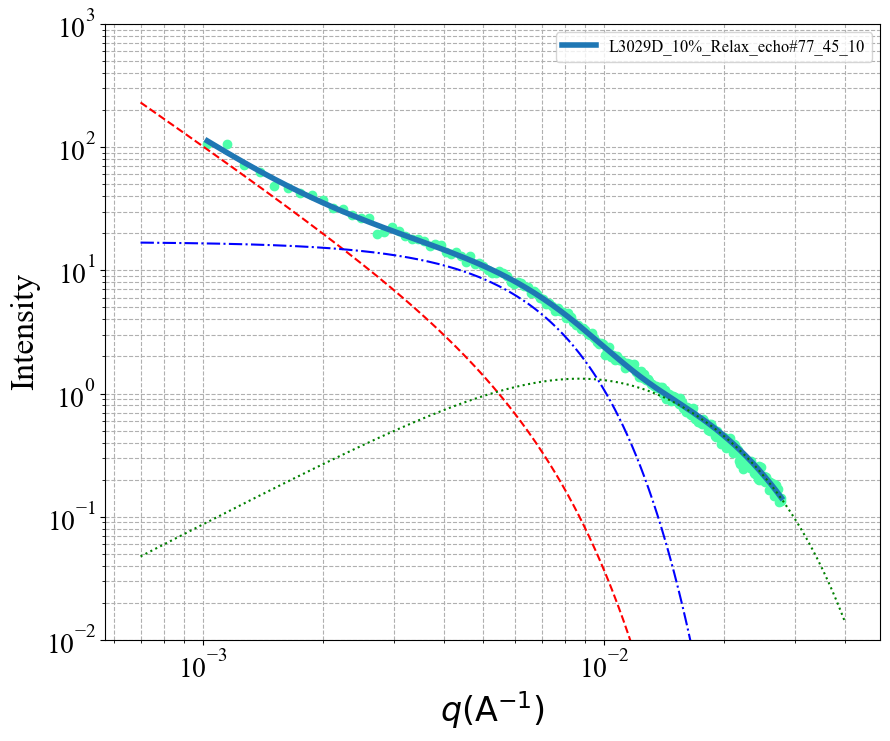


 Chi-square (func_1 with fixed params): 6.775081462442366
Sample: L3029D_10%_Relax_echo#78_45_10 - Parameter 1: 2.9779e-05
Sample: L3029D_10%_Relax_echo#78_45_10 - Parameter 2: 2.1752e+00
Sample: L3029D_10%_Relax_echo#78_45_10 - Parameter 3: 2.9431e+02
Sample: L3029D_10%_Relax_echo#78_45_10 - Parameter 4: 1.7287e+01
Sample: L3029D_10%_Relax_echo#78_45_10 - Parameter 5: 2.0212e-02
Sample: L3029D_10%_Relax_echo#78_45_10 - Parameter 6: 1.0354e+00
Sample: L3029D_10%_Relax_echo#78_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#78_45_10 - Parameter 8: 4.4364e-03
Sample: L3029D_10%_Relax_echo#78_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#78_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1752 ± 0.1026
Rss: 294.3134 ± 22.4317



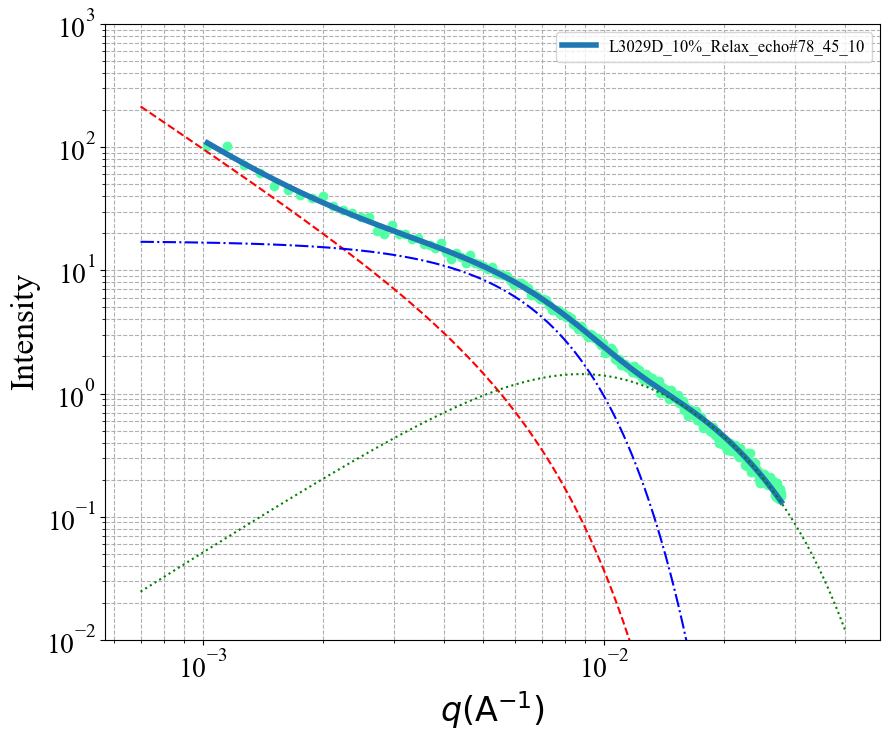


 Chi-square (func_1 with fixed params): 5.238414642509349
Sample: L3029D_10%_Relax_echo#79_45_10 - Parameter 1: 1.4954e-05
Sample: L3029D_10%_Relax_echo#79_45_10 - Parameter 2: 2.2771e+00
Sample: L3029D_10%_Relax_echo#79_45_10 - Parameter 3: 2.9552e+02
Sample: L3029D_10%_Relax_echo#79_45_10 - Parameter 4: 1.8191e+01
Sample: L3029D_10%_Relax_echo#79_45_10 - Parameter 5: 2.3635e-02
Sample: L3029D_10%_Relax_echo#79_45_10 - Parameter 6: 9.9365e-01
Sample: L3029D_10%_Relax_echo#79_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#79_45_10 - Parameter 8: 5.5354e-03
Sample: L3029D_10%_Relax_echo#79_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#79_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2771 ± 0.0909
Rss: 295.5162 ± 18.4334



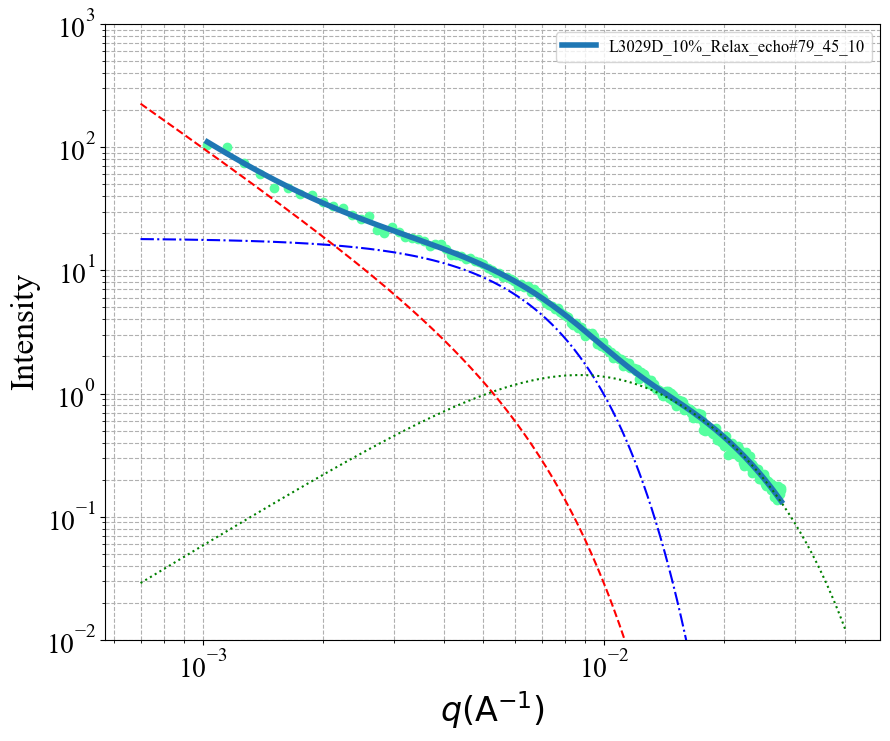


 Chi-square (func_1 with fixed params): 5.663027870520868
Sample: L3029D_10%_Relax_echo#80_45_10 - Parameter 1: 2.4938e-05
Sample: L3029D_10%_Relax_echo#80_45_10 - Parameter 2: 2.2001e+00
Sample: L3029D_10%_Relax_echo#80_45_10 - Parameter 3: 2.9516e+02
Sample: L3029D_10%_Relax_echo#80_45_10 - Parameter 4: 1.7748e+01
Sample: L3029D_10%_Relax_echo#80_45_10 - Parameter 5: 3.0221e-02
Sample: L3029D_10%_Relax_echo#80_45_10 - Parameter 6: 9.3654e-01
Sample: L3029D_10%_Relax_echo#80_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#80_45_10 - Parameter 8: 5.3318e-03
Sample: L3029D_10%_Relax_echo#80_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#80_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2001 ± 0.0965
Rss: 295.1585 ± 20.3073



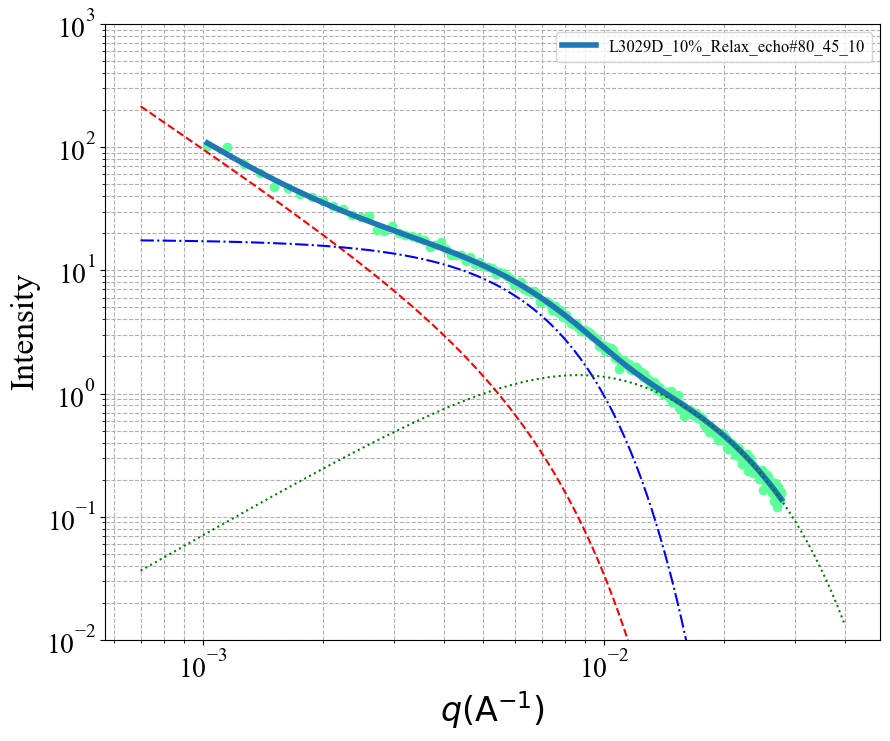


 Chi-square (func_1 with fixed params): 4.686315351721281
Sample: L3029D_10%_Relax_echo#81_45_10 - Parameter 1: 1.5469e-05
Sample: L3029D_10%_Relax_echo#81_45_10 - Parameter 2: 2.2733e+00
Sample: L3029D_10%_Relax_echo#81_45_10 - Parameter 3: 2.8822e+02
Sample: L3029D_10%_Relax_echo#81_45_10 - Parameter 4: 1.7111e+01
Sample: L3029D_10%_Relax_echo#81_45_10 - Parameter 5: 4.5638e-03
Sample: L3029D_10%_Relax_echo#81_45_10 - Parameter 6: 1.2971e+00
Sample: L3029D_10%_Relax_echo#81_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#81_45_10 - Parameter 8: 4.5985e-01
Sample: L3029D_10%_Relax_echo#81_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#81_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2733 ± 0.0818
Rss: 288.2228 ± 16.0038



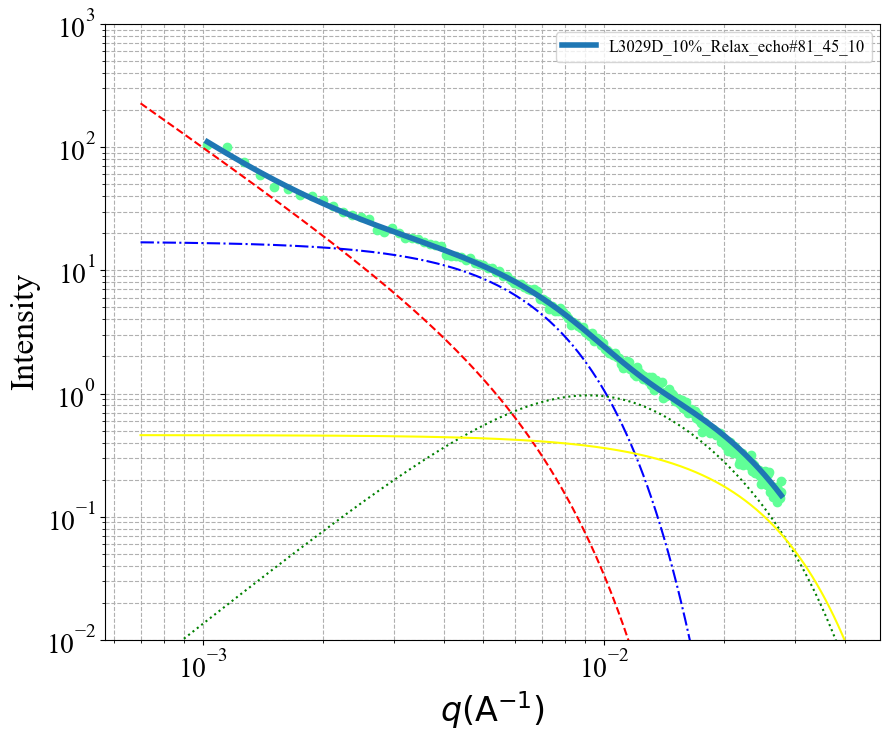


 Chi-square (func_1 with fixed params): 4.907703375360699
Sample: L3029D_10%_Relax_echo#82_45_10 - Parameter 1: 3.3750e-05
Sample: L3029D_10%_Relax_echo#82_45_10 - Parameter 2: 2.1593e+00
Sample: L3029D_10%_Relax_echo#82_45_10 - Parameter 3: 2.8532e+02
Sample: L3029D_10%_Relax_echo#82_45_10 - Parameter 4: 1.6421e+01
Sample: L3029D_10%_Relax_echo#82_45_10 - Parameter 5: 3.3791e-02
Sample: L3029D_10%_Relax_echo#82_45_10 - Parameter 6: 9.0226e-01
Sample: L3029D_10%_Relax_echo#82_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#82_45_10 - Parameter 8: 2.9140e-02
Sample: L3029D_10%_Relax_echo#82_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#82_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1593 ± 0.0774
Rss: 285.3200 ± 17.6396



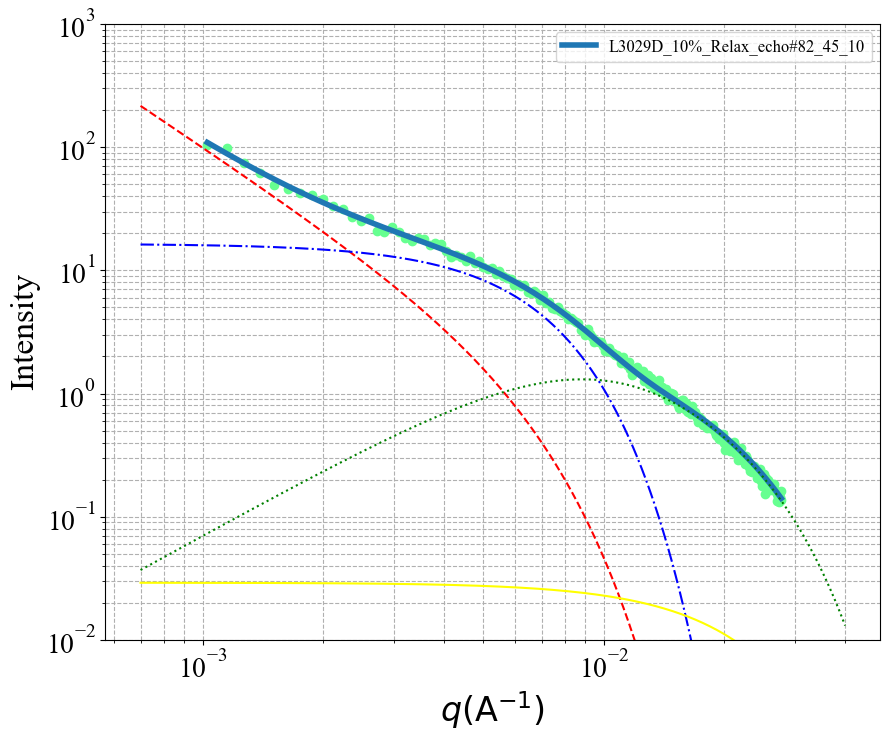


 Chi-square (func_1 with fixed params): 7.284884888504827
Sample: L3029D_10%_Relax_echo#83_45_10 - Parameter 1: 2.5581e-05
Sample: L3029D_10%_Relax_echo#83_45_10 - Parameter 2: 2.1939e+00
Sample: L3029D_10%_Relax_echo#83_45_10 - Parameter 3: 2.8691e+02
Sample: L3029D_10%_Relax_echo#83_45_10 - Parameter 4: 1.6871e+01
Sample: L3029D_10%_Relax_echo#83_45_10 - Parameter 5: 1.5795e-03
Sample: L3029D_10%_Relax_echo#83_45_10 - Parameter 6: 1.5088e+00
Sample: L3029D_10%_Relax_echo#83_45_10 - Parameter 7: 8.3072e+01
Sample: L3029D_10%_Relax_echo#83_45_10 - Parameter 8: 5.5733e-01
Sample: L3029D_10%_Relax_echo#83_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#83_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1939 ± 0.1058
Rss: 286.9149 ± 19.9795



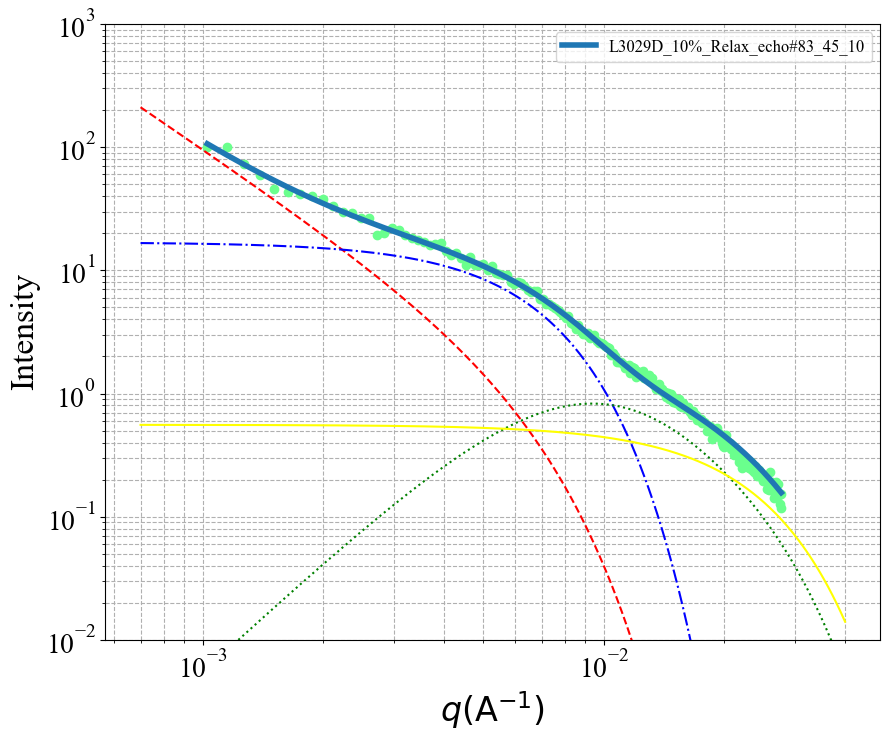


 Chi-square (func_1 with fixed params): 4.870311430074487
Sample: L3029D_10%_Relax_echo#84_45_10 - Parameter 1: 5.5223e-06
Sample: L3029D_10%_Relax_echo#84_45_10 - Parameter 2: 2.4213e+00
Sample: L3029D_10%_Relax_echo#84_45_10 - Parameter 3: 3.0559e+02
Sample: L3029D_10%_Relax_echo#84_45_10 - Parameter 4: 1.9730e+01
Sample: L3029D_10%_Relax_echo#84_45_10 - Parameter 5: 3.5375e-05
Sample: L3029D_10%_Relax_echo#84_45_10 - Parameter 6: 2.4228e+00
Sample: L3029D_10%_Relax_echo#84_45_10 - Parameter 7: 8.0546e+01
Sample: L3029D_10%_Relax_echo#84_45_10 - Parameter 8: 5.3197e-01
Sample: L3029D_10%_Relax_echo#84_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#84_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4213 ± 0.0864
Rss: 305.5854 ± 16.3821



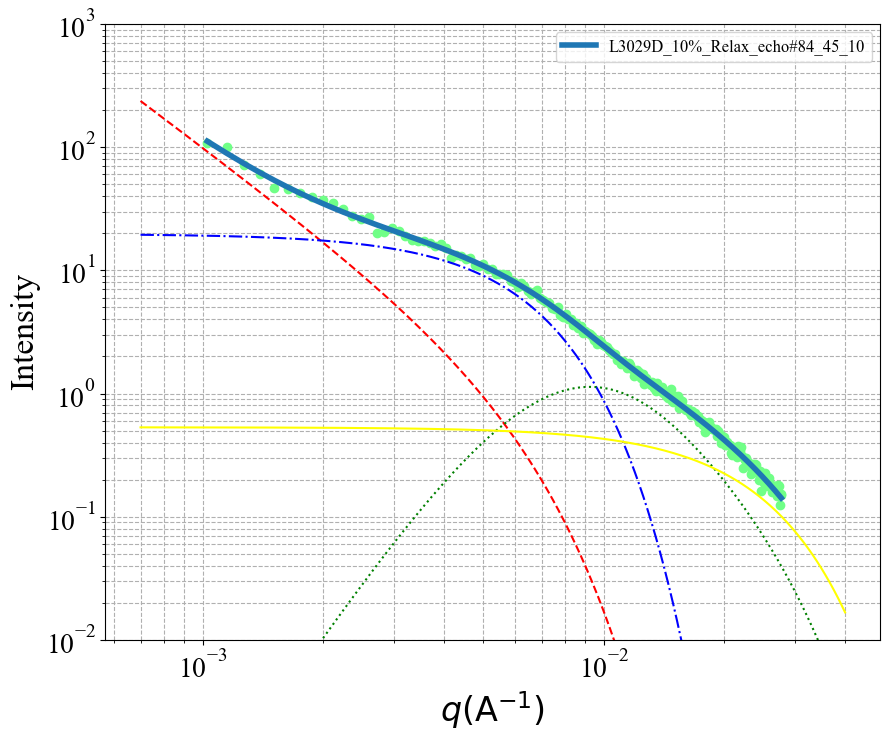


 Chi-square (func_1 with fixed params): 5.969786946009181
Sample: L3029D_10%_Relax_echo#85_45_10 - Parameter 1: 5.2792e-06
Sample: L3029D_10%_Relax_echo#85_45_10 - Parameter 2: 2.4285e+00
Sample: L3029D_10%_Relax_echo#85_45_10 - Parameter 3: 3.1332e+02
Sample: L3029D_10%_Relax_echo#85_45_10 - Parameter 4: 2.0554e+01
Sample: L3029D_10%_Relax_echo#85_45_10 - Parameter 5: 5.4290e-03
Sample: L3029D_10%_Relax_echo#85_45_10 - Parameter 6: 1.3522e+00
Sample: L3029D_10%_Relax_echo#85_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#85_45_10 - Parameter 8: 7.0184e-03
Sample: L3029D_10%_Relax_echo#85_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#85_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4285 ± 0.0971
Rss: 313.3248 ± 18.2473



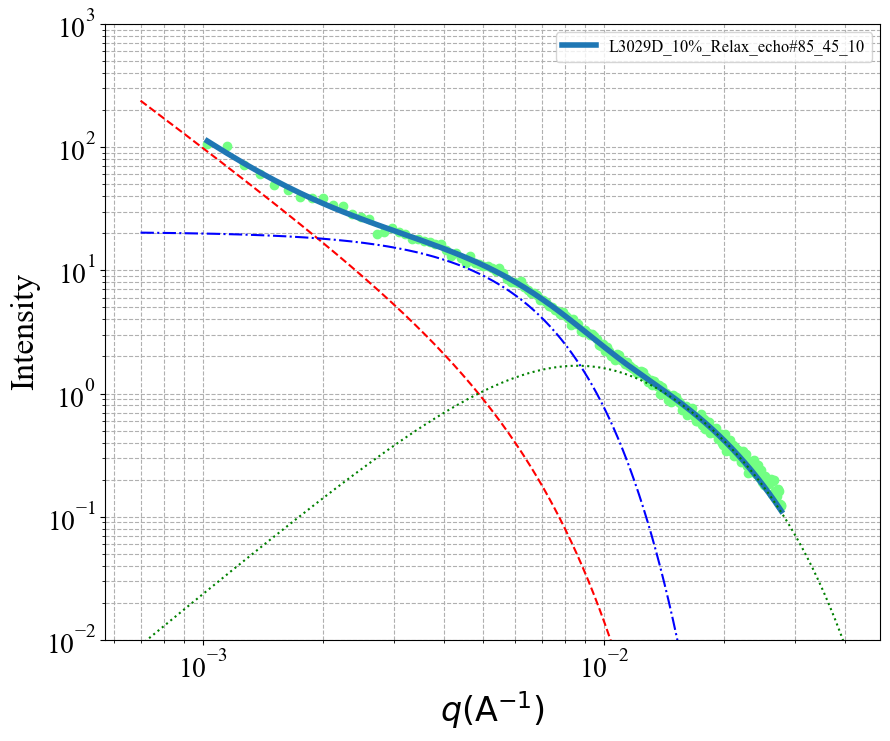


 Chi-square (func_1 with fixed params): 4.62780480458251
Sample: L3029D_10%_Relax_echo#86_45_10 - Parameter 1: 1.0462e-05
Sample: L3029D_10%_Relax_echo#86_45_10 - Parameter 2: 2.3274e+00
Sample: L3029D_10%_Relax_echo#86_45_10 - Parameter 3: 2.9803e+02
Sample: L3029D_10%_Relax_echo#86_45_10 - Parameter 4: 1.8498e+01
Sample: L3029D_10%_Relax_echo#86_45_10 - Parameter 5: 1.6706e-02
Sample: L3029D_10%_Relax_echo#86_45_10 - Parameter 6: 1.0790e+00
Sample: L3029D_10%_Relax_echo#86_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#86_45_10 - Parameter 8: 1.0512e-02
Sample: L3029D_10%_Relax_echo#86_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#86_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3274 ± 0.0831
Rss: 298.0264 ± 16.2911



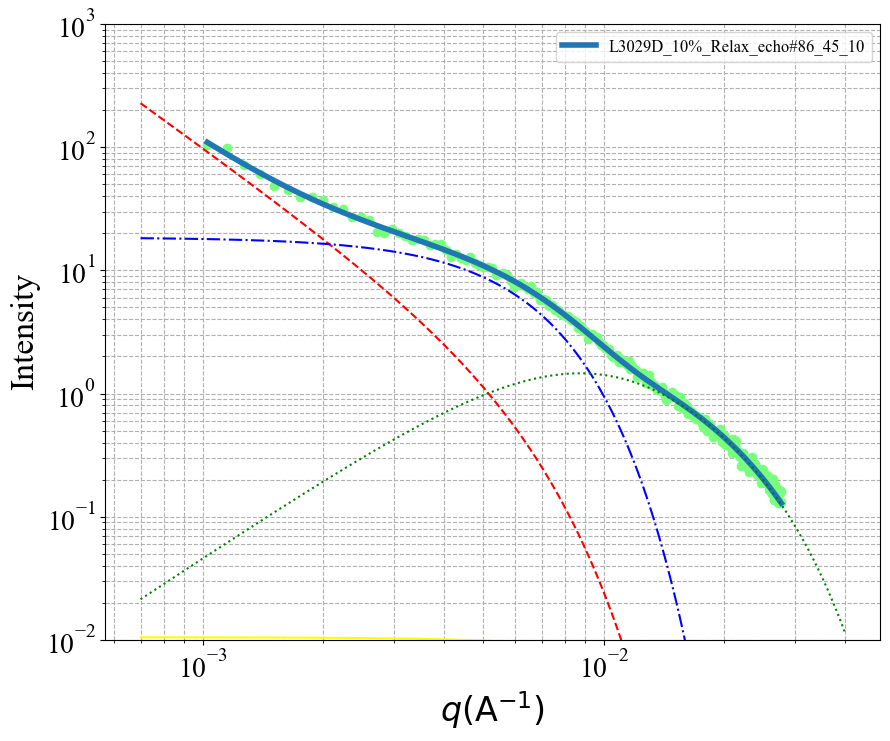


 Chi-square (func_1 with fixed params): 6.227411052269343
Sample: L3029D_10%_Relax_echo#87_45_10 - Parameter 1: 1.0962e-05
Sample: L3029D_10%_Relax_echo#87_45_10 - Parameter 2: 2.3225e+00
Sample: L3029D_10%_Relax_echo#87_45_10 - Parameter 3: 3.0243e+02
Sample: L3029D_10%_Relax_echo#87_45_10 - Parameter 4: 1.8863e+01
Sample: L3029D_10%_Relax_echo#87_45_10 - Parameter 5: 1.9720e-02
Sample: L3029D_10%_Relax_echo#87_45_10 - Parameter 6: 1.0463e+00
Sample: L3029D_10%_Relax_echo#87_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#87_45_10 - Parameter 8: 5.4483e-03
Sample: L3029D_10%_Relax_echo#87_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#87_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3225 ± 0.0991
Rss: 302.4266 ± 19.7990



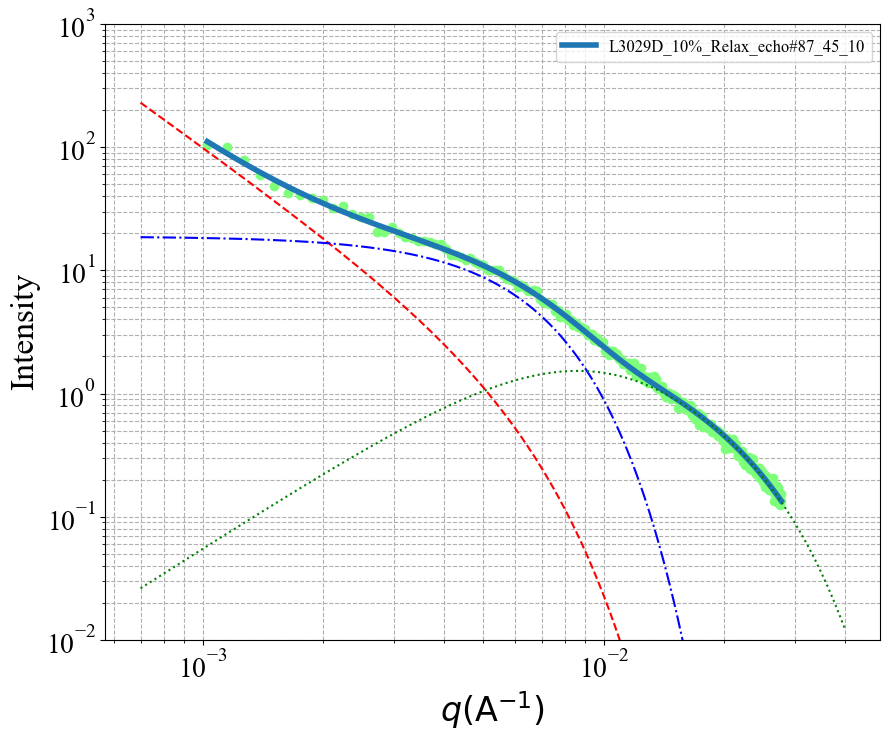


 Chi-square (func_1 with fixed params): 5.916425377913494
Sample: L3029D_10%_Relax_echo#88_45_10 - Parameter 1: 4.9010e-06
Sample: L3029D_10%_Relax_echo#88_45_10 - Parameter 2: 2.4390e+00
Sample: L3029D_10%_Relax_echo#88_45_10 - Parameter 3: 3.1599e+02
Sample: L3029D_10%_Relax_echo#88_45_10 - Parameter 4: 2.0557e+01
Sample: L3029D_10%_Relax_echo#88_45_10 - Parameter 5: 4.1693e-05
Sample: L3029D_10%_Relax_echo#88_45_10 - Parameter 6: 2.3962e+00
Sample: L3029D_10%_Relax_echo#88_45_10 - Parameter 7: 8.4995e+01
Sample: L3029D_10%_Relax_echo#88_45_10 - Parameter 8: 6.0293e-01
Sample: L3029D_10%_Relax_echo#88_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#88_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4390 ± 0.0990
Rss: 315.9915 ± 19.3155



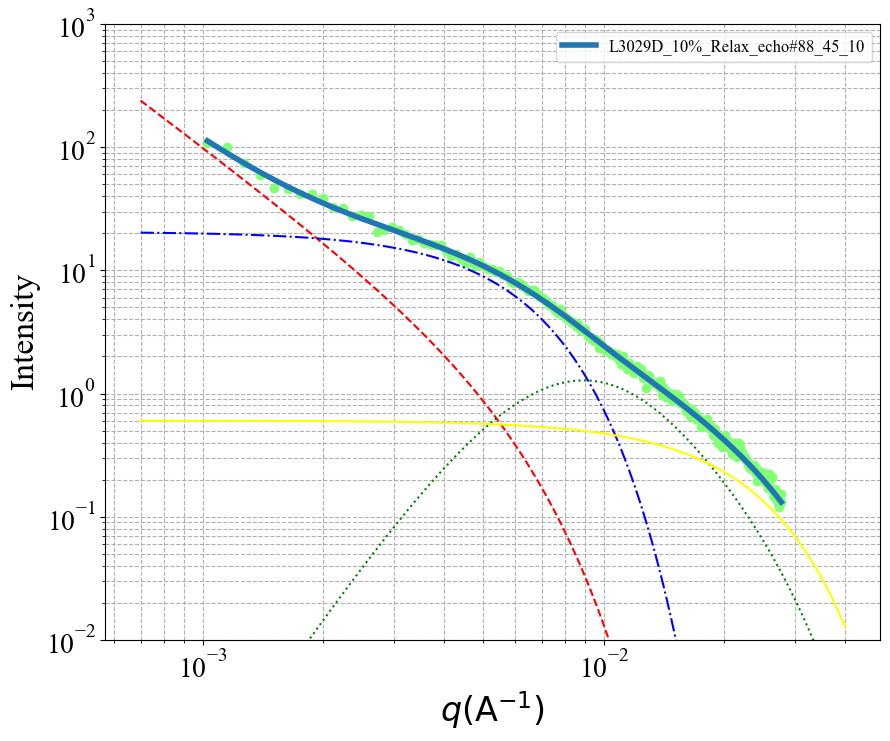


 Chi-square (func_1 with fixed params): 6.833453902679803
Sample: L3029D_10%_Relax_echo#89_45_10 - Parameter 1: 1.5922e-05
Sample: L3029D_10%_Relax_echo#89_45_10 - Parameter 2: 2.2724e+00
Sample: L3029D_10%_Relax_echo#89_45_10 - Parameter 3: 2.9637e+02
Sample: L3029D_10%_Relax_echo#89_45_10 - Parameter 4: 1.7847e+01
Sample: L3029D_10%_Relax_echo#89_45_10 - Parameter 5: 2.0653e-02
Sample: L3029D_10%_Relax_echo#89_45_10 - Parameter 6: 1.0300e+00
Sample: L3029D_10%_Relax_echo#89_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#89_45_10 - Parameter 8: 8.0188e-03
Sample: L3029D_10%_Relax_echo#89_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#89_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2724 ± 0.1039
Rss: 296.3652 ± 22.4712



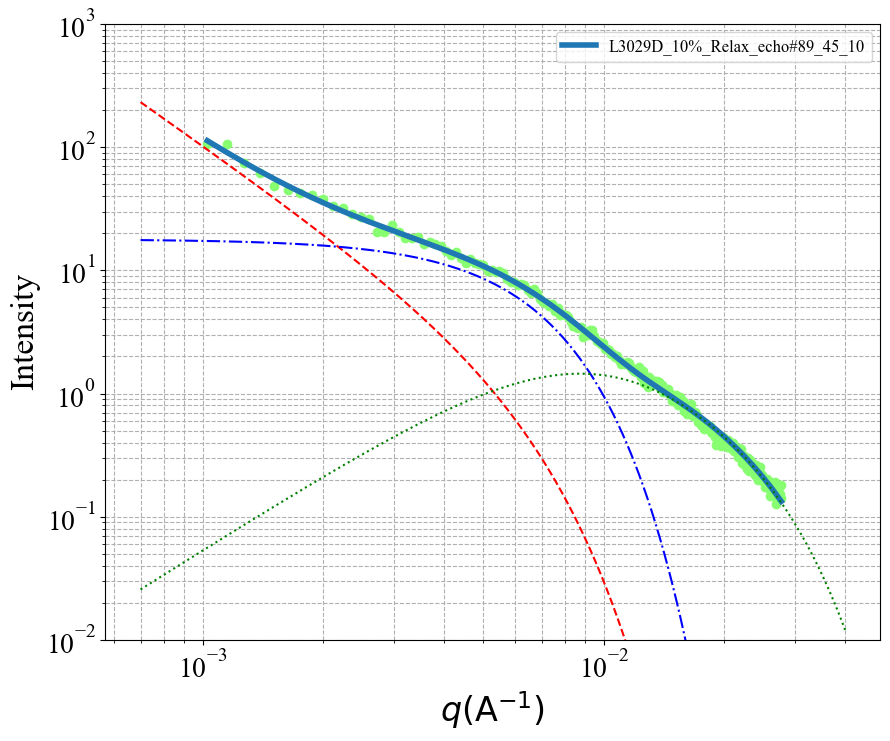


 Chi-square (func_1 with fixed params): 5.2392470908545095
Sample: L3029D_10%_Relax_echo#90_45_10 - Parameter 1: 2.8050e-05
Sample: L3029D_10%_Relax_echo#90_45_10 - Parameter 2: 2.1857e+00
Sample: L3029D_10%_Relax_echo#90_45_10 - Parameter 3: 2.9672e+02
Sample: L3029D_10%_Relax_echo#90_45_10 - Parameter 4: 1.7634e+01
Sample: L3029D_10%_Relax_echo#90_45_10 - Parameter 5: 9.0151e-03
Sample: L3029D_10%_Relax_echo#90_45_10 - Parameter 6: 1.2276e+00
Sample: L3029D_10%_Relax_echo#90_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#90_45_10 - Parameter 8: 7.4133e-03
Sample: L3029D_10%_Relax_echo#90_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#90_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1857 ± 0.0881
Rss: 296.7236 ± 19.3676



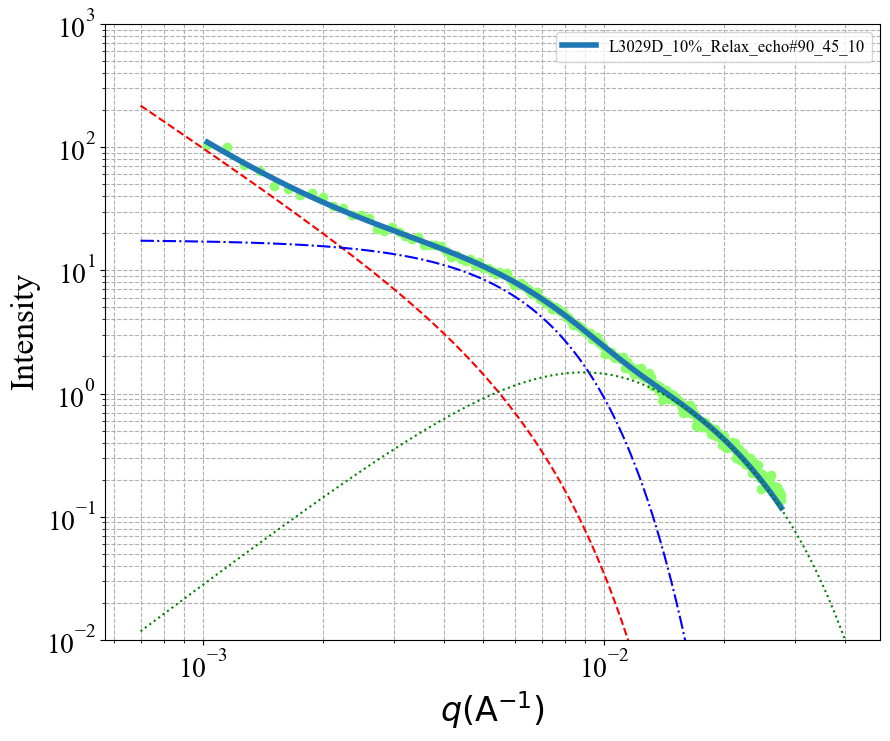


 Chi-square (func_1 with fixed params): 5.858817203359892
Sample: L3029D_10%_Relax_echo#91_45_10 - Parameter 1: 1.1645e-05
Sample: L3029D_10%_Relax_echo#91_45_10 - Parameter 2: 2.3147e+00
Sample: L3029D_10%_Relax_echo#91_45_10 - Parameter 3: 3.0329e+02
Sample: L3029D_10%_Relax_echo#91_45_10 - Parameter 4: 1.8914e+01
Sample: L3029D_10%_Relax_echo#91_45_10 - Parameter 5: 9.5321e-03
Sample: L3029D_10%_Relax_echo#91_45_10 - Parameter 6: 1.2198e+00
Sample: L3029D_10%_Relax_echo#91_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#91_45_10 - Parameter 8: 4.7934e-03
Sample: L3029D_10%_Relax_echo#91_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#91_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3147 ± 0.0992
Rss: 303.2918 ± 20.2196



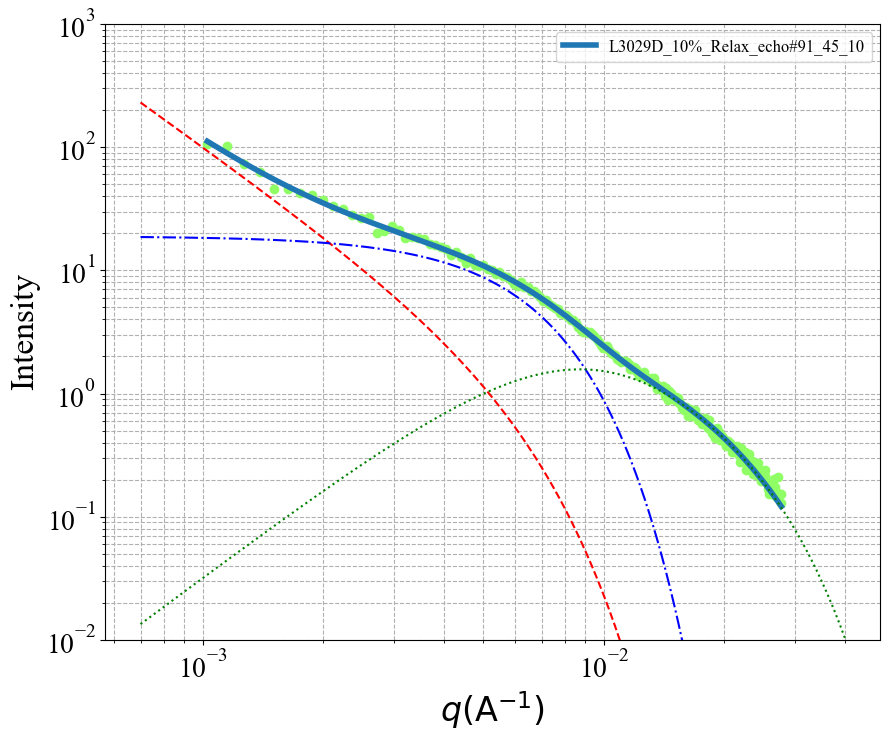


 Chi-square (func_1 with fixed params): 7.411202320883601
Sample: L3029D_10%_Relax_echo#92_45_10 - Parameter 1: 3.3165e-05
Sample: L3029D_10%_Relax_echo#92_45_10 - Parameter 2: 2.1630e+00
Sample: L3029D_10%_Relax_echo#92_45_10 - Parameter 3: 2.8593e+02
Sample: L3029D_10%_Relax_echo#92_45_10 - Parameter 4: 1.6394e+01
Sample: L3029D_10%_Relax_echo#92_45_10 - Parameter 5: 3.7548e-02
Sample: L3029D_10%_Relax_echo#92_45_10 - Parameter 6: 8.8391e-01
Sample: L3029D_10%_Relax_echo#92_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#92_45_10 - Parameter 8: 5.9162e-03
Sample: L3029D_10%_Relax_echo#92_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#92_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1630 ± 0.1058
Rss: 285.9296 ± 24.6072



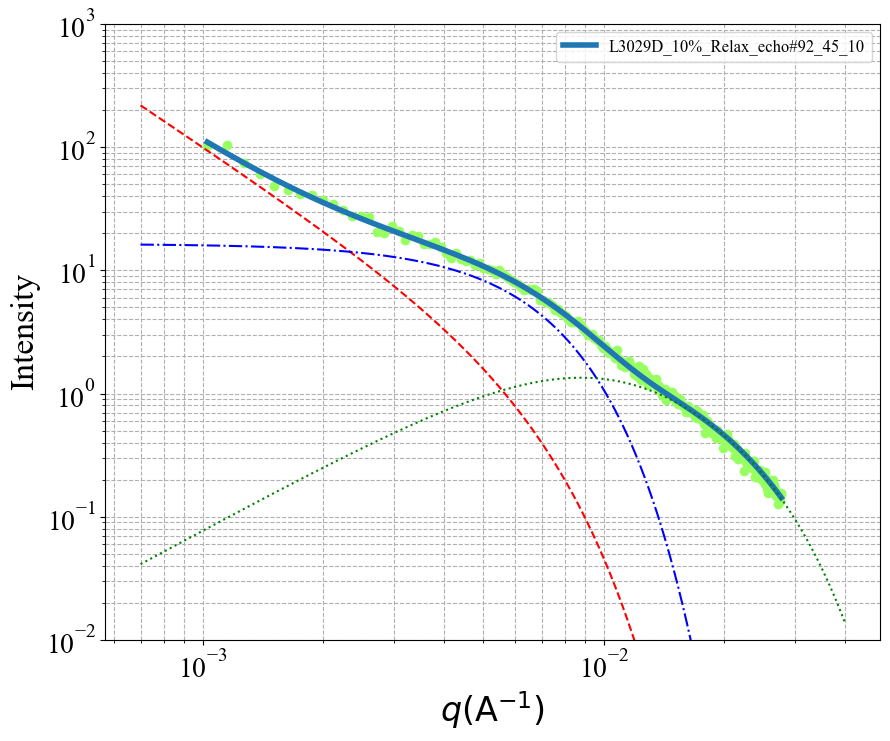


 Chi-square (func_1 with fixed params): 4.526267620039438
Sample: L3029D_10%_Relax_echo#93_45_10 - Parameter 1: 3.6971e-06
Sample: L3029D_10%_Relax_echo#93_45_10 - Parameter 2: 2.4753e+00
Sample: L3029D_10%_Relax_echo#93_45_10 - Parameter 3: 3.2184e+02
Sample: L3029D_10%_Relax_echo#93_45_10 - Parameter 4: 2.1208e+01
Sample: L3029D_10%_Relax_echo#93_45_10 - Parameter 5: 1.9848e-06
Sample: L3029D_10%_Relax_echo#93_45_10 - Parameter 6: 3.0774e+00
Sample: L3029D_10%_Relax_echo#93_45_10 - Parameter 7: 8.4981e+01
Sample: L3029D_10%_Relax_echo#93_45_10 - Parameter 8: 7.2145e-01
Sample: L3029D_10%_Relax_echo#93_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#93_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4753 ± 0.0891
Rss: 321.8408 ± 17.3123



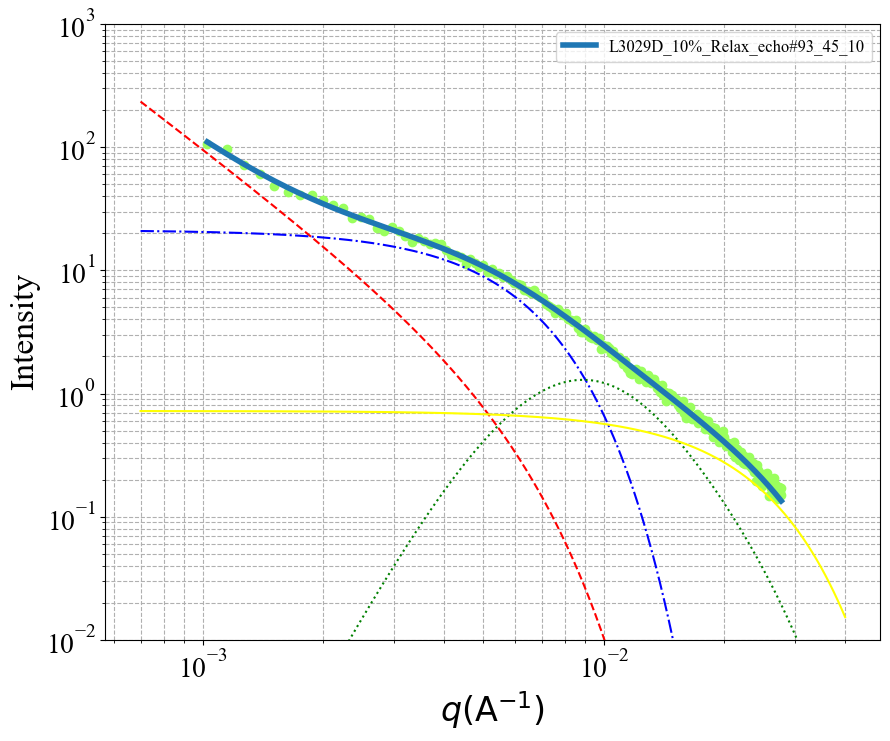


 Chi-square (func_1 with fixed params): 4.7847354314910815
Sample: L3029D_10%_Relax_echo#94_45_10 - Parameter 1: 9.4808e-06
Sample: L3029D_10%_Relax_echo#94_45_10 - Parameter 2: 2.3409e+00
Sample: L3029D_10%_Relax_echo#94_45_10 - Parameter 3: 2.9555e+02
Sample: L3029D_10%_Relax_echo#94_45_10 - Parameter 4: 1.8461e+01
Sample: L3029D_10%_Relax_echo#94_45_10 - Parameter 5: 1.5140e-04
Sample: L3029D_10%_Relax_echo#94_45_10 - Parameter 6: 2.0524e+00
Sample: L3029D_10%_Relax_echo#94_45_10 - Parameter 7: 8.1365e+01
Sample: L3029D_10%_Relax_echo#94_45_10 - Parameter 8: 6.3195e-01
Sample: L3029D_10%_Relax_echo#94_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#94_45_10 - Parameter 10: 9.9965e-09

Dm: 2.3409 ± 0.0795
Rss: 295.5524 ± 14.4049



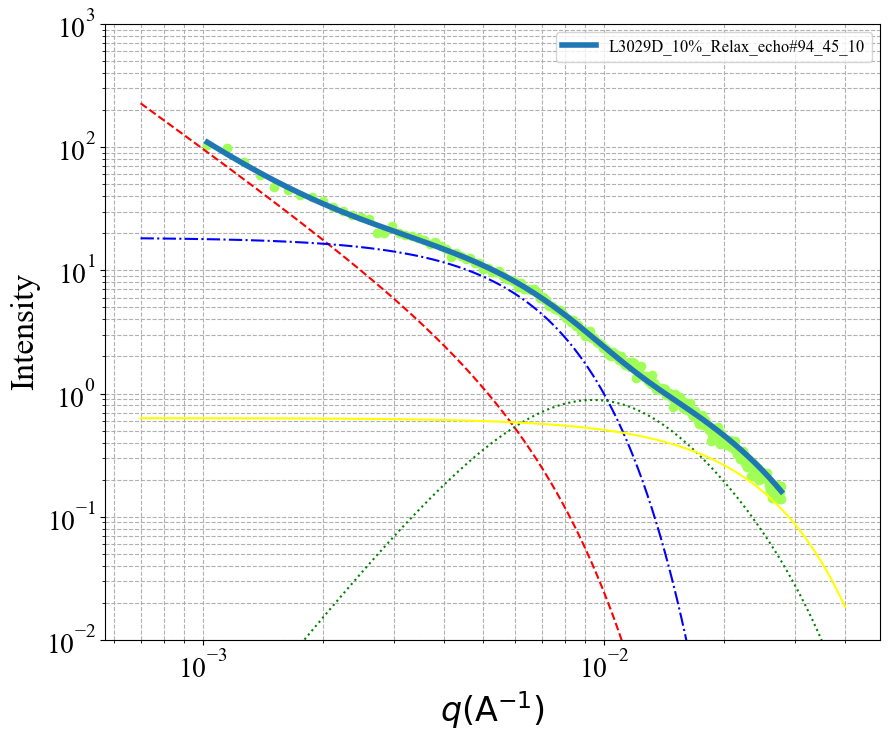


 Chi-square (func_1 with fixed params): 5.677869280038211
Sample: L3029D_10%_Relax_echo#95_45_10 - Parameter 1: 1.2592e-05
Sample: L3029D_10%_Relax_echo#95_45_10 - Parameter 2: 2.3017e+00
Sample: L3029D_10%_Relax_echo#95_45_10 - Parameter 3: 2.9098e+02
Sample: L3029D_10%_Relax_echo#95_45_10 - Parameter 4: 1.7792e+01
Sample: L3029D_10%_Relax_echo#95_45_10 - Parameter 5: 3.3867e-04
Sample: L3029D_10%_Relax_echo#95_45_10 - Parameter 6: 1.8861e+00
Sample: L3029D_10%_Relax_echo#95_45_10 - Parameter 7: 8.0239e+01
Sample: L3029D_10%_Relax_echo#95_45_10 - Parameter 8: 5.0503e-01
Sample: L3029D_10%_Relax_echo#95_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#95_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3017 ± 0.0941
Rss: 290.9768 ± 17.9651



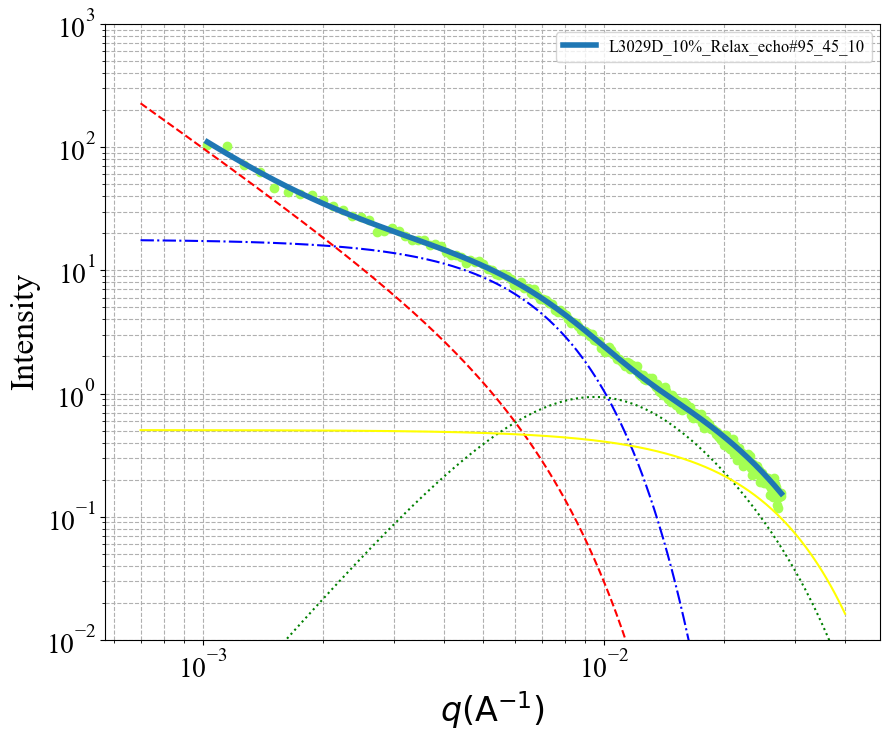


 Chi-square (func_1 with fixed params): 5.251213486763245
Sample: L3029D_10%_Relax_echo#96_45_10 - Parameter 1: 9.1123e-06
Sample: L3029D_10%_Relax_echo#96_45_10 - Parameter 2: 2.3481e+00
Sample: L3029D_10%_Relax_echo#96_45_10 - Parameter 3: 3.0226e+02
Sample: L3029D_10%_Relax_echo#96_45_10 - Parameter 4: 1.9074e+01
Sample: L3029D_10%_Relax_echo#96_45_10 - Parameter 5: 1.7292e-02
Sample: L3029D_10%_Relax_echo#96_45_10 - Parameter 6: 1.0681e+00
Sample: L3029D_10%_Relax_echo#96_45_10 - Parameter 7: 8.3391e+01
Sample: L3029D_10%_Relax_echo#96_45_10 - Parameter 8: 9.0575e-03
Sample: L3029D_10%_Relax_echo#96_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#96_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3481 ± 0.0872
Rss: 302.2592 ± 16.7388



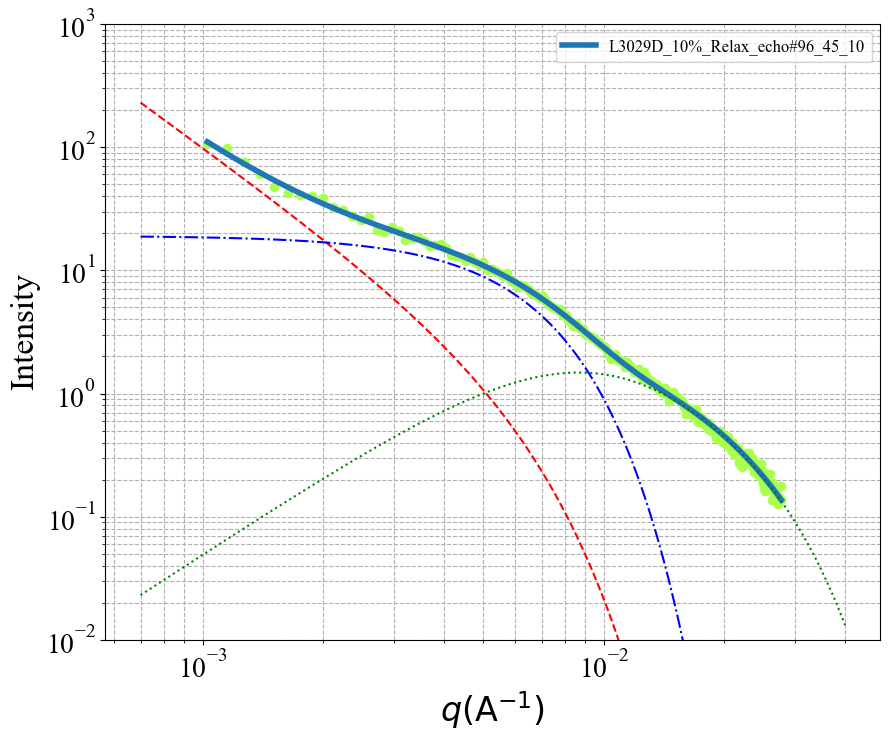


 Chi-square (func_1 with fixed params): 4.6003502406890355
Sample: L3029D_10%_Relax_echo#97_45_10 - Parameter 1: 1.1619e-05
Sample: L3029D_10%_Relax_echo#97_45_10 - Parameter 2: 2.3156e+00
Sample: L3029D_10%_Relax_echo#97_45_10 - Parameter 3: 3.0209e+02
Sample: L3029D_10%_Relax_echo#97_45_10 - Parameter 4: 1.8712e+01
Sample: L3029D_10%_Relax_echo#97_45_10 - Parameter 5: 1.3816e-02
Sample: L3029D_10%_Relax_echo#97_45_10 - Parameter 6: 1.1260e+00
Sample: L3029D_10%_Relax_echo#97_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#97_45_10 - Parameter 8: 8.0933e-03
Sample: L3029D_10%_Relax_echo#97_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#97_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3156 ± 0.0822
Rss: 302.0875 ± 16.7207



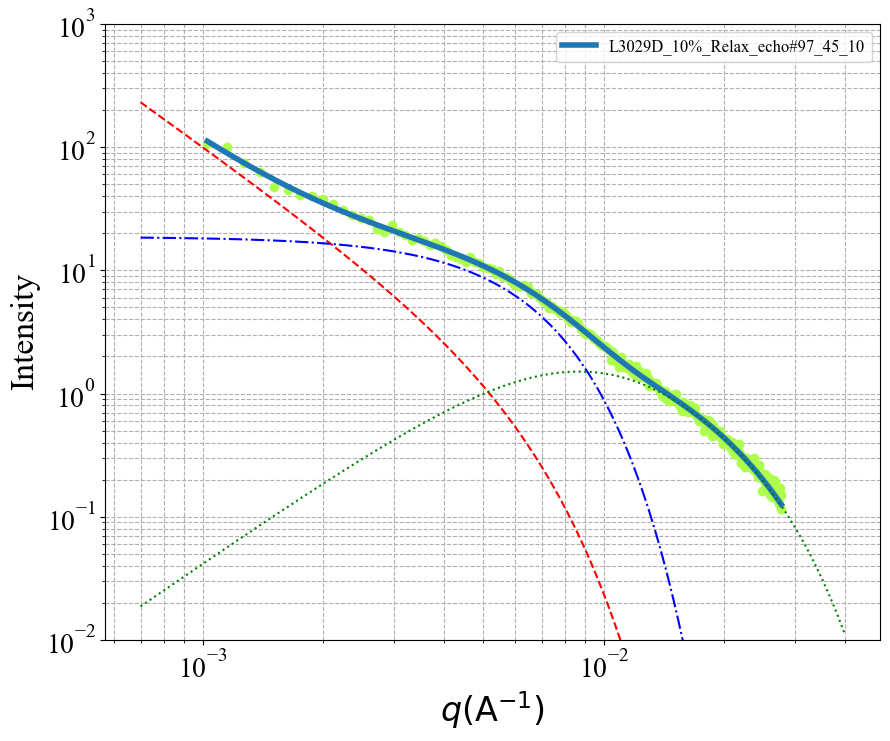


 Chi-square (func_1 with fixed params): 5.082047136329674
Sample: L3029D_10%_Relax_echo#98_45_10 - Parameter 1: 2.7341e-06
Sample: L3029D_10%_Relax_echo#98_45_10 - Parameter 2: 2.5233e+00
Sample: L3029D_10%_Relax_echo#98_45_10 - Parameter 3: 3.2046e+02
Sample: L3029D_10%_Relax_echo#98_45_10 - Parameter 4: 2.1308e+01
Sample: L3029D_10%_Relax_echo#98_45_10 - Parameter 5: 3.3399e-03
Sample: L3029D_10%_Relax_echo#98_45_10 - Parameter 6: 1.4678e+00
Sample: L3029D_10%_Relax_echo#98_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#98_45_10 - Parameter 8: 7.2877e-03
Sample: L3029D_10%_Relax_echo#98_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#98_45_10 - Parameter 10: 1.0000e-08

Dm: 2.5233 ± 0.0788
Rss: 320.4578 ± 14.5009



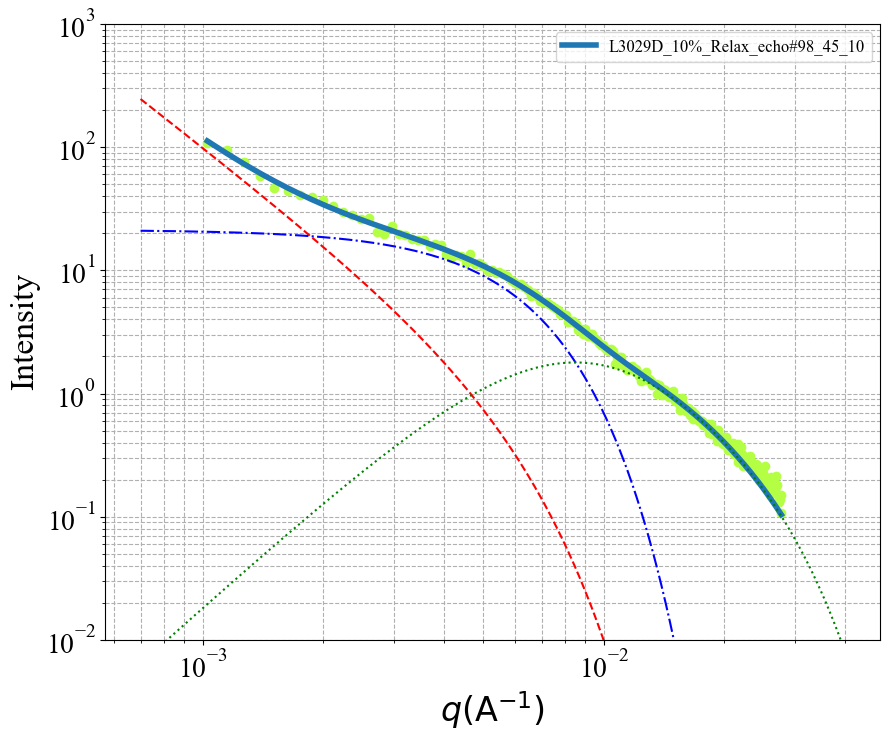


 Chi-square (func_1 with fixed params): 6.390314589907063
Sample: L3029D_10%_Relax_echo#99_45_10 - Parameter 1: 5.0660e-05
Sample: L3029D_10%_Relax_echo#99_45_10 - Parameter 2: 2.1016e+00
Sample: L3029D_10%_Relax_echo#99_45_10 - Parameter 3: 2.7764e+02
Sample: L3029D_10%_Relax_echo#99_45_10 - Parameter 4: 1.5129e+01
Sample: L3029D_10%_Relax_echo#99_45_10 - Parameter 5: 9.7035e-02
Sample: L3029D_10%_Relax_echo#99_45_10 - Parameter 6: 6.4593e-01
Sample: L3029D_10%_Relax_echo#99_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#99_45_10 - Parameter 8: 4.0798e-03
Sample: L3029D_10%_Relax_echo#99_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#99_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1016 ± 0.0885
Rss: 277.6415 ± 23.7312



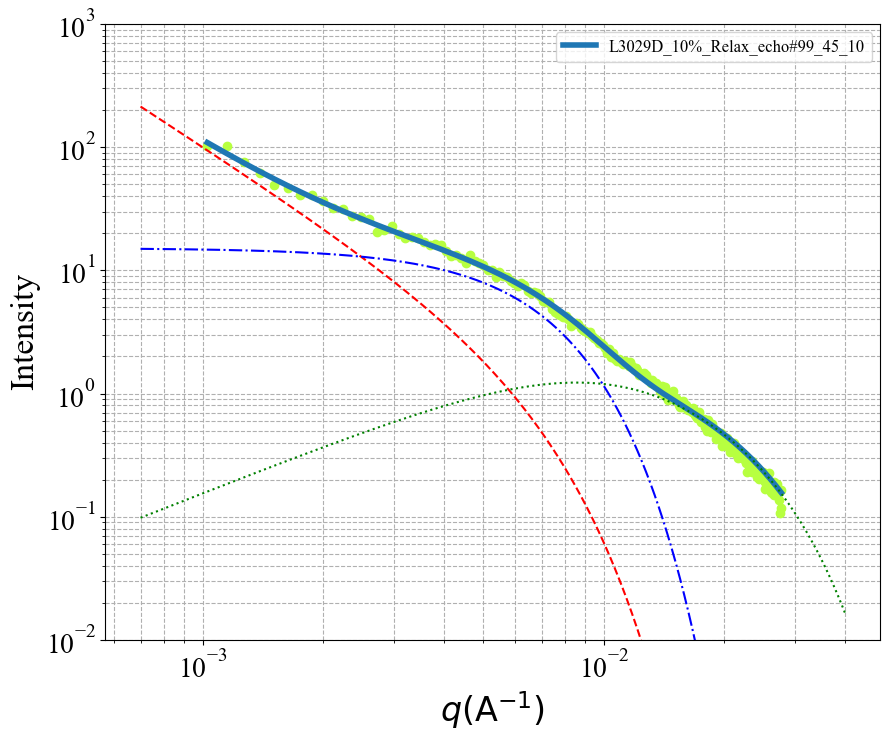


 Chi-square (func_1 with fixed params): 6.276837001819974
Sample: L3029D_10%_Relax_echo#100_45_10 - Parameter 1: 9.2737e-06
Sample: L3029D_10%_Relax_echo#100_45_10 - Parameter 2: 2.3455e+00
Sample: L3029D_10%_Relax_echo#100_45_10 - Parameter 3: 3.0594e+02
Sample: L3029D_10%_Relax_echo#100_45_10 - Parameter 4: 1.9469e+01
Sample: L3029D_10%_Relax_echo#100_45_10 - Parameter 5: 1.2004e-02
Sample: L3029D_10%_Relax_echo#100_45_10 - Parameter 6: 1.1621e+00
Sample: L3029D_10%_Relax_echo#100_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#100_45_10 - Parameter 8: 6.1751e-03
Sample: L3029D_10%_Relax_echo#100_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#100_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3455 ± 0.1065
Rss: 305.9392 ± 20.5187



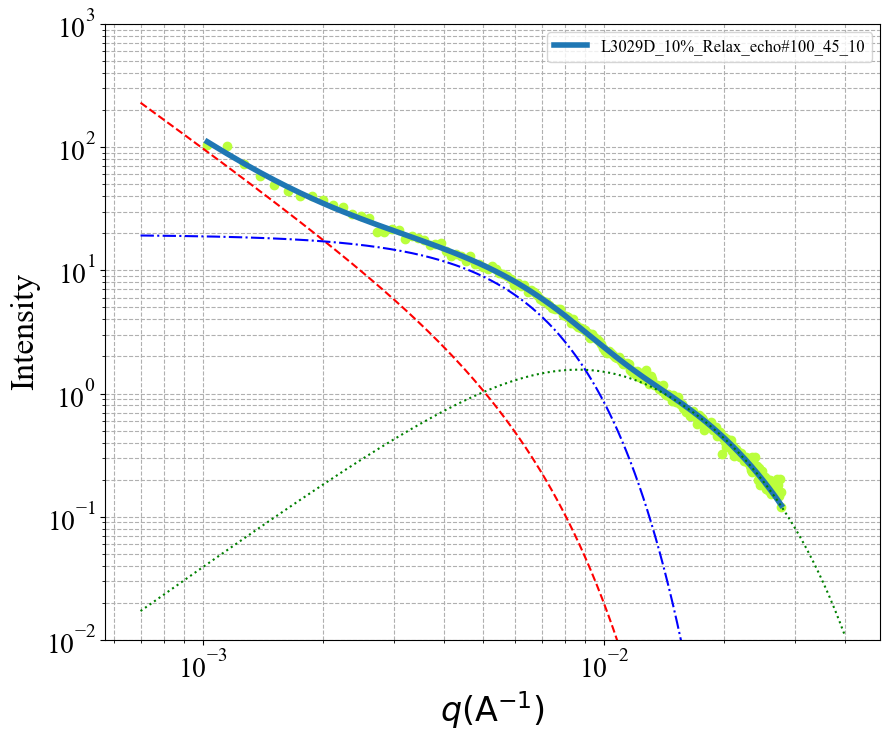


 Chi-square (func_1 with fixed params): 6.5773774352963335
Sample: L3029D_10%_Relax_echo#101_45_10 - Parameter 1: 1.4127e-05
Sample: L3029D_10%_Relax_echo#101_45_10 - Parameter 2: 2.2854e+00
Sample: L3029D_10%_Relax_echo#101_45_10 - Parameter 3: 2.9021e+02
Sample: L3029D_10%_Relax_echo#101_45_10 - Parameter 4: 1.7659e+01
Sample: L3029D_10%_Relax_echo#101_45_10 - Parameter 5: 8.0071e-04
Sample: L3029D_10%_Relax_echo#101_45_10 - Parameter 6: 1.6805e+00
Sample: L3029D_10%_Relax_echo#101_45_10 - Parameter 7: 7.9964e+01
Sample: L3029D_10%_Relax_echo#101_45_10 - Parameter 8: 4.8201e-01
Sample: L3029D_10%_Relax_echo#101_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#101_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2854 ± 0.0970
Rss: 290.2126 ± 18.2777



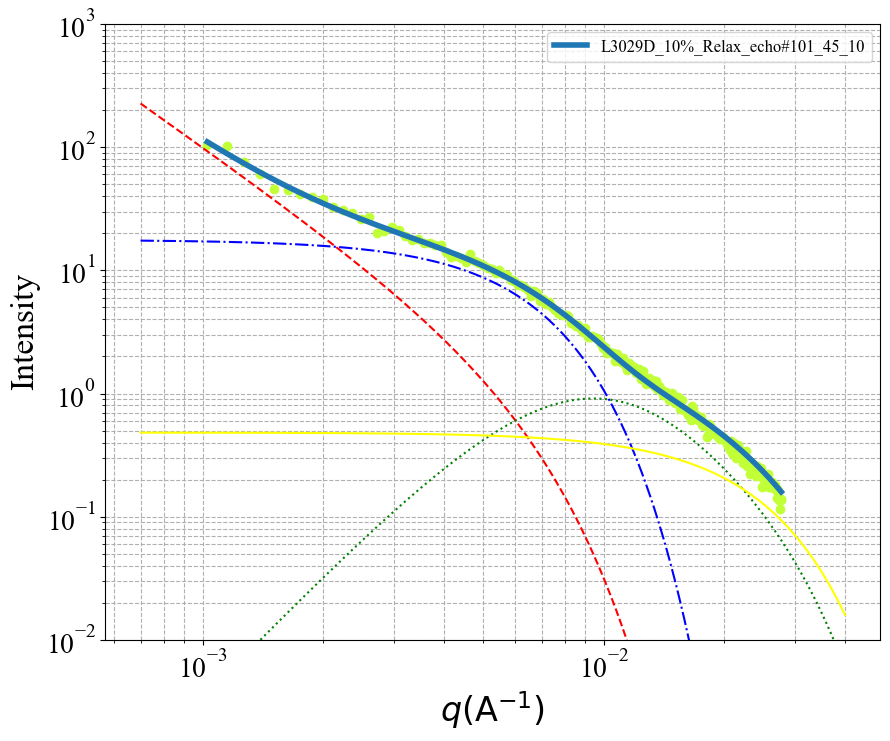


 Chi-square (func_1 with fixed params): 4.315016993149116
Sample: L3029D_10%_Relax_echo#102_45_10 - Parameter 1: 3.7799e-06
Sample: L3029D_10%_Relax_echo#102_45_10 - Parameter 2: 2.4774e+00
Sample: L3029D_10%_Relax_echo#102_45_10 - Parameter 3: 3.1380e+02
Sample: L3029D_10%_Relax_echo#102_45_10 - Parameter 4: 2.0751e+01
Sample: L3029D_10%_Relax_echo#102_45_10 - Parameter 5: 5.1751e-03
Sample: L3029D_10%_Relax_echo#102_45_10 - Parameter 6: 1.3627e+00
Sample: L3029D_10%_Relax_echo#102_45_10 - Parameter 7: 8.4042e+01
Sample: L3029D_10%_Relax_echo#102_45_10 - Parameter 8: 5.1325e-03
Sample: L3029D_10%_Relax_echo#102_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#102_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4774 ± 0.0827
Rss: 313.7978 ± 15.1955



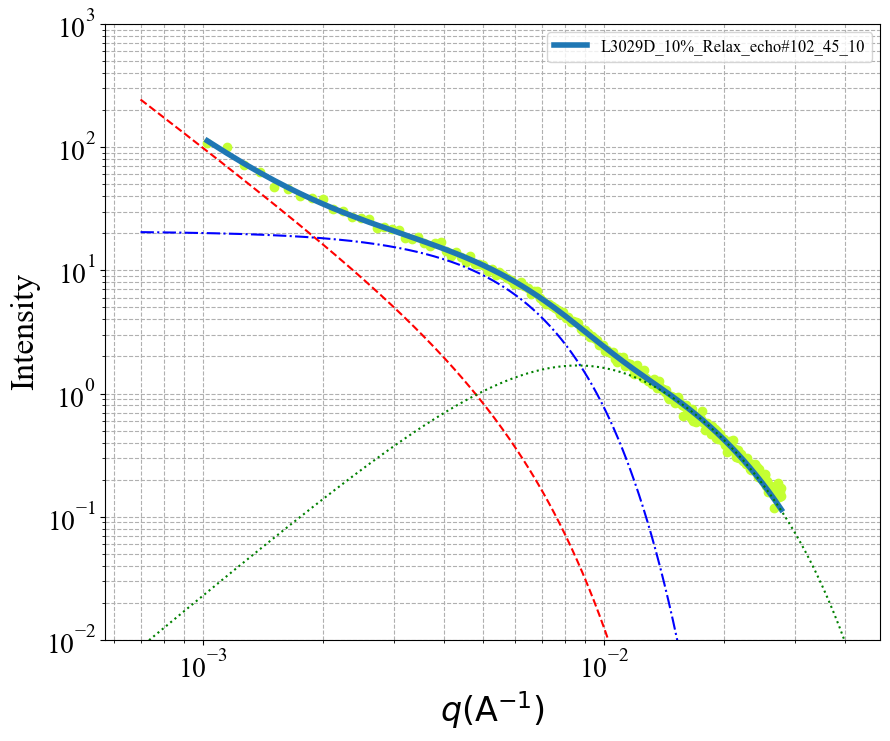


 Chi-square (func_1 with fixed params): 5.760841375972889
Sample: L3029D_10%_Relax_echo#103_45_10 - Parameter 1: 5.0616e-06
Sample: L3029D_10%_Relax_echo#103_45_10 - Parameter 2: 2.4345e+00
Sample: L3029D_10%_Relax_echo#103_45_10 - Parameter 3: 3.0486e+02
Sample: L3029D_10%_Relax_echo#103_45_10 - Parameter 4: 1.9660e+01
Sample: L3029D_10%_Relax_echo#103_45_10 - Parameter 5: 1.0488e-02
Sample: L3029D_10%_Relax_echo#103_45_10 - Parameter 6: 1.1920e+00
Sample: L3029D_10%_Relax_echo#103_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#103_45_10 - Parameter 8: 1.0314e-02
Sample: L3029D_10%_Relax_echo#103_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#103_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4345 ± 0.0945
Rss: 304.8576 ± 17.5150



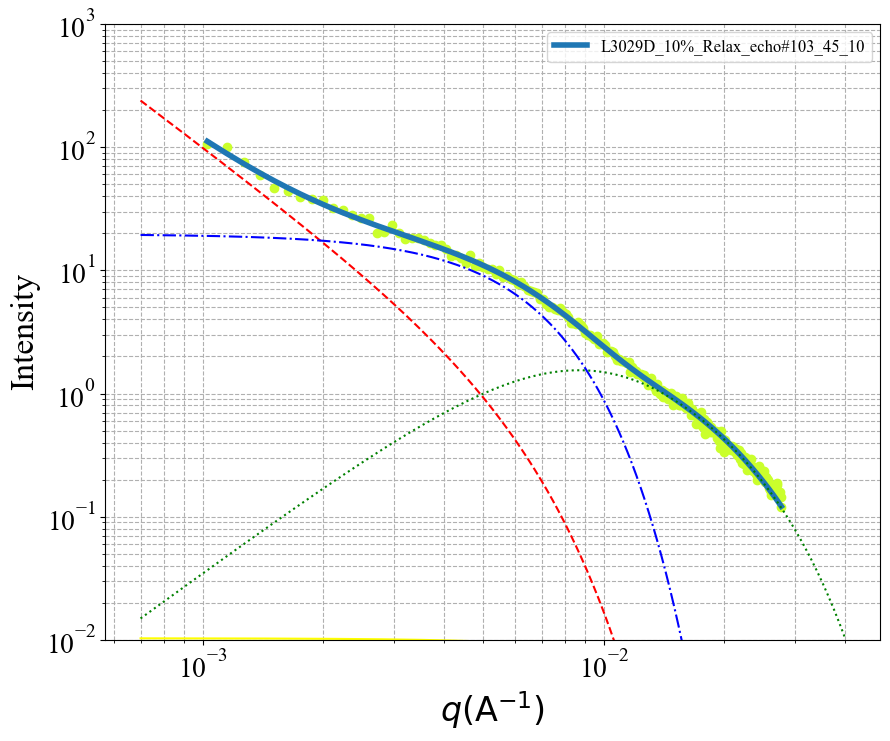


 Chi-square (func_1 with fixed params): 10.619894803162087
Sample: L3029D_10%_Relax_echo#104_45_10 - Parameter 1: 1.9371e-06
Sample: L3029D_10%_Relax_echo#104_45_10 - Parameter 2: 2.5487e+00
Sample: L3029D_10%_Relax_echo#104_45_10 - Parameter 3: 5.9989e+02
Sample: L3029D_10%_Relax_echo#104_45_10 - Parameter 4: 4.1357e+01
Sample: L3029D_10%_Relax_echo#104_45_10 - Parameter 5: 1.6153e-05
Sample: L3029D_10%_Relax_echo#104_45_10 - Parameter 6: 2.6242e+00
Sample: L3029D_10%_Relax_echo#104_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#104_45_10 - Parameter 8: 3.2079e-01
Sample: L3029D_10%_Relax_echo#104_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#104_45_10 - Parameter 10: 1.0000e-08

Dm: 2.5487 ± 0.1471
Rss: 599.8908 ± 53.0146



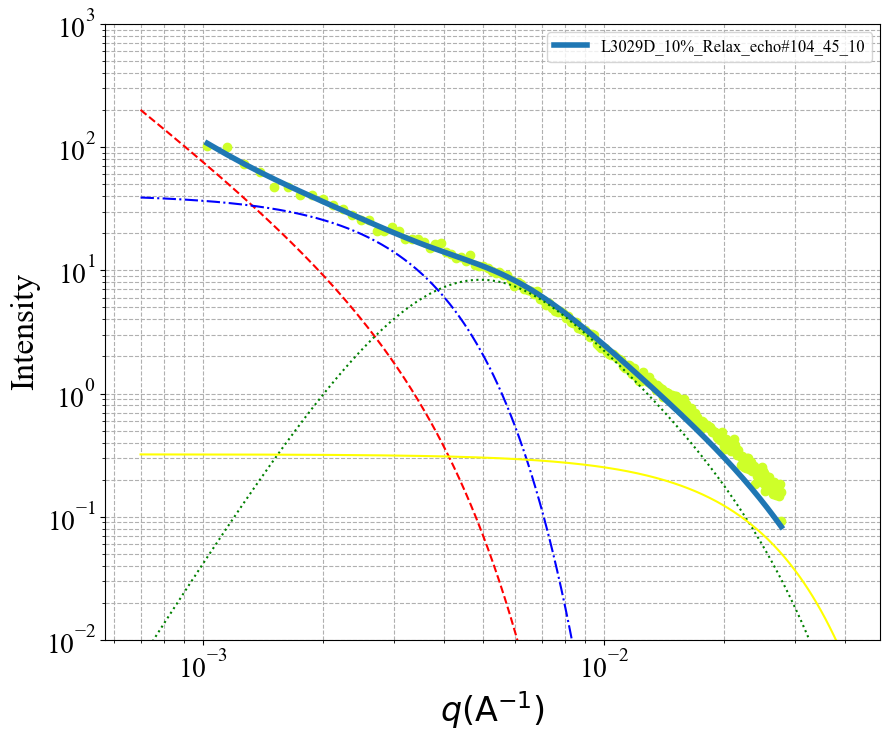


 Chi-square (func_1 with fixed params): 6.265918456626924
Sample: L3029D_10%_Relax_echo#105_45_10 - Parameter 1: 1.9598e-06
Sample: L3029D_10%_Relax_echo#105_45_10 - Parameter 2: 2.5787e+00
Sample: L3029D_10%_Relax_echo#105_45_10 - Parameter 3: 3.0948e+02
Sample: L3029D_10%_Relax_echo#105_45_10 - Parameter 4: 2.0301e+01
Sample: L3029D_10%_Relax_echo#105_45_10 - Parameter 5: 3.4725e-05
Sample: L3029D_10%_Relax_echo#105_45_10 - Parameter 6: 2.4099e+00
Sample: L3029D_10%_Relax_echo#105_45_10 - Parameter 7: 8.4977e+01
Sample: L3029D_10%_Relax_echo#105_45_10 - Parameter 8: 6.8317e-01
Sample: L3029D_10%_Relax_echo#105_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#105_45_10 - Parameter 10: 1.4745e-35

Dm: 2.5787 ± 0.1045
Rss: 309.4826 ± 19.2078



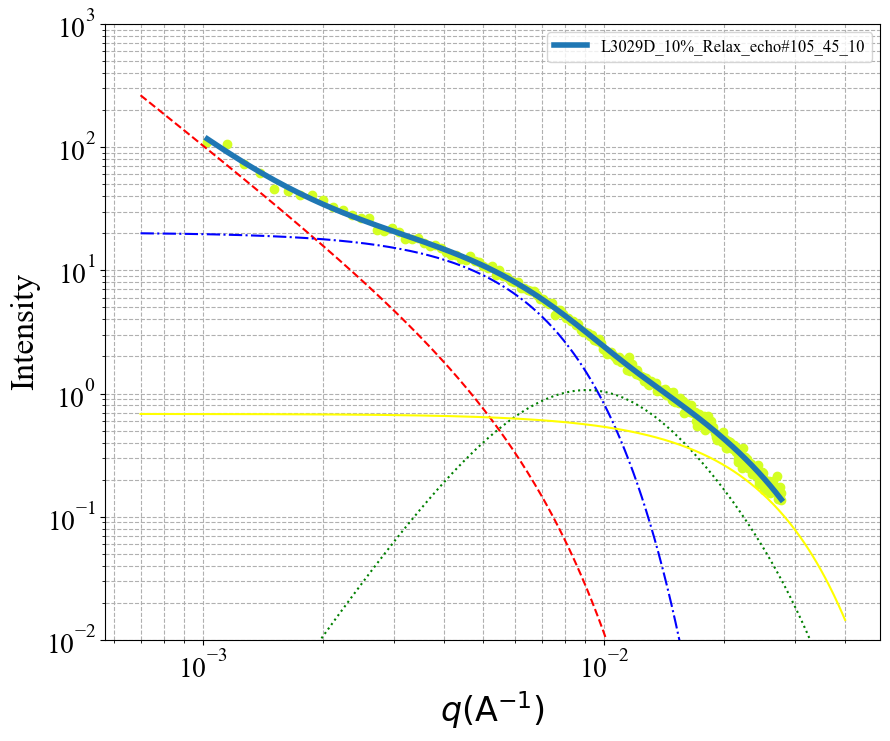


 Chi-square (func_1 with fixed params): 5.76642951194891
Sample: L3029D_10%_Relax_echo#106_45_10 - Parameter 1: 8.1367e-06
Sample: L3029D_10%_Relax_echo#106_45_10 - Parameter 2: 2.3660e+00
Sample: L3029D_10%_Relax_echo#106_45_10 - Parameter 3: 3.1045e+02
Sample: L3029D_10%_Relax_echo#106_45_10 - Parameter 4: 1.9764e+01
Sample: L3029D_10%_Relax_echo#106_45_10 - Parameter 5: 7.7051e-03
Sample: L3029D_10%_Relax_echo#106_45_10 - Parameter 6: 1.2707e+00
Sample: L3029D_10%_Relax_echo#106_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#106_45_10 - Parameter 8: 6.5353e-03
Sample: L3029D_10%_Relax_echo#106_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#106_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3660 ± 0.0965
Rss: 310.4517 ± 19.0343



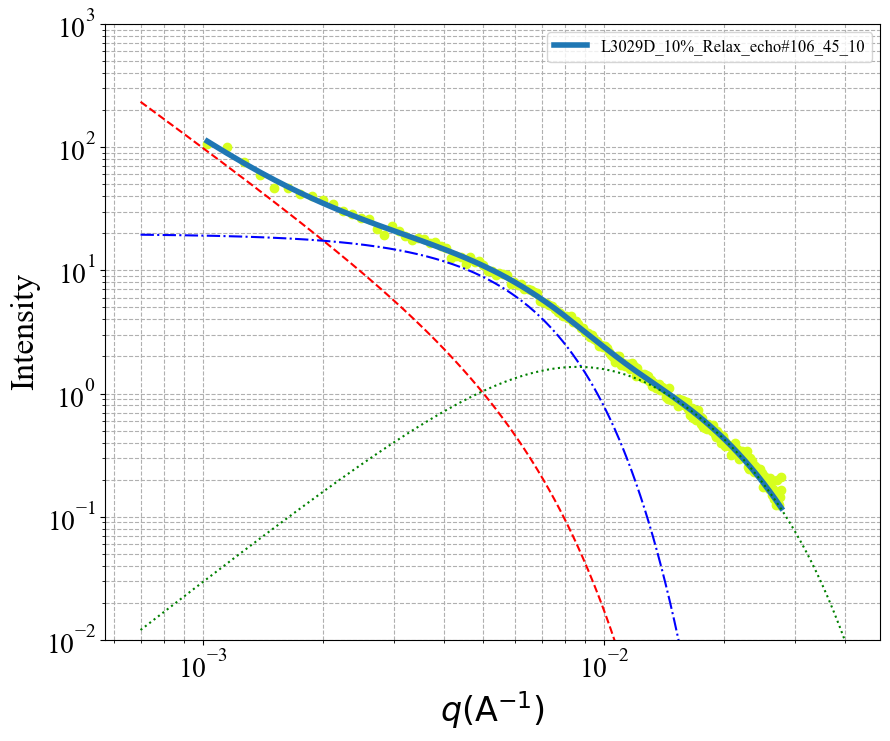


 Chi-square (func_1 with fixed params): 5.569897529480308
Sample: L3029D_10%_Relax_echo#107_45_10 - Parameter 1: 3.8114e-05
Sample: L3029D_10%_Relax_echo#107_45_10 - Parameter 2: 2.1435e+00
Sample: L3029D_10%_Relax_echo#107_45_10 - Parameter 3: 2.8437e+02
Sample: L3029D_10%_Relax_echo#107_45_10 - Parameter 4: 1.6042e+01
Sample: L3029D_10%_Relax_echo#107_45_10 - Parameter 5: 6.0448e-02
Sample: L3029D_10%_Relax_echo#107_45_10 - Parameter 6: 7.6504e-01
Sample: L3029D_10%_Relax_echo#107_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#107_45_10 - Parameter 8: 2.7396e-03
Sample: L3029D_10%_Relax_echo#107_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#107_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1435 ± 0.0867
Rss: 284.3741 ± 21.2449



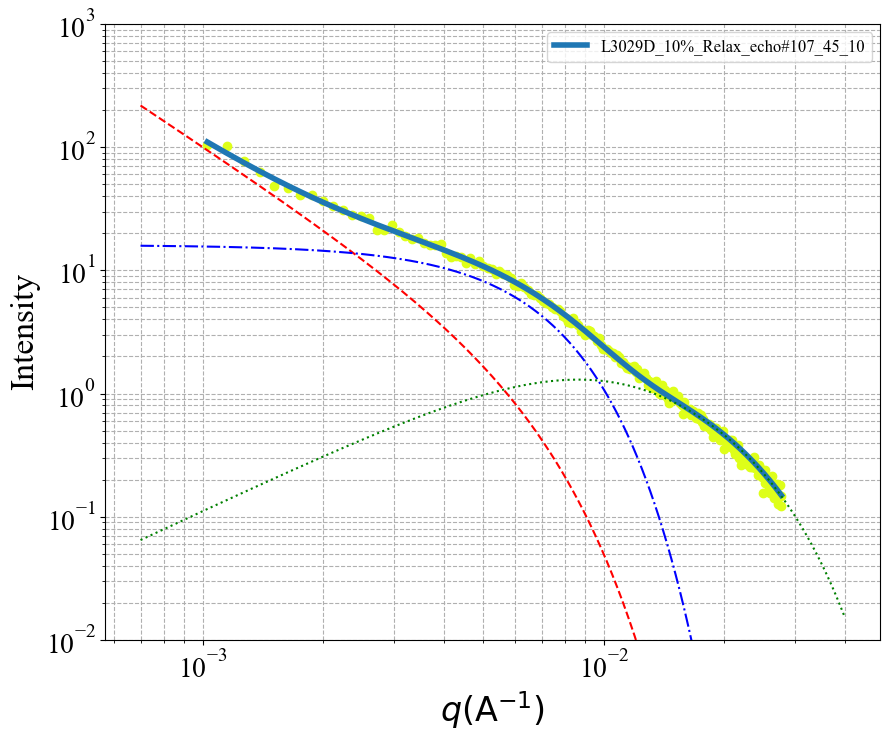


 Chi-square (func_1 with fixed params): 6.578993321127827
Sample: L3029D_10%_Relax_echo#108_45_10 - Parameter 1: 1.8981e-05
Sample: L3029D_10%_Relax_echo#108_45_10 - Parameter 2: 2.2408e+00
Sample: L3029D_10%_Relax_echo#108_45_10 - Parameter 3: 2.9519e+02
Sample: L3029D_10%_Relax_echo#108_45_10 - Parameter 4: 1.7692e+01
Sample: L3029D_10%_Relax_echo#108_45_10 - Parameter 5: 1.8753e-02
Sample: L3029D_10%_Relax_echo#108_45_10 - Parameter 6: 1.0459e+00
Sample: L3029D_10%_Relax_echo#108_45_10 - Parameter 7: 8.3563e+01
Sample: L3029D_10%_Relax_echo#108_45_10 - Parameter 8: 5.9234e-03
Sample: L3029D_10%_Relax_echo#108_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#108_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2408 ± 0.1062
Rss: 295.1870 ± 22.1185



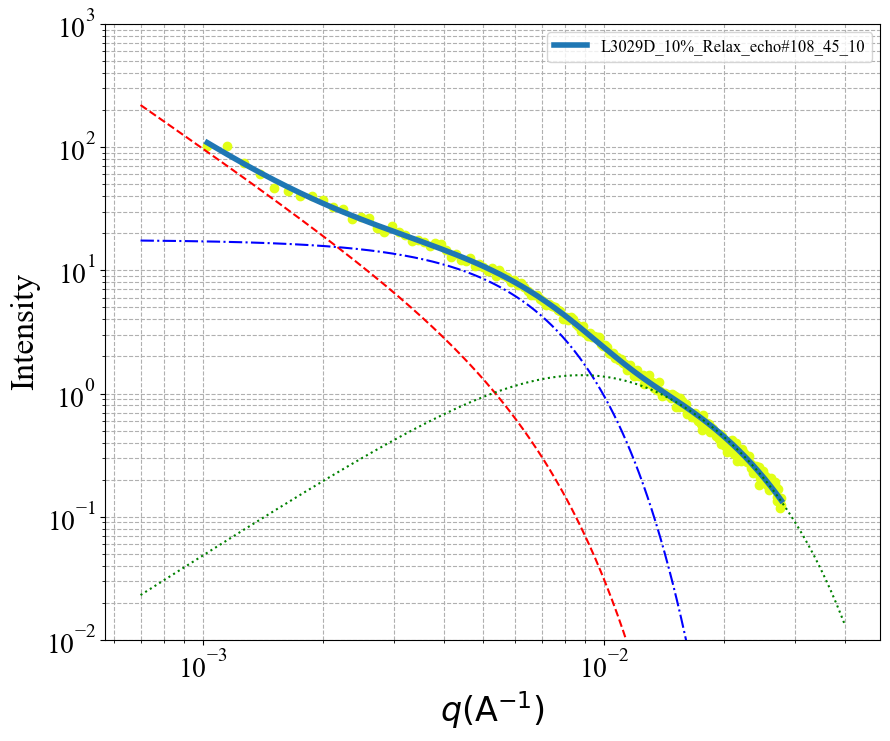


 Chi-square (func_1 with fixed params): 6.59960993528464
Sample: L3029D_10%_Relax_echo#109_45_10 - Parameter 1: 1.0604e-05
Sample: L3029D_10%_Relax_echo#109_45_10 - Parameter 2: 2.3253e+00
Sample: L3029D_10%_Relax_echo#109_45_10 - Parameter 3: 3.0116e+02
Sample: L3029D_10%_Relax_echo#109_45_10 - Parameter 4: 1.8926e+01
Sample: L3029D_10%_Relax_echo#109_45_10 - Parameter 5: 9.9523e-03
Sample: L3029D_10%_Relax_echo#109_45_10 - Parameter 6: 1.2025e+00
Sample: L3029D_10%_Relax_echo#109_45_10 - Parameter 7: 8.3902e+01
Sample: L3029D_10%_Relax_echo#109_45_10 - Parameter 8: 8.1451e-03
Sample: L3029D_10%_Relax_echo#109_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#109_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3253 ± 0.1089
Rss: 301.1608 ± 21.1754



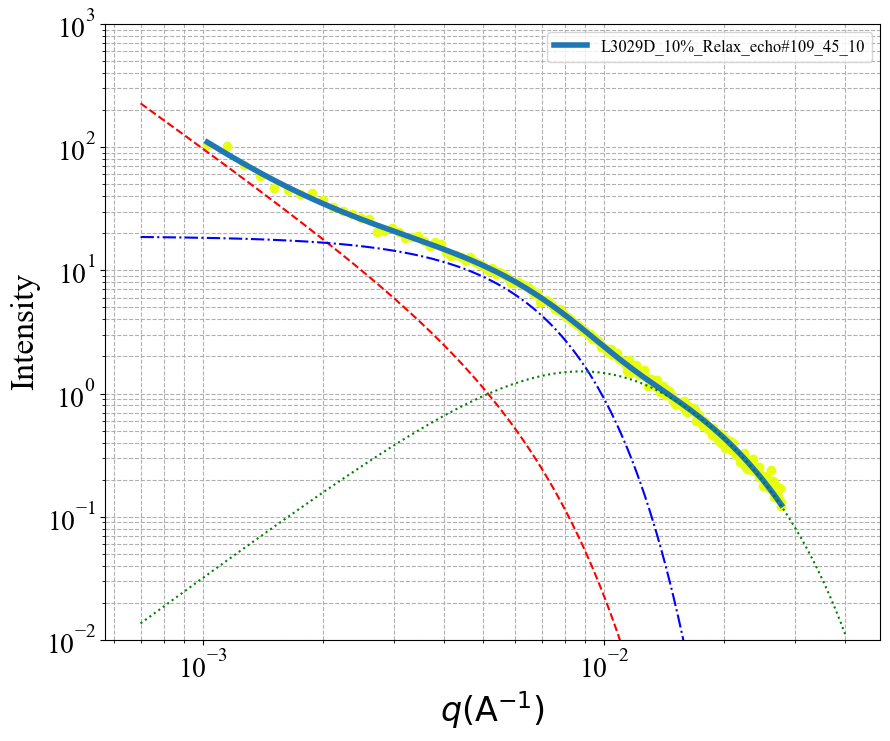


 Chi-square (func_1 with fixed params): 4.469735904738382
Sample: L3029D_10%_Relax_echo#110_45_10 - Parameter 1: 1.9567e-05
Sample: L3029D_10%_Relax_echo#110_45_10 - Parameter 2: 2.2420e+00
Sample: L3029D_10%_Relax_echo#110_45_10 - Parameter 3: 2.8626e+02
Sample: L3029D_10%_Relax_echo#110_45_10 - Parameter 4: 1.6601e+01
Sample: L3029D_10%_Relax_echo#110_45_10 - Parameter 5: 3.2268e-02
Sample: L3029D_10%_Relax_echo#110_45_10 - Parameter 6: 9.1272e-01
Sample: L3029D_10%_Relax_echo#110_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#110_45_10 - Parameter 8: 2.8430e-02
Sample: L3029D_10%_Relax_echo#110_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#110_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2420 ± 0.0764
Rss: 286.2559 ± 17.2547



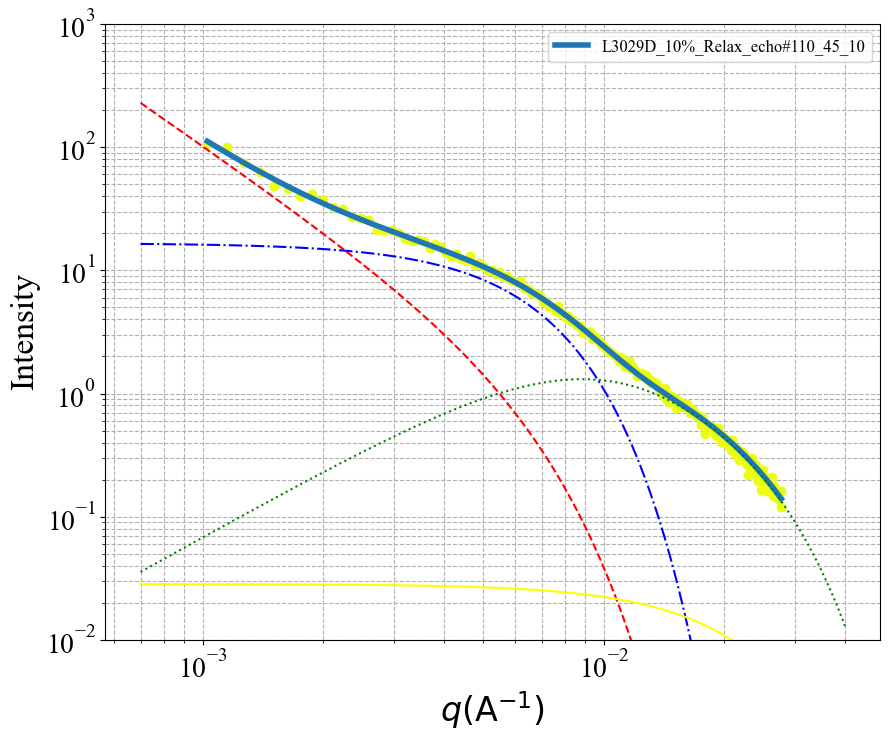


 Chi-square (func_1 with fixed params): 4.373837778288205
Sample: L3029D_10%_Relax_echo#111_45_10 - Parameter 1: 1.3205e-05
Sample: L3029D_10%_Relax_echo#111_45_10 - Parameter 2: 2.2923e+00
Sample: L3029D_10%_Relax_echo#111_45_10 - Parameter 3: 3.0494e+02
Sample: L3029D_10%_Relax_echo#111_45_10 - Parameter 4: 1.8992e+01
Sample: L3029D_10%_Relax_echo#111_45_10 - Parameter 5: 5.8193e-03
Sample: L3029D_10%_Relax_echo#111_45_10 - Parameter 6: 1.3341e+00
Sample: L3029D_10%_Relax_echo#111_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#111_45_10 - Parameter 8: 1.1109e-04
Sample: L3029D_10%_Relax_echo#111_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#111_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2923 ± 0.0802
Rss: 304.9399 ± 16.2134



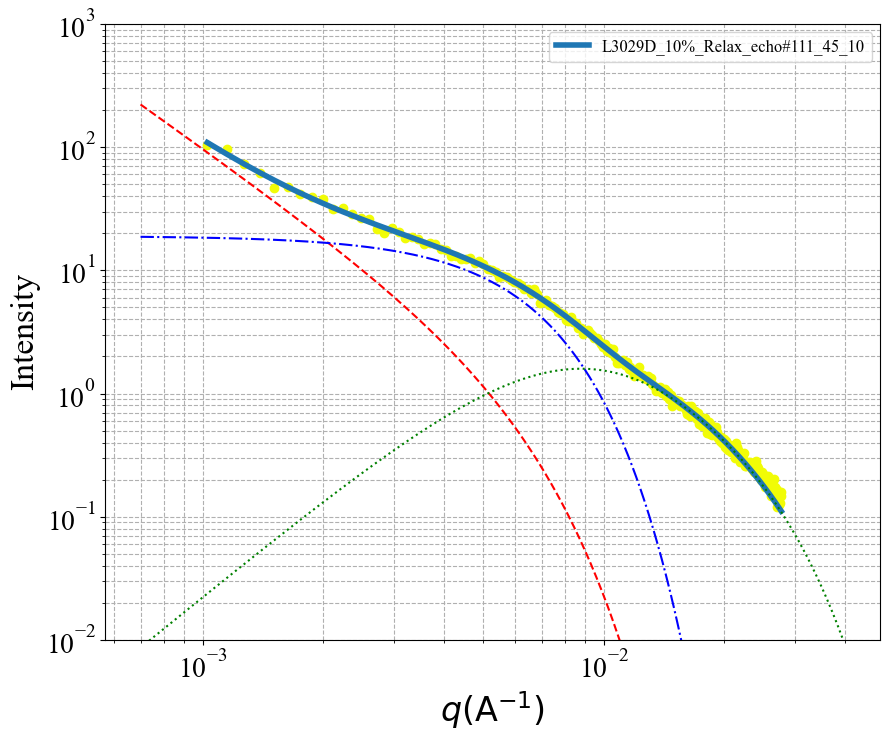


 Chi-square (func_1 with fixed params): 5.672893078418531
Sample: L3029D_10%_Relax_echo#112_45_10 - Parameter 1: 7.7044e-06
Sample: L3029D_10%_Relax_echo#112_45_10 - Parameter 2: 2.3704e+00
Sample: L3029D_10%_Relax_echo#112_45_10 - Parameter 3: 3.0170e+02
Sample: L3029D_10%_Relax_echo#112_45_10 - Parameter 4: 1.9295e+01
Sample: L3029D_10%_Relax_echo#112_45_10 - Parameter 5: 1.1072e-04
Sample: L3029D_10%_Relax_echo#112_45_10 - Parameter 6: 2.1561e+00
Sample: L3029D_10%_Relax_echo#112_45_10 - Parameter 7: 8.0386e+01
Sample: L3029D_10%_Relax_echo#112_45_10 - Parameter 8: 5.0165e-01
Sample: L3029D_10%_Relax_echo#112_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#112_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3704 ± 0.1038
Rss: 301.6980 ± 19.0582



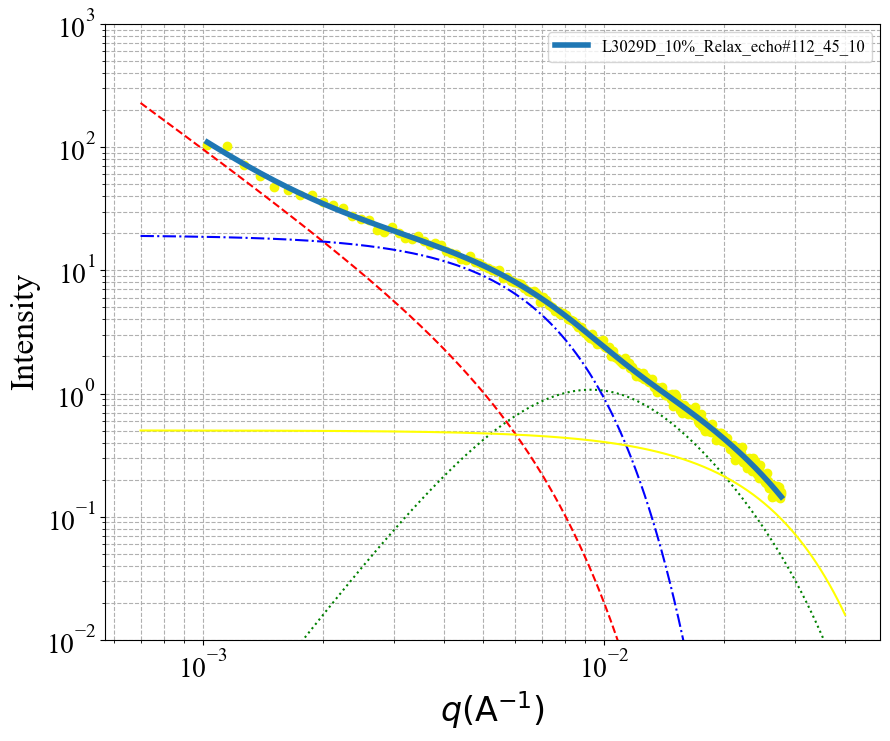


 Chi-square (func_1 with fixed params): 6.639845482953396
Sample: L3029D_10%_Relax_echo#113_45_10 - Parameter 1: 3.5285e-05
Sample: L3029D_10%_Relax_echo#113_45_10 - Parameter 2: 2.1525e+00
Sample: L3029D_10%_Relax_echo#113_45_10 - Parameter 3: 2.7875e+02
Sample: L3029D_10%_Relax_echo#113_45_10 - Parameter 4: 1.5553e+01
Sample: L3029D_10%_Relax_echo#113_45_10 - Parameter 5: 8.8535e-02
Sample: L3029D_10%_Relax_echo#113_45_10 - Parameter 6: 6.6139e-01
Sample: L3029D_10%_Relax_echo#113_45_10 - Parameter 7: 8.3431e+01
Sample: L3029D_10%_Relax_echo#113_45_10 - Parameter 8: 5.2236e-03
Sample: L3029D_10%_Relax_echo#113_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#113_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1525 ± 0.0902
Rss: 278.7511 ± 22.5836



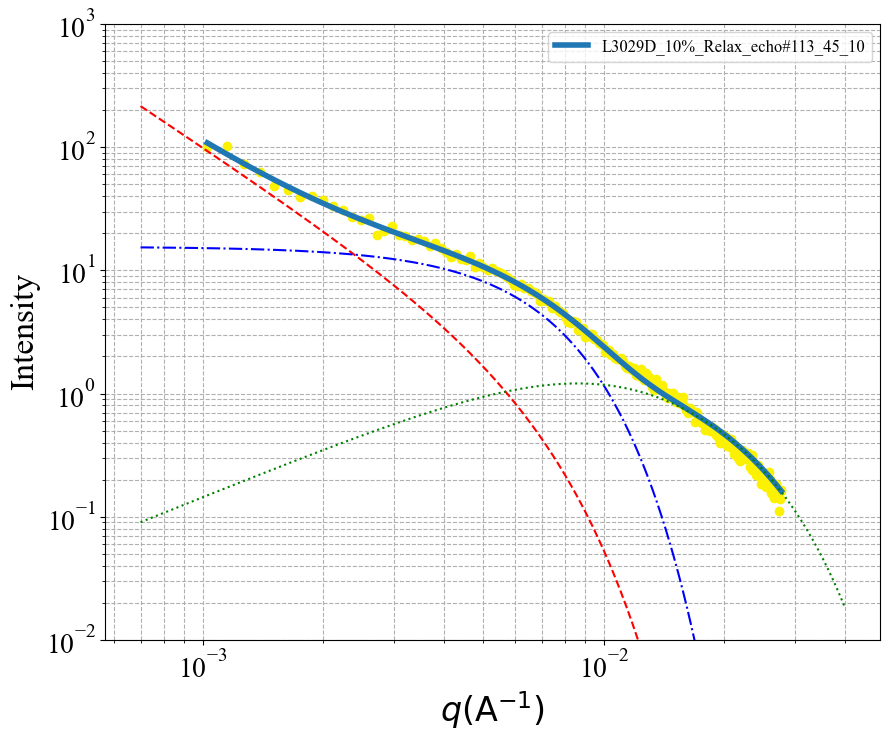


 Chi-square (func_1 with fixed params): 5.5338718003108704
Sample: L3029D_10%_Relax_echo#114_45_10 - Parameter 1: 1.2028e-05
Sample: L3029D_10%_Relax_echo#114_45_10 - Parameter 2: 2.3066e+00
Sample: L3029D_10%_Relax_echo#114_45_10 - Parameter 3: 3.0126e+02
Sample: L3029D_10%_Relax_echo#114_45_10 - Parameter 4: 1.8844e+01
Sample: L3029D_10%_Relax_echo#114_45_10 - Parameter 5: 7.4156e-03
Sample: L3029D_10%_Relax_echo#114_45_10 - Parameter 6: 1.2618e+00
Sample: L3029D_10%_Relax_echo#114_45_10 - Parameter 7: 8.1364e+01
Sample: L3029D_10%_Relax_echo#114_45_10 - Parameter 8: 8.7845e-03
Sample: L3029D_10%_Relax_echo#114_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#114_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3066 ± 0.0945
Rss: 301.2570 ± 18.4165



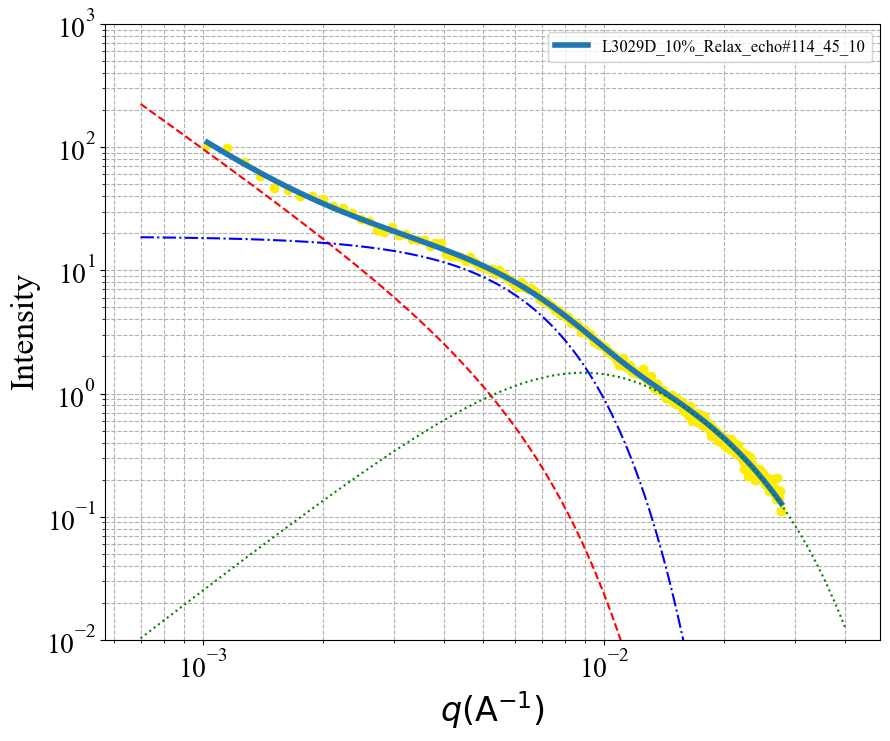


 Chi-square (func_1 with fixed params): 5.171488687273073
Sample: L3029D_10%_Relax_echo#115_45_10 - Parameter 1: 1.2635e-05
Sample: L3029D_10%_Relax_echo#115_45_10 - Parameter 2: 2.3041e+00
Sample: L3029D_10%_Relax_echo#115_45_10 - Parameter 3: 2.9339e+02
Sample: L3029D_10%_Relax_echo#115_45_10 - Parameter 4: 1.7737e+01
Sample: L3029D_10%_Relax_echo#115_45_10 - Parameter 5: 4.0560e-02
Sample: L3029D_10%_Relax_echo#115_45_10 - Parameter 6: 8.6273e-01
Sample: L3029D_10%_Relax_echo#115_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#115_45_10 - Parameter 8: 4.4342e-03
Sample: L3029D_10%_Relax_echo#115_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#115_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3041 ± 0.0896
Rss: 293.3888 ± 18.9955



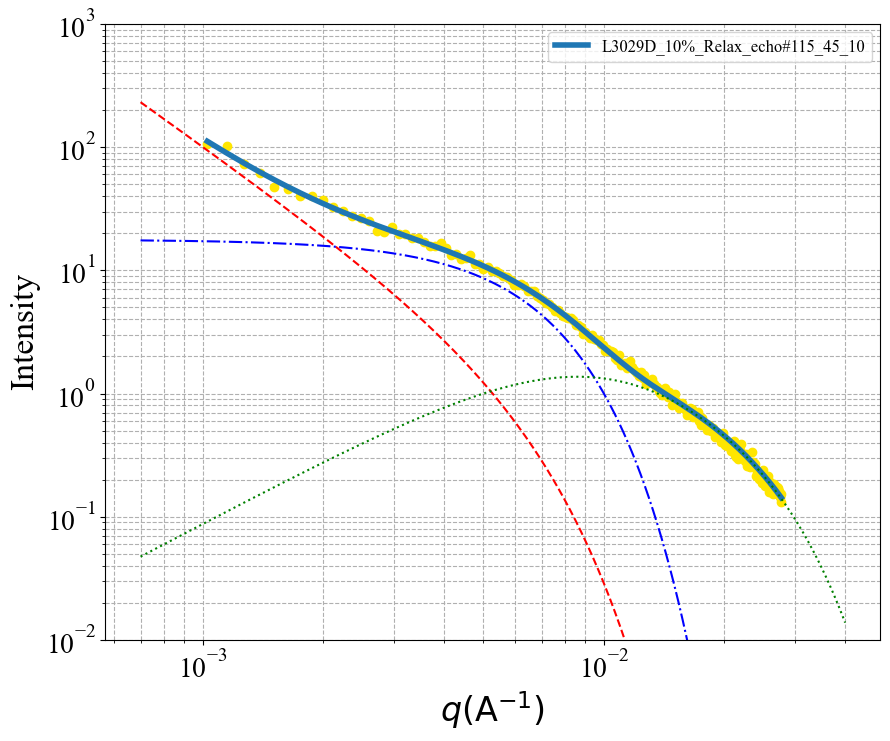


 Chi-square (func_1 with fixed params): 6.289426983836578
Sample: L3029D_10%_Relax_echo#116_45_10 - Parameter 1: 1.4141e-05
Sample: L3029D_10%_Relax_echo#116_45_10 - Parameter 2: 2.2869e+00
Sample: L3029D_10%_Relax_echo#116_45_10 - Parameter 3: 2.9745e+02
Sample: L3029D_10%_Relax_echo#116_45_10 - Parameter 4: 1.8081e+01
Sample: L3029D_10%_Relax_echo#116_45_10 - Parameter 5: 3.2004e-02
Sample: L3029D_10%_Relax_echo#116_45_10 - Parameter 6: 9.2384e-01
Sample: L3029D_10%_Relax_echo#116_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#116_45_10 - Parameter 8: 6.5358e-03
Sample: L3029D_10%_Relax_echo#116_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#116_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2869 ± 0.0968
Rss: 297.4548 ± 20.3191



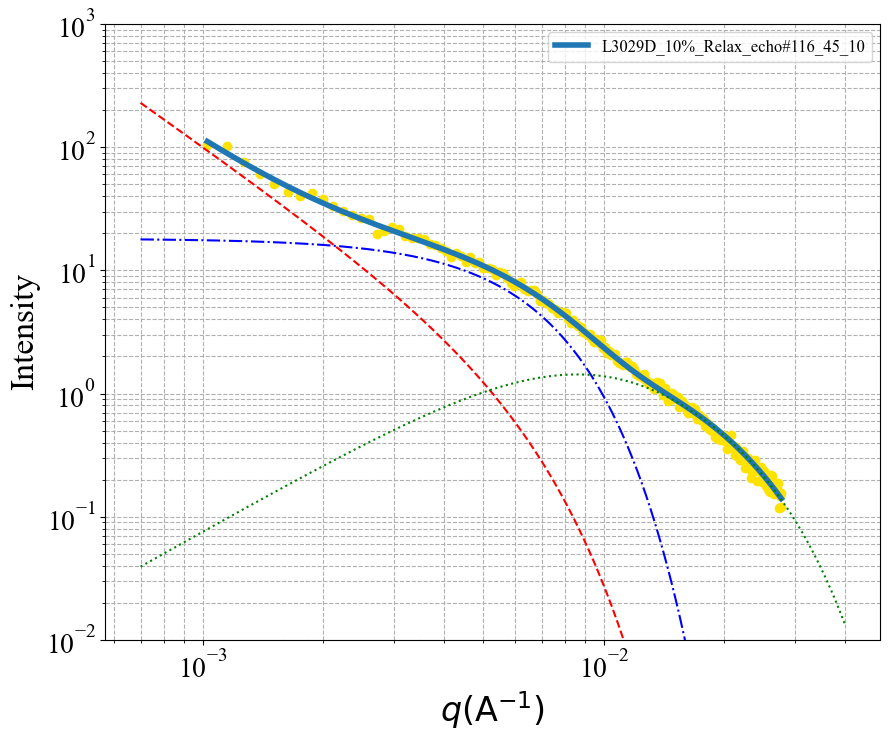


 Chi-square (func_1 with fixed params): 4.559643193932347
Sample: L3029D_10%_Relax_echo#117_45_10 - Parameter 1: 2.9074e-05
Sample: L3029D_10%_Relax_echo#117_45_10 - Parameter 2: 2.1810e+00
Sample: L3029D_10%_Relax_echo#117_45_10 - Parameter 3: 2.8921e+02
Sample: L3029D_10%_Relax_echo#117_45_10 - Parameter 4: 1.6779e+01
Sample: L3029D_10%_Relax_echo#117_45_10 - Parameter 5: 2.4314e-02
Sample: L3029D_10%_Relax_echo#117_45_10 - Parameter 6: 9.8573e-01
Sample: L3029D_10%_Relax_echo#117_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#117_45_10 - Parameter 8: 1.1098e-02
Sample: L3029D_10%_Relax_echo#117_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#117_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1810 ± 0.0772
Rss: 289.2054 ± 17.2738



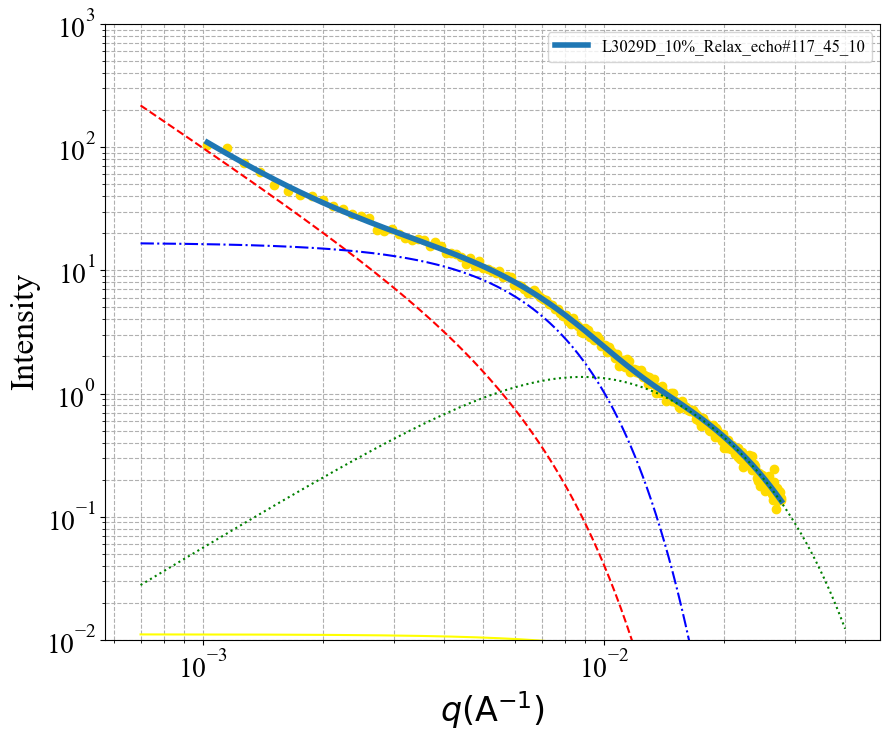


 Chi-square (func_1 with fixed params): 3.929447344801033
Sample: L3029D_10%_Relax_echo#118_45_10 - Parameter 1: 1.0715e-05
Sample: L3029D_10%_Relax_echo#118_45_10 - Parameter 2: 2.3253e+00
Sample: L3029D_10%_Relax_echo#118_45_10 - Parameter 3: 3.0528e+02
Sample: L3029D_10%_Relax_echo#118_45_10 - Parameter 4: 1.9149e+01
Sample: L3029D_10%_Relax_echo#118_45_10 - Parameter 5: 8.8552e-03
Sample: L3029D_10%_Relax_echo#118_45_10 - Parameter 6: 1.2331e+00
Sample: L3029D_10%_Relax_echo#118_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#118_45_10 - Parameter 8: 5.1448e-03
Sample: L3029D_10%_Relax_echo#118_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#118_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3253 ± 0.0765
Rss: 305.2811 ± 15.2521



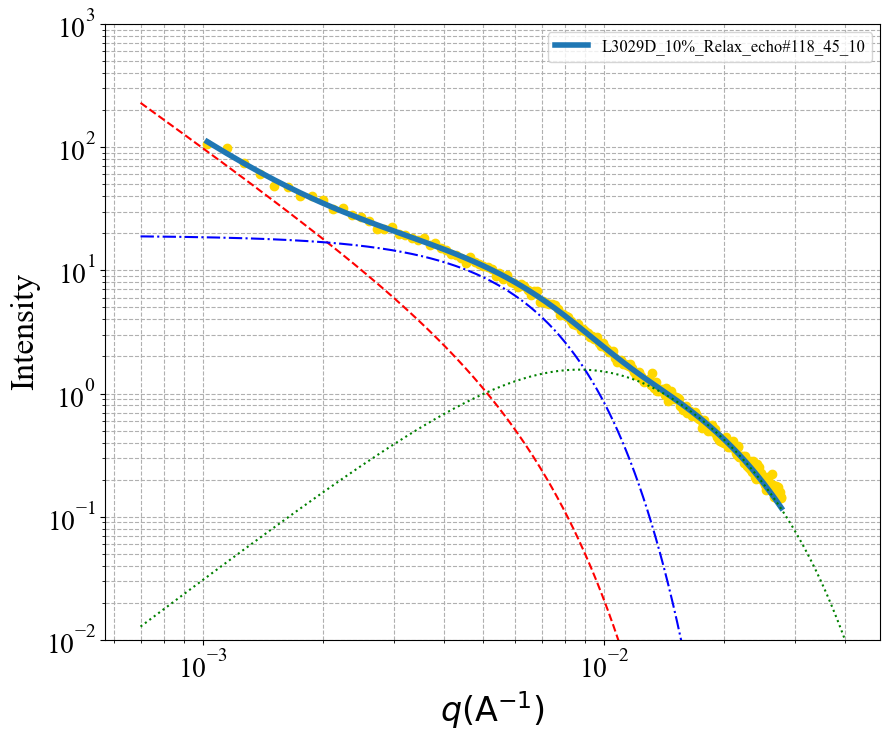


 Chi-square (func_1 with fixed params): 4.754429329179296
Sample: L3029D_10%_Relax_echo#119_45_10 - Parameter 1: 2.9999e-05
Sample: L3029D_10%_Relax_echo#119_45_10 - Parameter 2: 2.1708e+00
Sample: L3029D_10%_Relax_echo#119_45_10 - Parameter 3: 2.8453e+02
Sample: L3029D_10%_Relax_echo#119_45_10 - Parameter 4: 1.6713e+01
Sample: L3029D_10%_Relax_echo#119_45_10 - Parameter 5: 4.8196e-04
Sample: L3029D_10%_Relax_echo#119_45_10 - Parameter 6: 1.7724e+00
Sample: L3029D_10%_Relax_echo#119_45_10 - Parameter 7: 7.9211e+01
Sample: L3029D_10%_Relax_echo#119_45_10 - Parameter 8: 5.5552e-01
Sample: L3029D_10%_Relax_echo#119_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#119_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1708 ± 0.0686
Rss: 284.5252 ± 13.0948



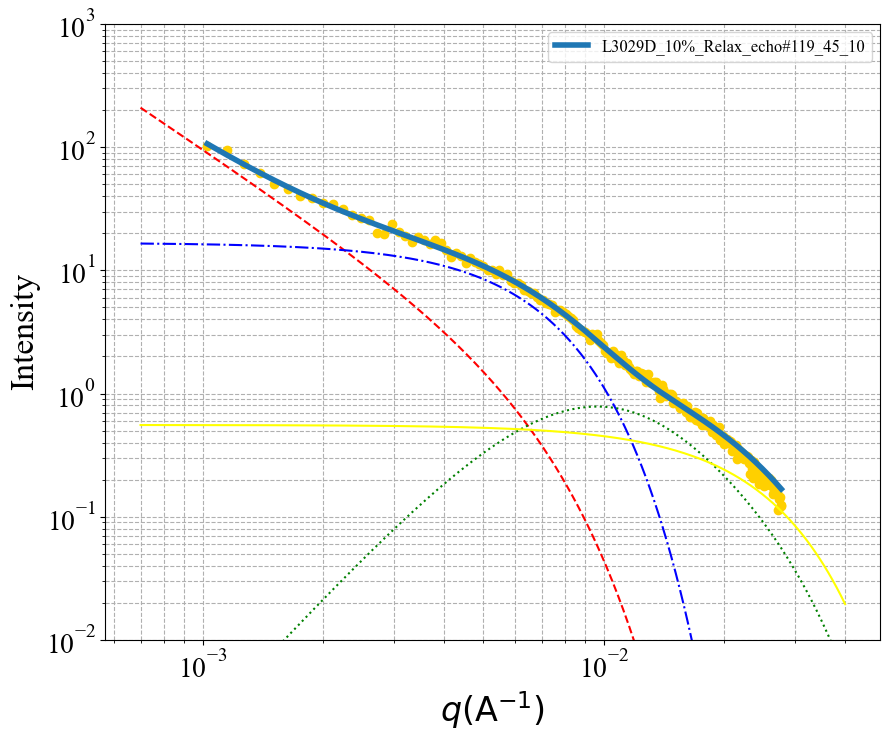


 Chi-square (func_1 with fixed params): 4.035950680166944
Sample: L3029D_10%_Relax_echo#120_45_10 - Parameter 1: 1.0812e-05
Sample: L3029D_10%_Relax_echo#120_45_10 - Parameter 2: 2.3244e+00
Sample: L3029D_10%_Relax_echo#120_45_10 - Parameter 3: 3.0398e+02
Sample: L3029D_10%_Relax_echo#120_45_10 - Parameter 4: 1.9002e+01
Sample: L3029D_10%_Relax_echo#120_45_10 - Parameter 5: 1.0250e-02
Sample: L3029D_10%_Relax_echo#120_45_10 - Parameter 6: 1.1973e+00
Sample: L3029D_10%_Relax_echo#120_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#120_45_10 - Parameter 8: 4.7763e-03
Sample: L3029D_10%_Relax_echo#120_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#120_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3244 ± 0.0692
Rss: 303.9800 ± 13.8191



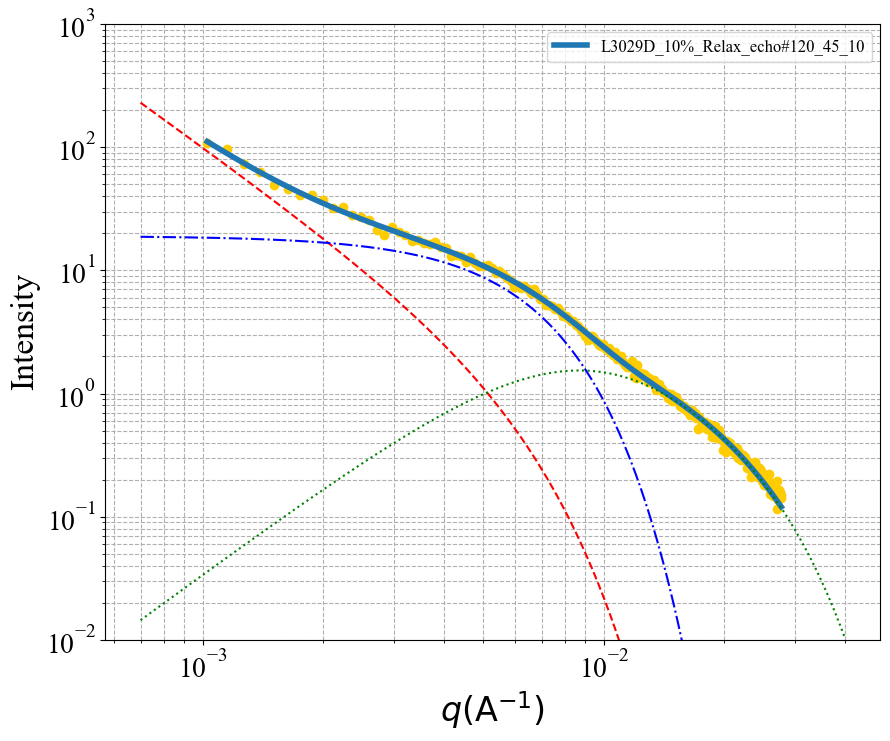


 Chi-square (func_1 with fixed params): 6.331720262974788
Sample: L3029D_10%_Relax_echo#121_45_10 - Parameter 1: 1.2923e-05
Sample: L3029D_10%_Relax_echo#121_45_10 - Parameter 2: 2.3009e+00
Sample: L3029D_10%_Relax_echo#121_45_10 - Parameter 3: 2.9522e+02
Sample: L3029D_10%_Relax_echo#121_45_10 - Parameter 4: 1.8013e+01
Sample: L3029D_10%_Relax_echo#121_45_10 - Parameter 5: 2.4791e-02
Sample: L3029D_10%_Relax_echo#121_45_10 - Parameter 6: 9.8294e-01
Sample: L3029D_10%_Relax_echo#121_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#121_45_10 - Parameter 8: 2.2391e-03
Sample: L3029D_10%_Relax_echo#121_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#121_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3009 ± 0.0980
Rss: 295.2207 ± 20.3539



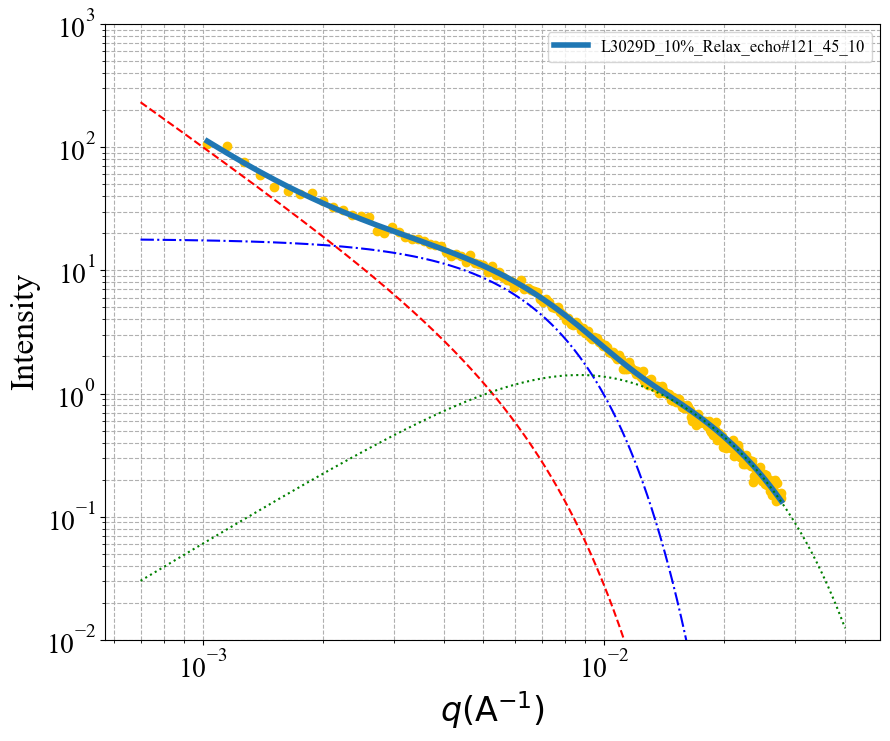


 Chi-square (func_1 with fixed params): 5.177532739000221
Sample: L3029D_10%_Relax_echo#122_45_10 - Parameter 1: 9.0780e-06
Sample: L3029D_10%_Relax_echo#122_45_10 - Parameter 2: 2.3510e+00
Sample: L3029D_10%_Relax_echo#122_45_10 - Parameter 3: 3.0522e+02
Sample: L3029D_10%_Relax_echo#122_45_10 - Parameter 4: 1.9205e+01
Sample: L3029D_10%_Relax_echo#122_45_10 - Parameter 5: 8.2442e-03
Sample: L3029D_10%_Relax_echo#122_45_10 - Parameter 6: 1.2499e+00
Sample: L3029D_10%_Relax_echo#122_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#122_45_10 - Parameter 8: 1.2117e-02
Sample: L3029D_10%_Relax_echo#122_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#122_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3510 ± 0.0902
Rss: 305.2240 ± 18.0124



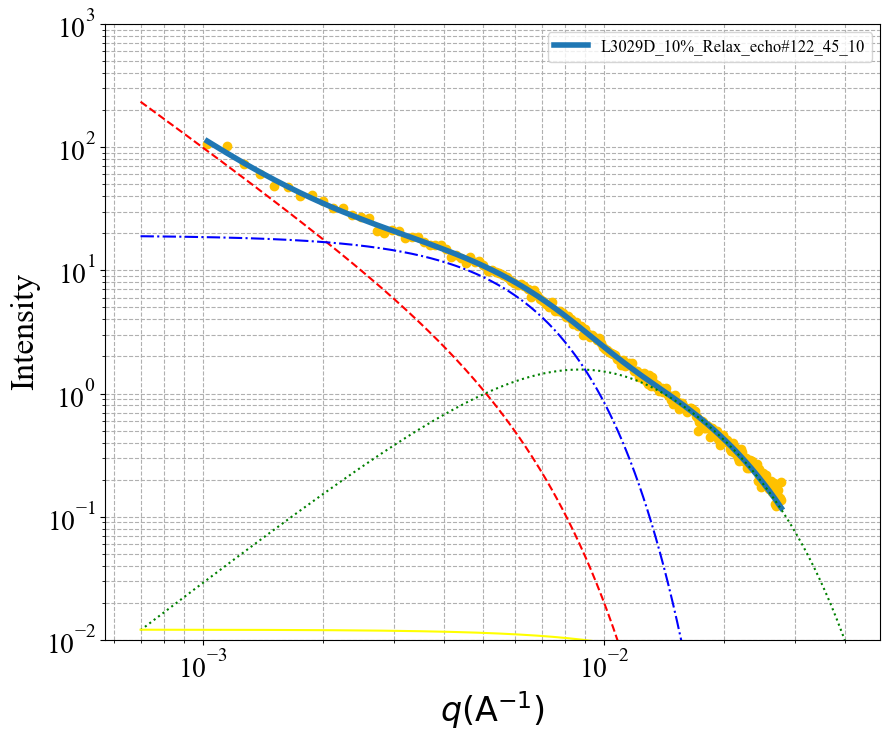


 Chi-square (func_1 with fixed params): 6.8112437208493635
Sample: L3029D_10%_Relax_echo#123_45_10 - Parameter 1: 1.0746e-05
Sample: L3029D_10%_Relax_echo#123_45_10 - Parameter 2: 2.3247e+00
Sample: L3029D_10%_Relax_echo#123_45_10 - Parameter 3: 2.9204e+02
Sample: L3029D_10%_Relax_echo#123_45_10 - Parameter 4: 1.7775e+01
Sample: L3029D_10%_Relax_echo#123_45_10 - Parameter 5: 6.0789e-03
Sample: L3029D_10%_Relax_echo#123_45_10 - Parameter 6: 1.2135e+00
Sample: L3029D_10%_Relax_echo#123_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#123_45_10 - Parameter 8: 5.1083e-01
Sample: L3029D_10%_Relax_echo#123_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#123_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3247 ± 0.1061
Rss: 292.0395 ± 19.4919



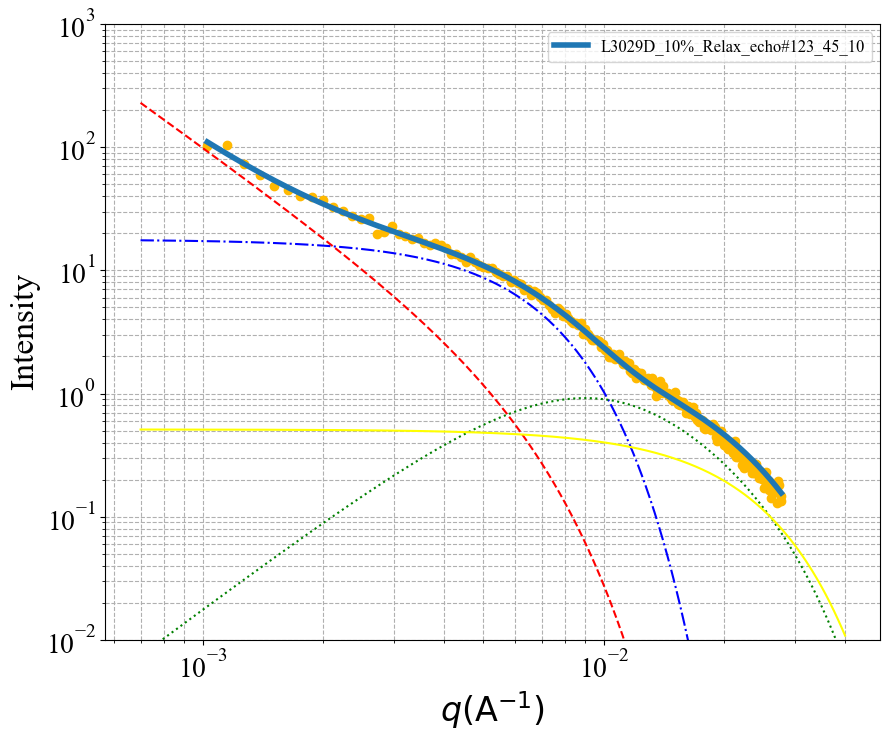


 Chi-square (func_1 with fixed params): 6.47669158836576
Sample: L3029D_10%_Relax_echo#124_45_10 - Parameter 1: 3.2853e-05
Sample: L3029D_10%_Relax_echo#124_45_10 - Parameter 2: 2.1601e+00
Sample: L3029D_10%_Relax_echo#124_45_10 - Parameter 3: 2.7664e+02
Sample: L3029D_10%_Relax_echo#124_45_10 - Parameter 4: 1.5892e+01
Sample: L3029D_10%_Relax_echo#124_45_10 - Parameter 5: 2.7780e-03
Sample: L3029D_10%_Relax_echo#124_45_10 - Parameter 6: 1.3609e+00
Sample: L3029D_10%_Relax_echo#124_45_10 - Parameter 7: 7.8914e+01
Sample: L3029D_10%_Relax_echo#124_45_10 - Parameter 8: 5.0009e-01
Sample: L3029D_10%_Relax_echo#124_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#124_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1601 ± 0.0907
Rss: 276.6372 ± 17.5872



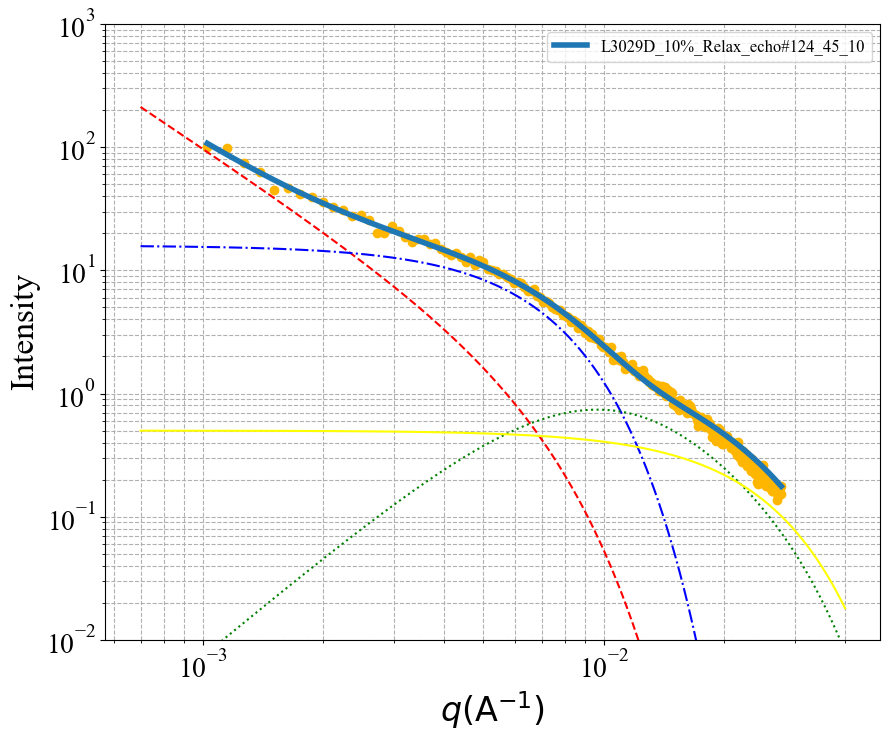


 Chi-square (func_1 with fixed params): 5.15643685587237
Sample: L3029D_10%_Relax_echo#125_45_10 - Parameter 1: 1.4474e-05
Sample: L3029D_10%_Relax_echo#125_45_10 - Parameter 2: 2.2820e+00
Sample: L3029D_10%_Relax_echo#125_45_10 - Parameter 3: 2.9655e+02
Sample: L3029D_10%_Relax_echo#125_45_10 - Parameter 4: 1.8118e+01
Sample: L3029D_10%_Relax_echo#125_45_10 - Parameter 5: 1.9346e-02
Sample: L3029D_10%_Relax_echo#125_45_10 - Parameter 6: 1.0422e+00
Sample: L3029D_10%_Relax_echo#125_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#125_45_10 - Parameter 8: 7.8936e-03
Sample: L3029D_10%_Relax_echo#125_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#125_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2820 ± 0.0926
Rss: 296.5464 ± 18.9356



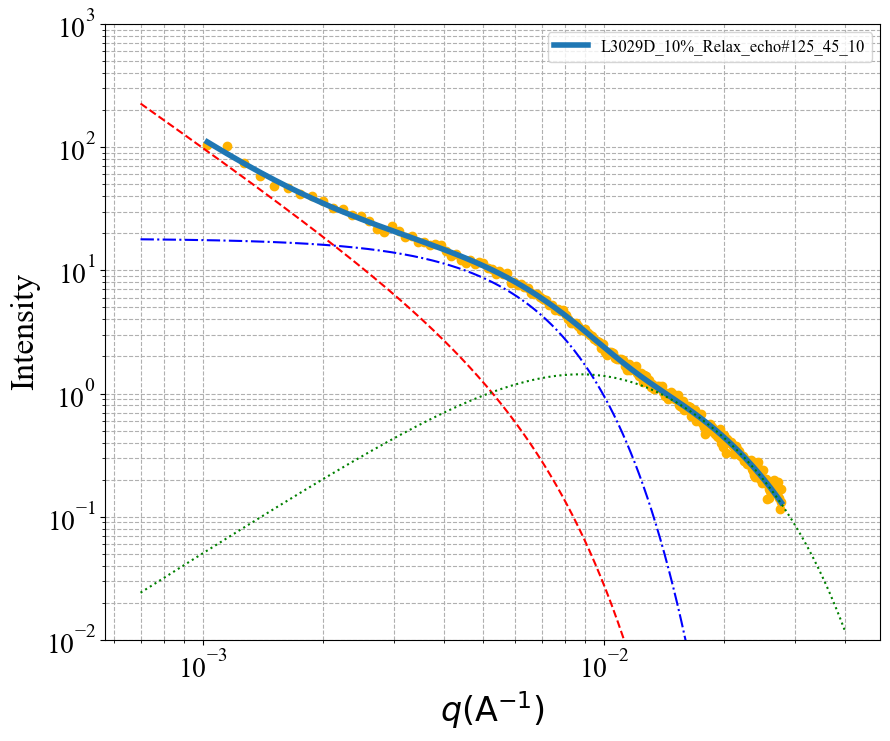


 Chi-square (func_1 with fixed params): 5.48422658179218
Sample: L3029D_10%_Relax_echo#126_45_10 - Parameter 1: 1.8032e-05
Sample: L3029D_10%_Relax_echo#126_45_10 - Parameter 2: 2.2477e+00
Sample: L3029D_10%_Relax_echo#126_45_10 - Parameter 3: 2.8579e+02
Sample: L3029D_10%_Relax_echo#126_45_10 - Parameter 4: 1.7128e+01
Sample: L3029D_10%_Relax_echo#126_45_10 - Parameter 5: 4.0796e-04
Sample: L3029D_10%_Relax_echo#126_45_10 - Parameter 6: 1.8308e+00
Sample: L3029D_10%_Relax_echo#126_45_10 - Parameter 7: 7.9497e+01
Sample: L3029D_10%_Relax_echo#126_45_10 - Parameter 8: 5.1095e-01
Sample: L3029D_10%_Relax_echo#126_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#126_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2477 ± 0.0907
Rss: 285.7912 ± 17.3410



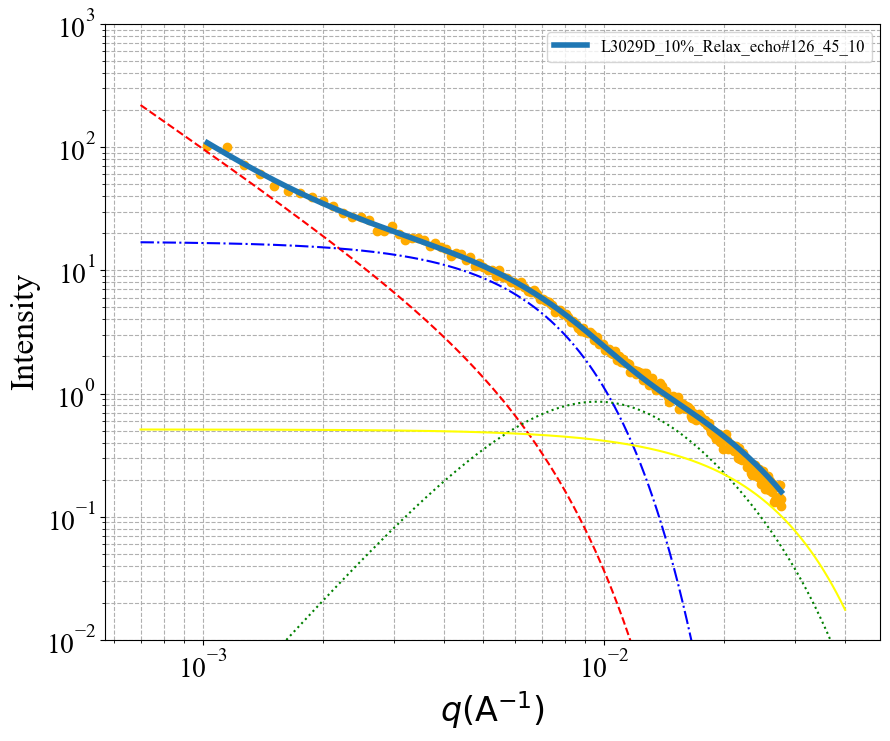


 Chi-square (func_1 with fixed params): 6.1244807969960835
Sample: L3029D_10%_Relax_echo#127_45_10 - Parameter 1: 2.5374e-05
Sample: L3029D_10%_Relax_echo#127_45_10 - Parameter 2: 2.2033e+00
Sample: L3029D_10%_Relax_echo#127_45_10 - Parameter 3: 2.8633e+02
Sample: L3029D_10%_Relax_echo#127_45_10 - Parameter 4: 1.6658e+01
Sample: L3029D_10%_Relax_echo#127_45_10 - Parameter 5: 5.1727e-02
Sample: L3029D_10%_Relax_echo#127_45_10 - Parameter 6: 8.0510e-01
Sample: L3029D_10%_Relax_echo#127_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#127_45_10 - Parameter 8: 2.6741e-04
Sample: L3029D_10%_Relax_echo#127_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#127_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2033 ± 0.0962
Rss: 286.3332 ± 22.2927



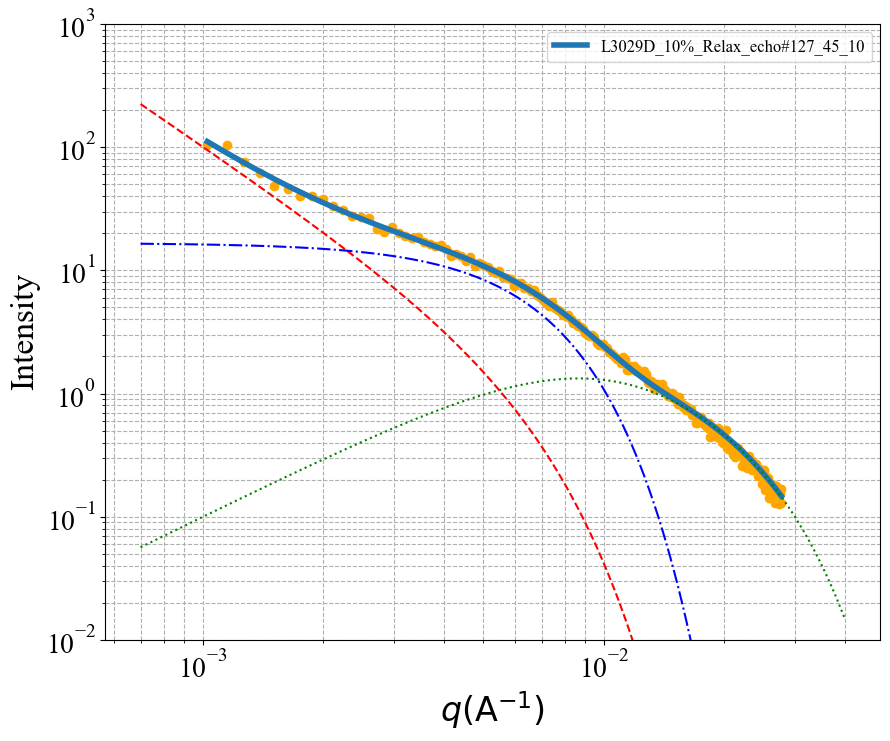


 Chi-square (func_1 with fixed params): 3.7724812071480716
Sample: L3029D_10%_Relax_echo#128_45_10 - Parameter 1: 4.9967e-06
Sample: L3029D_10%_Relax_echo#128_45_10 - Parameter 2: 2.4394e+00
Sample: L3029D_10%_Relax_echo#128_45_10 - Parameter 3: 3.1525e+02
Sample: L3029D_10%_Relax_echo#128_45_10 - Parameter 4: 2.0573e+01
Sample: L3029D_10%_Relax_echo#128_45_10 - Parameter 5: 6.5720e-03
Sample: L3029D_10%_Relax_echo#128_45_10 - Parameter 6: 1.3111e+00
Sample: L3029D_10%_Relax_echo#128_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#128_45_10 - Parameter 8: 6.1320e-03
Sample: L3029D_10%_Relax_echo#128_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#128_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4394 ± 0.0752
Rss: 315.2531 ± 14.5186



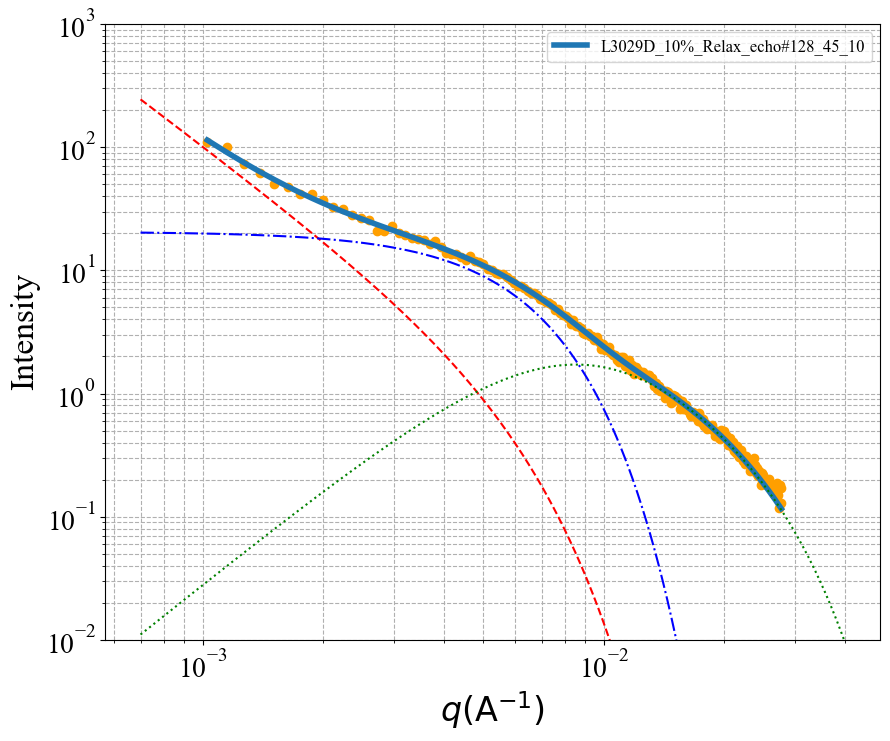


 Chi-square (func_1 with fixed params): 4.6818724039748005
Sample: L3029D_10%_Relax_echo#129_45_10 - Parameter 1: 2.6989e-05
Sample: L3029D_10%_Relax_echo#129_45_10 - Parameter 2: 2.1840e+00
Sample: L3029D_10%_Relax_echo#129_45_10 - Parameter 3: 2.8872e+02
Sample: L3029D_10%_Relax_echo#129_45_10 - Parameter 4: 1.7188e+01
Sample: L3029D_10%_Relax_echo#129_45_10 - Parameter 5: 2.1067e-04
Sample: L3029D_10%_Relax_echo#129_45_10 - Parameter 6: 1.9691e+00
Sample: L3029D_10%_Relax_echo#129_45_10 - Parameter 7: 8.1212e+01
Sample: L3029D_10%_Relax_echo#129_45_10 - Parameter 8: 6.0537e-01
Sample: L3029D_10%_Relax_echo#129_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#129_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1840 ± 0.0785
Rss: 288.7232 ± 14.8614



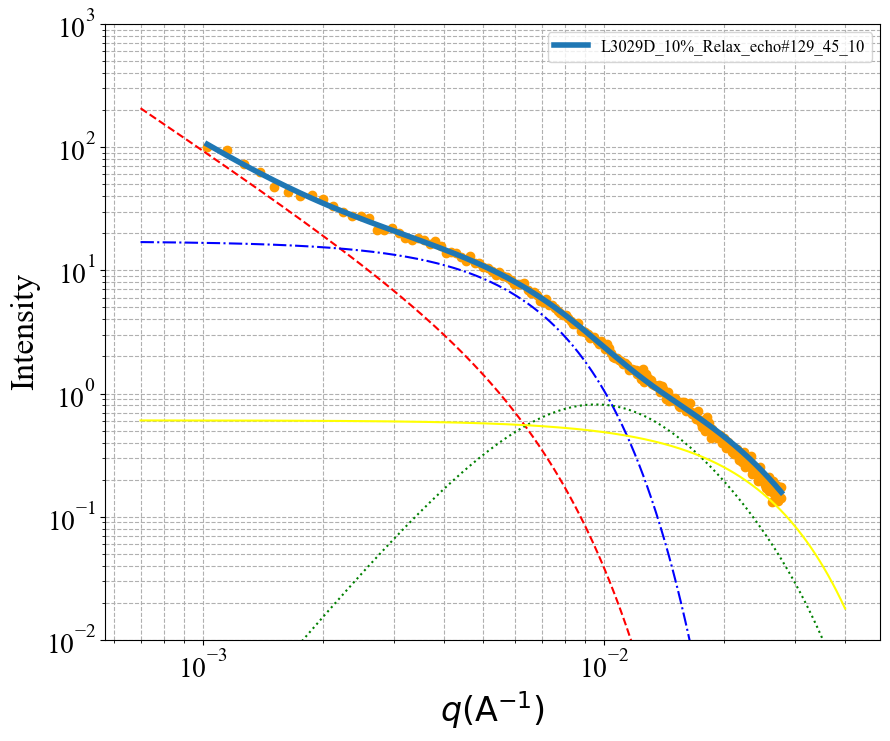


 Chi-square (func_1 with fixed params): 5.1652983353063755
Sample: L3029D_10%_Relax_echo#130_45_10 - Parameter 1: 3.7415e-05
Sample: L3029D_10%_Relax_echo#130_45_10 - Parameter 2: 2.1425e+00
Sample: L3029D_10%_Relax_echo#130_45_10 - Parameter 3: 2.8688e+02
Sample: L3029D_10%_Relax_echo#130_45_10 - Parameter 4: 1.6538e+01
Sample: L3029D_10%_Relax_echo#130_45_10 - Parameter 5: 3.9142e-02
Sample: L3029D_10%_Relax_echo#130_45_10 - Parameter 6: 8.7256e-01
Sample: L3029D_10%_Relax_echo#130_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#130_45_10 - Parameter 8: 3.4806e-03
Sample: L3029D_10%_Relax_echo#130_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#130_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1425 ± 0.0831
Rss: 286.8842 ± 18.9095



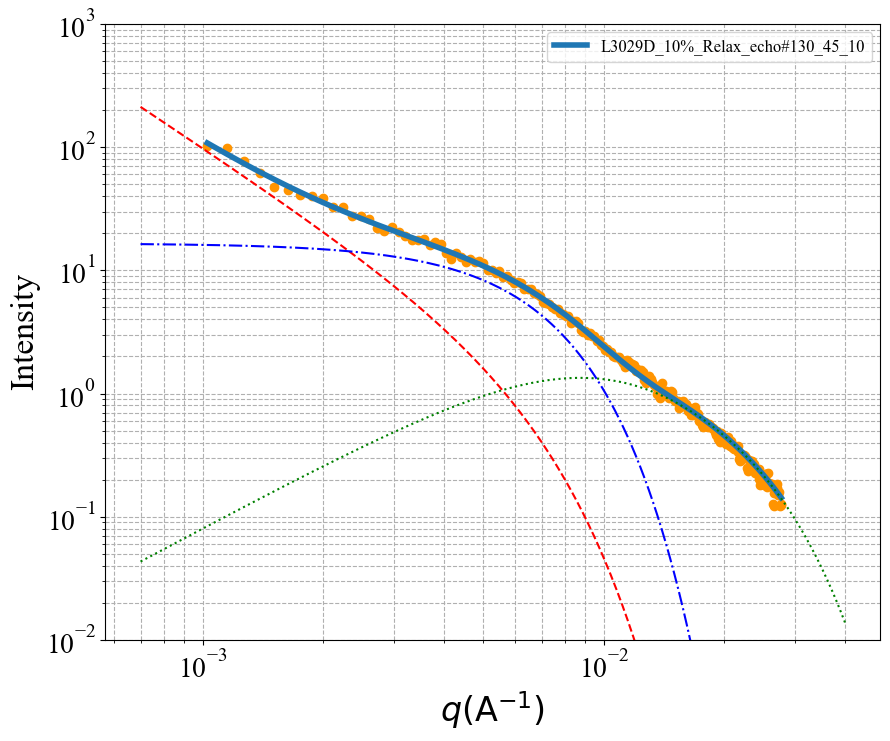


 Chi-square (func_1 with fixed params): 5.78821263810544
Sample: L3029D_10%_Relax_echo#131_45_10 - Parameter 1: 1.5923e-05
Sample: L3029D_10%_Relax_echo#131_45_10 - Parameter 2: 2.2660e+00
Sample: L3029D_10%_Relax_echo#131_45_10 - Parameter 3: 2.9660e+02
Sample: L3029D_10%_Relax_echo#131_45_10 - Parameter 4: 1.8195e+01
Sample: L3029D_10%_Relax_echo#131_45_10 - Parameter 5: 1.5102e-02
Sample: L3029D_10%_Relax_echo#131_45_10 - Parameter 6: 1.1024e+00
Sample: L3029D_10%_Relax_echo#131_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#131_45_10 - Parameter 8: 6.2456e-03
Sample: L3029D_10%_Relax_echo#131_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#131_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2660 ± 0.0916
Rss: 296.6015 ± 18.4567



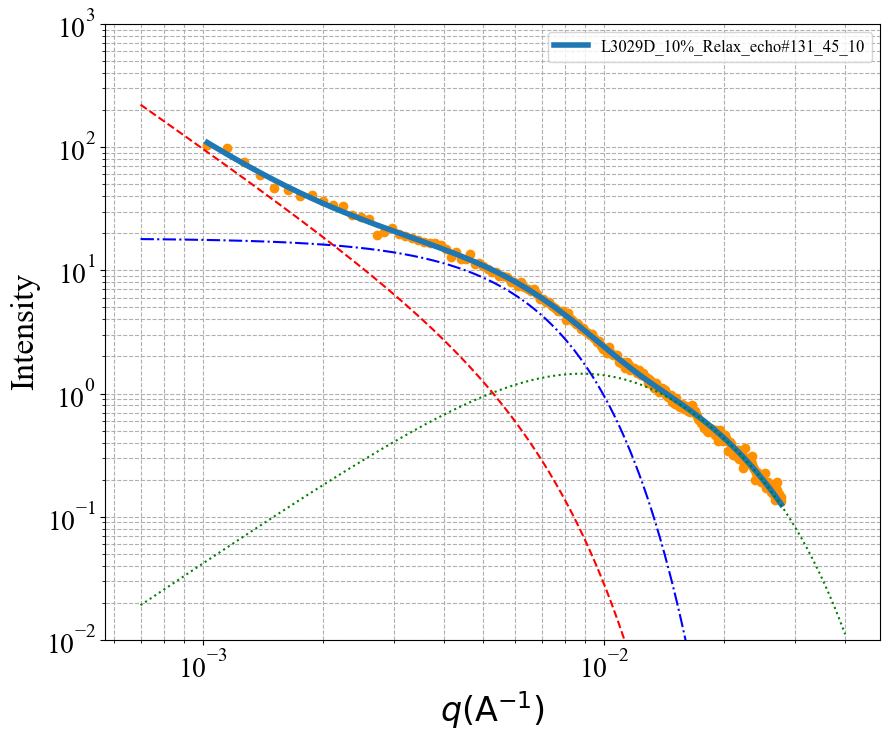


 Chi-square (func_1 with fixed params): 5.099638417839827
Sample: L3029D_10%_Relax_echo#132_45_10 - Parameter 1: 9.5025e-06
Sample: L3029D_10%_Relax_echo#132_45_10 - Parameter 2: 2.3418e+00
Sample: L3029D_10%_Relax_echo#132_45_10 - Parameter 3: 2.9992e+02
Sample: L3029D_10%_Relax_echo#132_45_10 - Parameter 4: 1.8950e+01
Sample: L3029D_10%_Relax_echo#132_45_10 - Parameter 5: 1.5824e-02
Sample: L3029D_10%_Relax_echo#132_45_10 - Parameter 6: 1.0852e+00
Sample: L3029D_10%_Relax_echo#132_45_10 - Parameter 7: 8.2184e+01
Sample: L3029D_10%_Relax_echo#132_45_10 - Parameter 8: 7.3690e-03
Sample: L3029D_10%_Relax_echo#132_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#132_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3418 ± 0.0865
Rss: 299.9168 ± 16.4644



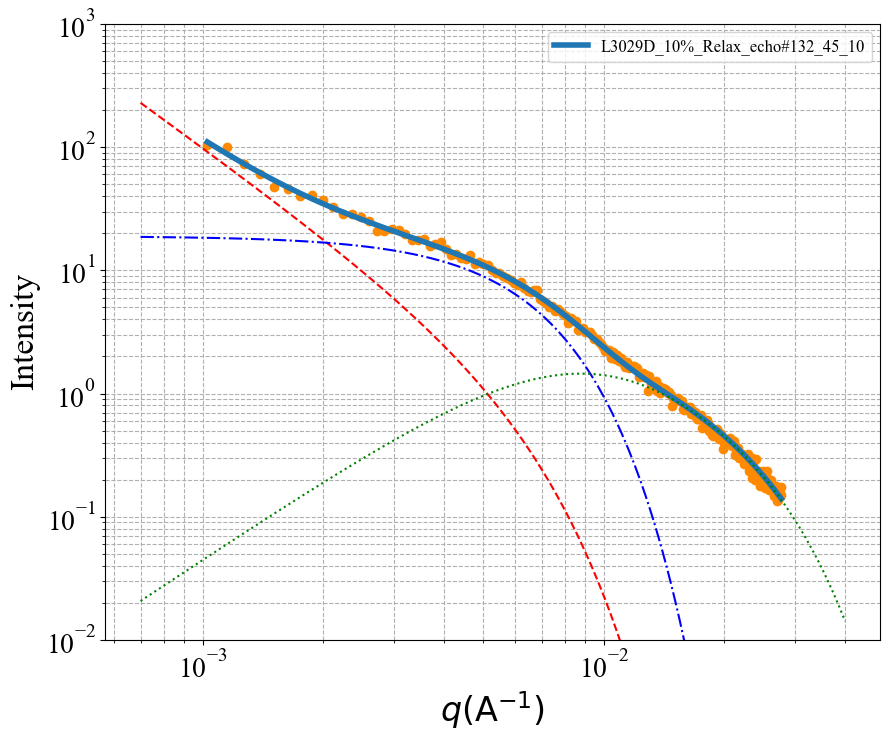


 Chi-square (func_1 with fixed params): 6.233251461202414
Sample: L3029D_10%_Relax_echo#133_45_10 - Parameter 1: 1.0275e-05
Sample: L3029D_10%_Relax_echo#133_45_10 - Parameter 2: 2.3323e+00
Sample: L3029D_10%_Relax_echo#133_45_10 - Parameter 3: 3.0085e+02
Sample: L3029D_10%_Relax_echo#133_45_10 - Parameter 4: 1.8560e+01
Sample: L3029D_10%_Relax_echo#133_45_10 - Parameter 5: 1.1036e-02
Sample: L3029D_10%_Relax_echo#133_45_10 - Parameter 6: 1.1828e+00
Sample: L3029D_10%_Relax_echo#133_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#133_45_10 - Parameter 8: 7.2729e-03
Sample: L3029D_10%_Relax_echo#133_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#133_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3323 ± 0.1032
Rss: 300.8504 ± 20.9749



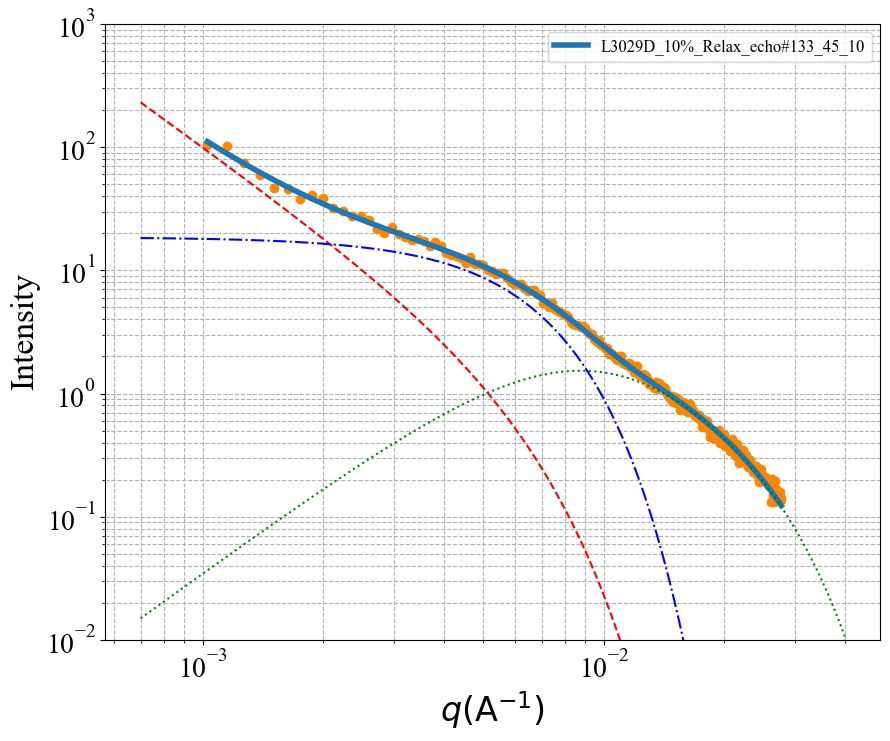


 Chi-square (func_1 with fixed params): 5.816421030400081
Sample: L3029D_10%_Relax_echo#134_45_10 - Parameter 1: 1.2122e-05
Sample: L3029D_10%_Relax_echo#134_45_10 - Parameter 2: 2.3059e+00
Sample: L3029D_10%_Relax_echo#134_45_10 - Parameter 3: 3.0182e+02
Sample: L3029D_10%_Relax_echo#134_45_10 - Parameter 4: 1.8889e+01
Sample: L3029D_10%_Relax_echo#134_45_10 - Parameter 5: 1.5593e-02
Sample: L3029D_10%_Relax_echo#134_45_10 - Parameter 6: 1.0976e+00
Sample: L3029D_10%_Relax_echo#134_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#134_45_10 - Parameter 8: 7.4404e-03
Sample: L3029D_10%_Relax_echo#134_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#134_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3059 ± 0.1035
Rss: 301.8247 ± 20.3092



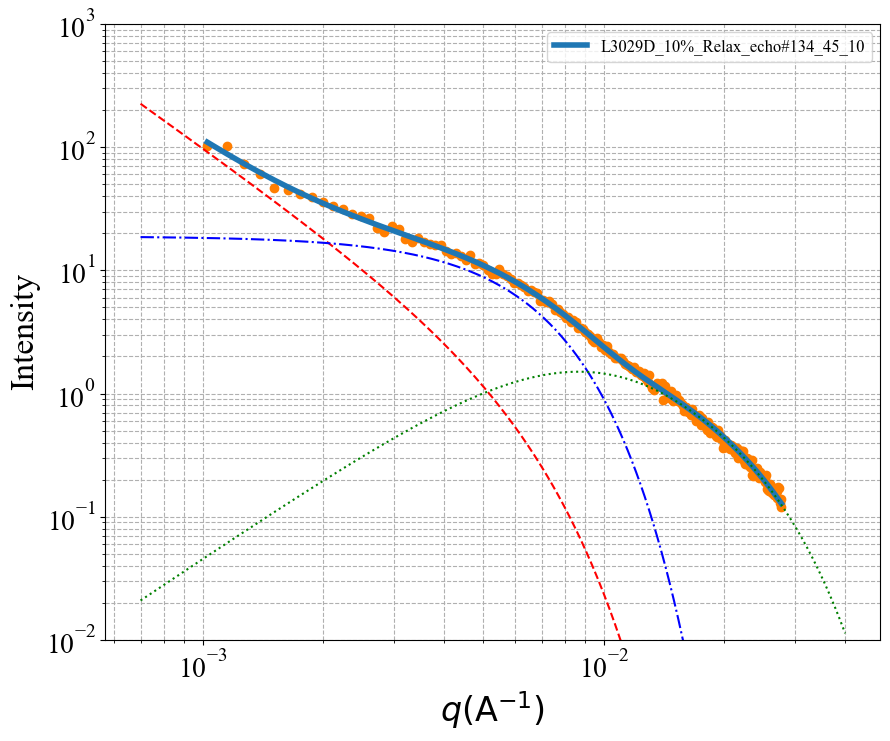


 Chi-square (func_1 with fixed params): 4.6079808633958566
Sample: L3029D_10%_Relax_echo#135_45_10 - Parameter 1: 6.7026e-05
Sample: L3029D_10%_Relax_echo#135_45_10 - Parameter 2: 2.0574e+00
Sample: L3029D_10%_Relax_echo#135_45_10 - Parameter 3: 2.7699e+02
Sample: L3029D_10%_Relax_echo#135_45_10 - Parameter 4: 1.5011e+01
Sample: L3029D_10%_Relax_echo#135_45_10 - Parameter 5: 7.4381e-02
Sample: L3029D_10%_Relax_echo#135_45_10 - Parameter 6: 7.0781e-01
Sample: L3029D_10%_Relax_echo#135_45_10 - Parameter 7: 8.4997e+01
Sample: L3029D_10%_Relax_echo#135_45_10 - Parameter 8: 5.9051e-03
Sample: L3029D_10%_Relax_echo#135_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#135_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0574 ± 0.0735
Rss: 276.9945 ± 19.0090



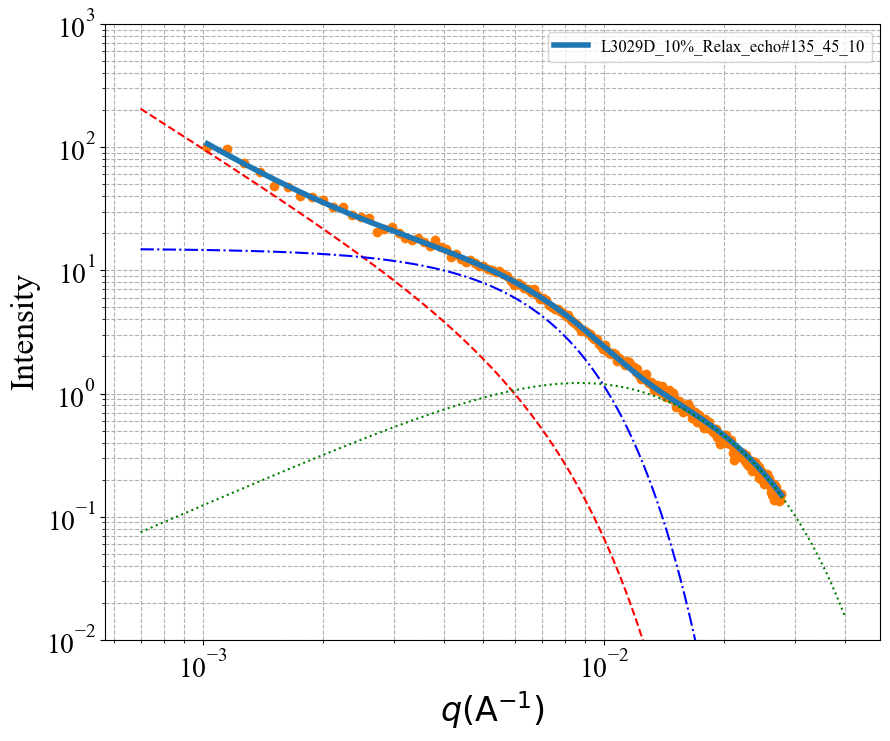


 Chi-square (func_1 with fixed params): 5.138198960618144
Sample: L3029D_10%_Relax_echo#136_45_10 - Parameter 1: 3.6794e-05
Sample: L3029D_10%_Relax_echo#136_45_10 - Parameter 2: 2.1411e+00
Sample: L3029D_10%_Relax_echo#136_45_10 - Parameter 3: 2.7626e+02
Sample: L3029D_10%_Relax_echo#136_45_10 - Parameter 4: 1.5946e+01
Sample: L3029D_10%_Relax_echo#136_45_10 - Parameter 5: 1.7577e-03
Sample: L3029D_10%_Relax_echo#136_45_10 - Parameter 6: 1.4535e+00
Sample: L3029D_10%_Relax_echo#136_45_10 - Parameter 7: 7.8783e+01
Sample: L3029D_10%_Relax_echo#136_45_10 - Parameter 8: 5.4779e-01
Sample: L3029D_10%_Relax_echo#136_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#136_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1411 ± 0.0775
Rss: 276.2612 ± 14.6111



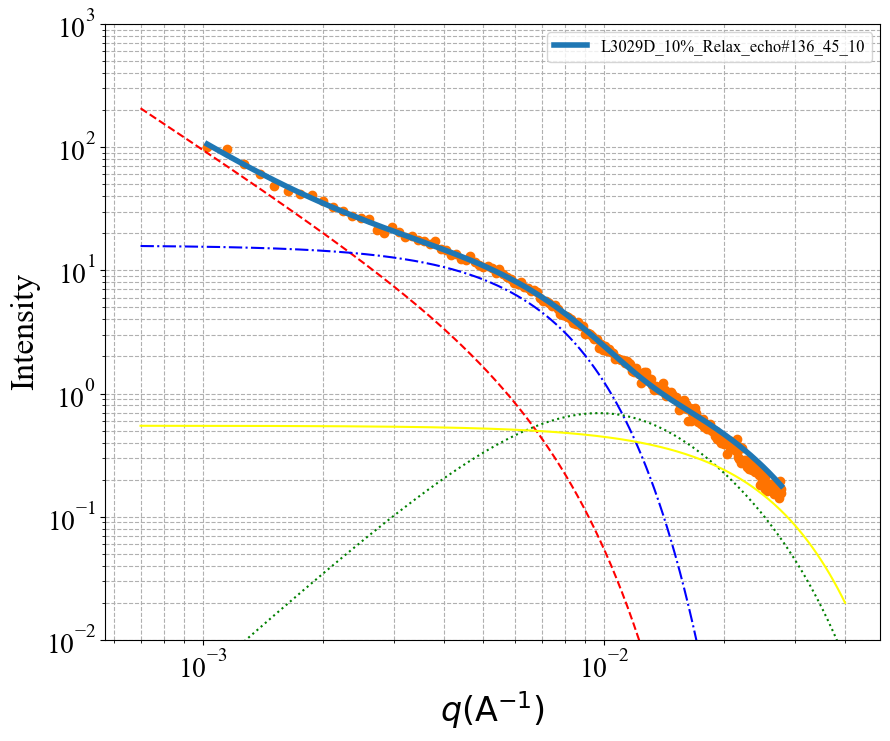


 Chi-square (func_1 with fixed params): 5.47896551278841
Sample: L3029D_10%_Relax_echo#137_45_10 - Parameter 1: 2.3302e-05
Sample: L3029D_10%_Relax_echo#137_45_10 - Parameter 2: 2.2116e+00
Sample: L3029D_10%_Relax_echo#137_45_10 - Parameter 3: 2.9235e+02
Sample: L3029D_10%_Relax_echo#137_45_10 - Parameter 4: 1.7327e+01
Sample: L3029D_10%_Relax_echo#137_45_10 - Parameter 5: 3.8033e-02
Sample: L3029D_10%_Relax_echo#137_45_10 - Parameter 6: 8.7625e-01
Sample: L3029D_10%_Relax_echo#137_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#137_45_10 - Parameter 8: 5.8248e-03
Sample: L3029D_10%_Relax_echo#137_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#137_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2116 ± 0.0924
Rss: 292.3466 ± 20.0062



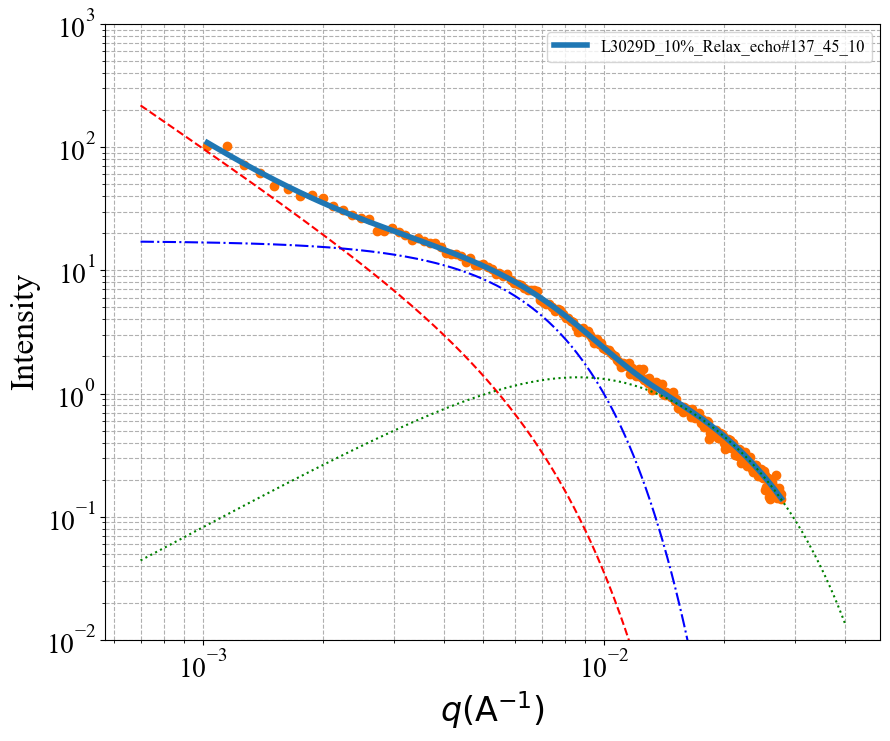


 Chi-square (func_1 with fixed params): 5.957320172781195
Sample: L3029D_10%_Relax_echo#138_45_10 - Parameter 1: 8.9045e-05
Sample: L3029D_10%_Relax_echo#138_45_10 - Parameter 2: 2.0158e+00
Sample: L3029D_10%_Relax_echo#138_45_10 - Parameter 3: 2.6835e+02
Sample: L3029D_10%_Relax_echo#138_45_10 - Parameter 4: 1.3923e+01
Sample: L3029D_10%_Relax_echo#138_45_10 - Parameter 5: 1.2041e-01
Sample: L3029D_10%_Relax_echo#138_45_10 - Parameter 6: 5.8186e-01
Sample: L3029D_10%_Relax_echo#138_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#138_45_10 - Parameter 8: 3.5981e-03
Sample: L3029D_10%_Relax_echo#138_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#138_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0158 ± 0.0845
Rss: 268.3455 ± 24.7263



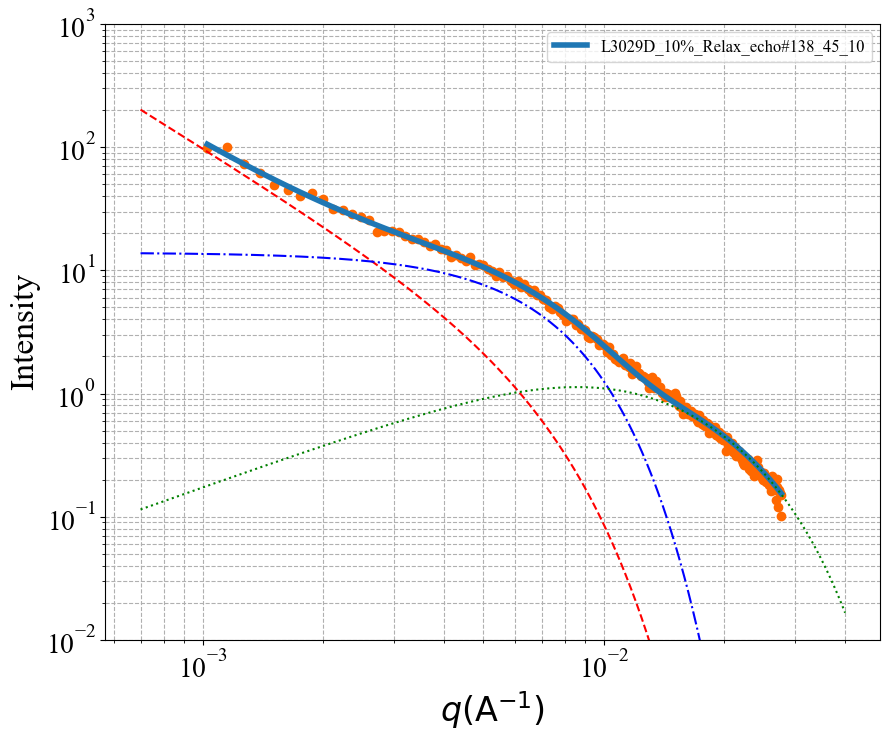


 Chi-square (func_1 with fixed params): 3.9633794646252305
Sample: L3029D_10%_Relax_echo#139_45_10 - Parameter 1: 9.8020e-06
Sample: L3029D_10%_Relax_echo#139_45_10 - Parameter 2: 2.3388e+00
Sample: L3029D_10%_Relax_echo#139_45_10 - Parameter 3: 3.0012e+02
Sample: L3029D_10%_Relax_echo#139_45_10 - Parameter 4: 1.8746e+01
Sample: L3029D_10%_Relax_echo#139_45_10 - Parameter 5: 9.9186e-03
Sample: L3029D_10%_Relax_echo#139_45_10 - Parameter 6: 1.2057e+00
Sample: L3029D_10%_Relax_echo#139_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#139_45_10 - Parameter 8: 4.9510e-03
Sample: L3029D_10%_Relax_echo#139_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#139_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3388 ± 0.0729
Rss: 300.1200 ± 14.4716



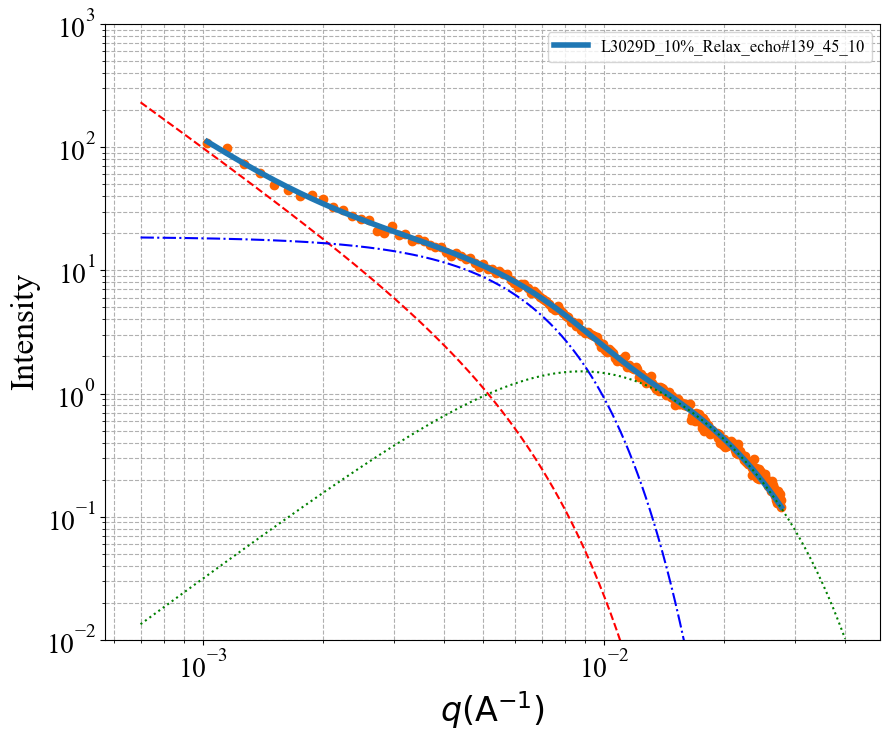


 Chi-square (func_1 with fixed params): 4.691047356406092
Sample: L3029D_10%_Relax_echo#140_45_10 - Parameter 1: 1.1882e-05
Sample: L3029D_10%_Relax_echo#140_45_10 - Parameter 2: 2.3021e+00
Sample: L3029D_10%_Relax_echo#140_45_10 - Parameter 3: 3.0576e+02
Sample: L3029D_10%_Relax_echo#140_45_10 - Parameter 4: 1.9344e+01
Sample: L3029D_10%_Relax_echo#140_45_10 - Parameter 5: 2.7135e-05
Sample: L3029D_10%_Relax_echo#140_45_10 - Parameter 6: 2.4749e+00
Sample: L3029D_10%_Relax_echo#140_45_10 - Parameter 7: 8.1500e+01
Sample: L3029D_10%_Relax_echo#140_45_10 - Parameter 8: 6.2052e-01
Sample: L3029D_10%_Relax_echo#140_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#140_45_10 - Parameter 10: 9.9999e-09

Dm: 2.3021 ± 0.0849
Rss: 305.7628 ± 16.0511



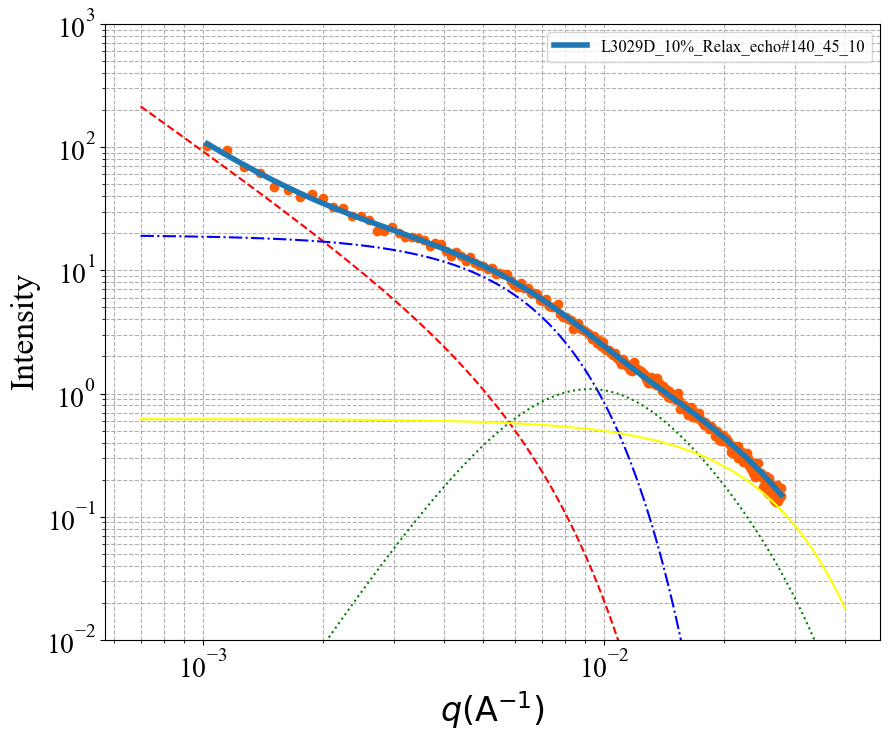


 Chi-square (func_1 with fixed params): 5.26819891258636
Sample: L3029D_10%_Relax_echo#141_45_10 - Parameter 1: 1.7960e-06
Sample: L3029D_10%_Relax_echo#141_45_10 - Parameter 2: 2.5819e+00
Sample: L3029D_10%_Relax_echo#141_45_10 - Parameter 3: 3.2665e+02
Sample: L3029D_10%_Relax_echo#141_45_10 - Parameter 4: 2.2188e+01
Sample: L3029D_10%_Relax_echo#141_45_10 - Parameter 5: 3.8932e-06
Sample: L3029D_10%_Relax_echo#141_45_10 - Parameter 6: 2.9262e+00
Sample: L3029D_10%_Relax_echo#141_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#141_45_10 - Parameter 8: 7.1138e-01
Sample: L3029D_10%_Relax_echo#141_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#141_45_10 - Parameter 10: 1.0000e-08

Dm: 2.5819 ± 0.1110
Rss: 326.6465 ± 20.3570



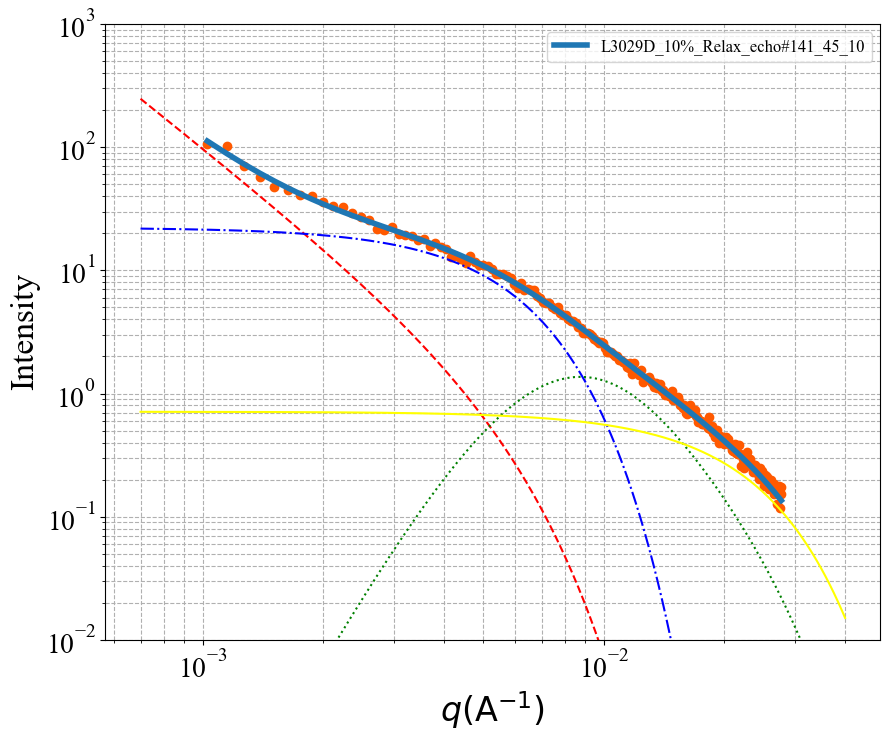


 Chi-square (func_1 with fixed params): 5.993367756636771
Sample: L3029D_10%_Relax_echo#142_45_10 - Parameter 1: 2.9433e-05
Sample: L3029D_10%_Relax_echo#142_45_10 - Parameter 2: 2.1746e+00
Sample: L3029D_10%_Relax_echo#142_45_10 - Parameter 3: 2.8080e+02
Sample: L3029D_10%_Relax_echo#142_45_10 - Parameter 4: 1.6300e+01
Sample: L3029D_10%_Relax_echo#142_45_10 - Parameter 5: 2.3958e-03
Sample: L3029D_10%_Relax_echo#142_45_10 - Parameter 6: 1.4093e+00
Sample: L3029D_10%_Relax_echo#142_45_10 - Parameter 7: 8.0391e+01
Sample: L3029D_10%_Relax_echo#142_45_10 - Parameter 8: 5.0530e-01
Sample: L3029D_10%_Relax_echo#142_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#142_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1746 ± 0.0941
Rss: 280.8011 ± 18.0433



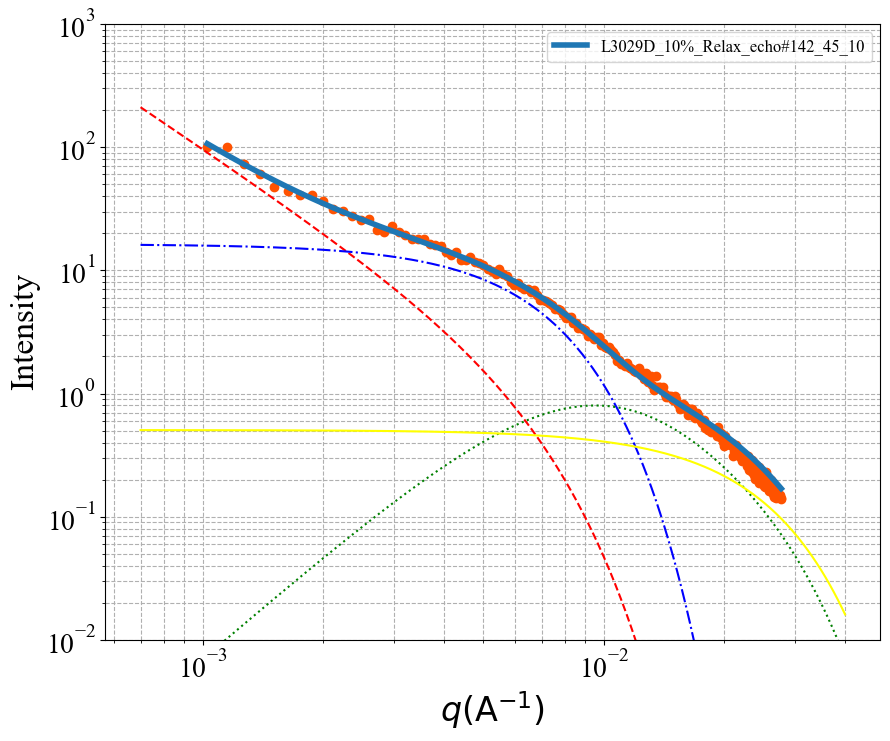


 Chi-square (func_1 with fixed params): 6.116447782521518
Sample: L3029D_10%_Relax_echo#143_45_10 - Parameter 1: 9.7462e-06
Sample: L3029D_10%_Relax_echo#143_45_10 - Parameter 2: 2.3364e+00
Sample: L3029D_10%_Relax_echo#143_45_10 - Parameter 3: 3.0151e+02
Sample: L3029D_10%_Relax_echo#143_45_10 - Parameter 4: 1.9179e+01
Sample: L3029D_10%_Relax_echo#143_45_10 - Parameter 5: 1.7143e-02
Sample: L3029D_10%_Relax_echo#143_45_10 - Parameter 6: 1.0734e+00
Sample: L3029D_10%_Relax_echo#143_45_10 - Parameter 7: 8.4736e+01
Sample: L3029D_10%_Relax_echo#143_45_10 - Parameter 8: 5.9457e-03
Sample: L3029D_10%_Relax_echo#143_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#143_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3364 ± 0.1030
Rss: 301.5109 ± 19.4005



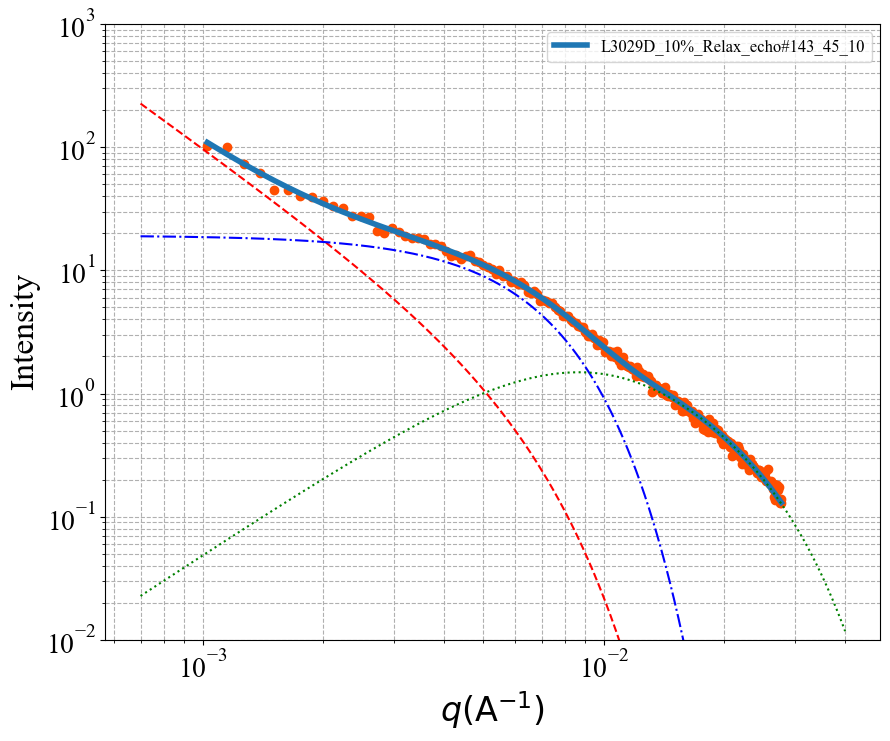


 Chi-square (func_1 with fixed params): 4.705010458446673
Sample: L3029D_10%_Relax_echo#144_45_10 - Parameter 1: 9.1599e-06
Sample: L3029D_10%_Relax_echo#144_45_10 - Parameter 2: 2.3487e+00
Sample: L3029D_10%_Relax_echo#144_45_10 - Parameter 3: 3.0153e+02
Sample: L3029D_10%_Relax_echo#144_45_10 - Parameter 4: 1.8890e+01
Sample: L3029D_10%_Relax_echo#144_45_10 - Parameter 5: 1.5723e-02
Sample: L3029D_10%_Relax_echo#144_45_10 - Parameter 6: 1.0945e+00
Sample: L3029D_10%_Relax_echo#144_45_10 - Parameter 7: 8.3371e+01
Sample: L3029D_10%_Relax_echo#144_45_10 - Parameter 8: 5.5672e-03
Sample: L3029D_10%_Relax_echo#144_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#144_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3487 ± 0.0854
Rss: 301.5267 ± 16.7432



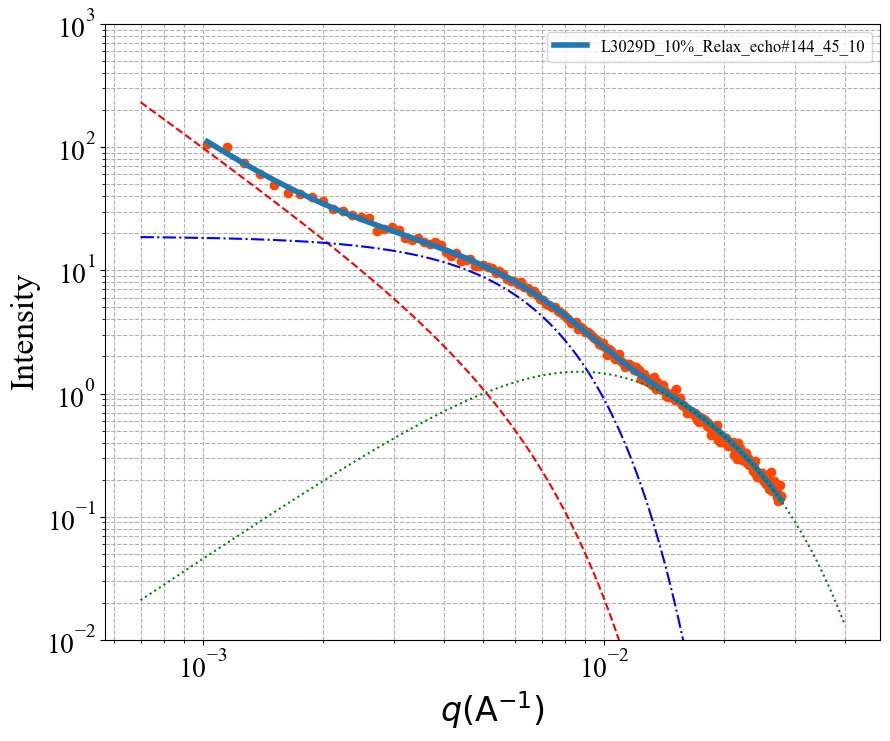


 Chi-square (func_1 with fixed params): 4.551515837322271
Sample: L3029D_10%_Relax_echo#145_45_10 - Parameter 1: 7.9785e-06
Sample: L3029D_10%_Relax_echo#145_45_10 - Parameter 2: 2.3636e+00
Sample: L3029D_10%_Relax_echo#145_45_10 - Parameter 3: 3.1069e+02
Sample: L3029D_10%_Relax_echo#145_45_10 - Parameter 4: 1.9934e+01
Sample: L3029D_10%_Relax_echo#145_45_10 - Parameter 5: 5.1048e-03
Sample: L3029D_10%_Relax_echo#145_45_10 - Parameter 6: 1.3675e+00
Sample: L3029D_10%_Relax_echo#145_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#145_45_10 - Parameter 8: 6.2052e-03
Sample: L3029D_10%_Relax_echo#145_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#145_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3636 ± 0.0833
Rss: 310.6857 ± 15.8757



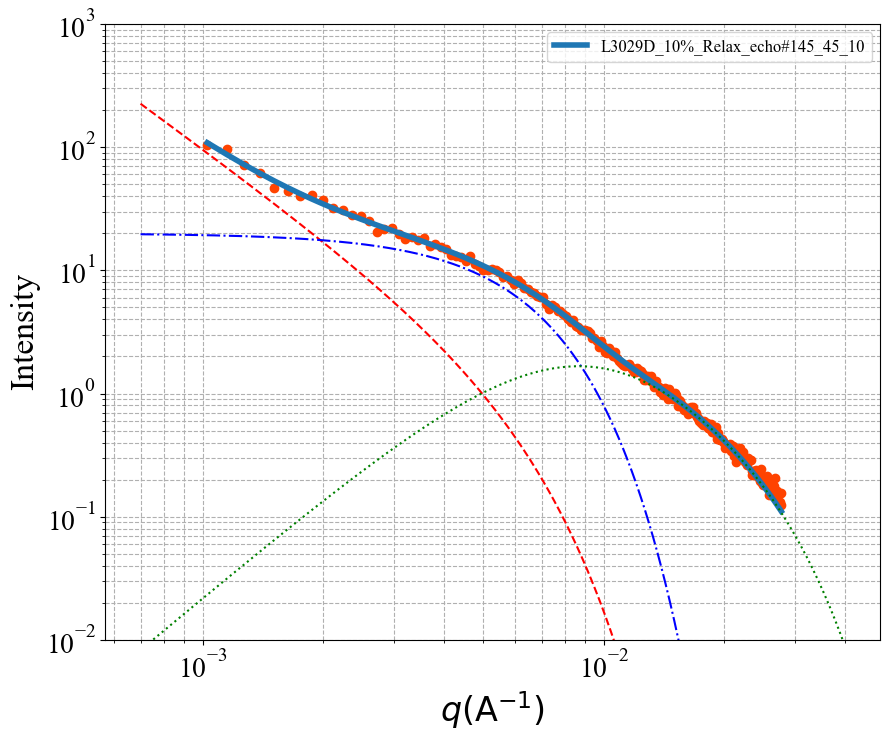


 Chi-square (func_1 with fixed params): 6.825312853972156
Sample: L3029D_10%_Relax_echo#146_45_10 - Parameter 1: 5.5872e-05
Sample: L3029D_10%_Relax_echo#146_45_10 - Parameter 2: 2.0820e+00
Sample: L3029D_10%_Relax_echo#146_45_10 - Parameter 3: 2.7965e+02
Sample: L3029D_10%_Relax_echo#146_45_10 - Parameter 4: 1.5536e+01
Sample: L3029D_10%_Relax_echo#146_45_10 - Parameter 5: 1.0091e-01
Sample: L3029D_10%_Relax_echo#146_45_10 - Parameter 6: 6.3323e-01
Sample: L3029D_10%_Relax_echo#146_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#146_45_10 - Parameter 8: 5.7628e-03
Sample: L3029D_10%_Relax_echo#146_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#146_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0820 ± 0.0917
Rss: 279.6450 ± 23.2958



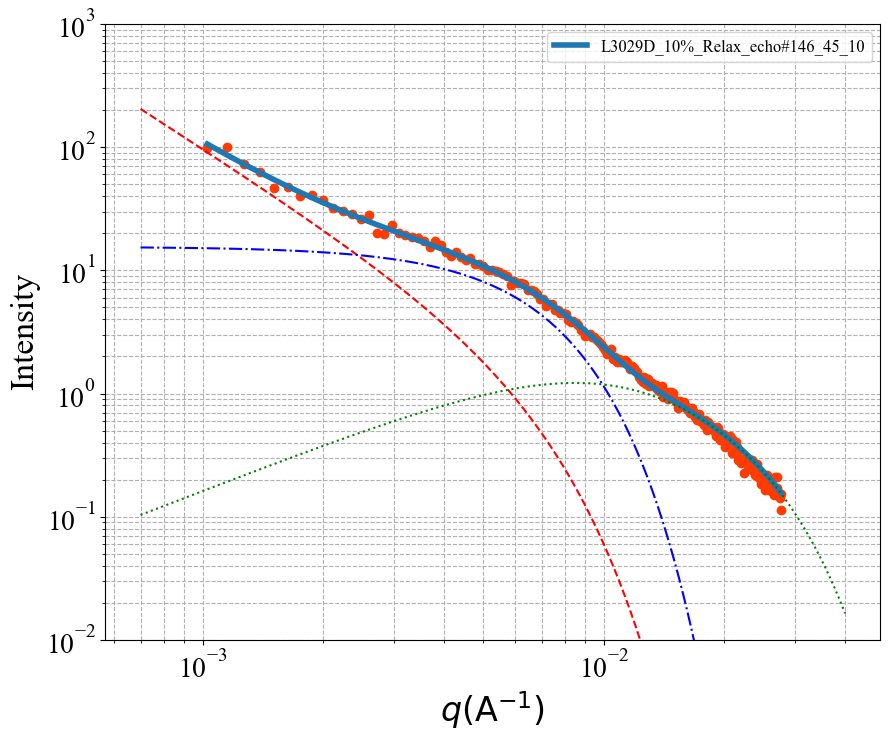


 Chi-square (func_1 with fixed params): 5.7186404273313745
Sample: L3029D_10%_Relax_echo#147_45_10 - Parameter 1: 6.1733e-06
Sample: L3029D_10%_Relax_echo#147_45_10 - Parameter 2: 2.4070e+00
Sample: L3029D_10%_Relax_echo#147_45_10 - Parameter 3: 3.0896e+02
Sample: L3029D_10%_Relax_echo#147_45_10 - Parameter 4: 1.9829e+01
Sample: L3029D_10%_Relax_echo#147_45_10 - Parameter 5: 4.8138e-03
Sample: L3029D_10%_Relax_echo#147_45_10 - Parameter 6: 1.3779e+00
Sample: L3029D_10%_Relax_echo#147_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#147_45_10 - Parameter 8: 7.7034e-03
Sample: L3029D_10%_Relax_echo#147_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#147_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4070 ± 0.1017
Rss: 308.9634 ± 19.8848



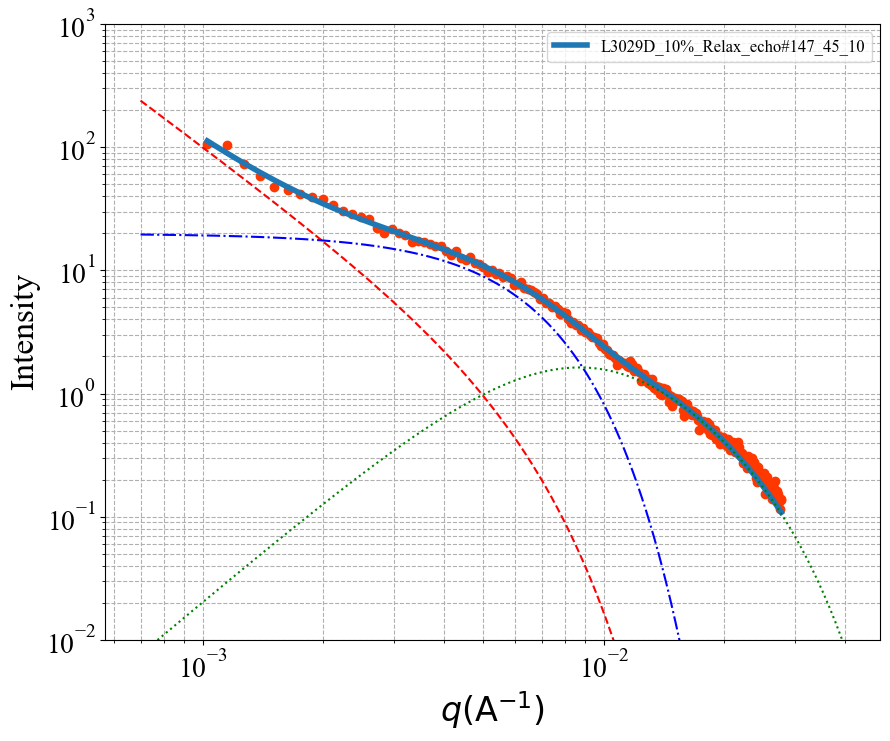


 Chi-square (func_1 with fixed params): 4.774963488485264
Sample: L3029D_10%_Relax_echo#148_45_10 - Parameter 1: 1.6048e-05
Sample: L3029D_10%_Relax_echo#148_45_10 - Parameter 2: 2.2652e+00
Sample: L3029D_10%_Relax_echo#148_45_10 - Parameter 3: 2.9696e+02
Sample: L3029D_10%_Relax_echo#148_45_10 - Parameter 4: 1.8127e+01
Sample: L3029D_10%_Relax_echo#148_45_10 - Parameter 5: 2.0084e-02
Sample: L3029D_10%_Relax_echo#148_45_10 - Parameter 6: 1.0325e+00
Sample: L3029D_10%_Relax_echo#148_45_10 - Parameter 7: 8.4174e+01
Sample: L3029D_10%_Relax_echo#148_45_10 - Parameter 8: 7.2099e-03
Sample: L3029D_10%_Relax_echo#148_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#148_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2652 ± 0.0902
Rss: 296.9624 ± 18.3152



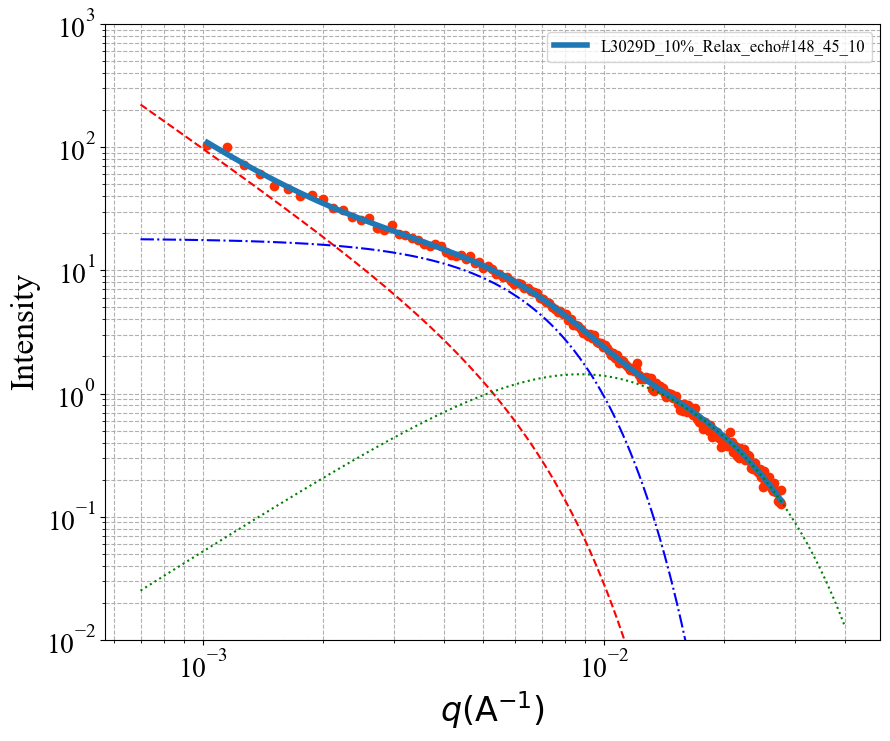


 Chi-square (func_1 with fixed params): 6.082733219224172
Sample: L3029D_10%_Relax_echo#149_45_10 - Parameter 1: 2.8112e-05
Sample: L3029D_10%_Relax_echo#149_45_10 - Parameter 2: 2.1823e+00
Sample: L3029D_10%_Relax_echo#149_45_10 - Parameter 3: 2.9057e+02
Sample: L3029D_10%_Relax_echo#149_45_10 - Parameter 4: 1.7124e+01
Sample: L3029D_10%_Relax_echo#149_45_10 - Parameter 5: 3.4240e-02
Sample: L3029D_10%_Relax_echo#149_45_10 - Parameter 6: 9.0414e-01
Sample: L3029D_10%_Relax_echo#149_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#149_45_10 - Parameter 8: 6.9278e-03
Sample: L3029D_10%_Relax_echo#149_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#149_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1823 ± 0.0950
Rss: 290.5738 ± 20.5166



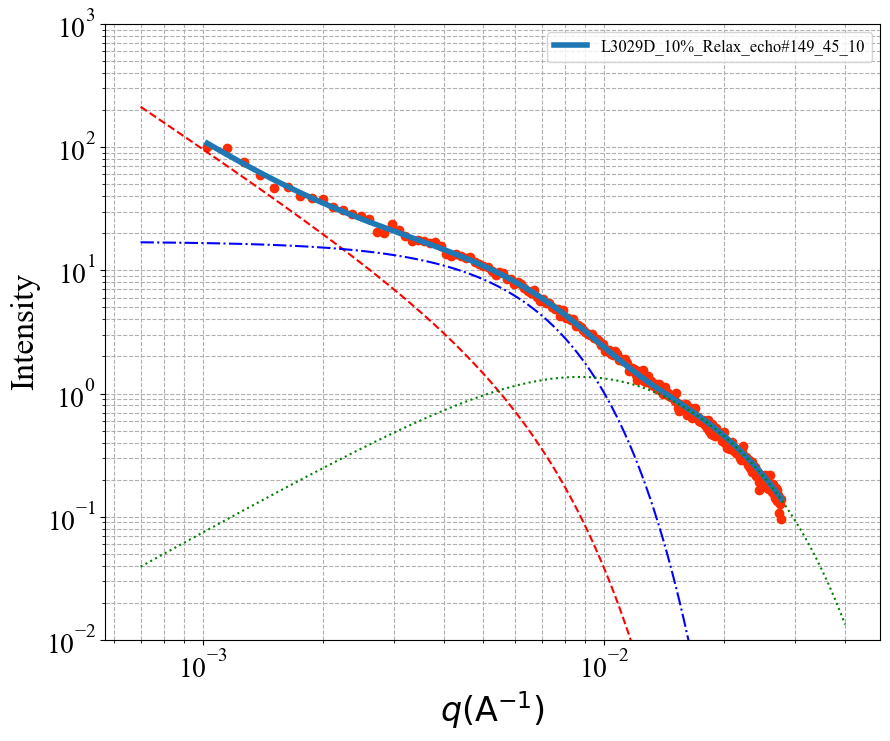


 Chi-square (func_1 with fixed params): 5.992494843403969
Sample: L3029D_10%_Relax_echo#150_45_10 - Parameter 1: 6.0065e-06
Sample: L3029D_10%_Relax_echo#150_45_10 - Parameter 2: 2.4108e+00
Sample: L3029D_10%_Relax_echo#150_45_10 - Parameter 3: 3.0188e+02
Sample: L3029D_10%_Relax_echo#150_45_10 - Parameter 4: 1.9420e+01
Sample: L3029D_10%_Relax_echo#150_45_10 - Parameter 5: 1.7333e-02
Sample: L3029D_10%_Relax_echo#150_45_10 - Parameter 6: 1.0644e+00
Sample: L3029D_10%_Relax_echo#150_45_10 - Parameter 7: 8.2703e+01
Sample: L3029D_10%_Relax_echo#150_45_10 - Parameter 8: 4.1148e-03
Sample: L3029D_10%_Relax_echo#150_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#150_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4108 ± 0.1027
Rss: 301.8810 ± 19.0922



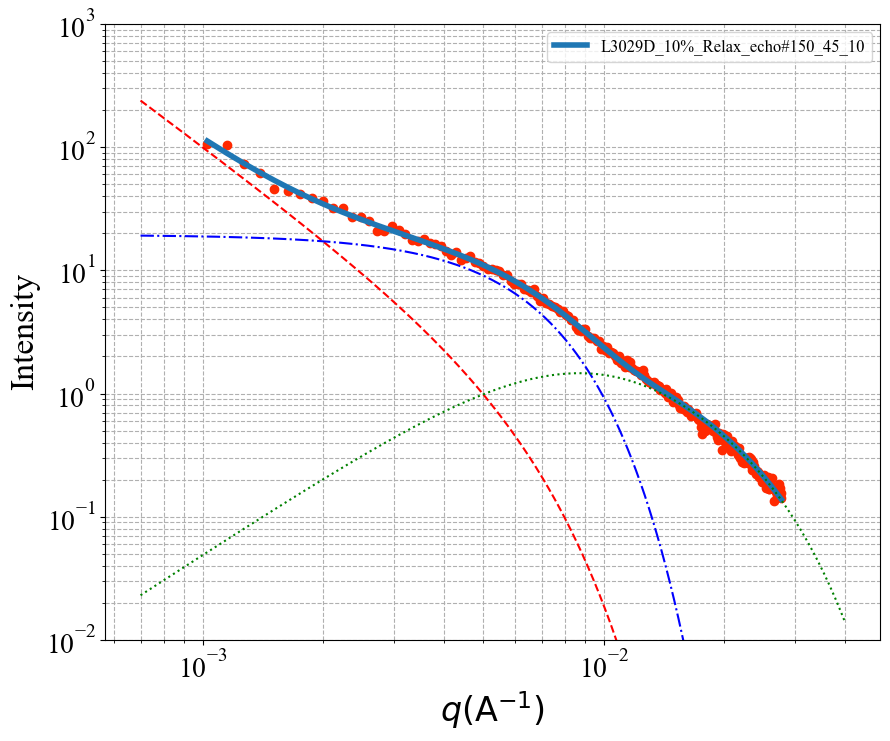


 Chi-square (func_1 with fixed params): 4.2797825480142535
Sample: L3029D_10%_Relax_echo#151_45_10 - Parameter 1: 2.9641e-06
Sample: L3029D_10%_Relax_echo#151_45_10 - Parameter 2: 2.5124e+00
Sample: L3029D_10%_Relax_echo#151_45_10 - Parameter 3: 3.0928e+02
Sample: L3029D_10%_Relax_echo#151_45_10 - Parameter 4: 2.0210e+01
Sample: L3029D_10%_Relax_echo#151_45_10 - Parameter 5: 3.3633e-06
Sample: L3029D_10%_Relax_echo#151_45_10 - Parameter 6: 2.9239e+00
Sample: L3029D_10%_Relax_echo#151_45_10 - Parameter 7: 8.4999e+01
Sample: L3029D_10%_Relax_echo#151_45_10 - Parameter 8: 8.0284e-01
Sample: L3029D_10%_Relax_echo#151_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#151_45_10 - Parameter 10: 1.1513e-28

Dm: 2.5124 ± 0.0812
Rss: 309.2795 ± 14.8556



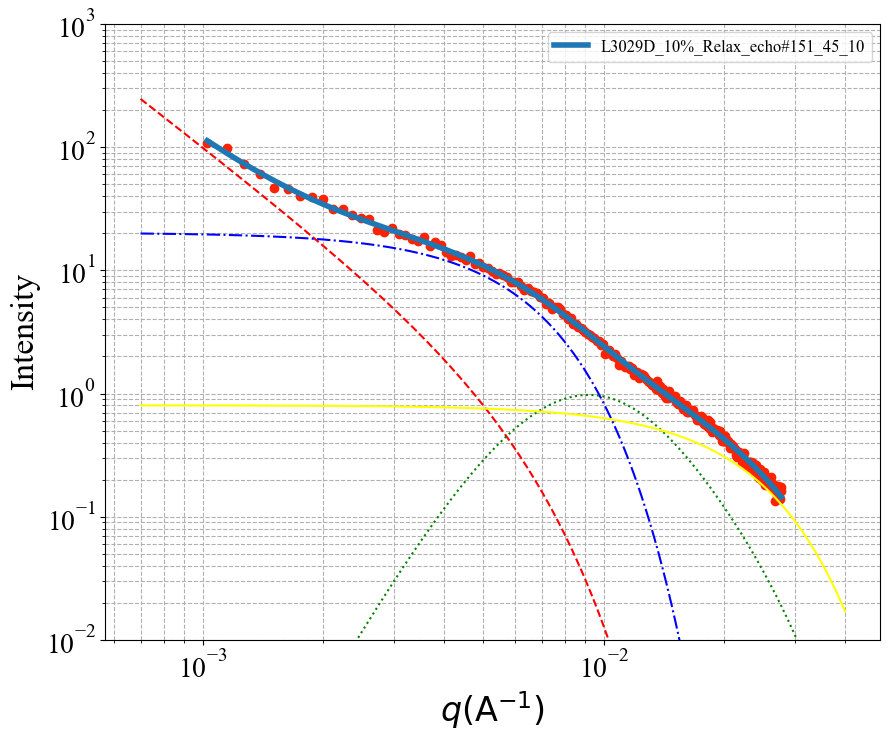


 Chi-square (func_1 with fixed params): 4.734341861988568
Sample: L3029D_10%_Relax_echo#152_45_10 - Parameter 1: 7.0714e-06
Sample: L3029D_10%_Relax_echo#152_45_10 - Parameter 2: 2.3826e+00
Sample: L3029D_10%_Relax_echo#152_45_10 - Parameter 3: 3.0609e+02
Sample: L3029D_10%_Relax_echo#152_45_10 - Parameter 4: 1.9875e+01
Sample: L3029D_10%_Relax_echo#152_45_10 - Parameter 5: 5.7345e-03
Sample: L3029D_10%_Relax_echo#152_45_10 - Parameter 6: 1.3298e+00
Sample: L3029D_10%_Relax_echo#152_45_10 - Parameter 7: 8.2529e+01
Sample: L3029D_10%_Relax_echo#152_45_10 - Parameter 8: 1.1814e-02
Sample: L3029D_10%_Relax_echo#152_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#152_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3826 ± 0.0906
Rss: 306.0901 ± 16.6528



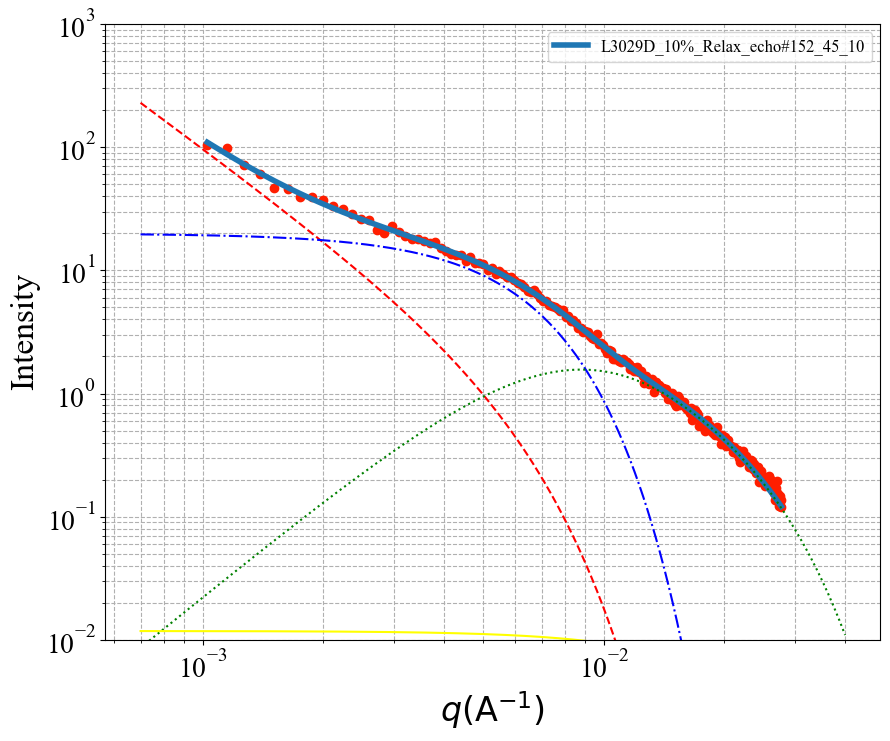


 Chi-square (func_1 with fixed params): 5.881426697269054
Sample: L3029D_10%_Relax_echo#153_45_10 - Parameter 1: 4.4002e-05
Sample: L3029D_10%_Relax_echo#153_45_10 - Parameter 2: 2.1187e+00
Sample: L3029D_10%_Relax_echo#153_45_10 - Parameter 3: 2.7792e+02
Sample: L3029D_10%_Relax_echo#153_45_10 - Parameter 4: 1.5642e+01
Sample: L3029D_10%_Relax_echo#153_45_10 - Parameter 5: 6.8893e-02
Sample: L3029D_10%_Relax_echo#153_45_10 - Parameter 6: 7.2320e-01
Sample: L3029D_10%_Relax_echo#153_45_10 - Parameter 7: 8.4044e+01
Sample: L3029D_10%_Relax_echo#153_45_10 - Parameter 8: 1.0898e-02
Sample: L3029D_10%_Relax_echo#153_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#153_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1187 ± 0.0816
Rss: 277.9239 ± 19.7261



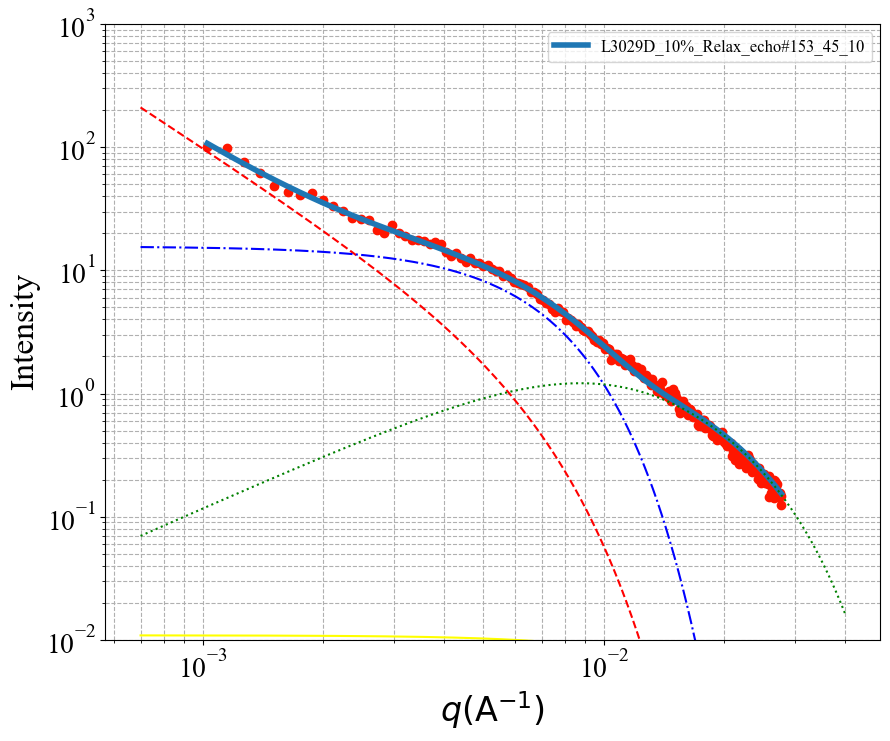


 Chi-square (func_1 with fixed params): 4.751063191180842
Sample: L3029D_10%_Relax_echo#154_45_10 - Parameter 1: 4.6039e-06
Sample: L3029D_10%_Relax_echo#154_45_10 - Parameter 2: 2.4494e+00
Sample: L3029D_10%_Relax_echo#154_45_10 - Parameter 3: 3.0698e+02
Sample: L3029D_10%_Relax_echo#154_45_10 - Parameter 4: 1.9934e+01
Sample: L3029D_10%_Relax_echo#154_45_10 - Parameter 5: 9.1529e-03
Sample: L3029D_10%_Relax_echo#154_45_10 - Parameter 6: 1.2204e+00
Sample: L3029D_10%_Relax_echo#154_45_10 - Parameter 7: 8.2855e+01
Sample: L3029D_10%_Relax_echo#154_45_10 - Parameter 8: 5.8789e-03
Sample: L3029D_10%_Relax_echo#154_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#154_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4494 ± 0.0892
Rss: 306.9822 ± 16.4542



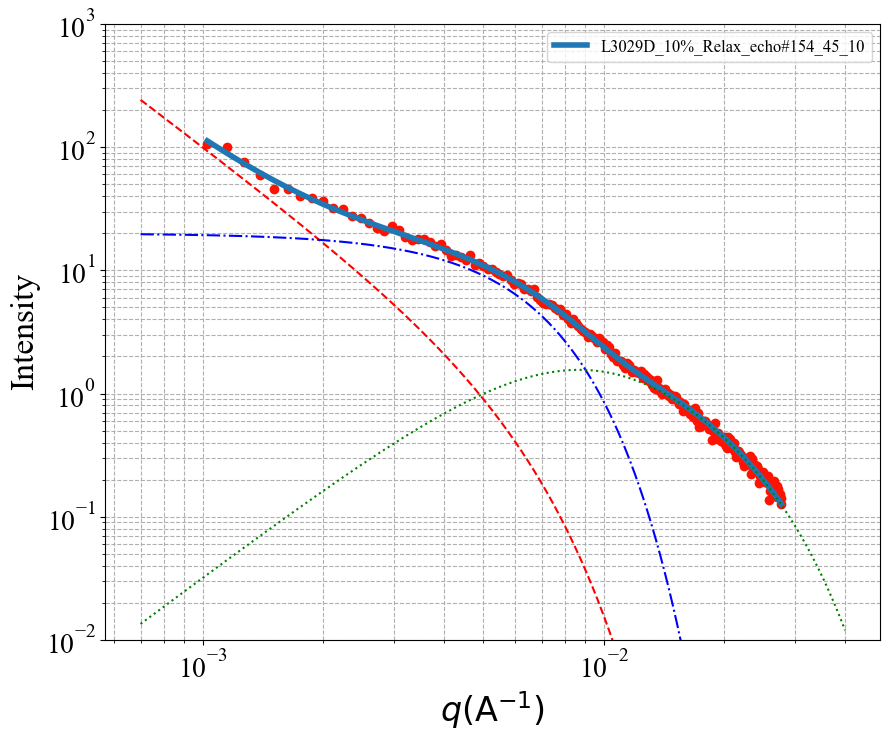


 Chi-square (func_1 with fixed params): 4.0270544658344685
Sample: L3029D_10%_Relax_echo#155_45_10 - Parameter 1: 7.2751e-06
Sample: L3029D_10%_Relax_echo#155_45_10 - Parameter 2: 2.3836e+00
Sample: L3029D_10%_Relax_echo#155_45_10 - Parameter 3: 3.0448e+02
Sample: L3029D_10%_Relax_echo#155_45_10 - Parameter 4: 1.9273e+01
Sample: L3029D_10%_Relax_echo#155_45_10 - Parameter 5: 1.0051e-02
Sample: L3029D_10%_Relax_echo#155_45_10 - Parameter 6: 1.2021e+00
Sample: L3029D_10%_Relax_echo#155_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#155_45_10 - Parameter 8: 8.1117e-03
Sample: L3029D_10%_Relax_echo#155_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#155_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3836 ± 0.0732
Rss: 304.4770 ± 14.3176



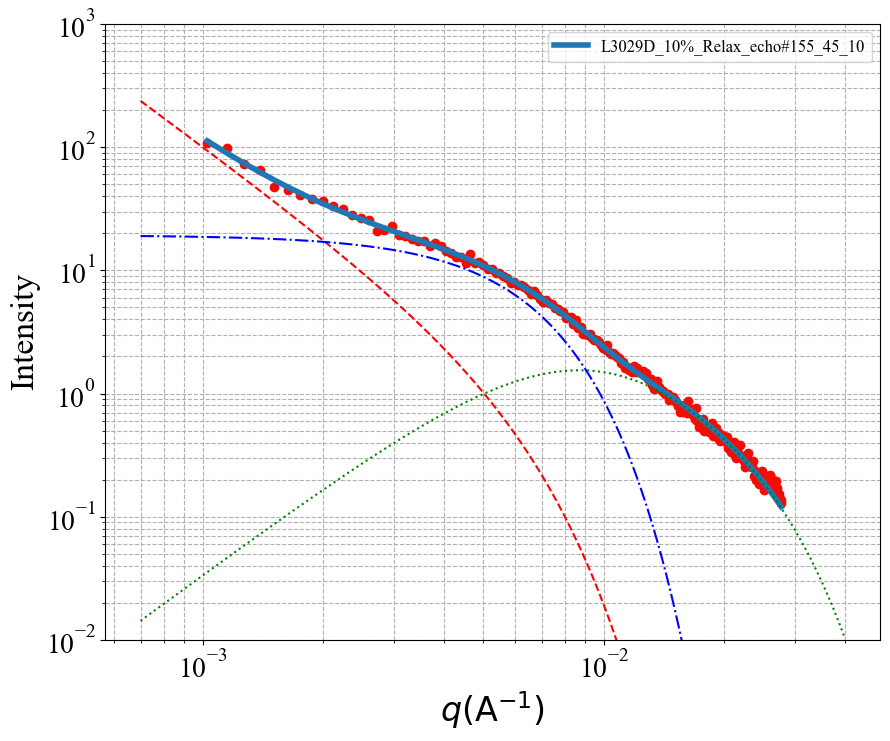


 Chi-square (func_1 with fixed params): 6.173255963417133
Sample: L3029D_10%_Relax_echo#156_45_10 - Parameter 1: 7.1889e-05
Sample: L3029D_10%_Relax_echo#156_45_10 - Parameter 2: 2.0470e+00
Sample: L3029D_10%_Relax_echo#156_45_10 - Parameter 3: 2.7102e+02
Sample: L3029D_10%_Relax_echo#156_45_10 - Parameter 4: 1.4508e+01
Sample: L3029D_10%_Relax_echo#156_45_10 - Parameter 5: 1.0597e-01
Sample: L3029D_10%_Relax_echo#156_45_10 - Parameter 6: 6.1122e-01
Sample: L3029D_10%_Relax_echo#156_45_10 - Parameter 7: 8.2830e+01
Sample: L3029D_10%_Relax_echo#156_45_10 - Parameter 8: 2.9429e-03
Sample: L3029D_10%_Relax_echo#156_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#156_45_10 - Parameter 10: 1.0000e-08

Dm: 2.0470 ± 0.0812
Rss: 271.0245 ± 22.0776



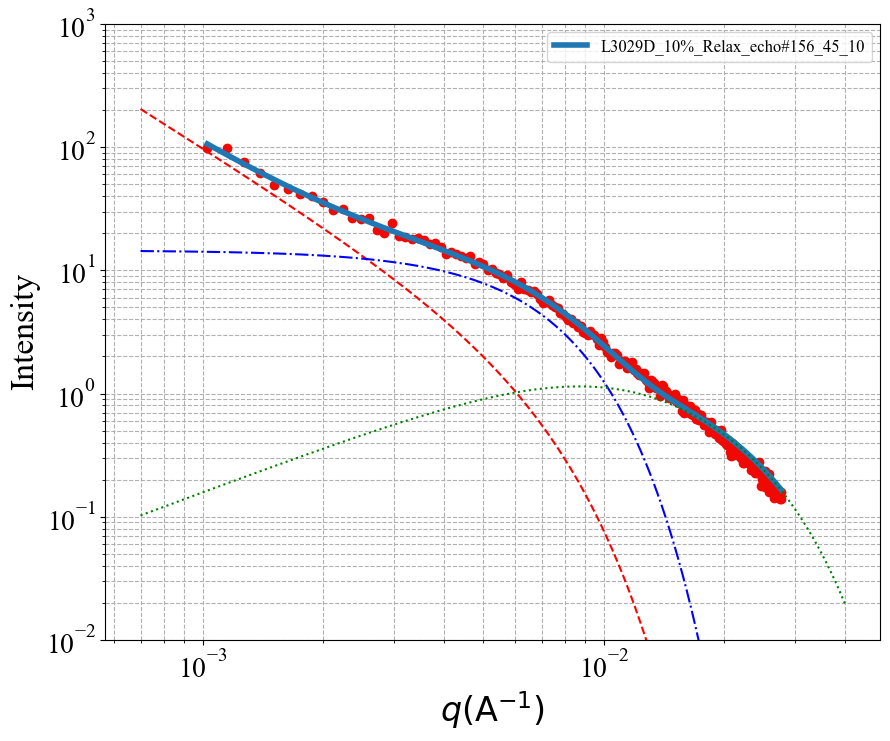


 Chi-square (func_1 with fixed params): 6.009113028405343
Sample: L3029D_10%_Relax_echo#157_45_10 - Parameter 1: 6.5705e-06
Sample: L3029D_10%_Relax_echo#157_45_10 - Parameter 2: 2.3948e+00
Sample: L3029D_10%_Relax_echo#157_45_10 - Parameter 3: 2.9709e+02
Sample: L3029D_10%_Relax_echo#157_45_10 - Parameter 4: 1.8699e+01
Sample: L3029D_10%_Relax_echo#157_45_10 - Parameter 5: 3.4126e-04
Sample: L3029D_10%_Relax_echo#157_45_10 - Parameter 6: 1.8712e+00
Sample: L3029D_10%_Relax_echo#157_45_10 - Parameter 7: 8.1023e+01
Sample: L3029D_10%_Relax_echo#157_45_10 - Parameter 8: 5.8021e-01
Sample: L3029D_10%_Relax_echo#157_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#157_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3948 ± 0.0999
Rss: 297.0888 ± 17.5721



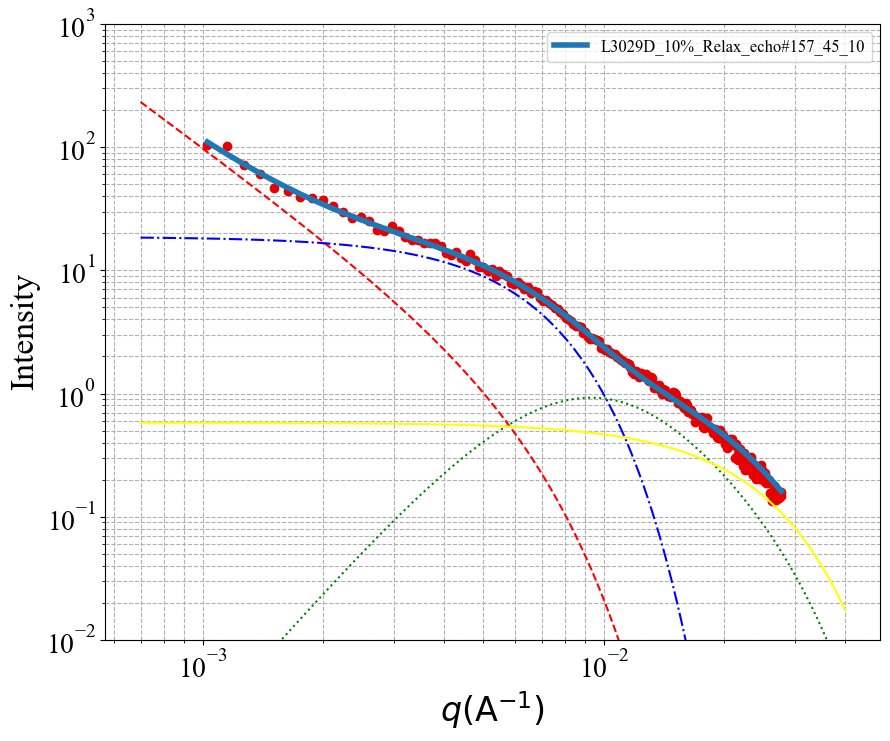


 Chi-square (func_1 with fixed params): 4.5471850733023675
Sample: L3029D_10%_Relax_echo#158_45_10 - Parameter 1: 1.5287e-05
Sample: L3029D_10%_Relax_echo#158_45_10 - Parameter 2: 2.2702e+00
Sample: L3029D_10%_Relax_echo#158_45_10 - Parameter 3: 2.9050e+02
Sample: L3029D_10%_Relax_echo#158_45_10 - Parameter 4: 1.7614e+01
Sample: L3029D_10%_Relax_echo#158_45_10 - Parameter 5: 3.1179e-05
Sample: L3029D_10%_Relax_echo#158_45_10 - Parameter 6: 2.4139e+00
Sample: L3029D_10%_Relax_echo#158_45_10 - Parameter 7: 7.9914e+01
Sample: L3029D_10%_Relax_echo#158_45_10 - Parameter 8: 6.4185e-01
Sample: L3029D_10%_Relax_echo#158_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#158_45_10 - Parameter 10: 9.9991e-09

Dm: 2.2702 ± 0.0812
Rss: 290.5008 ± 15.7765



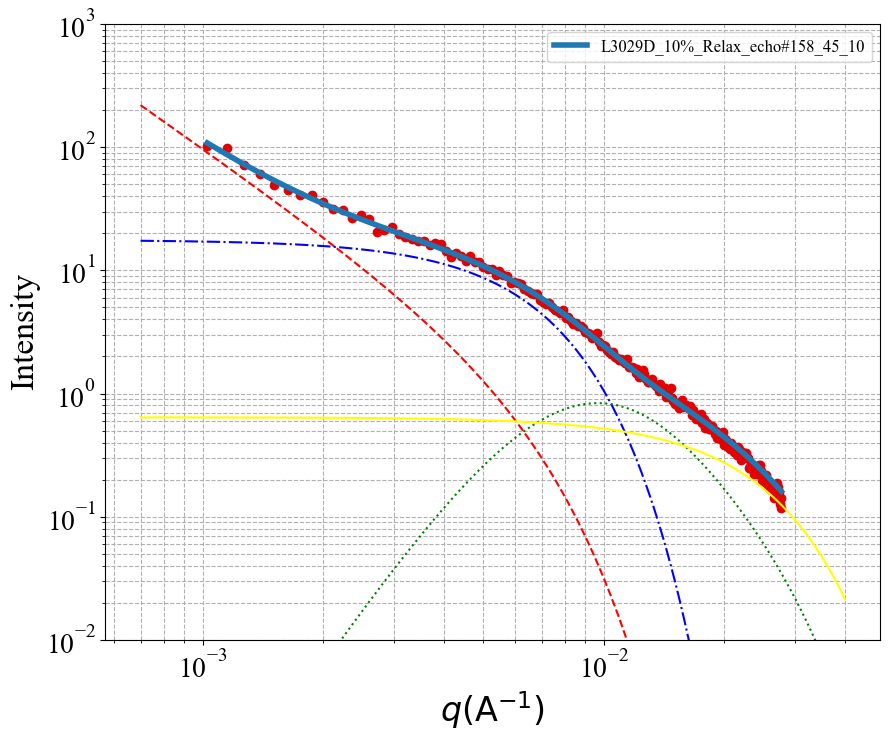


 Chi-square (func_1 with fixed params): 5.399809178255368
Sample: L3029D_10%_Relax_echo#159_45_10 - Parameter 1: 6.6700e-06
Sample: L3029D_10%_Relax_echo#159_45_10 - Parameter 2: 2.3957e+00
Sample: L3029D_10%_Relax_echo#159_45_10 - Parameter 3: 3.0731e+02
Sample: L3029D_10%_Relax_echo#159_45_10 - Parameter 4: 1.9791e+01
Sample: L3029D_10%_Relax_echo#159_45_10 - Parameter 5: 1.1858e-02
Sample: L3029D_10%_Relax_echo#159_45_10 - Parameter 6: 1.1654e+00
Sample: L3029D_10%_Relax_echo#159_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#159_45_10 - Parameter 8: 1.0161e-02
Sample: L3029D_10%_Relax_echo#159_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#159_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3957 ± 0.0901
Rss: 307.3062 ± 17.1492



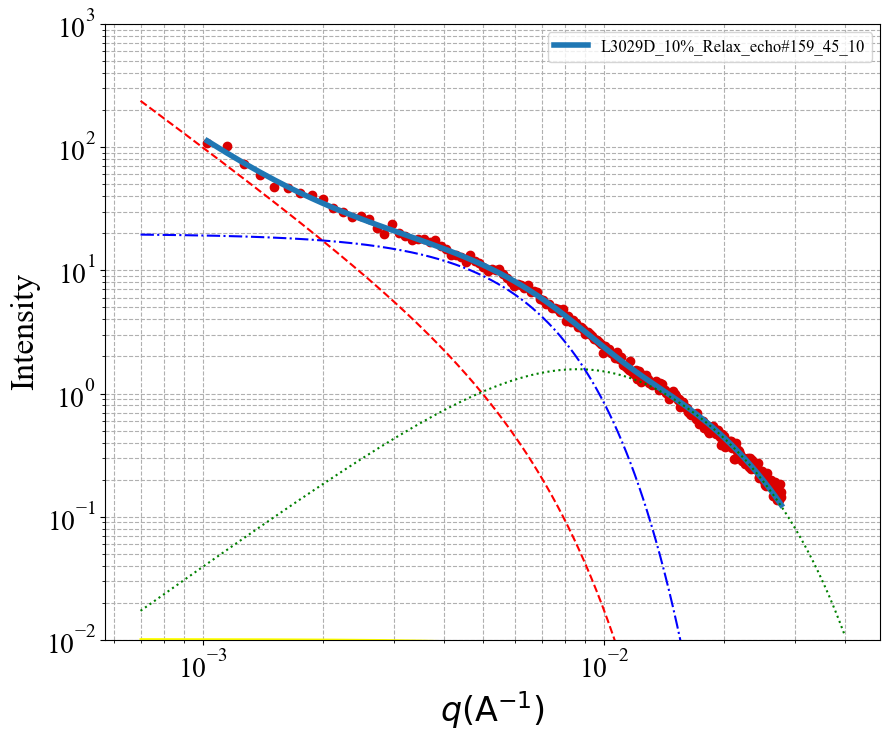


 Chi-square (func_1 with fixed params): 4.843533301757959
Sample: L3029D_10%_Relax_echo#160_45_10 - Parameter 1: 4.4452e-06
Sample: L3029D_10%_Relax_echo#160_45_10 - Parameter 2: 2.4595e+00
Sample: L3029D_10%_Relax_echo#160_45_10 - Parameter 3: 3.0454e+02
Sample: L3029D_10%_Relax_echo#160_45_10 - Parameter 4: 1.9409e+01
Sample: L3029D_10%_Relax_echo#160_45_10 - Parameter 5: 2.0262e-02
Sample: L3029D_10%_Relax_echo#160_45_10 - Parameter 6: 1.0349e+00
Sample: L3029D_10%_Relax_echo#160_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#160_45_10 - Parameter 8: 7.6179e-03
Sample: L3029D_10%_Relax_echo#160_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#160_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4595 ± 0.0834
Rss: 304.5387 ± 16.1840



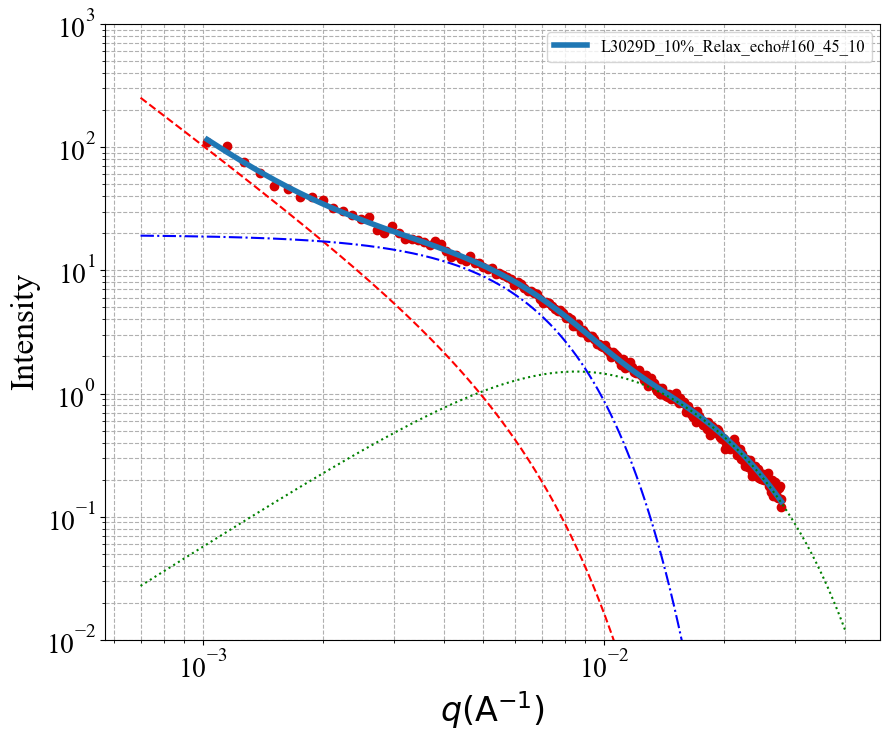


 Chi-square (func_1 with fixed params): 5.101168375664517
Sample: L3029D_10%_Relax_echo#161_45_10 - Parameter 1: 4.5729e-06
Sample: L3029D_10%_Relax_echo#161_45_10 - Parameter 2: 2.4490e+00
Sample: L3029D_10%_Relax_echo#161_45_10 - Parameter 3: 3.1160e+02
Sample: L3029D_10%_Relax_echo#161_45_10 - Parameter 4: 2.0223e+01
Sample: L3029D_10%_Relax_echo#161_45_10 - Parameter 5: 9.7504e-03
Sample: L3029D_10%_Relax_echo#161_45_10 - Parameter 6: 1.2140e+00
Sample: L3029D_10%_Relax_echo#161_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#161_45_10 - Parameter 8: 3.6684e-03
Sample: L3029D_10%_Relax_echo#161_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#161_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4490 ± 0.0899
Rss: 311.6009 ± 16.6659



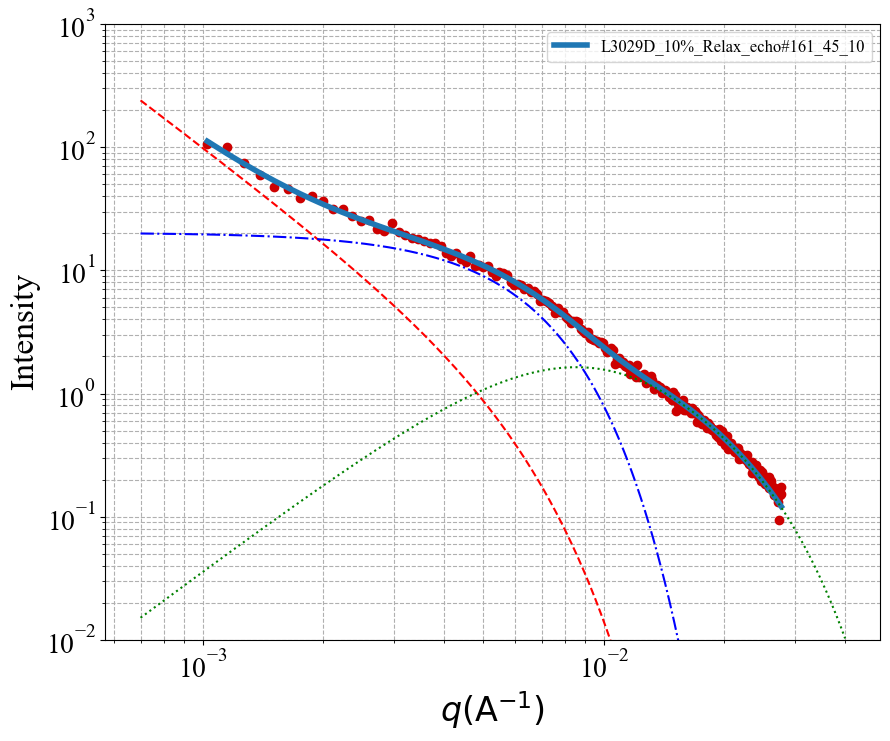


 Chi-square (func_1 with fixed params): 5.043266594966353
Sample: L3029D_10%_Relax_echo#162_45_10 - Parameter 1: 8.0760e-06
Sample: L3029D_10%_Relax_echo#162_45_10 - Parameter 2: 2.3651e+00
Sample: L3029D_10%_Relax_echo#162_45_10 - Parameter 3: 3.0653e+02
Sample: L3029D_10%_Relax_echo#162_45_10 - Parameter 4: 1.9536e+01
Sample: L3029D_10%_Relax_echo#162_45_10 - Parameter 5: 8.2888e-03
Sample: L3029D_10%_Relax_echo#162_45_10 - Parameter 6: 1.2483e+00
Sample: L3029D_10%_Relax_echo#162_45_10 - Parameter 7: 8.3389e+01
Sample: L3029D_10%_Relax_echo#162_45_10 - Parameter 8: 5.0214e-03
Sample: L3029D_10%_Relax_echo#162_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#162_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3651 ± 0.0968
Rss: 306.5303 ± 18.5524



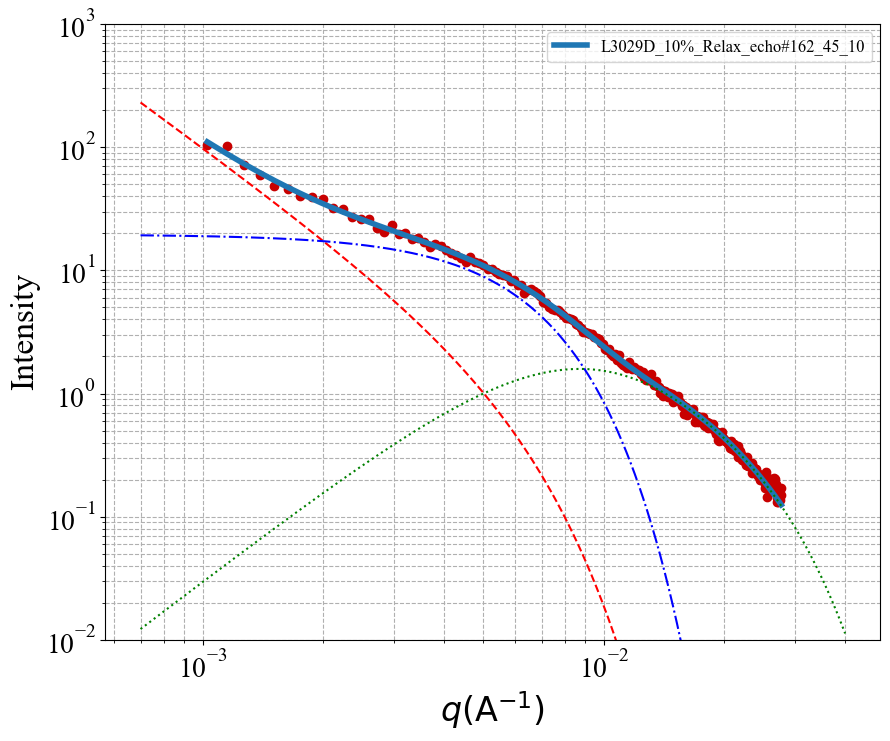


 Chi-square (func_1 with fixed params): 4.493351596252375
Sample: L3029D_10%_Relax_echo#163_45_10 - Parameter 1: 1.1129e-05
Sample: L3029D_10%_Relax_echo#163_45_10 - Parameter 2: 2.3182e+00
Sample: L3029D_10%_Relax_echo#163_45_10 - Parameter 3: 2.9633e+02
Sample: L3029D_10%_Relax_echo#163_45_10 - Parameter 4: 1.8197e+01
Sample: L3029D_10%_Relax_echo#163_45_10 - Parameter 5: 1.7152e-02
Sample: L3029D_10%_Relax_echo#163_45_10 - Parameter 6: 1.0699e+00
Sample: L3029D_10%_Relax_echo#163_45_10 - Parameter 7: 8.3591e+01
Sample: L3029D_10%_Relax_echo#163_45_10 - Parameter 8: 4.9615e-03
Sample: L3029D_10%_Relax_echo#163_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#163_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3182 ± 0.0807
Rss: 296.3256 ± 15.9790



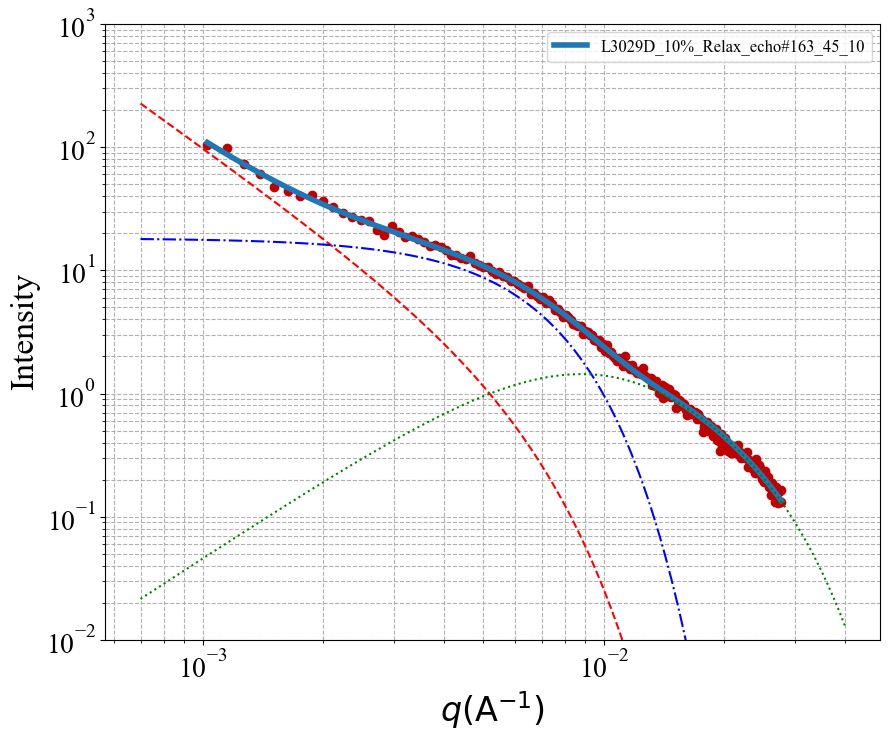


 Chi-square (func_1 with fixed params): 6.746969143731449
Sample: L3029D_10%_Relax_echo#164_45_10 - Parameter 1: 2.1985e-05
Sample: L3029D_10%_Relax_echo#164_45_10 - Parameter 2: 2.2199e+00
Sample: L3029D_10%_Relax_echo#164_45_10 - Parameter 3: 2.8257e+02
Sample: L3029D_10%_Relax_echo#164_45_10 - Parameter 4: 1.6499e+01
Sample: L3029D_10%_Relax_echo#164_45_10 - Parameter 5: 2.9220e-03
Sample: L3029D_10%_Relax_echo#164_45_10 - Parameter 6: 1.3611e+00
Sample: L3029D_10%_Relax_echo#164_45_10 - Parameter 7: 8.2023e+01
Sample: L3029D_10%_Relax_echo#164_45_10 - Parameter 8: 5.3453e-01
Sample: L3029D_10%_Relax_echo#164_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#164_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2199 ± 0.1035
Rss: 282.5686 ± 19.8748



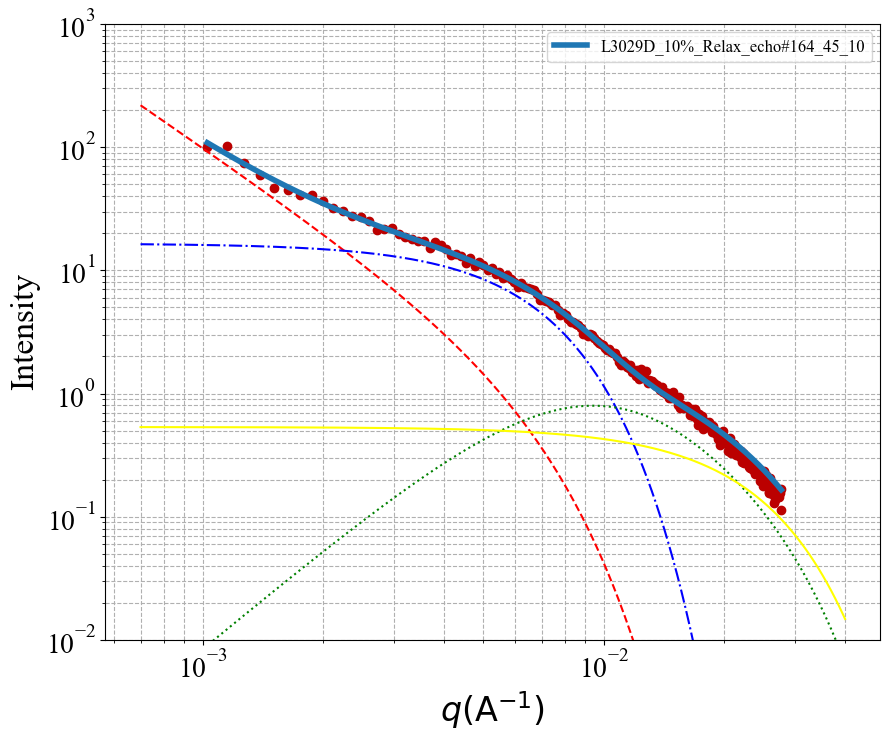


 Chi-square (func_1 with fixed params): 4.525395179192016
Sample: L3029D_10%_Relax_echo#165_45_10 - Parameter 1: 4.6082e-06
Sample: L3029D_10%_Relax_echo#165_45_10 - Parameter 2: 2.4502e+00
Sample: L3029D_10%_Relax_echo#165_45_10 - Parameter 3: 3.1060e+02
Sample: L3029D_10%_Relax_echo#165_45_10 - Parameter 4: 2.0023e+01
Sample: L3029D_10%_Relax_echo#165_45_10 - Parameter 5: 1.0046e-02
Sample: L3029D_10%_Relax_echo#165_45_10 - Parameter 6: 1.2062e+00
Sample: L3029D_10%_Relax_echo#165_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#165_45_10 - Parameter 8: 6.6496e-03
Sample: L3029D_10%_Relax_echo#165_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#165_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4502 ± 0.0817
Rss: 310.5955 ± 15.5033



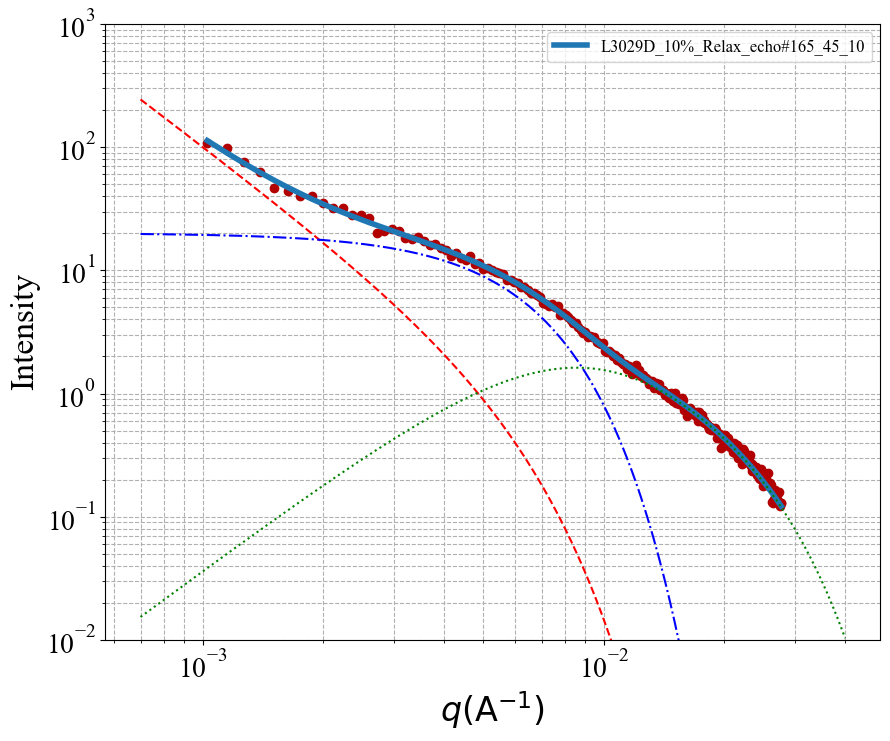


 Chi-square (func_1 with fixed params): 5.678439842682074
Sample: L3029D_10%_Relax_echo#166_45_10 - Parameter 1: 2.2096e-05
Sample: L3029D_10%_Relax_echo#166_45_10 - Parameter 2: 2.2183e+00
Sample: L3029D_10%_Relax_echo#166_45_10 - Parameter 3: 2.8630e+02
Sample: L3029D_10%_Relax_echo#166_45_10 - Parameter 4: 1.6974e+01
Sample: L3029D_10%_Relax_echo#166_45_10 - Parameter 5: 1.0717e-03
Sample: L3029D_10%_Relax_echo#166_45_10 - Parameter 6: 1.6163e+00
Sample: L3029D_10%_Relax_echo#166_45_10 - Parameter 7: 8.0599e+01
Sample: L3029D_10%_Relax_echo#166_45_10 - Parameter 8: 4.8191e-01
Sample: L3029D_10%_Relax_echo#166_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#166_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2183 ± 0.0919
Rss: 286.3019 ± 17.8383



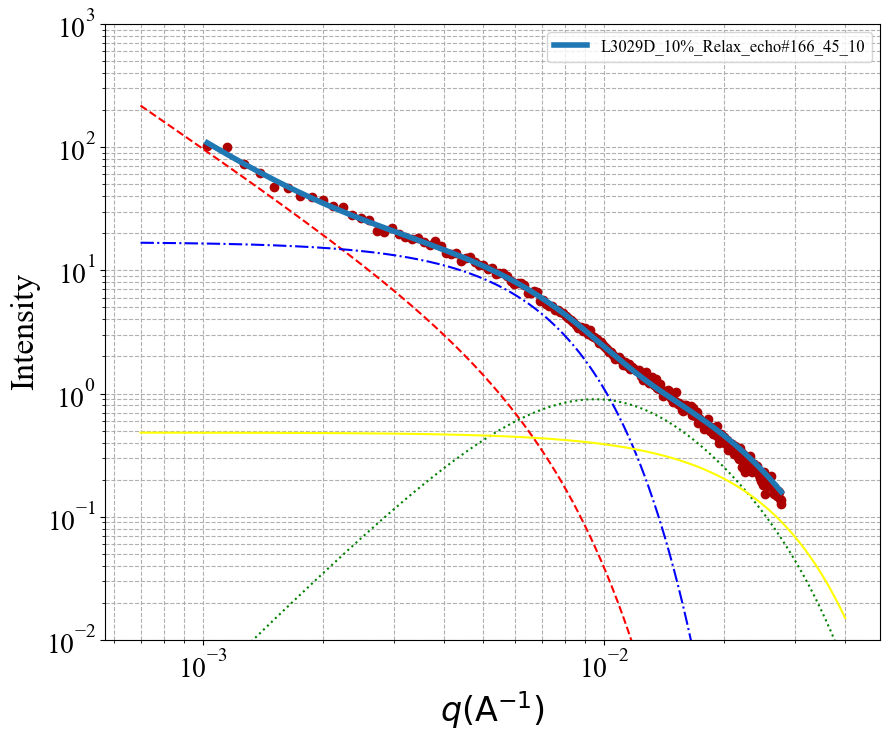


 Chi-square (func_1 with fixed params): 5.572157988148126
Sample: L3029D_10%_Relax_echo#167_45_10 - Parameter 1: 2.4319e-05
Sample: L3029D_10%_Relax_echo#167_45_10 - Parameter 2: 2.2056e+00
Sample: L3029D_10%_Relax_echo#167_45_10 - Parameter 3: 2.8236e+02
Sample: L3029D_10%_Relax_echo#167_45_10 - Parameter 4: 1.6557e+01
Sample: L3029D_10%_Relax_echo#167_45_10 - Parameter 5: 1.7985e-03
Sample: L3029D_10%_Relax_echo#167_45_10 - Parameter 6: 1.4870e+00
Sample: L3029D_10%_Relax_echo#167_45_10 - Parameter 7: 7.9872e+01
Sample: L3029D_10%_Relax_echo#167_45_10 - Parameter 8: 4.6685e-01
Sample: L3029D_10%_Relax_echo#167_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#167_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2056 ± 0.0847
Rss: 282.3608 ± 16.5006



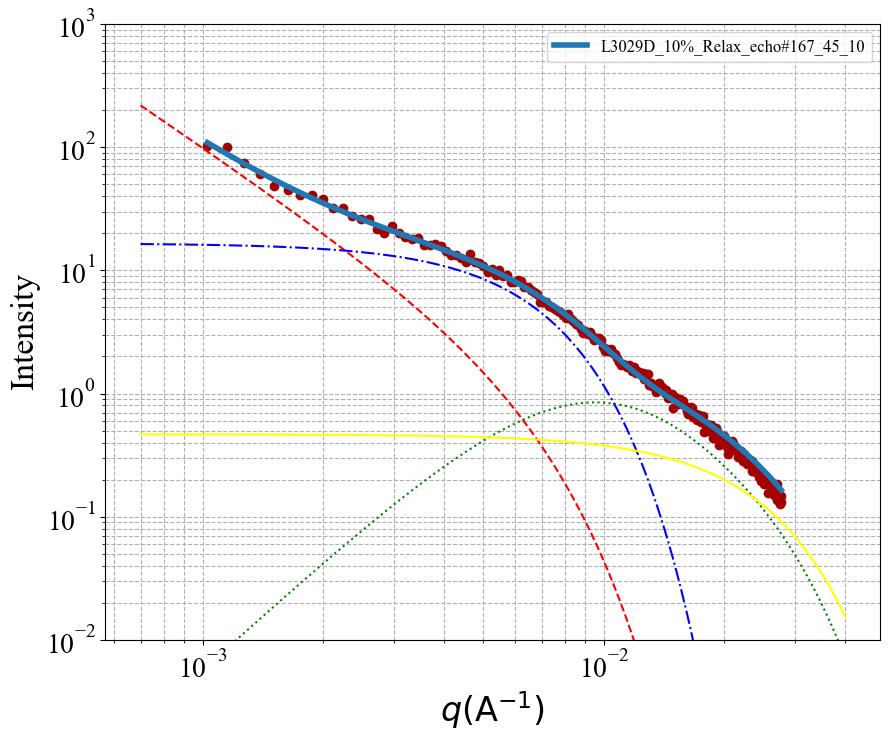


 Chi-square (func_1 with fixed params): 6.165002907983263
Sample: L3029D_10%_Relax_echo#168_45_10 - Parameter 1: 4.9670e-05
Sample: L3029D_10%_Relax_echo#168_45_10 - Parameter 2: 2.1016e+00
Sample: L3029D_10%_Relax_echo#168_45_10 - Parameter 3: 2.7549e+02
Sample: L3029D_10%_Relax_echo#168_45_10 - Parameter 4: 1.5058e+01
Sample: L3029D_10%_Relax_echo#168_45_10 - Parameter 5: 7.4510e-02
Sample: L3029D_10%_Relax_echo#168_45_10 - Parameter 6: 7.0513e-01
Sample: L3029D_10%_Relax_echo#168_45_10 - Parameter 7: 8.3675e+01
Sample: L3029D_10%_Relax_echo#168_45_10 - Parameter 8: 5.2983e-03
Sample: L3029D_10%_Relax_echo#168_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#168_45_10 - Parameter 10: 1.0000e-08

Dm: 2.1016 ± 0.0853
Rss: 275.4869 ± 21.6508



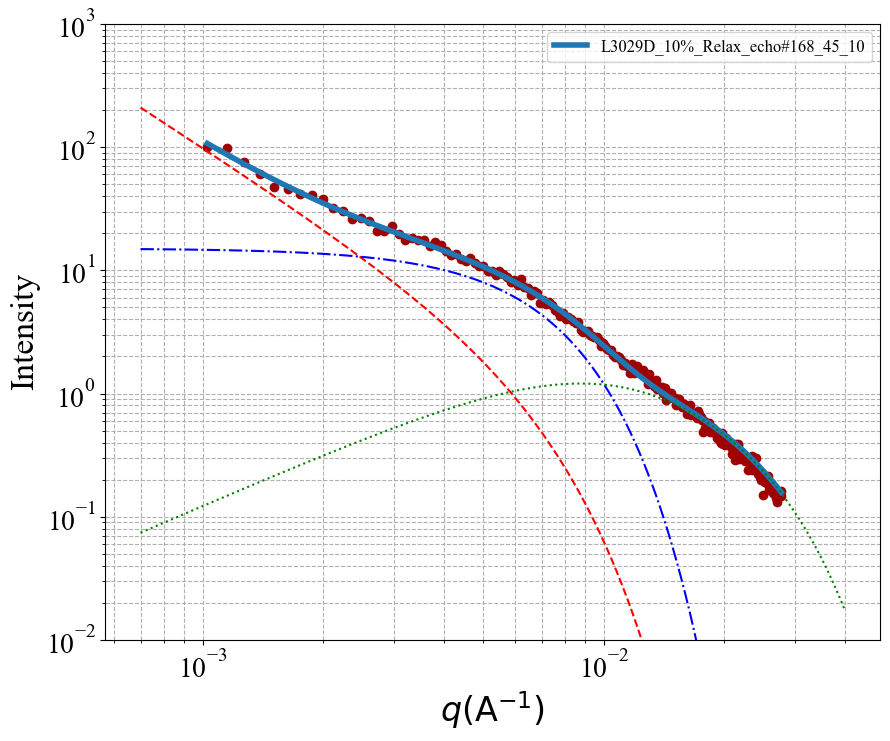


 Chi-square (func_1 with fixed params): 4.962619958932289
Sample: L3029D_10%_Relax_echo#169_45_10 - Parameter 1: 2.0123e-05
Sample: L3029D_10%_Relax_echo#169_45_10 - Parameter 2: 2.2322e+00
Sample: L3029D_10%_Relax_echo#169_45_10 - Parameter 3: 2.8765e+02
Sample: L3029D_10%_Relax_echo#169_45_10 - Parameter 4: 1.6917e+01
Sample: L3029D_10%_Relax_echo#169_45_10 - Parameter 5: 5.4018e-02
Sample: L3029D_10%_Relax_echo#169_45_10 - Parameter 6: 7.9019e-01
Sample: L3029D_10%_Relax_echo#169_45_10 - Parameter 7: 8.4999e+01
Sample: L3029D_10%_Relax_echo#169_45_10 - Parameter 8: 5.1164e-03
Sample: L3029D_10%_Relax_echo#169_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#169_45_10 - Parameter 10: 1.0000e-08

Dm: 2.2322 ± 0.0807
Rss: 287.6533 ± 17.6998



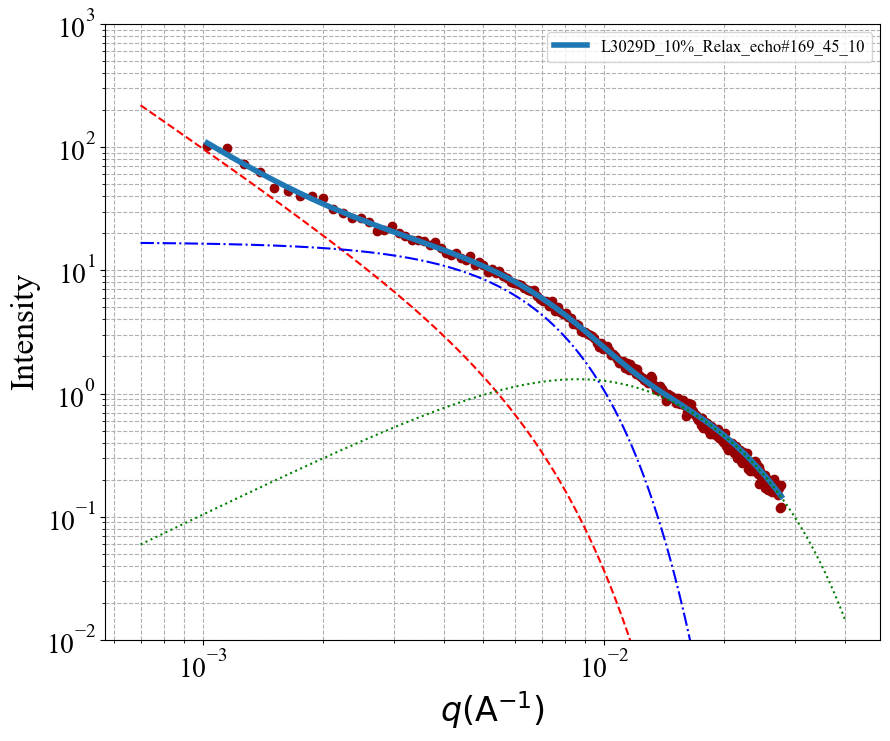


 Chi-square (func_1 with fixed params): 5.498004093991858
Sample: L3029D_10%_Relax_echo#170_45_10 - Parameter 1: 1.0210e-05
Sample: L3029D_10%_Relax_echo#170_45_10 - Parameter 2: 2.3300e+00
Sample: L3029D_10%_Relax_echo#170_45_10 - Parameter 3: 3.0254e+02
Sample: L3029D_10%_Relax_echo#170_45_10 - Parameter 4: 1.9055e+01
Sample: L3029D_10%_Relax_echo#170_45_10 - Parameter 5: 1.3558e-02
Sample: L3029D_10%_Relax_echo#170_45_10 - Parameter 6: 1.1246e+00
Sample: L3029D_10%_Relax_echo#170_45_10 - Parameter 7: 8.3469e+01
Sample: L3029D_10%_Relax_echo#170_45_10 - Parameter 8: 5.0626e-03
Sample: L3029D_10%_Relax_echo#170_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#170_45_10 - Parameter 10: 1.0000e-08

Dm: 2.3300 ± 0.0929
Rss: 302.5392 ± 17.7619



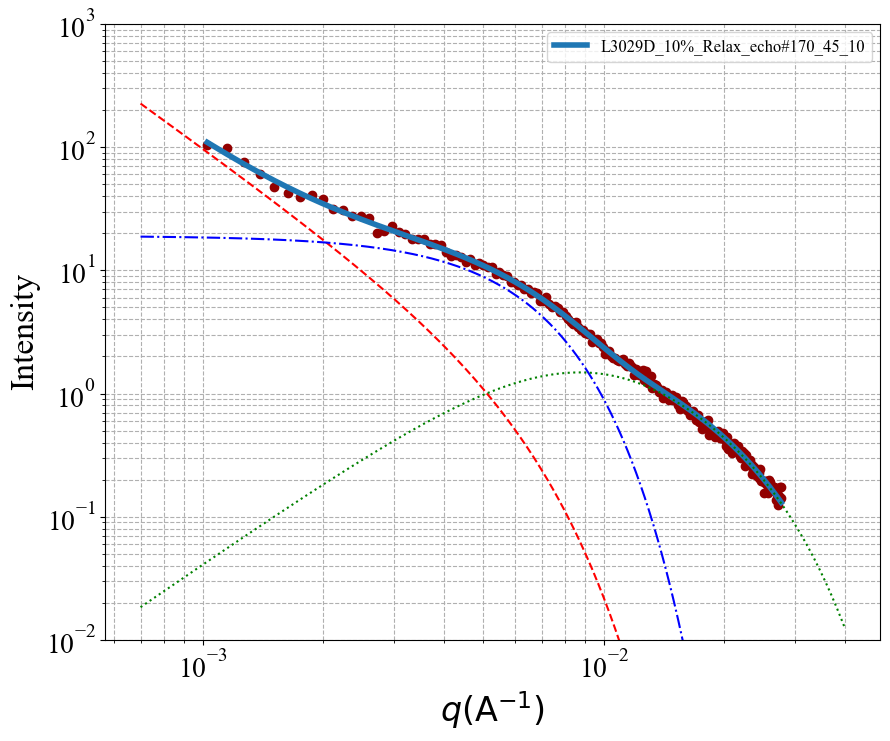


 Chi-square (func_1 with fixed params): 4.650524556245853
Sample: L3029D_10%_Relax_echo#171_45_10 - Parameter 1: 5.9691e-06
Sample: L3029D_10%_Relax_echo#171_45_10 - Parameter 2: 2.4094e+00
Sample: L3029D_10%_Relax_echo#171_45_10 - Parameter 3: 3.1250e+02
Sample: L3029D_10%_Relax_echo#171_45_10 - Parameter 4: 2.0308e+01
Sample: L3029D_10%_Relax_echo#171_45_10 - Parameter 5: 5.6523e-03
Sample: L3029D_10%_Relax_echo#171_45_10 - Parameter 6: 1.3409e+00
Sample: L3029D_10%_Relax_echo#171_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#171_45_10 - Parameter 8: 1.7750e-02
Sample: L3029D_10%_Relax_echo#171_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#171_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4094 ± 0.0836
Rss: 312.5014 ± 15.7716



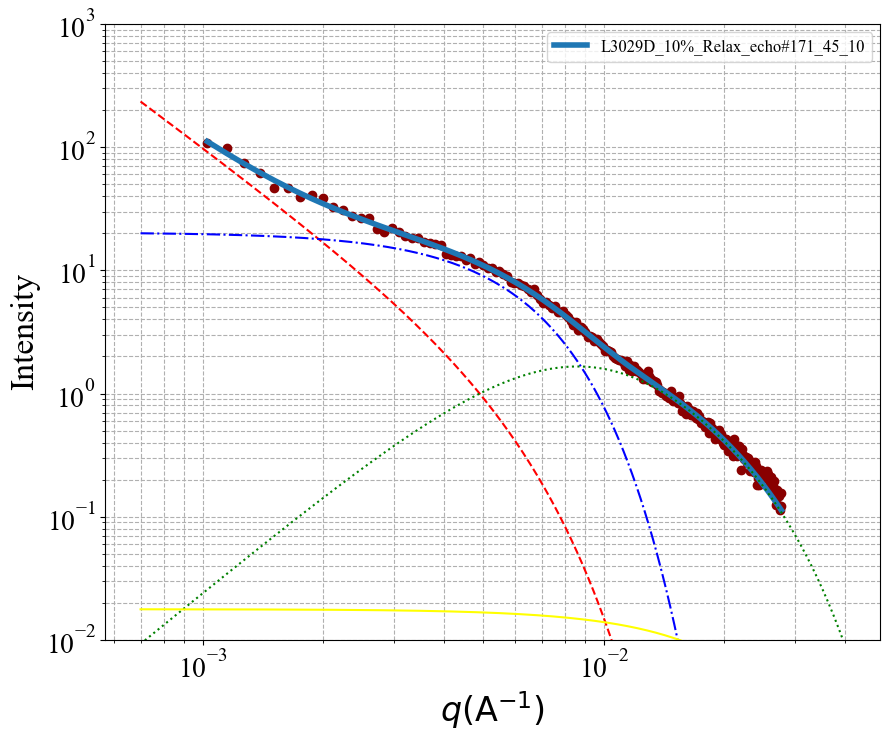


 Chi-square (func_1 with fixed params): 4.1856097557034575
Sample: L3029D_10%_Relax_echo#172_45_10 - Parameter 1: 4.4097e-06
Sample: L3029D_10%_Relax_echo#172_45_10 - Parameter 2: 2.4531e+00
Sample: L3029D_10%_Relax_echo#172_45_10 - Parameter 3: 3.1219e+02
Sample: L3029D_10%_Relax_echo#172_45_10 - Parameter 4: 2.0559e+01
Sample: L3029D_10%_Relax_echo#172_45_10 - Parameter 5: 5.4285e-03
Sample: L3029D_10%_Relax_echo#172_45_10 - Parameter 6: 1.3528e+00
Sample: L3029D_10%_Relax_echo#172_45_10 - Parameter 7: 8.5000e+01
Sample: L3029D_10%_Relax_echo#172_45_10 - Parameter 8: 4.4377e-03
Sample: L3029D_10%_Relax_echo#172_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#172_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4531 ± 0.0826
Rss: 312.1908 ± 15.1525



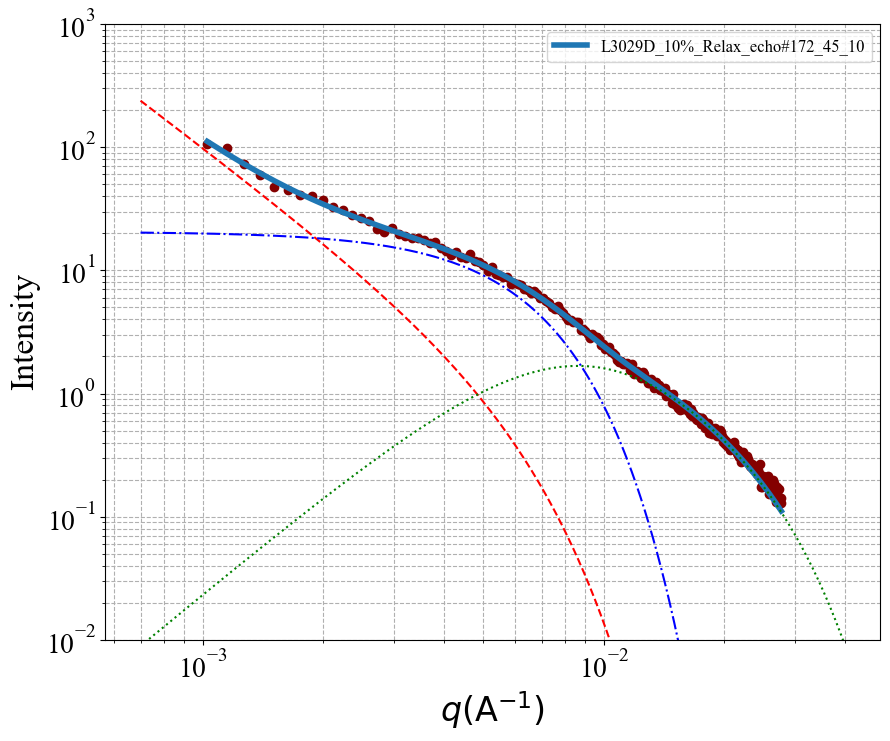


 Chi-square (func_1 with fixed params): 5.975488711854398
Sample: L3029D_10%_Relax_echo#173_45_10 - Parameter 1: 6.2903e-06
Sample: L3029D_10%_Relax_echo#173_45_10 - Parameter 2: 2.4048e+00
Sample: L3029D_10%_Relax_echo#173_45_10 - Parameter 3: 3.0473e+02
Sample: L3029D_10%_Relax_echo#173_45_10 - Parameter 4: 1.9514e+01
Sample: L3029D_10%_Relax_echo#173_45_10 - Parameter 5: 8.5884e-03
Sample: L3029D_10%_Relax_echo#173_45_10 - Parameter 6: 1.2368e+00
Sample: L3029D_10%_Relax_echo#173_45_10 - Parameter 7: 8.3235e+01
Sample: L3029D_10%_Relax_echo#173_45_10 - Parameter 8: 5.5701e-03
Sample: L3029D_10%_Relax_echo#173_45_10 - Parameter 9: 4.0000e+00
Sample: L3029D_10%_Relax_echo#173_45_10 - Parameter 10: 1.0000e-08

Dm: 2.4048 ± 0.1011
Rss: 304.7281 ± 19.3503



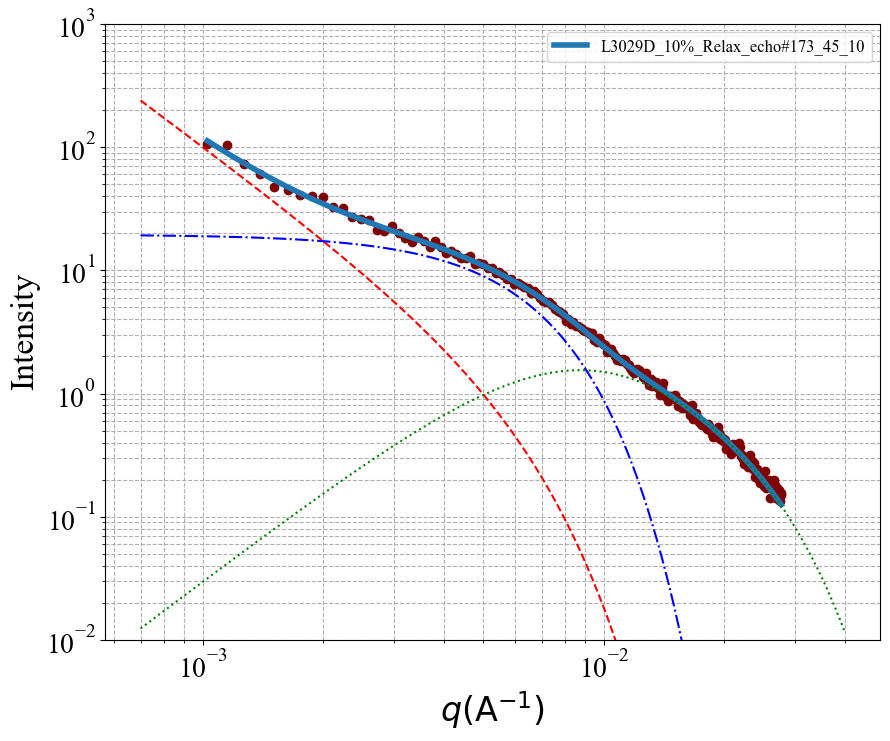

In [4]:
# Define Bounds
lower_bounds = [0,     0,     100,    0,    0,  
                0,  50,     0,   4-1e-10, 0] 
upper_bounds = [1,   5 ,   600,     300,   10,
                20,  85,      10,    4+1e-10,   1e-8]



for idx, sample in enumerate(samples):
    r_col = f"'r_{sample}'"
    q_col = f"'q_{sample}'"
    fit_results = fit_curve(sample, q_col, r_col, color=colors[idx],                           
          initial_guess=[     
    
2.0332e-07,
2.9152e+00,
3.3363e+02,
2.3184e+01,
1.3263e-05,
2.6951e+00,
8.5000e+01,
5.3482e-01,
4.0000e+00,
1.0000e-08,
  ])
#   ,
        # focus_low_q=True 

# Options to save fitting parameters

In [5]:
import os

# Specify the directory where you want to save the output file
output_directory = 'C:/Users/range/OneDrive/Desktop/Research/Rubber reiforcement/FEB 2024/SAX UF results'  # Replace with your desired path

# Generate the output file name
base_name = os.path.basename(input_file_name)  # Extract the file name from the full path
name_without_extension = os.path.splitext(base_name)[0]  # Remove the file extension
output_file_name = os.path.join(output_directory, name_without_extension + "_params_errors.csv")

# print(output_file_name)  # This will be your output file name

# # Assuming 'params_df' is a pandas DataFrame that you want to write to a CSV
# params_df.to_csv(output_file_name, index=False)


# Summary in term of Dm and Rss respected to cycle numbers

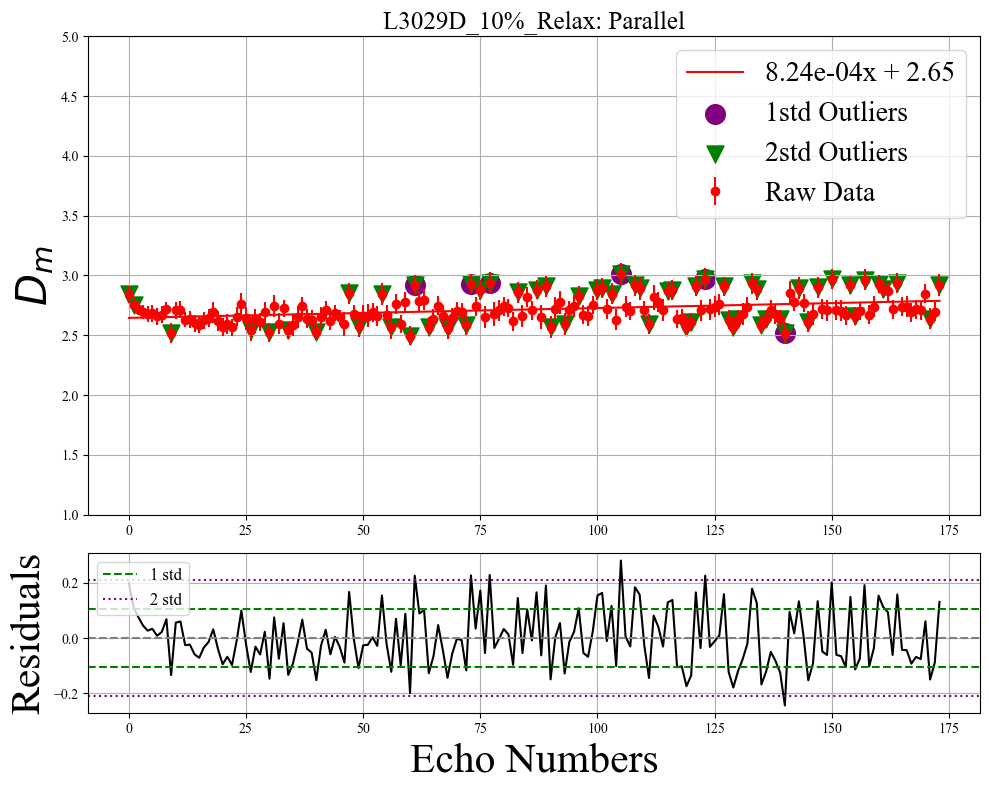

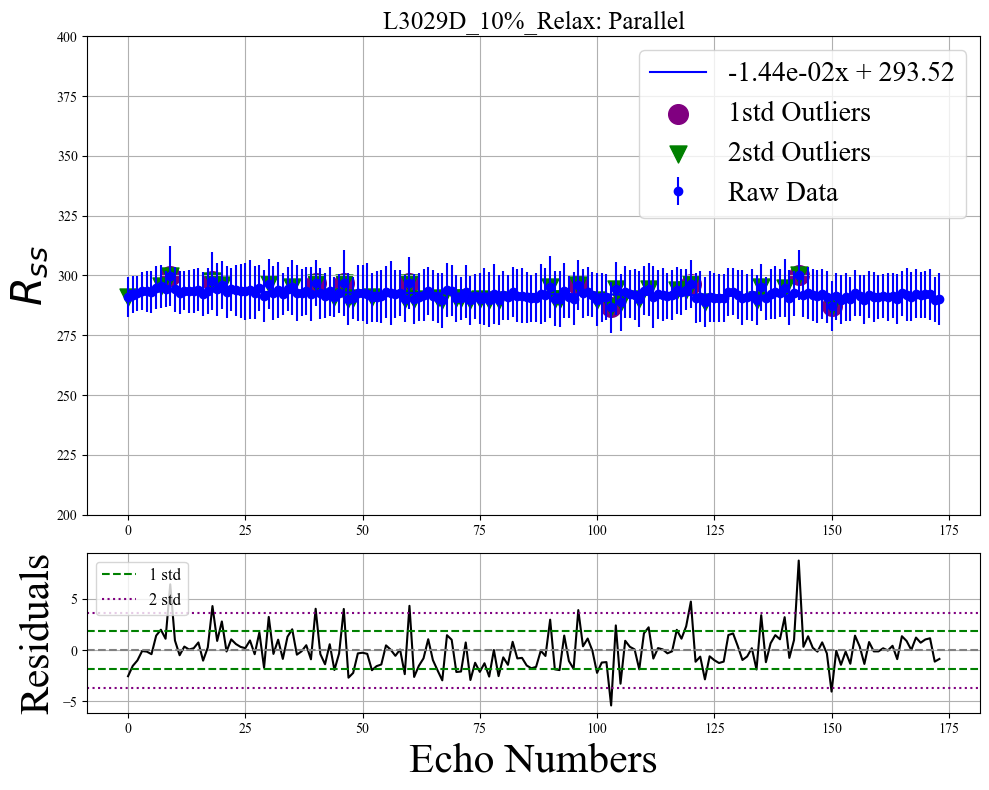

In [6]:


data1 = pd.read_csv(output_file_name)

# data1 = pd.read_csv("C:/Users/range/OneDrive/Desktop/Research/Rubber reiforcement/FEB 2024/SAX UF results/L3029F_10%_perpendicular_R_1st_params_errors.csv")

# Extracting the needed information
data1['Echo'] = data1['Sample'].str.extract(r'echo#(\d+)').astype(int)
data1['Strain_Type'] = data1['Sample'].str.extract(r'_(Stretch|Relax)_')
data1['Direction'] = data1['Sample'].str.contains('_45_').replace({True: 'Parallel', False: 'Perpendicular'})
sample_name = data1['Sample'][0].split('_echo')[0]
# Sorting the data based on echo number
sorted_data = data1.sort_values('Echo')


mask = sorted_data['Parameter_3'] <= 600 #mask data that hits the boundary
sorted_data = sorted_data[mask].copy()


# Perform linear regression for Parameter 2 on the filtered data
slope_2, intercept_2, r_value_2, p_value_2, std_err_2 = linregress(sorted_data['Echo'], sorted_data['Parameter_2'])
slope_3, intercept_3, r_value_3, p_value_3, std_err_3 = linregress(sorted_data['Echo'], sorted_data['Parameter_3'])

# Calculate the best fit line for Parameter 2 on the filtered data
line_2 = slope_2 * sorted_data['Echo'] + intercept_2

# Perform linear regression for Parameter 3 on the filtered data
# Calculate the best fit line for Parameter 3 on the filtered data
line_3 = slope_3 * sorted_data['Echo'] + intercept_3

# Calculate residuals for each parameter on the filtered data
residuals_2 = sorted_data['Parameter_2'] - line_2
residuals_3 = sorted_data['Parameter_3'] - line_3
# Standard deviation of residuals
std_dev_2 = np.std(residuals_2)
std_dev_3 = np.std(residuals_3)

# Highlighting outliers in existing plots
# For Parameter 2
# Setting up the plot with two subplots
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8), gridspec_kw={'height_ratios': [3, 1]})

ax1.errorbar(sorted_data['Echo'], sorted_data['Parameter_2'], yerr=sorted_data['Error_2'], fmt='o',color ='red',  ecolor='red', capthick=2, label='Raw Data')
ax1.plot(sorted_data['Echo'], line_2, 'r-', label=f'{slope_2:.2e}x + {intercept_2:.2f}')
# Highlight outliers 
outliers2 = np.abs(residuals_2) > 2 * std_dev_2  
ax1.scatter(sorted_data['Echo'][outliers2], sorted_data['Parameter_2'][outliers2], s=200, edgecolor='purple', marker='o', color='purple', label='1std Outliers')
outliers1 = np.abs(residuals_2) > 1 * std_dev_2
ax1.scatter(sorted_data['Echo'][outliers1], sorted_data['Parameter_2'][outliers1], s=150, edgecolor='green', marker='v', color='green', label='2std Outliers')
ax1.set_title(sample_name + ': ' +data1['Direction'][0],fontsize = 18)

ax1.set_ylabel(r'$D_{m}$',fontsize = 30)
ax1.legend(loc = 'upper right', fontsize = 20)
ax1.grid(True)
ax1.set_ylim(1,5)

# Section 2: Residuals with 1std and 2std Range
ax2.plot(sorted_data['Echo'], residuals_2, color='black',linestyle = '-')
ax2.axhline(y=0, color='gray', linestyle='--')
ax2.axhline(y=std_dev_2, color='green', linestyle='--', label='1 std')
ax2.axhline(y=-std_dev_2, color='green', linestyle='--')
ax2.axhline(y=2*std_dev_2, color='purple', linestyle=':', label='2 std')
ax2.axhline(y=-2*std_dev_2, color='purple', linestyle=':')
ax2.set_xlabel('Echo Numbers',fontsize =30)
ax2.set_ylabel('Residuals',fontsize = 30)
ax2.legend(fontsize = 12, loc = 'upper left')
ax2.grid(True)

# Adjust layout and show plot
plt.tight_layout()
plt.show()

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8), gridspec_kw={'height_ratios': [3, 1]})

# Section 1: Raw Data with Fitting and Outliers for Parameter 3
ax1.errorbar(sorted_data['Echo'], sorted_data['Parameter_3'], yerr=sorted_data['Error_3'], fmt='o', color='blue', ecolor='blue', capthick=2, label='Raw Data')
ax1.plot(sorted_data['Echo'], line_3, 'b-', label=f'{slope_3:.2e}x + {intercept_3:.2f}')
# Highlight outliers
outliers2 = np.abs(residuals_3) > 2 * std_dev_3  # Example definition for 2 std deviation outliers
ax1.scatter(sorted_data['Echo'][outliers2], sorted_data['Parameter_3'][outliers2], s=200, edgecolor='purple', marker='o', color='purple', label='1std Outliers')
outliers1 = np.abs(residuals_3) > 1 * std_dev_3  # Example definition for 1 std deviation outliers
ax1.scatter(sorted_data['Echo'][outliers1], sorted_data['Parameter_3'][outliers1], s=150, edgecolor='green', marker='v', color='green', label='2std Outliers')
ax1.set_title(sample_name + ': ' +data1['Direction'][0],fontsize = 18)
ax1.set_ylim(200,400)

ax1.set_ylabel(r'$R_{ss}$', fontsize=30)
ax1.legend(loc = 'upper right', fontsize=20)
ax1.grid(True)

# Section 2: Residuals with 1std and 2std Range for Parameter 3
ax2.plot(sorted_data['Echo'], residuals_3, color='black', linestyle='-')
ax2.axhline(y=0, color='gray', linestyle='--')
ax2.axhline(y=std_dev_3, color='green', linestyle='--', label='1 std')
ax2.axhline(y=-std_dev_3, color='green', linestyle='--')
ax2.axhline(y=2*std_dev_3, color='purple', linestyle=':', label='2 std')
ax2.axhline(y=-2*std_dev_3, color='purple', linestyle=':')
ax2.set_xlabel('Echo Numbers', fontsize=30)
ax2.set_ylabel('Residuals', fontsize=30)
ax2.legend(fontsize=12, loc='upper left')
ax2.grid(True)

# Adjust layout and show plot
plt.tight_layout()
plt.show()

# Remove Outliers based on your choice

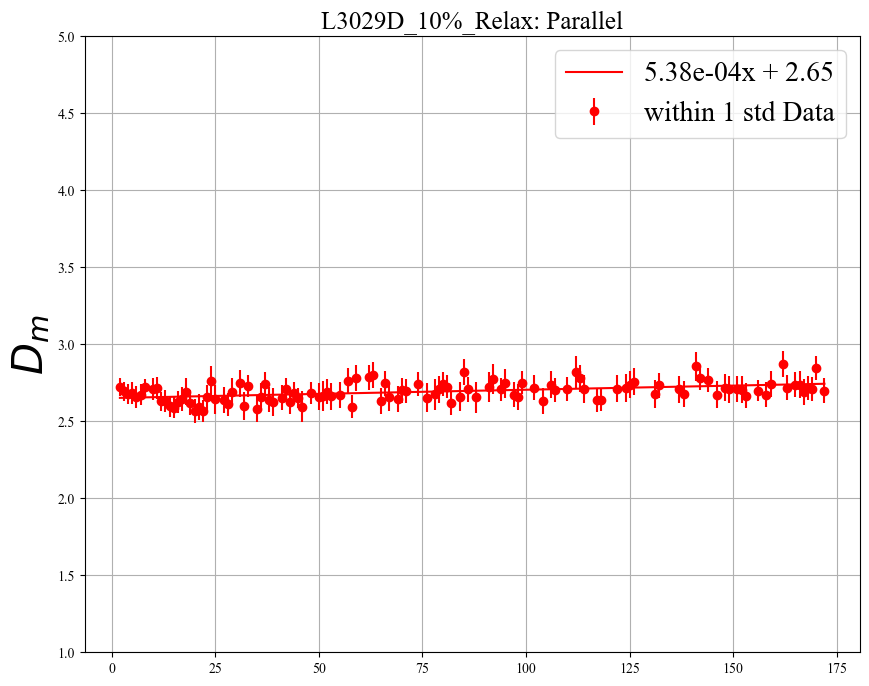

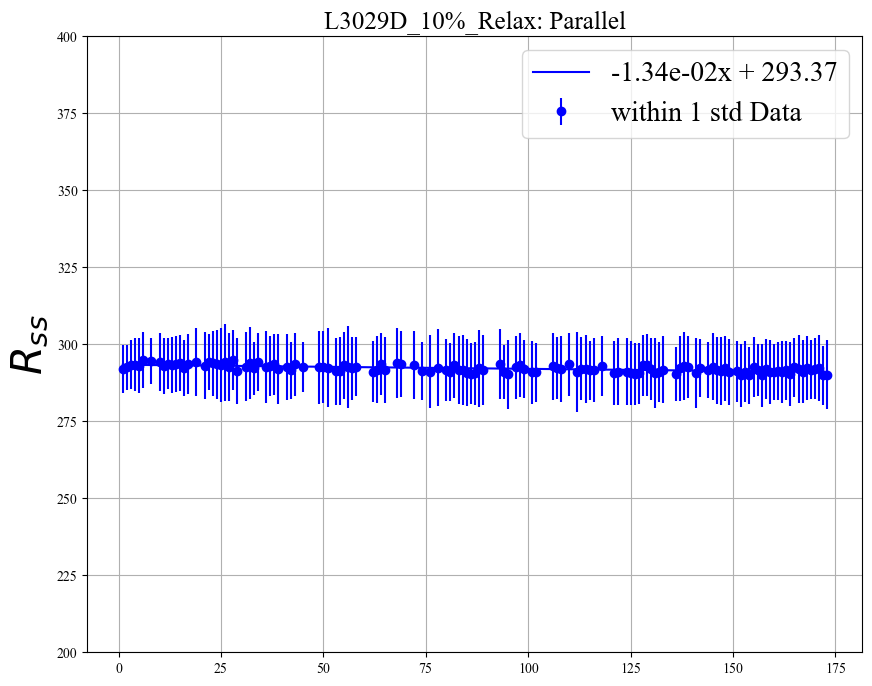

In [7]:

# Example usage
remove_outliers_and_refit('Parameter_2', 1)  # Remove 2 std outliers from Parameter 2 (Dm)
remove_outliers_and_refit('Parameter_3', 1)  # Remove 1 std outliers from Parameter 3 (Rss)
